In [1]:
import re, pickle, time, os,  copy
import plot_utils, train_utils, function_utils, dict_utils, build_feature_utils

import numpy as np
import pandas as pd

from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import ElasticNetCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score
from sklearn.feature_selection import r_regression

import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


## Remove and fix some data

In [2]:
batch1 = pickle.load(open(os.path.join('.','Data','batch1.pkl'), 'rb'))
#remove batteries that do not reach 80% capacity
del batch1['b1c8']
del batch1['b1c10']
del batch1['b1c12']
del batch1['b1c13']
del batch1['b1c22']

numBat1 = len(batch1.keys())

batch2 = pickle.load(open(os.path.join('.','Data','batch2.pkl'),'rb'))
# There are four cells from batch1 that carried into batch2, we'll remove the data from batch2
# and put it with the correct cell from batch1
batch2_keys = ['b2c7', 'b2c8', 'b2c9', 'b2c15', 'b2c16']
batch1_keys = ['b1c0', 'b1c1', 'b1c2', 'b1c3', 'b1c4']
add_len = [662, 981, 1060, 208, 482];

for i, bk in enumerate(batch1_keys):
    batch1[bk]['cycle_life'] = batch1[bk]['cycle_life'] + add_len[i]
    for j in batch1[bk]['summary'].keys():
        if j == 'cycle':
            batch1[bk]['summary'][j] = np.hstack((batch1[bk]['summary'][j], batch2[batch2_keys[i]]['summary'][j] + len(batch1[bk]['summary'][j])))
        else:
            batch1[bk]['summary'][j] = np.hstack((batch1[bk]['summary'][j], batch2[batch2_keys[i]]['summary'][j]))
    last_cycle = len(batch1[bk]['cycles'].keys())
    for j, jk in enumerate(batch2[batch2_keys[i]]['cycles'].keys()):
        batch1[bk]['cycles'][str(last_cycle + j)] = batch2[batch2_keys[i]]['cycles'][jk]
        
## THIS IS MY CHANGE, 3/6/2021: b2c1 is an anomaly; 148 cycle life. REMOVE at cell above and below

del batch2['b2c7']
del batch2['b2c8']
del batch2['b2c9']
del batch2['b2c15']
del batch2['b2c16']

numBat2 = len(batch2.keys())

batch3 = pickle.load(open(os.path.join('.','Data','batch3.pkl'),'rb'))
# remove noisy channels from batch3
del batch3['b3c37']
del batch3['b3c2']
del batch3['b3c23']
del batch3['b3c32']
del batch3['b3c38']
del batch3['b3c39']

numBat3 = len(batch3.keys())

numBat = numBat1 + numBat2 + numBat3
bat_dict = {'LFP_data': {**batch1, **batch2, **batch3}}

In [3]:
# index used in the nature paper
# test_ind = np.hstack((np.arange(0,(numBat1+numBat2),2),83))
test_ind = np.arange(0,(numBat1+numBat2),2)
train_ind = np.arange(1,(numBat1+numBat2-1),2)
secondary_test_ind = np.arange(numBat-numBat3,numBat);

# remove the anomalous cell, b2c1
test_ind = np.delete(test_ind, 21)
test_ind = np.append(test_ind, numBat1+numBat2-1)

In [4]:
# Seggregate the data into charge, discharge and their rests
bat_index_dict = dict_utils.create_bat_index_dict(bat_dict['LFP_data'].keys(), bat_dict['LFP_data'])
# And assign back into bat_dict for ease of use
bat_dict = function_utils.set_stepIndex(bat_dict, bat_index_dict)

# Check for error in the step index assignment
for cellNo in bat_dict['LFP_data'].keys():
    for cycleNo in list(bat_dict['LFP_data'][cellNo]['cycles'].keys())[1:202]:
        checkCell = bat_dict['LFP_data'][cellNo]['cycles'][cycleNo]
        idxCh = np.where(checkCell['Step_index'] == 3)[0]
        idxDis = np.where(checkCell['Step_index'] == 5)[0]

        if np.mean(checkCell['Qd'][idxCh][-10:]) > 0.1: print("The mean Qd for charging index is higher than 0.1 for", cellNo, cycleNo)
        if checkCell['Qd'][idxDis[0]] > 0.1: print("The starting Qd is higher than 0.1 for", cellNo, cycleNo)

# Manual fix for certain cell/cycle
fixCell = bat_dict['LFP_data']['b2c27']['cycles']
for keyName in fixCell['118'].keys():
    fixCell['118'][keyName] = fixCell['117'][keyName]

Rest index is empty for b1c45 270
The mean Qd for charging index is higher than 0.1 for b2c12 252
The starting Qd is higher than 0.03 for b2c12 252
The starting Qd is higher than 0.03 for b2c27 118
The starting Qd is higher than 0.03 for b2c44 247
Rest index is empty for b2c44 247
The starting Qd is higher than 0.1 for b2c27 118


#### Only consider CC-region only and interpolate

In [5]:
stepTotal = 100
testDict = copy.deepcopy(bat_dict)

for cellNo in testDict['LFP_data'].keys():
    for cycleNo in testDict['LFP_data'][cellNo]['cycles'].keys():
        if cycleNo == '0': continue
        testCellwCycle = testDict['LFP_data'][cellNo]['cycles'][cycleNo]
        
        idxDis = np.where(testCellwCycle['Step_index'] == 5)[0]
        idxCh = np.where(testCellwCycle['Step_index'] == 3)[0]
        # idxChCC = np.where(testCellwCycle['Step_index'] == 3)[0][0: np.where(testCellwCycle['Step_index'] == 4)[0][0]]

        linDictDis = function_utils.interpolate_data(xLimitList = [3.55, 2.05], step = stepTotal, cellDictOri = testCellwCycle, 
                                                 yKeyList = ['Qd', 'T_cell', 'V'], xKey = 'V', idxList = idxDis)
        for keyName in linDictDis.keys(): testCellwCycle[keyName] = linDictDis[keyName].copy()
        
        
        linDictCh = function_utils.interpolate_data(xLimitList = [0, 0.88], step = stepTotal, cellDictOri = testCellwCycle, 
                                                  yKeyList = ['Qc', 'T_cell'], xKey = 'Qc', idxList = idxCh)
        for keyName in linDictCh.keys(): testCellwCycle[keyName] = linDictCh[keyName].copy()

In [6]:
chargepolicylst = []
cyclelifelst = []
avgchargepolicylst = []
diffchargepolicylst = []
avgchargetimelst = []

timeCycles = list(map(str, np.arange(1,11,1))) #first 10 cycles for average charge time

for batno in testDict['LFP_data'].keys():
    chargepolicylst.append((testDict['LFP_data'][batno]['charge_policy']))
    cyclelifelst.append(int(testDict['LFP_data'][batno]['cycle_life']))
    
    totTime = 0
    for cycle in timeCycles:
        stopIdx = bat_index_dict[batno][cycle]['rest'][0]
        totTime += testDict['LFP_data'][batno]['cycles'][cycle]['t'][stopIdx]
    avgchargetimelst.append(totTime/len(timeCycles))

avgchargepolicylst = []
for policy in chargepolicylst:
    avgchargelst = re.findall(r'[0-9.]+', policy)
    avgchargelst = list(map(float, avgchargelst))
    a0 = avgchargelst[0]; a1 = avgchargelst[1]; a2 = avgchargelst[2]
    
    avgcharge = ((a0 * a1 / 100) + (a2 * (0.80 - a1 / 100))) / 0.80
    avgchargepolicylst.append(avgcharge)
    
    diffchargepolicy = a0 - a2
    diffchargepolicylst.append(diffchargepolicy)
       
bat_df = pd.DataFrame({'Bat code': pd.Series(list(testDict['LFP_data'].keys())),
                       'Charging policy': pd.Series(chargepolicylst),
                       'Avg charging policy' : pd.Series(avgchargepolicylst),
                       'Diff in charging policy' : pd.Series(diffchargepolicylst),
                       'Cycle life': pd.Series(cyclelifelst),
                       'Avg charging time' : pd.Series(avgchargetimelst)
})

In [7]:
# Y values - cycle life
y_train = np.log10(bat_df['Cycle life'][train_ind])
y_test = np.log10(bat_df['Cycle life'][test_ind])
y_secondary_test = np.log10(bat_df['Cycle life'][secondary_test_ind])
y_all = np.concatenate((y_train, y_test, y_secondary_test))

lenList = [len(train_ind), len(train_ind) + len(test_ind), len(train_ind) + len(test_ind) + len(secondary_test_ind)]

In [8]:
cycleList = [str(x) for x in np.arange(1,150,1)]

T_Q =  build_feature_utils.create_T_Q_lin_feature(testDict, cycleList, avgUpToCycle=150)
dTdQ =  build_feature_utils.create_dTdQ_lin_feature(testDict, cycleList, avgUpToCycle=150)

TQKeynameUnique = function_utils.get_unique_keyname_tuple(T_Q)
dTdQKeynameUnique = function_utils.get_unique_keyname_tuple(dTdQ)

In [9]:
# Manual fix
def modify_inf(dictname, keyname_tuple, currentCycle):
    if np.any(np.isinf(dictname[keyname_tuple])):
        indexList = np.argwhere(dictname[keyname_tuple] == -np.inf)
        for idx in indexList: dictname[keyname_tuple][idx] = dictname[keyname_tuple[0], keyname_tuple[1], 'Average_2to'+str(int(currentCycle)-1)][idx]

    return dictname[keyname_tuple]

for avgNo in ['142', '143', '144', '145', '146', '147', '148', '149']:
    cycleNo = 'Average_2to' + avgNo
    T_Q[('Charge', 'Minimum', cycleNo)] = modify_inf(T_Q, ('Charge', 'Minimum', cycleNo), avgNo)
    T_Q[('Charge', 'Max-Min', cycleNo)] = modify_inf(T_Q, ('Charge', 'Max-Min', cycleNo), avgNo)
    T_Q[('Discharge', 'Variance', cycleNo)] = modify_inf(T_Q, ('Discharge', 'Variance', cycleNo), avgNo)
    dTdQ[('Charge', 'Mean', cycleNo)] = modify_inf(dTdQ, ('Charge', 'Mean', cycleNo), avgNo)
    dTdQ[('Charge', 'Skewness', cycleNo)] = modify_inf(dTdQ, ('Charge', 'Skewness', cycleNo), avgNo) 
    dTdQ[('Charge', 'Maximum', cycleNo)] = modify_inf(dTdQ, ('Charge', 'Maximum', cycleNo), avgNo)

### The code below train and test the model using feature input extracted from different aggregate of cycle numbers. We assess the averaged values of the features, from the first 3, 4, .. 150 cycles (thus Avg3, Avg4, ..)
#### Uncomment and run the code below to see the errors and plots.
#### The results are provided and can be seen by simply un-hiding the output.


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.9
Best score obtained was: 0.1651054933846685
Cycle no: Average_2to3
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to3') : 0.0353675923303078
T_Q('Charge', 'Max-Min', 'Average_2to3') : -0.10409528216658277
T_Q('Discharge', 'Variance', 'Average_2to3') : 0.08071169946453027
dTdQ('Charge', 'Mean', 'Average_2to3') : -0.02733996761176785
dTdQ('Charge', 'Skewness', 'Average_2to3') : 0.00014416994156816608
dTdQ('Charge', 'Maximum', 'Average_2to3') : -0.06948506937483993

Intercept: 2.7939698976436382
r2-score: 0.687
MAE_all: 143.9
MAE_train: 104.2
MAE_test: 149.0
MAE_2ndTest: 179.3
MAPE_all: 16.4 %
MAPE_train: 14.2 %
MAPE_test: 18.1 %
MAPE_2ndTest: 16.9 %
RMSE_all: 231.5
RMSE_train: 169.6
RMSE_test: 253.4
RMSE_2ndTest: 260.5
RMSPE_all: 23.3 %
RMSPE_train: 18.2 %
RMSPE_test: 27.6 %
RMSPE_2ndTest: 22.9 %
Log-scale scores
All data r2-score: 0.687
Train d

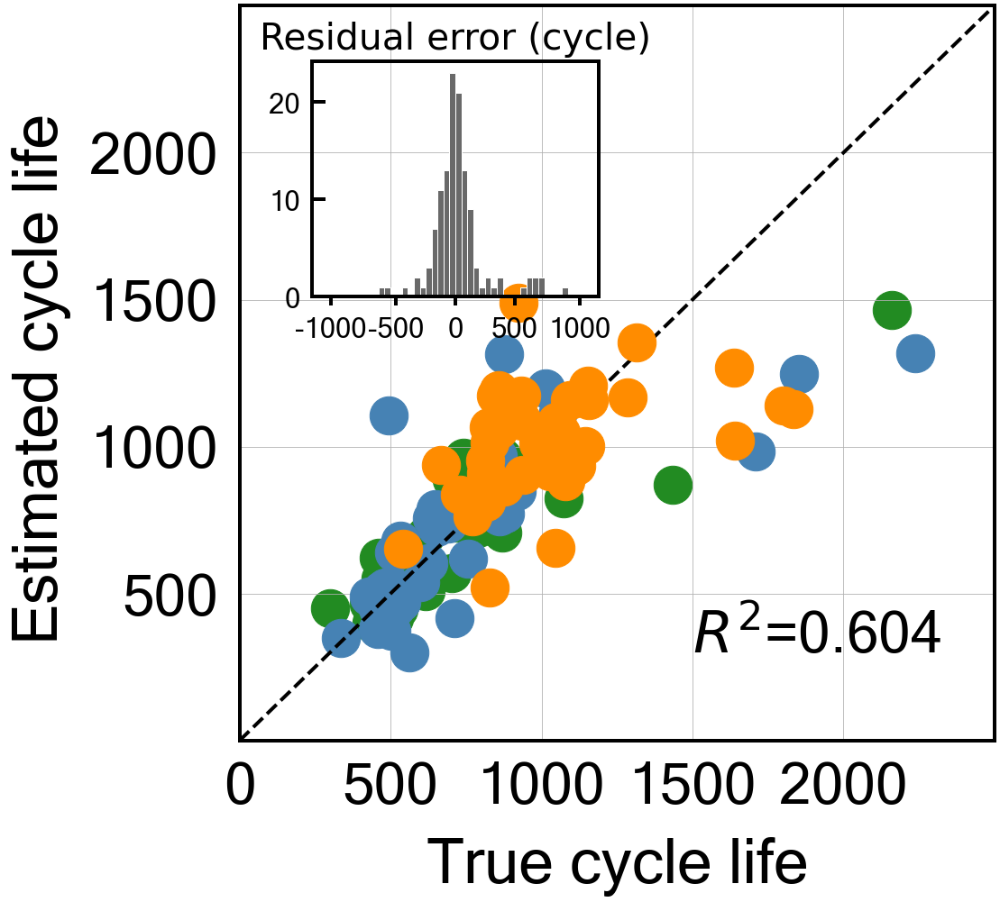


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.19472913036769923
Cycle no: Average_2to4
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to4') : 0.0317864400964501
T_Q('Charge', 'Max-Min', 'Average_2to4') : -0.10477955312737096
T_Q('Discharge', 'Variance', 'Average_2to4') : 0.0796398793257749
dTdQ('Charge', 'Mean', 'Average_2to4') : -0.025313584278188448
dTdQ('Charge', 'Skewness', 'Average_2to4') : 0.01122892046029223
dTdQ('Charge', 'Maximum', 'Average_2to4') : -0.06538791194959845

Intercept: 2.7939698976436373
r2-score: 0.657
MAE_all: 146.1
MAE_train: 110.0
MAE_test: 154.6
MAE_2ndTest: 174.1
MAPE_all: 16.7 %
MAPE_train: 14.8 %
MAPE_test: 19.0 %
MAPE_2ndTest: 16.4 %
RMSE_all: 243.9
RMSE_train: 195.0
RMSE_test: 273.4
RMSE_2ndTest: 255.8
RMSPE_all: 25.6 %
RMSPE_train: 21.9 %
RMSPE_test: 31.3 %
RMSPE_2ndTest: 22.4 %
Log-scale scores
All data r2-score: 0.657
Train dat

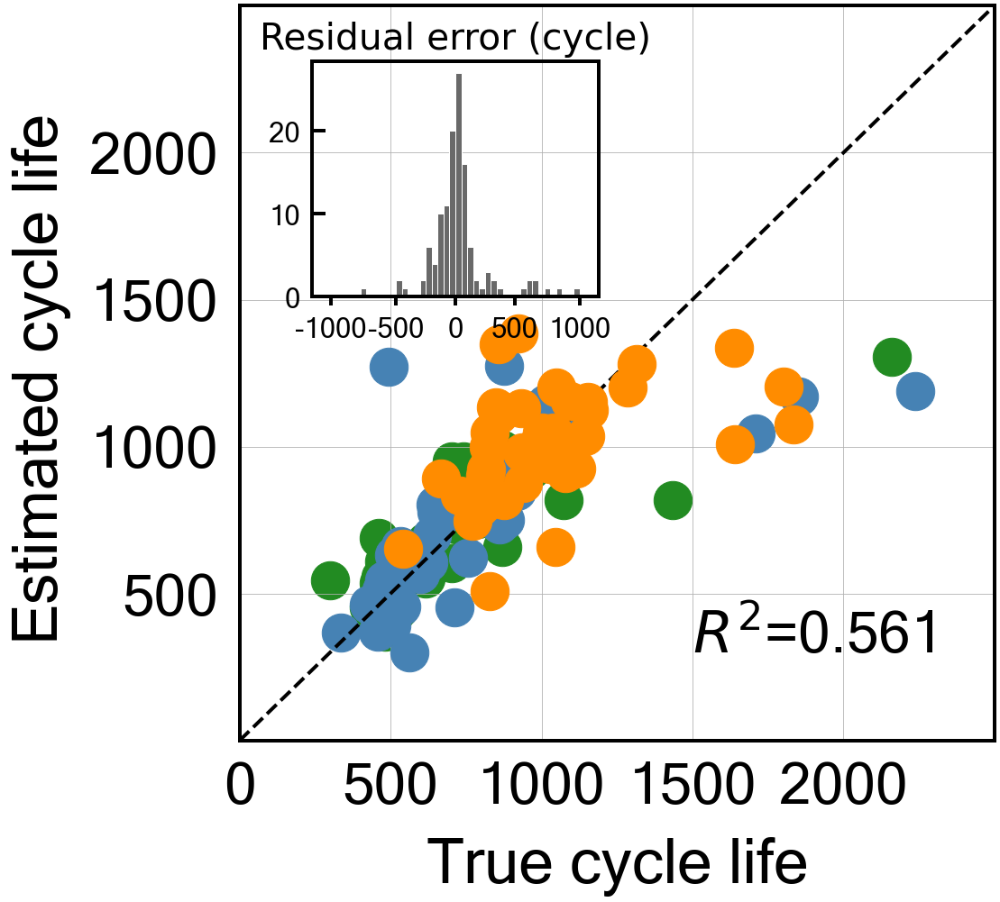


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.6
Best score obtained was: 0.13992399665928146
Cycle no: Average_2to5
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to5') : 0.044776673339251796
T_Q('Charge', 'Max-Min', 'Average_2to5') : -0.05935708898090415
T_Q('Discharge', 'Variance', 'Average_2to5') : 0.034670751253522675
dTdQ('Charge', 'Mean', 'Average_2to5') : -0.030289926741335793
dTdQ('Charge', 'Skewness', 'Average_2to5') : 0.014826161837308588
dTdQ('Charge', 'Maximum', 'Average_2to5') : -0.051087394469337334

Intercept: 2.793969897643637
r2-score: 0.636
MAE_all: 150.1
MAE_train: 120.5
MAE_test: 153.2
MAE_2ndTest: 177.3
MAPE_all: 16.1 %
MAPE_train: 16.0 %
MAPE_test: 16.2 %
MAPE_2ndTest: 16.2 %
RMSE_all: 267.4
RMSE_train: 232.2
RMSE_test: 300.4
RMSE_2ndTest: 264.4
RMSPE_all: 23.0 %
RMSPE_train: 25.0 %
RMSPE_test: 22.6 %
RMSPE_2ndTest: 21.1 %
Log-scale scores
All data r2-score: 0.636
Trai

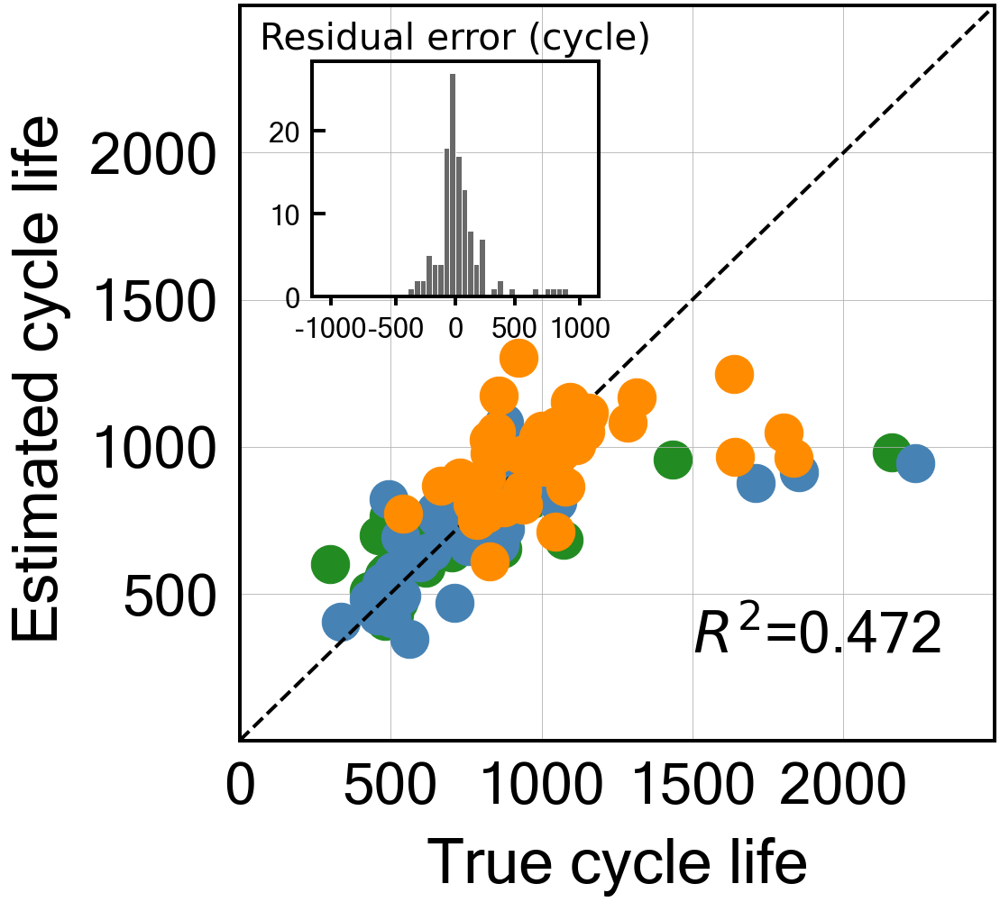


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 6.7
Best score obtained was: 0.2631979938365946
Cycle no: Average_2to6
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to6') : 0.019926119285949503
T_Q('Charge', 'Max-Min', 'Average_2to6') : -0.1378126673050188
T_Q('Discharge', 'Variance', 'Average_2to6') : 0.1359136190137766
dTdQ('Charge', 'Mean', 'Average_2to6') : -0.03150641876259926
dTdQ('Charge', 'Skewness', 'Average_2to6') : 0.009344357629181553
dTdQ('Charge', 'Maximum', 'Average_2to6') : -0.07547690145310561

Intercept: 2.7939698976436365
r2-score: 0.720
MAE_all: 136.1
MAE_train: 107.6
MAE_test: 132.8
MAE_2ndTest: 168.9
MAPE_all: 15.3 %
MAPE_train: 14.5 %
MAPE_test: 15.4 %
MAPE_2ndTest: 15.8 %
RMSE_all: 218.5
RMSE_train: 187.8
RMSE_test: 219.8
RMSE_2ndTest: 244.7
RMSPE_all: 20.2 %
RMSPE_train: 20.6 %
RMSPE_test: 18.9 %
RMSPE_2ndTest: 21.2 %
Log-scale scores
All data r2-score: 0.720
Train dat

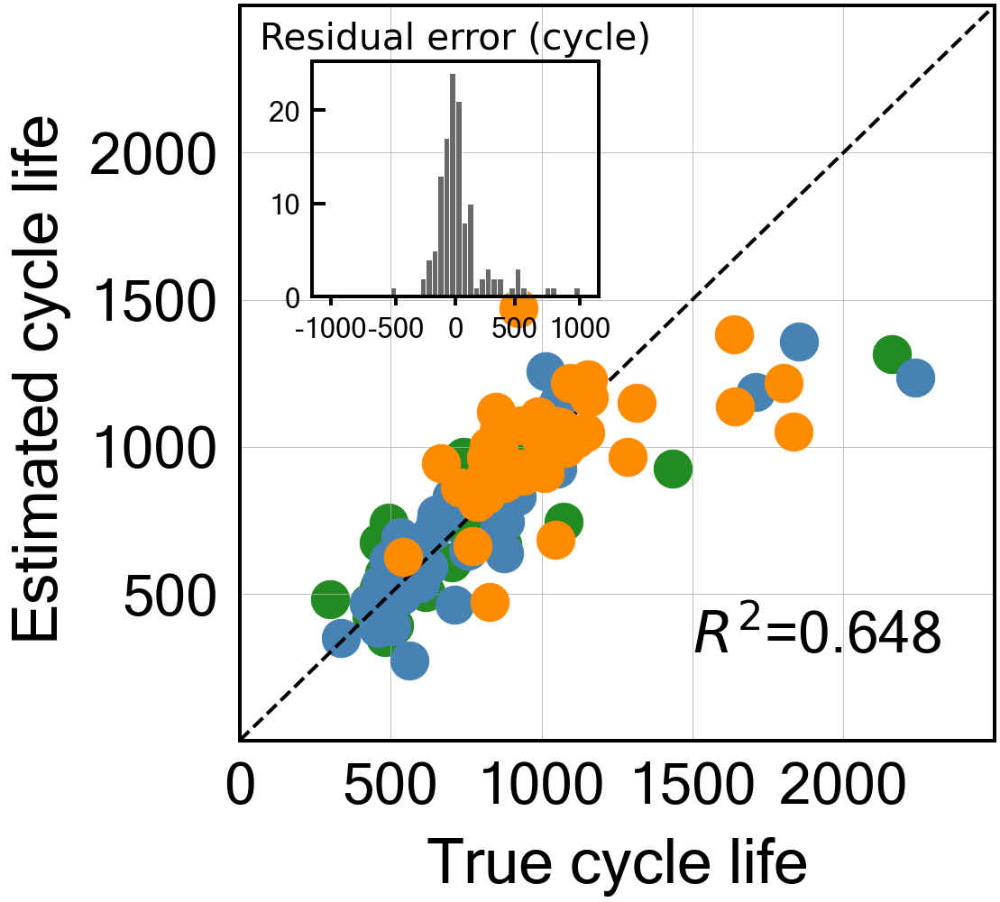


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.24093535218759776
Cycle no: Average_2to7
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to7') : 0.0048551145018125635
T_Q('Charge', 'Max-Min', 'Average_2to7') : -0.15920183268949628
T_Q('Discharge', 'Variance', 'Average_2to7') : 0.1663049909974357
dTdQ('Charge', 'Mean', 'Average_2to7') : -0.03695336176390395
dTdQ('Charge', 'Skewness', 'Average_2to7') : 0.009017397234970033
dTdQ('Charge', 'Maximum', 'Average_2to7') : -0.07538357123730947

Intercept: 2.7939698976436373
r2-score: 0.720
MAE_all: 134.6
MAE_train: 101.2
MAE_test: 134.4
MAE_2ndTest: 169.0
MAPE_all: 15.1 %
MAPE_train: 13.7 %
MAPE_test: 16.2 %
MAPE_2ndTest: 15.4 %
RMSE_all: 213.5
RMSE_train: 172.0
RMSE_test: 214.2
RMSE_2ndTest: 248.4
RMSPE_all: 19.8 %
RMSPE_train: 18.5 %
RMSPE_test: 20.2 %
RMSPE_2ndTest: 20.6 %
Log-scale scores
All data r2-score: 0.720
Train 

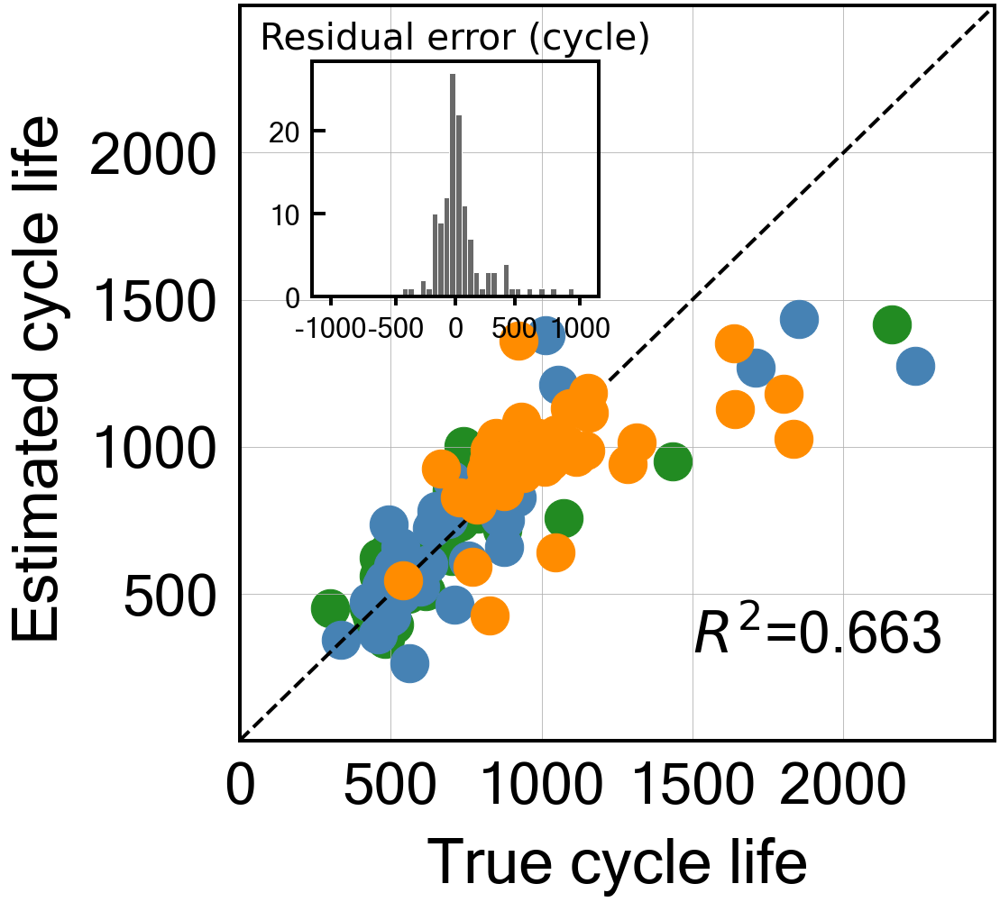


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.19006849394949066
Cycle no: Average_2to8
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to8') : 0.00752922639068095
T_Q('Charge', 'Max-Min', 'Average_2to8') : -0.15130131270673852
T_Q('Discharge', 'Variance', 'Average_2to8') : 0.16477472301733082
dTdQ('Charge', 'Mean', 'Average_2to8') : -0.04784748877036918
dTdQ('Charge', 'Skewness', 'Average_2to8') : 0.007545526516595137
dTdQ('Charge', 'Maximum', 'Average_2to8') : -0.07050703894638922

Intercept: 2.793969897643637
r2-score: 0.707
MAE_all: 135.5
MAE_train: 108.6
MAE_test: 132.0
MAE_2ndTest: 166.6
MAPE_all: 14.8 %
MAPE_train: 14.6 %
MAPE_test: 14.8 %
MAPE_2ndTest: 14.8 %
RMSE_all: 226.0
RMSE_train: 188.0
RMSE_test: 228.8
RMSE_2ndTest: 256.6
RMSPE_all: 20.0 %
RMSPE_train: 20.6 %
RMSPE_test: 19.0 %
RMSPE_2ndTest: 20.5 %
Log-scale scores
All data r2-score: 0.707
Train da

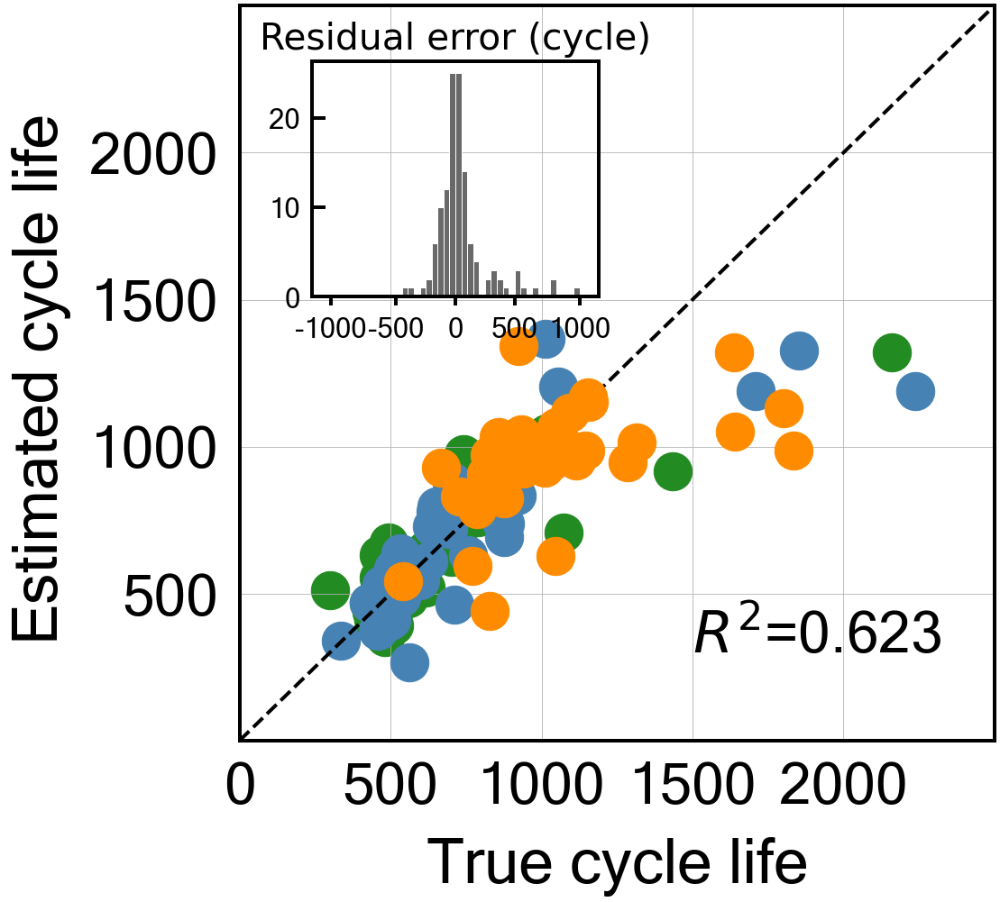


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.9
Best score obtained was: 0.18641002958434916
Cycle no: Average_2to9
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to9') : 0.0059362858293489675
T_Q('Charge', 'Max-Min', 'Average_2to9') : -0.15231101438734074
T_Q('Discharge', 'Variance', 'Average_2to9') : 0.16246793891945868
dTdQ('Charge', 'Mean', 'Average_2to9') : -0.04619316902107215
dTdQ('Charge', 'Skewness', 'Average_2to9') : 0.008337680537154966
dTdQ('Charge', 'Maximum', 'Average_2to9') : -0.06991859708870792

Intercept: 2.7939698976436373
r2-score: 0.717
MAE_all: 134.9
MAE_train: 106.3
MAE_test: 129.2
MAE_2ndTest: 170.2
MAPE_all: 14.7 %
MAPE_train: 14.3 %
MAPE_test: 14.6 %
MAPE_2ndTest: 15.3 %
RMSE_all: 222.2
RMSE_train: 181.2
RMSE_test: 222.6
RMSE_2ndTest: 257.2
RMSPE_all: 19.7 %
RMSPE_train: 19.5 %
RMSPE_test: 18.6 %
RMSPE_2ndTest: 20.9 %
Log-scale scores
All data r2-score: 0.717
Train

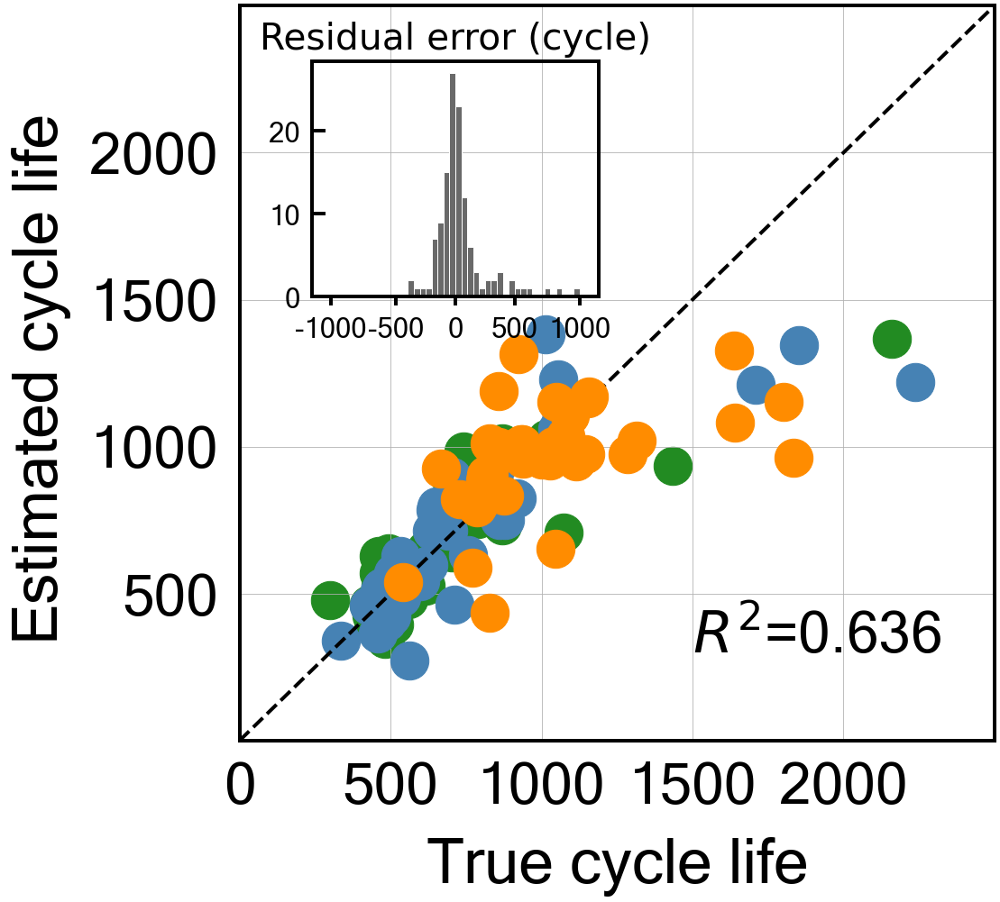


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.18694090608849356
Cycle no: Average_2to10
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to10') : 0.003881642149534673
T_Q('Charge', 'Max-Min', 'Average_2to10') : -0.15021746335346808
T_Q('Discharge', 'Variance', 'Average_2to10') : 0.1604313978377011
dTdQ('Charge', 'Mean', 'Average_2to10') : -0.046571432942208515
dTdQ('Charge', 'Skewness', 'Average_2to10') : 0.007589267594251934
dTdQ('Charge', 'Maximum', 'Average_2to10') : -0.06868666156551198

Intercept: 2.7939698976436373
r2-score: 0.720
MAE_all: 135.9
MAE_train: 106.6
MAE_test: 128.5
MAE_2ndTest: 173.8
MAPE_all: 14.9 %
MAPE_train: 14.4 %
MAPE_test: 14.7 %
MAPE_2ndTest: 15.7 %
RMSE_all: 219.5
RMSE_train: 179.7
RMSE_test: 215.9
RMSE_2ndTest: 257.1
RMSPE_all: 19.7 %
RMSPE_train: 19.7 %
RMSPE_test: 18.5 %
RMSPE_2ndTest: 20.9 %
Log-scale scores
All data r2-score: 0.720

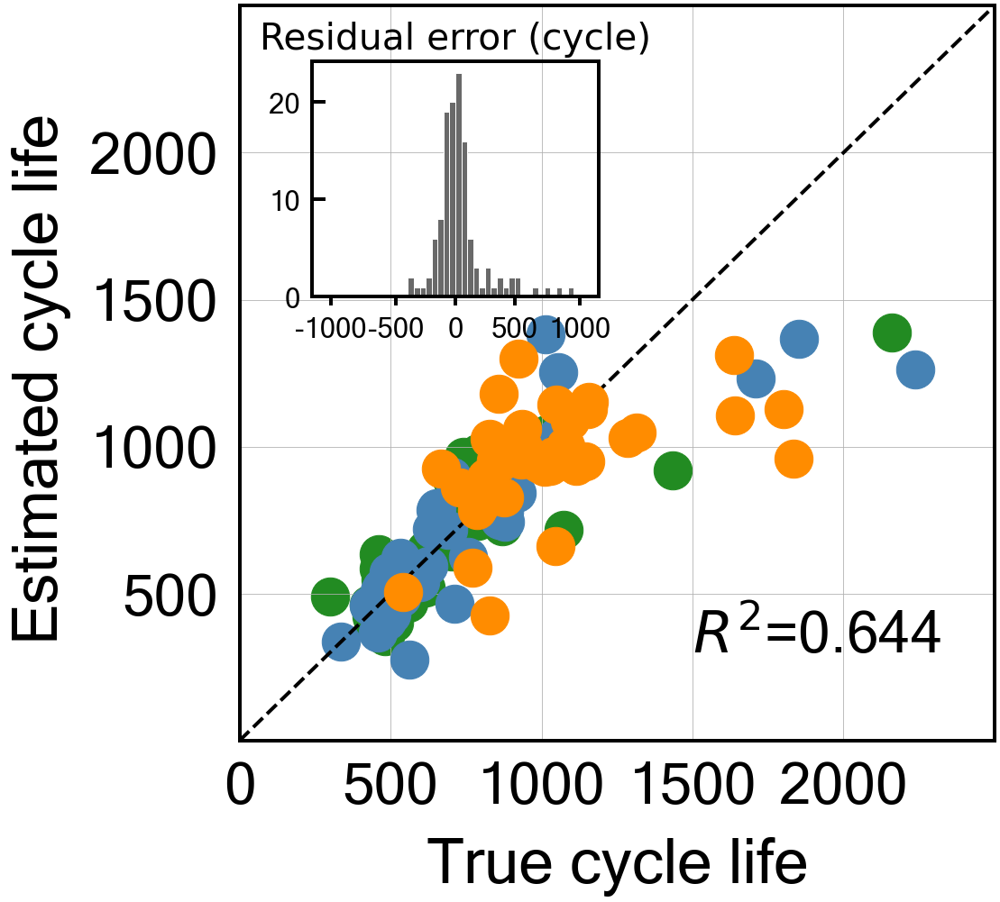


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.6
Best score obtained was: 0.2664110675460055
Cycle no: Average_2to11
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to11') : 0.014623441680721576
T_Q('Charge', 'Max-Min', 'Average_2to11') : -0.1491398790413904
T_Q('Discharge', 'Variance', 'Average_2to11') : 0.140416265734997
dTdQ('Charge', 'Mean', 'Average_2to11') : -0.0350132386960304
dTdQ('Charge', 'Skewness', 'Average_2to11') : 0.0043533420910874055
dTdQ('Charge', 'Maximum', 'Average_2to11') : -0.06359505070249954

Intercept: 2.7939698976436365
r2-score: 0.729
MAE_all: 134.6
MAE_train: 109.4
MAE_test: 126.7
MAE_2ndTest: 168.8
MAPE_all: 14.8 %
MAPE_train: 14.8 %
MAPE_test: 14.2 %
MAPE_2ndTest: 15.5 %
RMSE_all: 218.7
RMSE_train: 185.1
RMSE_test: 223.1
RMSE_2ndTest: 244.2
RMSPE_all: 19.7 %
RMSPE_train: 20.2 %
RMSPE_test: 18.3 %
RMSPE_2ndTest: 20.5 %
Log-scale scores
All data r2-score: 0.729
Tra

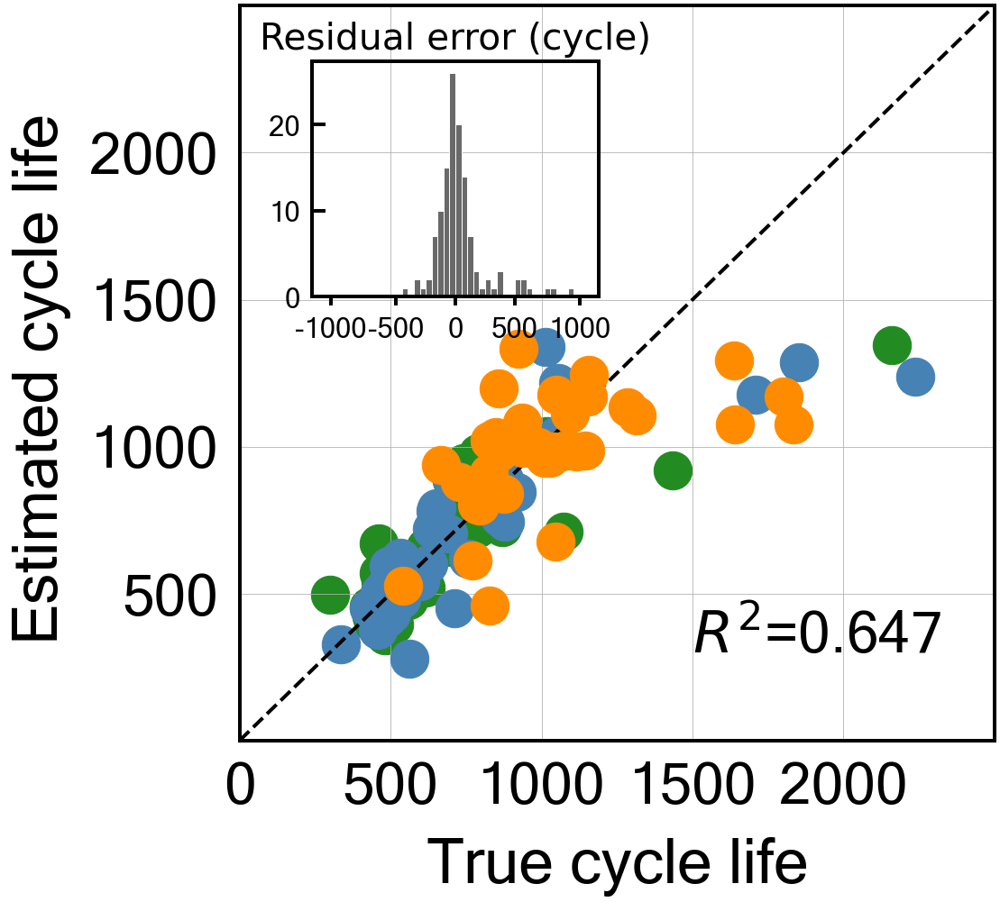


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.6
Best score obtained was: 0.2182292505106771
Cycle no: Average_2to12
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to12') : 0.02212483912622578
T_Q('Charge', 'Max-Min', 'Average_2to12') : -0.1558163368258766
T_Q('Discharge', 'Variance', 'Average_2to12') : 0.12752228681646413
dTdQ('Charge', 'Mean', 'Average_2to12') : -0.019382901260582446
dTdQ('Charge', 'Skewness', 'Average_2to12') : 0.0015527946899488137
dTdQ('Charge', 'Maximum', 'Average_2to12') : -0.061231097339681954

Intercept: 2.793969897643637
r2-score: 0.718
MAE_all: 140.6
MAE_train: 109.2
MAE_test: 135.5
MAE_2ndTest: 178.3
MAPE_all: 15.6 %
MAPE_train: 14.7 %
MAPE_test: 15.2 %
MAPE_2ndTest: 17.1 %
RMSE_all: 224.9
RMSE_train: 186.7
RMSE_test: 231.4
RMSE_2ndTest: 252.1
RMSPE_all: 20.9 %
RMSPE_train: 19.9 %
RMSPE_test: 19.4 %
RMSPE_2ndTest: 23.3 %
Log-scale scores
All data r2-score: 0.718


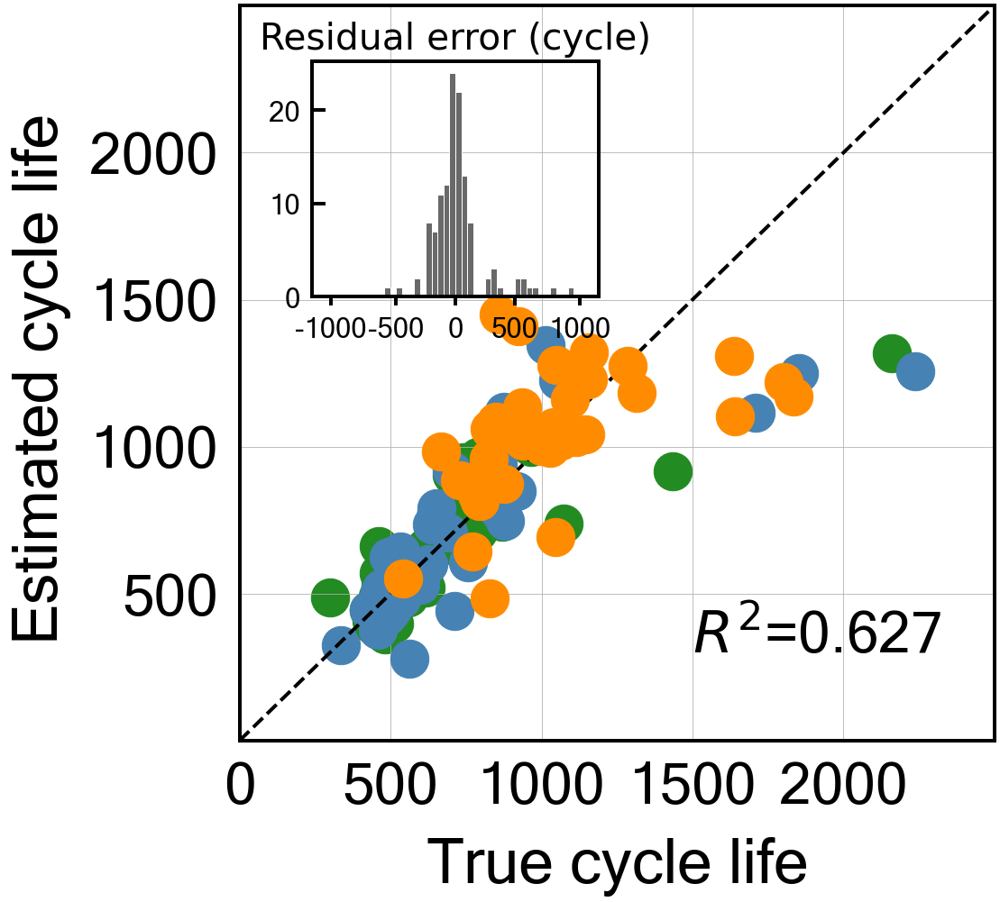


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.23106622942841815
Cycle no: Average_2to13
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to13') : 0.016823069232868578
T_Q('Charge', 'Max-Min', 'Average_2to13') : -0.15977303102015156
T_Q('Discharge', 'Variance', 'Average_2to13') : 0.13586387526877836
dTdQ('Charge', 'Mean', 'Average_2to13') : -0.021328163889574207
dTdQ('Charge', 'Skewness', 'Average_2to13') : 0.0012668296118491433
dTdQ('Charge', 'Maximum', 'Average_2to13') : -0.06391444975334014

Intercept: 2.7939698976436373
r2-score: 0.723
MAE_all: 140.8
MAE_train: 104.7
MAE_test: 137.1
MAE_2ndTest: 181.9
MAPE_all: 15.7 %
MAPE_train: 14.0 %
MAPE_test: 15.6 %
MAPE_2ndTest: 17.6 %
RMSE_all: 220.4
RMSE_train: 176.2
RMSE_test: 229.0
RMSE_2ndTest: 250.0
RMSPE_all: 20.8 %
RMSPE_train: 18.6 %
RMSPE_test: 19.9 %
RMSPE_2ndTest: 23.7 %
Log-scale scores
All data r2-score: 0.7

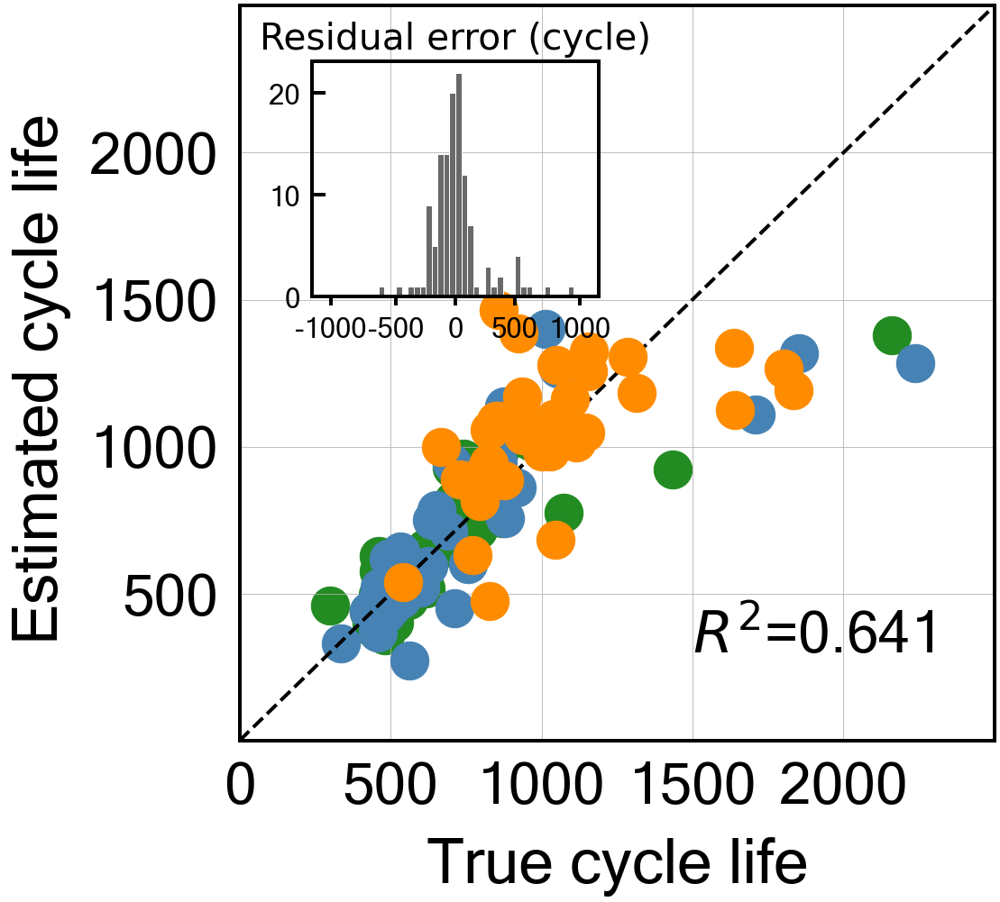


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.15552169599723342
Cycle no: Average_2to14
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to14') : 0.01932697407883259
T_Q('Charge', 'Max-Min', 'Average_2to14') : -0.1656620475184295
T_Q('Discharge', 'Variance', 'Average_2to14') : 0.13245244554513008
dTdQ('Charge', 'Mean', 'Average_2to14') : -0.013766713844086214
dTdQ('Charge', 'Skewness', 'Average_2to14') : -0.003846488936670395
dTdQ('Charge', 'Maximum', 'Average_2to14') : -0.062015633458419664

Intercept: 2.7939698976436373
r2-score: 0.712
MAE_all: 145.9
MAE_train: 105.0
MAE_test: 140.5
MAE_2ndTest: 193.5
MAPE_all: 16.3 %
MAPE_train: 14.1 %
MAPE_test: 15.9 %
MAPE_2ndTest: 18.9 %
RMSE_all: 226.9
RMSE_train: 175.6
RMSE_test: 235.1
RMSE_2ndTest: 262.0
RMSPE_all: 21.5 %
RMSPE_train: 18.2 %
RMSPE_test: 20.3 %
RMSPE_2ndTest: 25.3 %
Log-scale scores
All data r2-score: 0.71

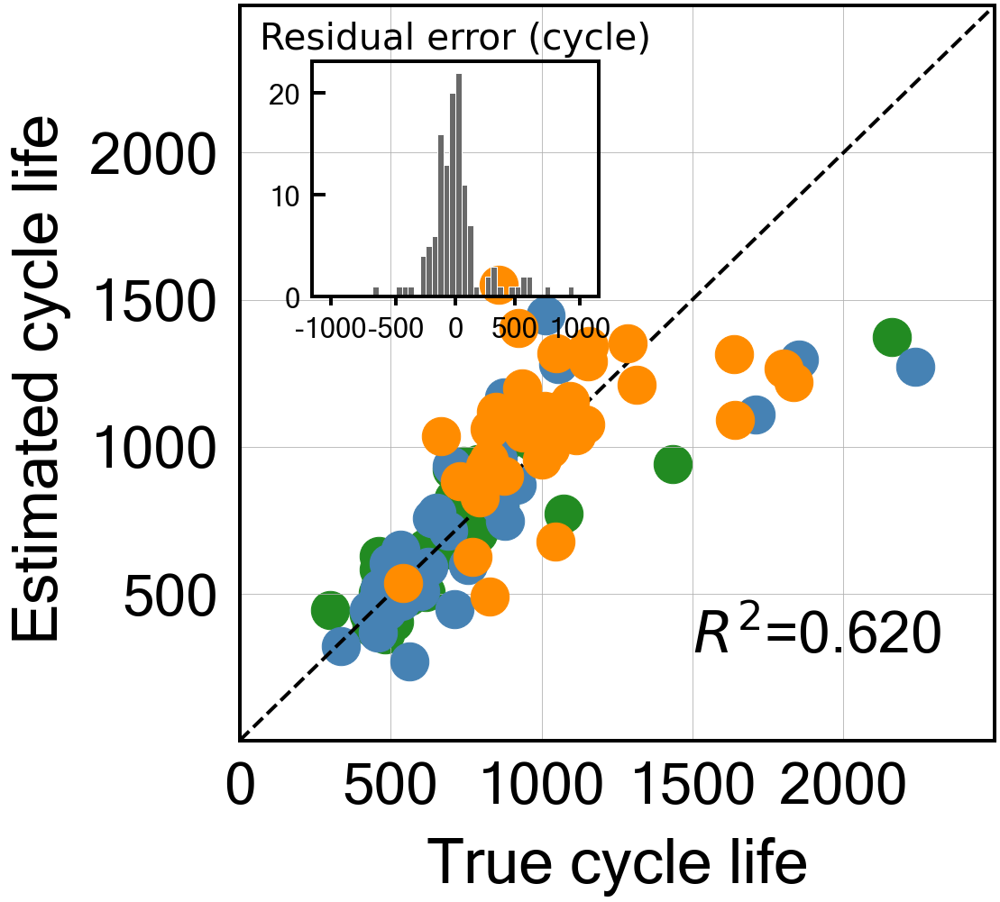


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.6
Best score obtained was: 0.14678285638497668
Cycle no: Average_2to15
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to15') : 0.022059822989057124
T_Q('Charge', 'Max-Min', 'Average_2to15') : -0.16528255503753544
T_Q('Discharge', 'Variance', 'Average_2to15') : 0.12449646992851722
dTdQ('Charge', 'Mean', 'Average_2to15') : -0.009515473110881786
dTdQ('Charge', 'Skewness', 'Average_2to15') : -0.007181470312164874
dTdQ('Charge', 'Maximum', 'Average_2to15') : -0.05778252175790884

Intercept: 2.793969897643636
r2-score: 0.710
MAE_all: 147.6
MAE_train: 108.1
MAE_test: 141.5
MAE_2ndTest: 194.4
MAPE_all: 16.4 %
MAPE_train: 14.4 %
MAPE_test: 15.9 %
MAPE_2ndTest: 18.9 %
RMSE_all: 230.3
RMSE_train: 180.4
RMSE_test: 239.7
RMSE_2ndTest: 263.4
RMSPE_all: 21.5 %
RMSPE_train: 18.4 %
RMSPE_test: 20.3 %
RMSPE_2ndTest: 25.3 %
Log-scale scores
All data r2-score: 0.71

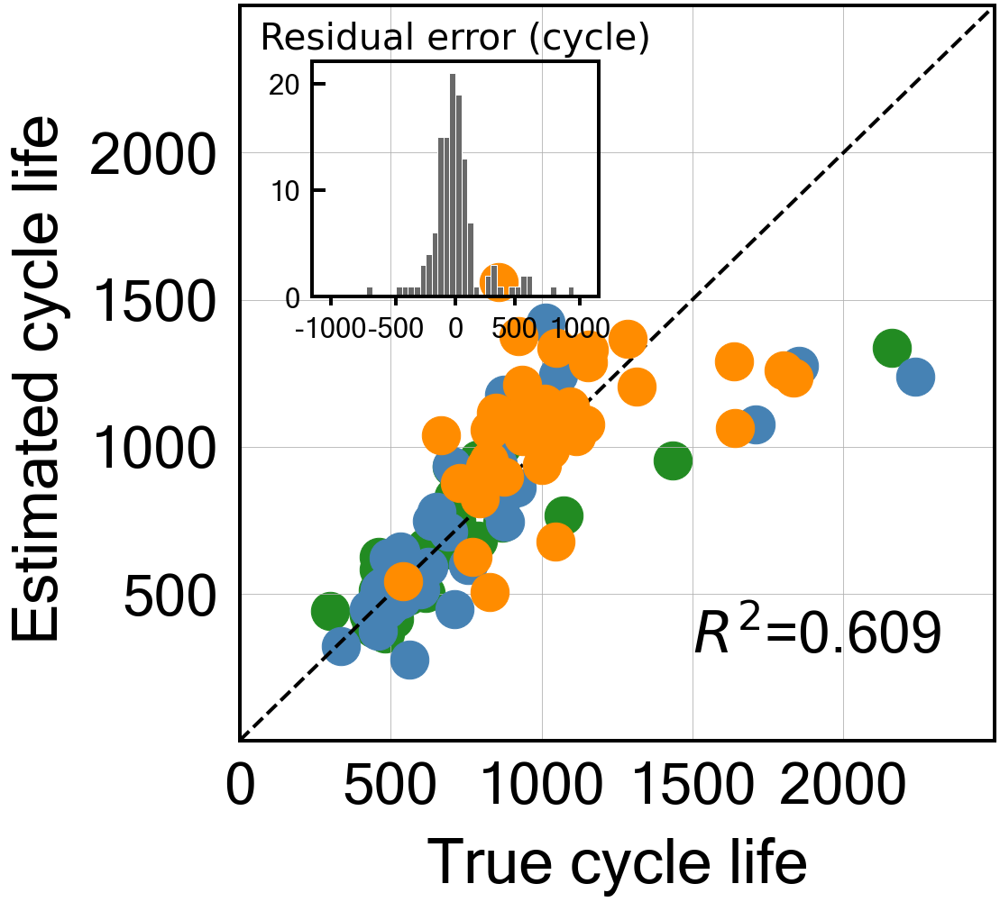


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.19259874856689108
Cycle no: Average_2to16
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to16') : 0.016933048406894757
T_Q('Charge', 'Max-Min', 'Average_2to16') : -0.16769836326816784
T_Q('Discharge', 'Variance', 'Average_2to16') : 0.13439249622883484
dTdQ('Charge', 'Mean', 'Average_2to16') : -0.011415869273787852
dTdQ('Charge', 'Skewness', 'Average_2to16') : -0.00527049865827326
dTdQ('Charge', 'Maximum', 'Average_2to16') : -0.06314943469886121

Intercept: 2.793969897643637
r2-score: 0.724
MAE_all: 145.3
MAE_train: 104.5
MAE_test: 136.7
MAE_2ndTest: 196.0
MAPE_all: 16.2 %
MAPE_train: 13.9 %
MAPE_test: 15.5 %
MAPE_2ndTest: 19.2 %
RMSE_all: 221.9
RMSE_train: 173.6
RMSE_test: 228.8
RMSE_2ndTest: 256.2
RMSPE_all: 20.8 %
RMSPE_train: 17.5 %
RMSPE_test: 19.7 %
RMSPE_2ndTest: 24.8 %
Log-scale scores
All data r2-score: 0.724

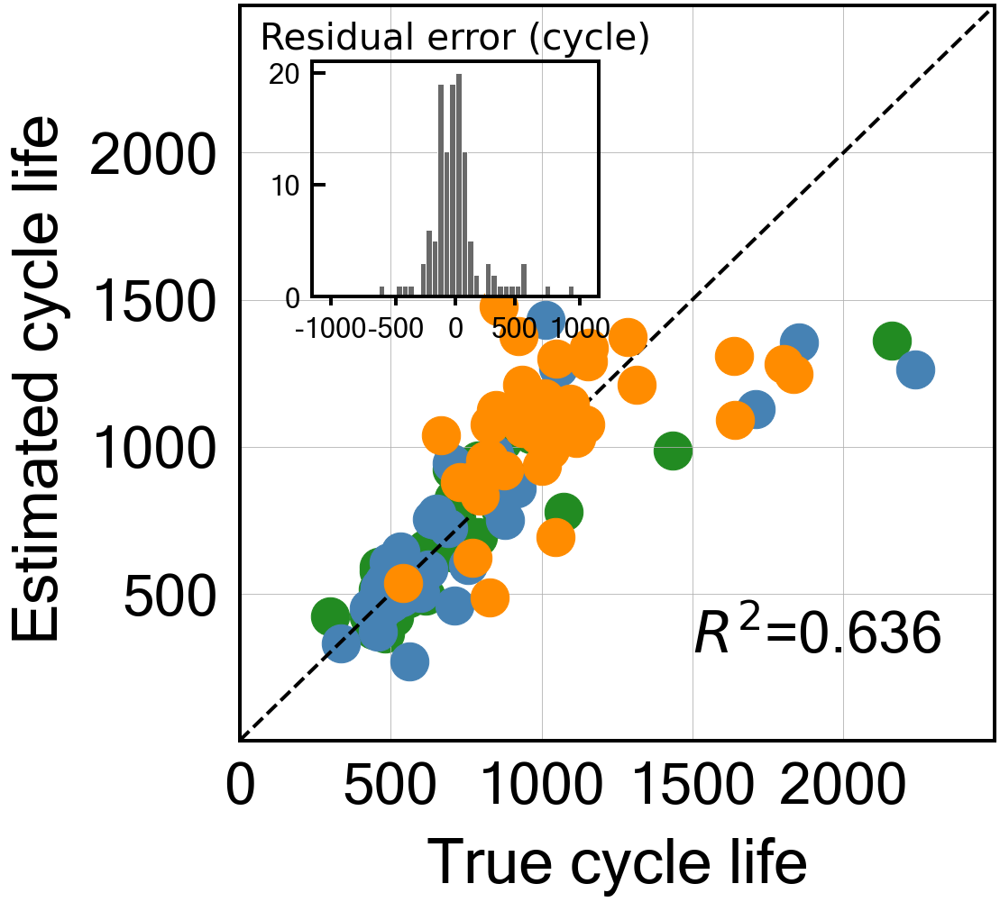


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.2161142317082677
Cycle no: Average_2to17
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to17') : 0.016305911312892683
T_Q('Charge', 'Max-Min', 'Average_2to17') : -0.16758999631134716
T_Q('Discharge', 'Variance', 'Average_2to17') : 0.1361163009725617
dTdQ('Charge', 'Mean', 'Average_2to17') : -0.011971254653025867
dTdQ('Charge', 'Skewness', 'Average_2to17') : -0.0029266487129756256
dTdQ('Charge', 'Maximum', 'Average_2to17') : -0.06528706346890564

Intercept: 2.793969897643637
r2-score: 0.731
MAE_all: 144.0
MAE_train: 103.8
MAE_test: 132.9
MAE_2ndTest: 196.8
MAPE_all: 15.9 %
MAPE_train: 13.7 %
MAPE_test: 14.9 %
MAPE_2ndTest: 19.3 %
RMSE_all: 219.4
RMSE_train: 173.8
RMSE_test: 225.5
RMSE_2ndTest: 252.4
RMSPE_all: 20.5 %
RMSPE_train: 17.3 %
RMSPE_test: 19.3 %
RMSPE_2ndTest: 24.5 %
Log-scale scores
All data r2-score: 0.731

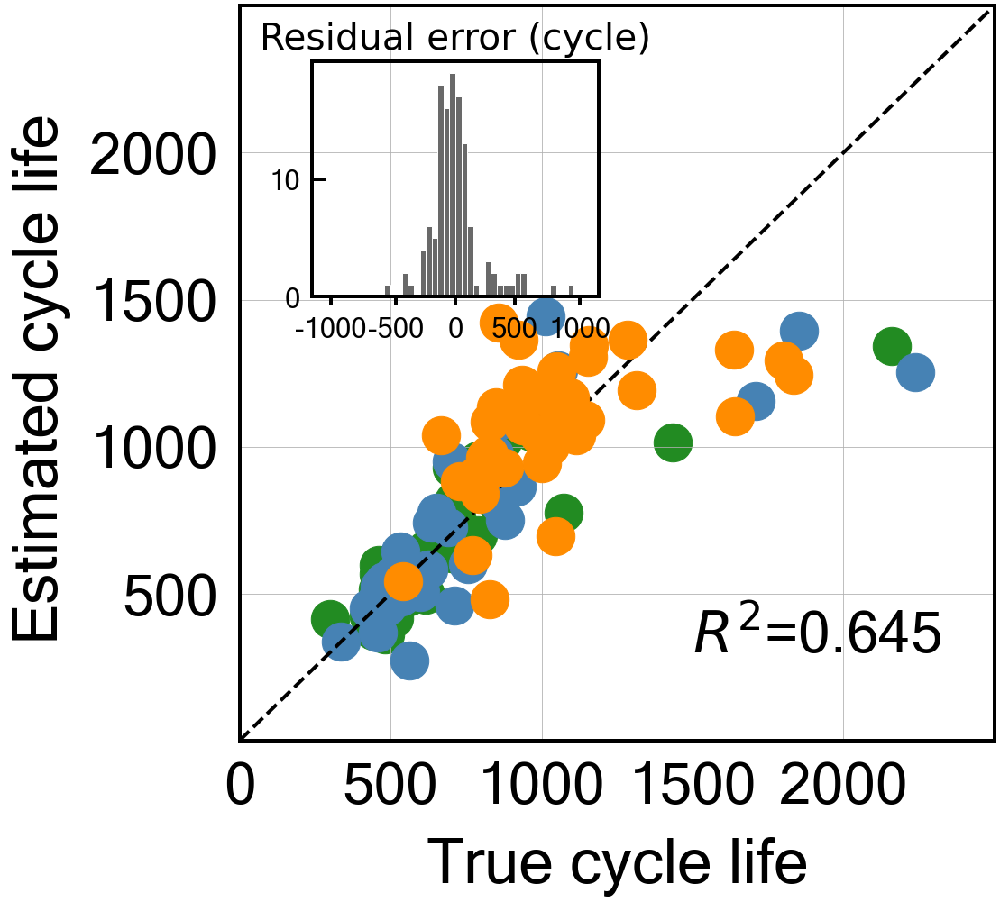


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.23667114785399357
Cycle no: Average_2to18
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to18') : 0.012558062414101
T_Q('Charge', 'Max-Min', 'Average_2to18') : -0.16876207762573112
T_Q('Discharge', 'Variance', 'Average_2to18') : 0.13938423282465467
dTdQ('Charge', 'Mean', 'Average_2to18') : -0.014409719511243506
dTdQ('Charge', 'Skewness', 'Average_2to18') : -0.000984103335163451
dTdQ('Charge', 'Maximum', 'Average_2to18') : -0.06520179926446237

Intercept: 2.793969897643637
r2-score: 0.737
MAE_all: 141.8
MAE_train: 102.7
MAE_test: 130.7
MAE_2ndTest: 193.4
MAPE_all: 15.7 %
MAPE_train: 13.5 %
MAPE_test: 14.8 %
MAPE_2ndTest: 18.9 %
RMSE_all: 215.4
RMSE_train: 170.8
RMSE_test: 219.8
RMSE_2ndTest: 249.1
RMSPE_all: 20.1 %
RMSPE_train: 17.0 %
RMSPE_test: 19.1 %
RMSPE_2ndTest: 23.8 %
Log-scale scores
All data r2-score: 0.737
T

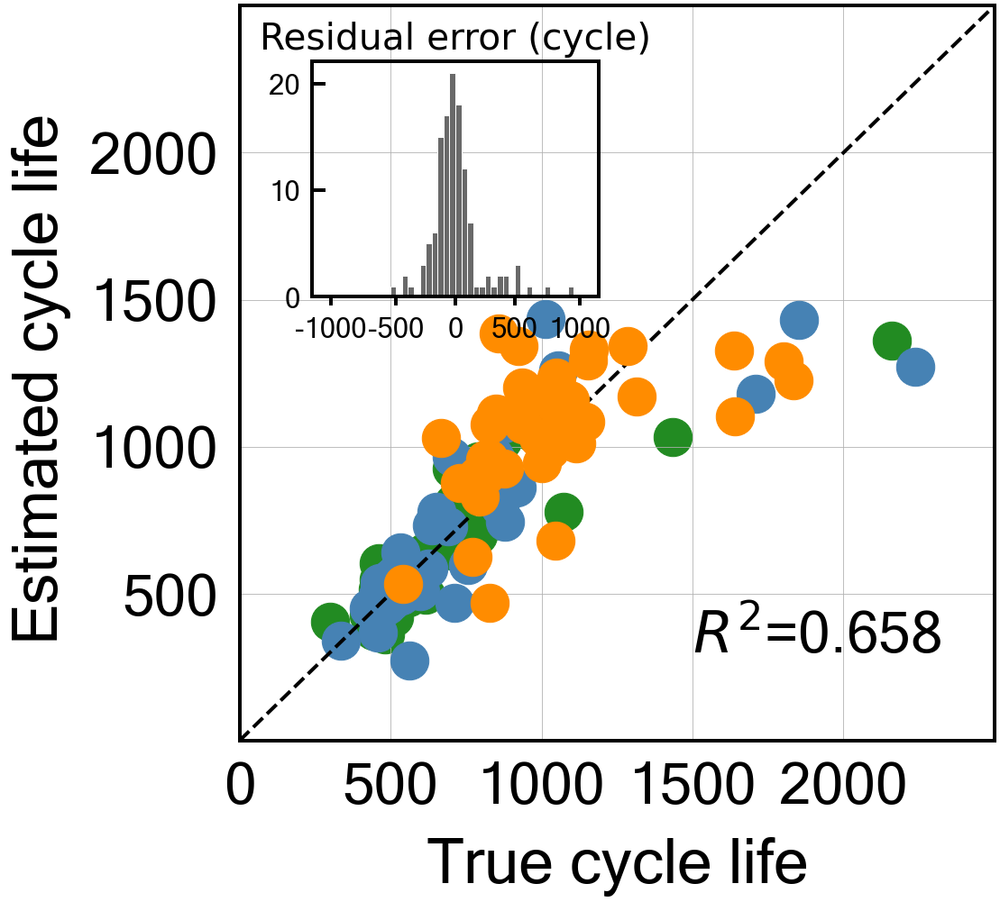


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.22909039174581158
Cycle no: Average_2to19
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to19') : 0.011977309121615662
T_Q('Charge', 'Max-Min', 'Average_2to19') : -0.1756641215919895
T_Q('Discharge', 'Variance', 'Average_2to19') : 0.14174834208497916
dTdQ('Charge', 'Mean', 'Average_2to19') : -0.009617459440376576
dTdQ('Charge', 'Skewness', 'Average_2to19') : -0.0038636611855307687
dTdQ('Charge', 'Maximum', 'Average_2to19') : -0.06336659373070432

Intercept: 2.7939698976436373
r2-score: 0.737
MAE_all: 141.9
MAE_train: 102.5
MAE_test: 131.6
MAE_2ndTest: 193.2
MAPE_all: 15.7 %
MAPE_train: 13.5 %
MAPE_test: 14.9 %
MAPE_2ndTest: 18.9 %
RMSE_all: 214.9
RMSE_train: 169.0
RMSE_test: 218.4
RMSE_2ndTest: 250.3
RMSPE_all: 20.2 %
RMSPE_train: 17.0 %
RMSPE_test: 19.3 %
RMSPE_2ndTest: 23.9 %
Log-scale scores
All data r2-score: 0.7

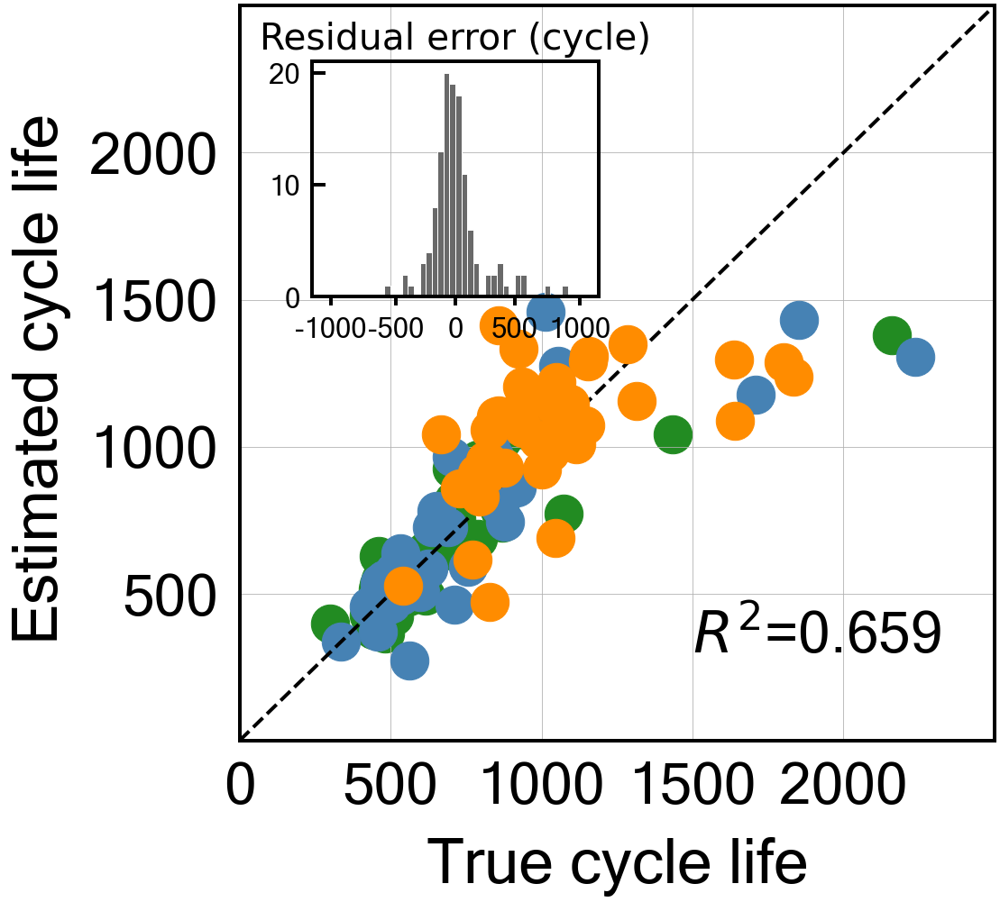


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.6
Best score obtained was: 0.24610125433172214
Cycle no: Average_2to20
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to20') : 0.011965274384069306
T_Q('Charge', 'Max-Min', 'Average_2to20') : -0.17072118988576399
T_Q('Discharge', 'Variance', 'Average_2to20') : 0.1400295979023298
dTdQ('Charge', 'Mean', 'Average_2to20') : -0.012897725335657318
dTdQ('Charge', 'Skewness', 'Average_2to20') : -0.0024436574056753667
dTdQ('Charge', 'Maximum', 'Average_2to20') : -0.06447296765781906

Intercept: 2.793969897643637
r2-score: 0.744
MAE_all: 139.9
MAE_train: 100.7
MAE_test: 130.0
MAE_2ndTest: 190.6
MAPE_all: 15.5 %
MAPE_train: 13.3 %
MAPE_test: 14.8 %
MAPE_2ndTest: 18.6 %
RMSE_all: 210.8
RMSE_train: 164.3
RMSE_test: 213.2
RMSE_2ndTest: 247.6
RMSPE_all: 19.9 %
RMSPE_train: 16.8 %
RMSPE_test: 19.0 %
RMSPE_2ndTest: 23.5 %
Log-scale scores
All data r2-score: 0.74

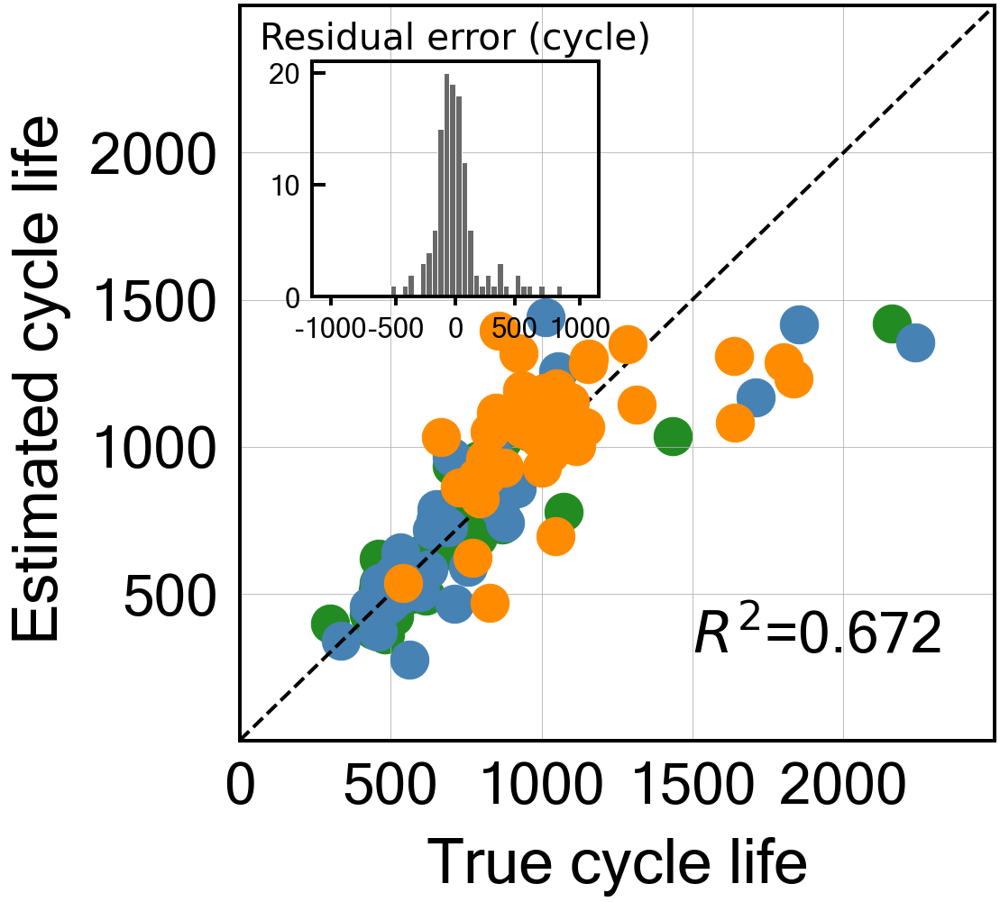


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.24541243254547673
Cycle no: Average_2to21
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to21') : 0.01238352932594789
T_Q('Charge', 'Max-Min', 'Average_2to21') : -0.16893776445079778
T_Q('Discharge', 'Variance', 'Average_2to21') : 0.14024805083543002
dTdQ('Charge', 'Mean', 'Average_2to21') : -0.013052869888817872
dTdQ('Charge', 'Skewness', 'Average_2to21') : 0.000771663157031901
dTdQ('Charge', 'Maximum', 'Average_2to21') : -0.06719213731673174

Intercept: 2.793969897643637
r2-score: 0.744
MAE_all: 140.5
MAE_train: 99.1
MAE_test: 129.6
MAE_2ndTest: 194.4
MAPE_all: 15.6 %
MAPE_train: 13.1 %
MAPE_test: 14.9 %
MAPE_2ndTest: 19.1 %
RMSE_all: 209.4
RMSE_train: 162.5
RMSE_test: 210.3
RMSE_2ndTest: 247.7
RMSPE_all: 20.1 %
RMSPE_train: 16.8 %
RMSPE_test: 19.0 %
RMSPE_2ndTest: 23.9 %
Log-scale scores
All data r2-score: 0.744
T

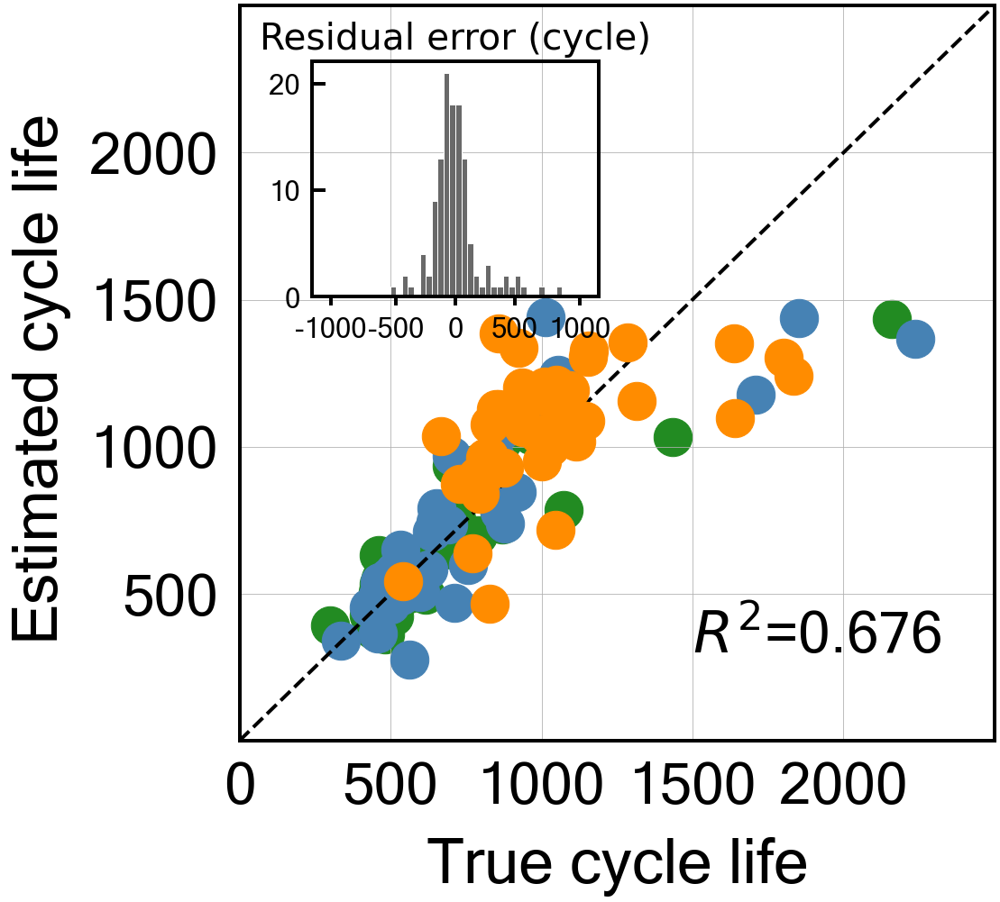


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.22564783140215705
Cycle no: Average_2to22
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to22') : 0.015551800783387266
T_Q('Charge', 'Max-Min', 'Average_2to22') : -0.1708530421412051
T_Q('Discharge', 'Variance', 'Average_2to22') : 0.1406153044817658
dTdQ('Charge', 'Mean', 'Average_2to22') : -0.010592717071972232
dTdQ('Charge', 'Skewness', 'Average_2to22') : -0.0010208658963245388
dTdQ('Charge', 'Maximum', 'Average_2to22') : -0.06671120700823646

Intercept: 2.7939698976436365
r2-score: 0.735
MAE_all: 143.9
MAE_train: 102.9
MAE_test: 132.5
MAE_2ndTest: 198.0
MAPE_all: 16.1 %
MAPE_train: 13.7 %
MAPE_test: 15.3 %
MAPE_2ndTest: 19.5 %
RMSE_all: 212.7
RMSE_train: 166.6
RMSE_test: 213.1
RMSE_2ndTest: 250.9
RMSPE_all: 20.5 %
RMSPE_train: 17.5 %
RMSPE_test: 19.2 %
RMSPE_2ndTest: 24.4 %
Log-scale scores
All data r2-score: 0.73

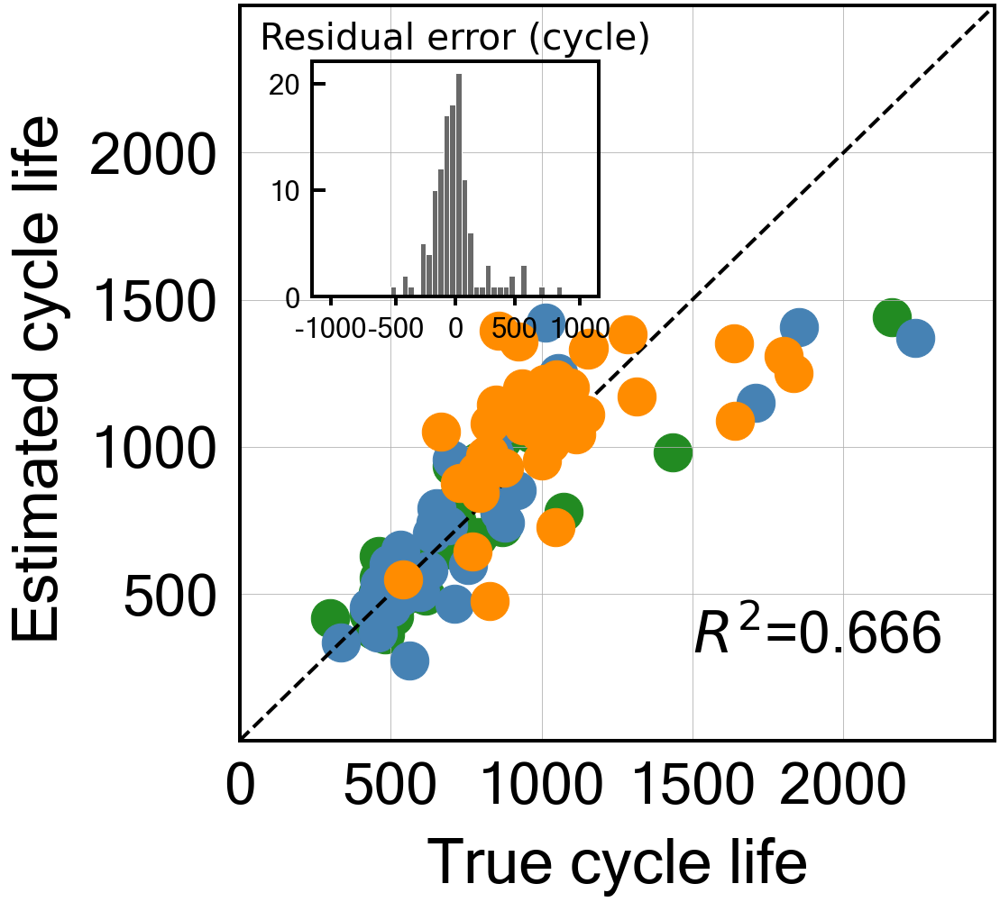


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.2059127728056772
Cycle no: Average_2to23
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to23') : 0.016578521656972087
T_Q('Charge', 'Max-Min', 'Average_2to23') : -0.17428533151778933
T_Q('Discharge', 'Variance', 'Average_2to23') : 0.1372649258666504
dTdQ('Charge', 'Mean', 'Average_2to23') : -0.007015153461828901
dTdQ('Charge', 'Skewness', 'Average_2to23') : -0.003922198034524517
dTdQ('Charge', 'Maximum', 'Average_2to23') : -0.06243413658236061

Intercept: 2.793969897643637
r2-score: 0.733
MAE_all: 145.1
MAE_train: 105.0
MAE_test: 133.8
MAE_2ndTest: 198.0
MAPE_all: 16.2 %
MAPE_train: 14.0 %
MAPE_test: 15.3 %
MAPE_2ndTest: 19.4 %
RMSE_all: 215.5
RMSE_train: 168.4
RMSE_test: 216.6
RMSE_2ndTest: 254.1
RMSPE_all: 20.7 %
RMSPE_train: 17.8 %
RMSPE_test: 19.3 %
RMSPE_2ndTest: 24.5 %
Log-scale scores
All data r2-score: 0.733


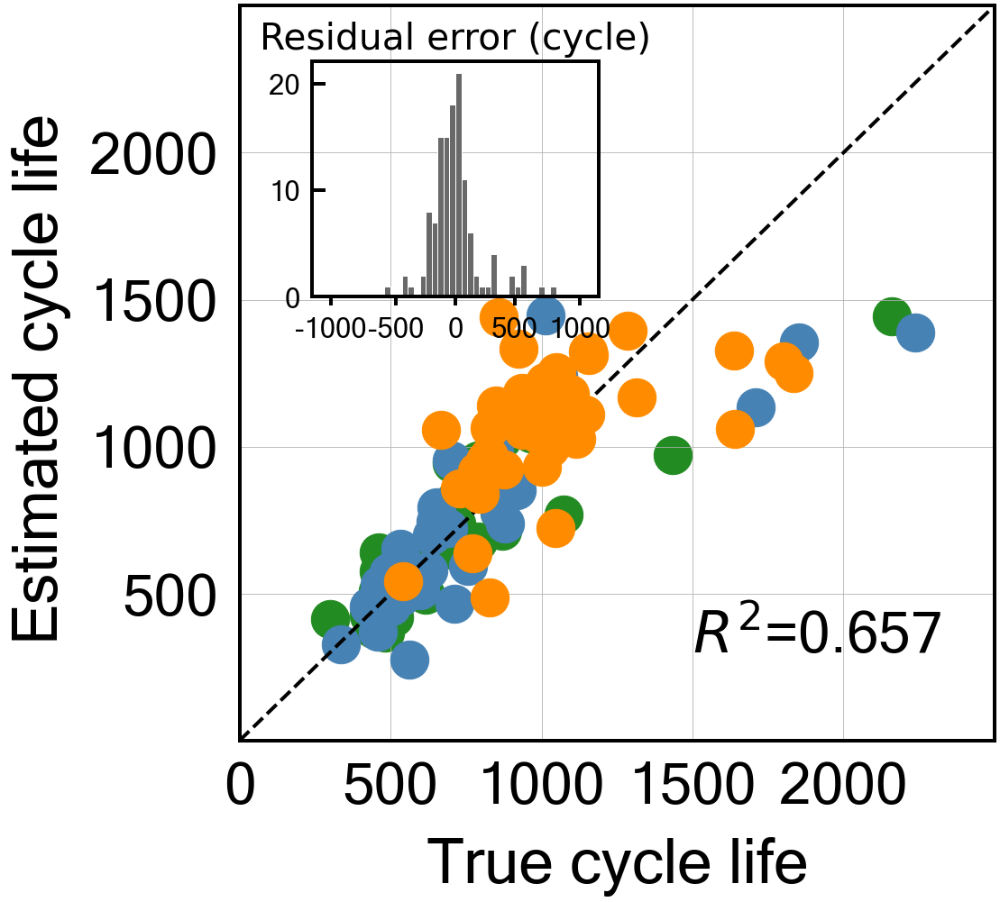


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.1813210570030359
Cycle no: Average_2to24
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to24') : 0.01741847310924558
T_Q('Charge', 'Max-Min', 'Average_2to24') : -0.17211159358246356
T_Q('Discharge', 'Variance', 'Average_2to24') : 0.13480351863094242
dTdQ('Charge', 'Mean', 'Average_2to24') : -0.007068445947256803
dTdQ('Charge', 'Skewness', 'Average_2to24') : -0.004211775439923548
dTdQ('Charge', 'Maximum', 'Average_2to24') : -0.062208138984915916

Intercept: 2.7939698976436373
r2-score: 0.729
MAE_all: 146.6
MAE_train: 104.9
MAE_test: 135.1
MAE_2ndTest: 201.4
MAPE_all: 16.4 %
MAPE_train: 14.0 %
MAPE_test: 15.5 %
MAPE_2ndTest: 19.8 %
RMSE_all: 216.5
RMSE_train: 166.5
RMSE_test: 216.4
RMSE_2ndTest: 258.0
RMSPE_all: 21.0 %
RMSPE_train: 17.9 %
RMSPE_test: 19.6 %
RMSPE_2ndTest: 25.1 %
Log-scale scores
All data r2-score: 0.72

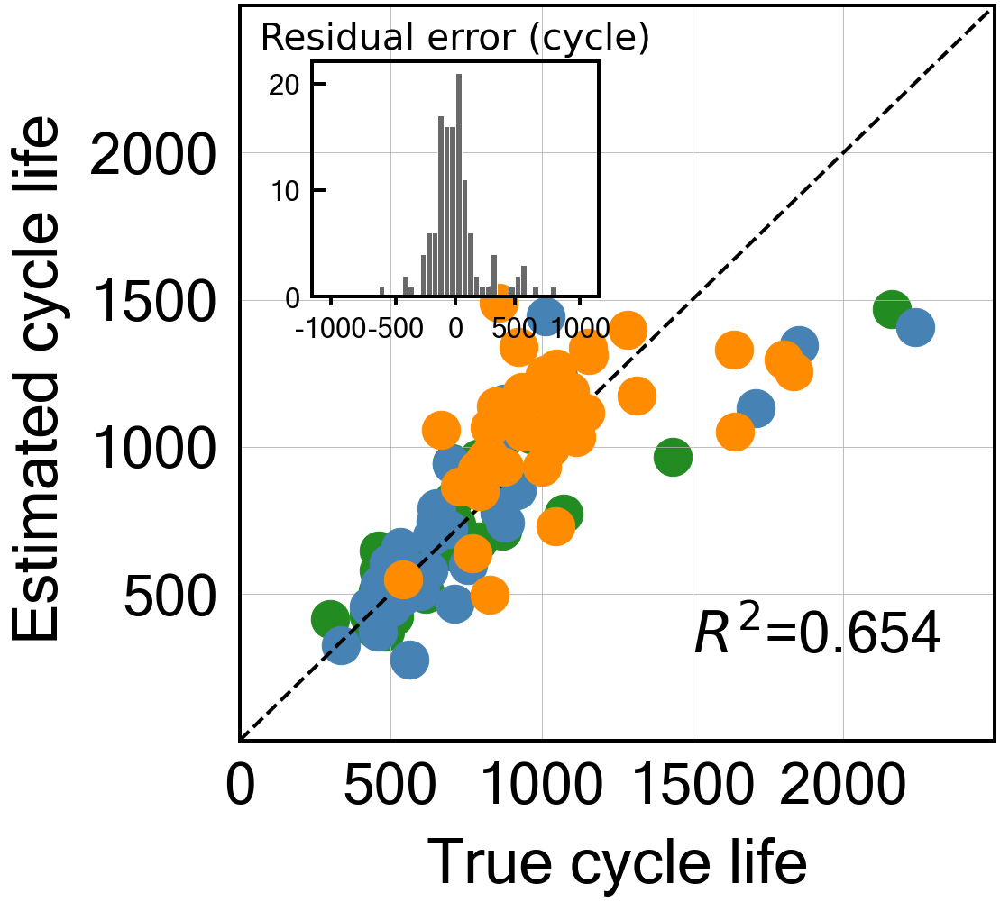


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.16089513063924166
Cycle no: Average_2to25
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to25') : 0.01845862412428249
T_Q('Charge', 'Max-Min', 'Average_2to25') : -0.1772972662629544
T_Q('Discharge', 'Variance', 'Average_2to25') : 0.13636209166778543
dTdQ('Charge', 'Mean', 'Average_2to25') : -0.002847747346533564
dTdQ('Charge', 'Skewness', 'Average_2to25') : -0.005124511004740656
dTdQ('Charge', 'Maximum', 'Average_2to25') : -0.061787698719092045

Intercept: 2.793969897643637
r2-score: 0.724
MAE_all: 148.4
MAE_train: 107.1
MAE_test: 135.5
MAE_2ndTest: 204.4
MAPE_all: 16.6 %
MAPE_train: 14.4 %
MAPE_test: 15.5 %
MAPE_2ndTest: 20.1 %
RMSE_all: 218.7
RMSE_train: 169.1
RMSE_test: 217.3
RMSE_2ndTest: 261.2
RMSPE_all: 21.3 %
RMSPE_train: 18.2 %
RMSPE_test: 19.5 %
RMSPE_2ndTest: 25.5 %
Log-scale scores
All data r2-score: 0.724

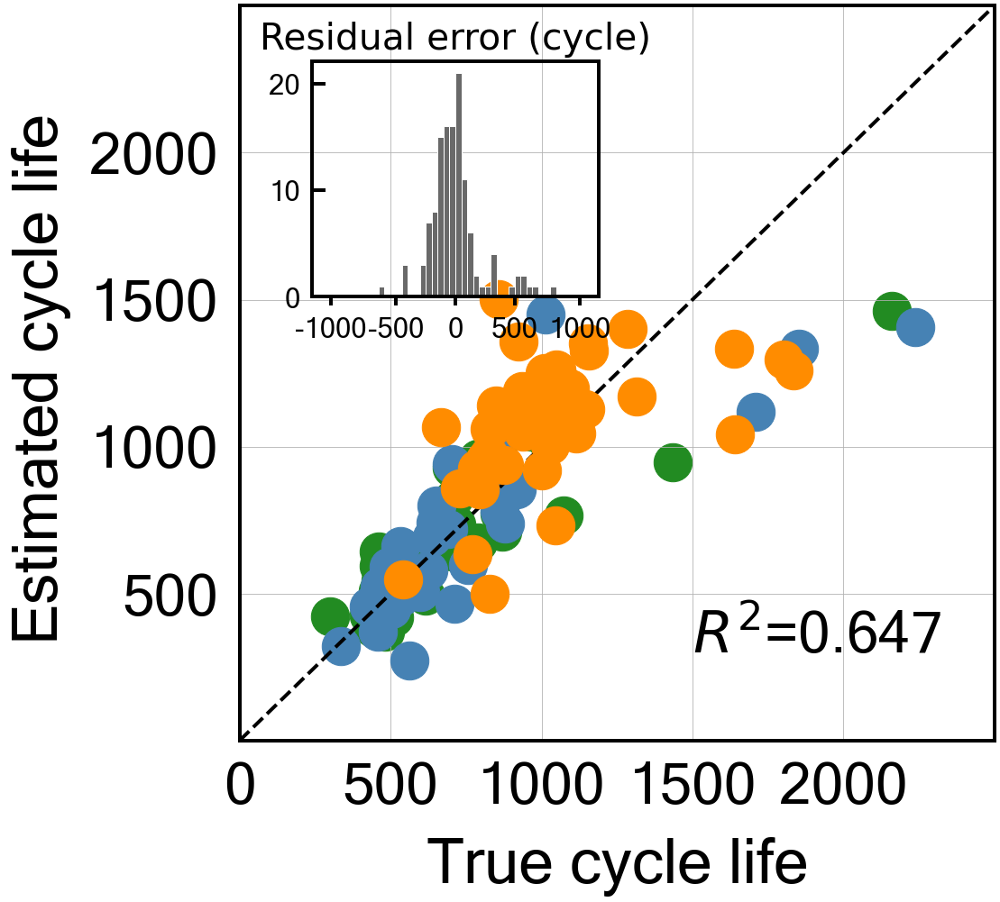


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.14181307055421966
Cycle no: Average_2to26
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to26') : 0.01919627482295054
T_Q('Charge', 'Max-Min', 'Average_2to26') : -0.17369699296451105
T_Q('Discharge', 'Variance', 'Average_2to26') : 0.13302895171232576
dTdQ('Charge', 'Mean', 'Average_2to26') : -0.003973380986487588
dTdQ('Charge', 'Skewness', 'Average_2to26') : -0.0034068792190131234
dTdQ('Charge', 'Maximum', 'Average_2to26') : -0.06188531986354069

Intercept: 2.793969897643637
r2-score: 0.721
MAE_all: 149.1
MAE_train: 107.4
MAE_test: 135.5
MAE_2ndTest: 206.2
MAPE_all: 16.7 %
MAPE_train: 14.4 %
MAPE_test: 15.6 %
MAPE_2ndTest: 20.4 %
RMSE_all: 219.8
RMSE_train: 169.7
RMSE_test: 216.8
RMSE_2ndTest: 264.1
RMSPE_all: 21.5 %
RMSPE_train: 18.3 %
RMSPE_test: 19.6 %
RMSPE_2ndTest: 26.0 %
Log-scale scores
All data r2-score: 0.72

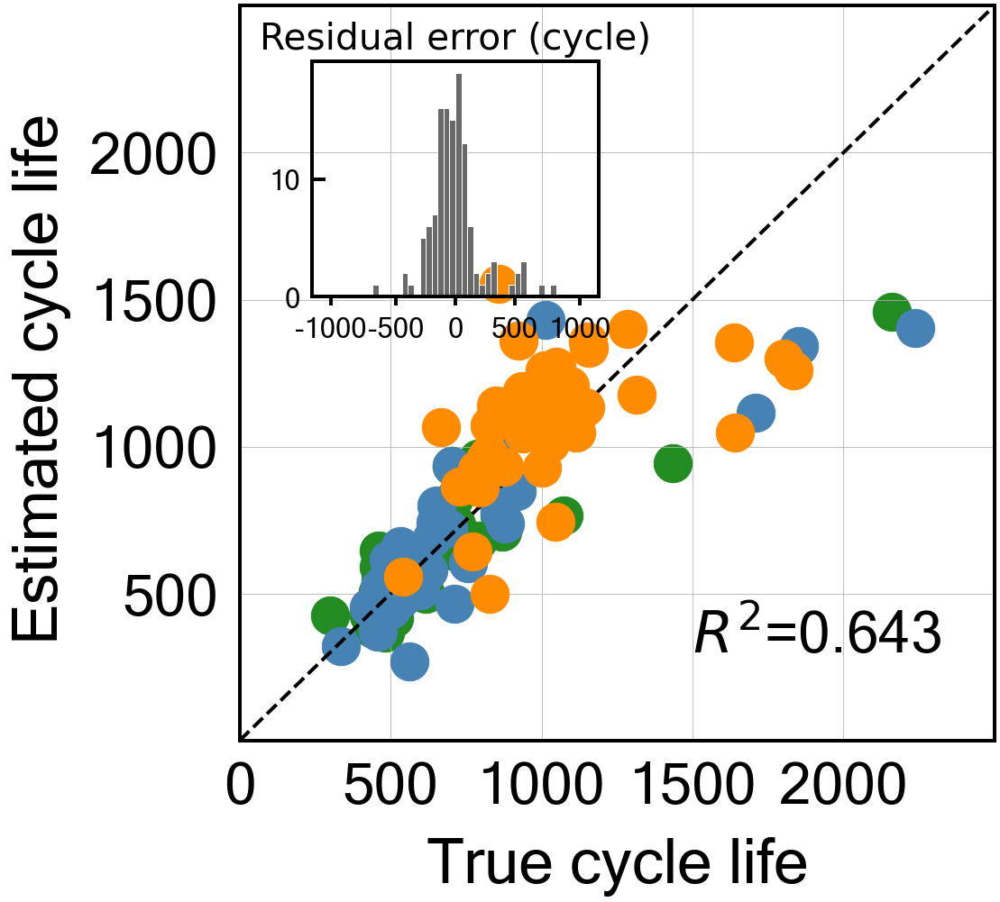


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.14794065287258762
Cycle no: Average_2to27
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to27') : 0.019416108817053662
T_Q('Charge', 'Max-Min', 'Average_2to27') : -0.17417213249644764
T_Q('Discharge', 'Variance', 'Average_2to27') : 0.1333180993035332
dTdQ('Charge', 'Mean', 'Average_2to27') : -0.0037841403831374012
dTdQ('Charge', 'Skewness', 'Average_2to27') : -0.0038490317941625896
dTdQ('Charge', 'Maximum', 'Average_2to27') : -0.06177606507831614

Intercept: 2.7939698976436373
r2-score: 0.721
MAE_all: 148.9
MAE_train: 107.9
MAE_test: 135.4
MAE_2ndTest: 205.1
MAPE_all: 16.7 %
MAPE_train: 14.5 %
MAPE_test: 15.6 %
MAPE_2ndTest: 20.2 %
RMSE_all: 219.7
RMSE_train: 170.1
RMSE_test: 217.1
RMSE_2ndTest: 263.2
RMSPE_all: 21.4 %
RMSPE_train: 18.4 %
RMSPE_test: 19.6 %
RMSPE_2ndTest: 25.7 %
Log-scale scores
All data r2-score: 0.

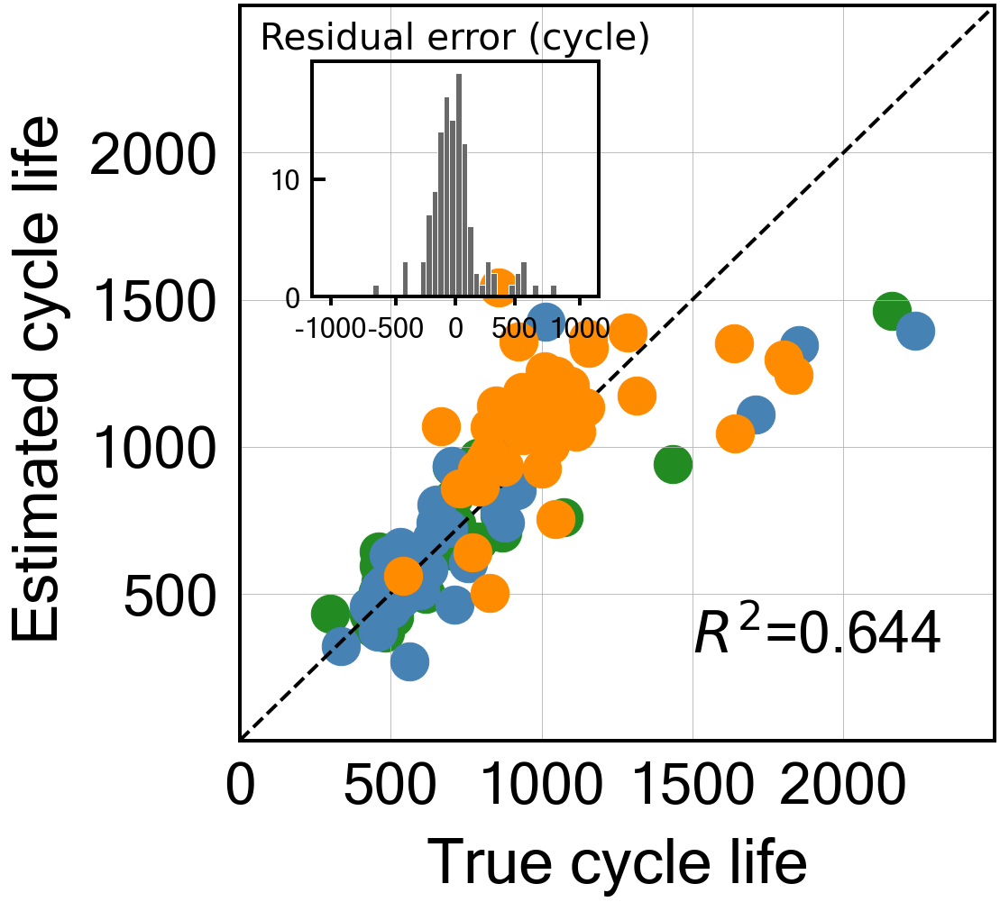


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.14270000318232523
Cycle no: Average_2to28
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to28') : 0.02009977611355975
T_Q('Charge', 'Max-Min', 'Average_2to28') : -0.17877160408401707
T_Q('Discharge', 'Variance', 'Average_2to28') : 0.13638766954319917
dTdQ('Charge', 'Mean', 'Average_2to28') : -0.0014881679150720894
dTdQ('Charge', 'Skewness', 'Average_2to28') : -0.003878294810038133
dTdQ('Charge', 'Maximum', 'Average_2to28') : -0.06267280634781827

Intercept: 2.793969897643637
r2-score: 0.723
MAE_all: 148.8
MAE_train: 107.8
MAE_test: 133.3
MAE_2ndTest: 207.2
MAPE_all: 16.7 %
MAPE_train: 14.4 %
MAPE_test: 15.1 %
MAPE_2ndTest: 20.5 %
RMSE_all: 219.4
RMSE_train: 169.2
RMSE_test: 216.0
RMSE_2ndTest: 264.0
RMSPE_all: 21.3 %
RMSPE_train: 18.3 %
RMSPE_test: 19.1 %
RMSPE_2ndTest: 25.9 %
Log-scale scores
All data r2-score: 0.72

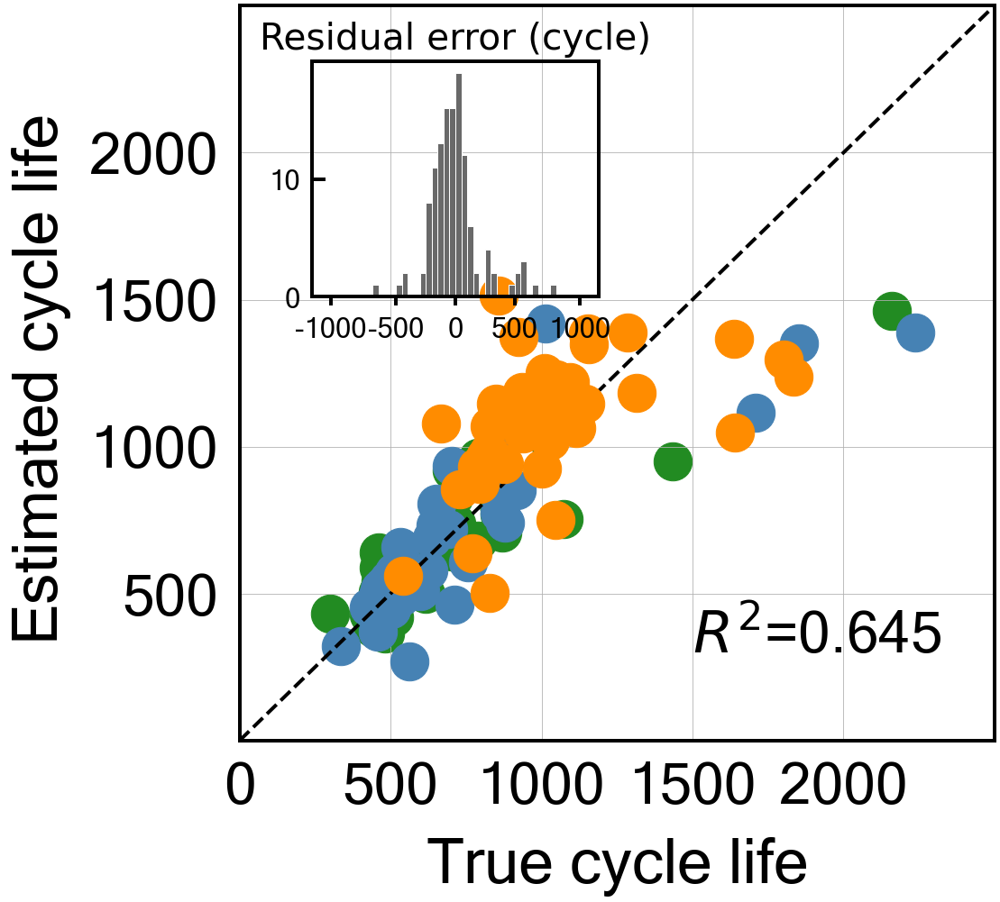


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.14319439236071219
Cycle no: Average_2to29
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to29') : 0.01996443021754755
T_Q('Charge', 'Max-Min', 'Average_2to29') : -0.17567988664631026
T_Q('Discharge', 'Variance', 'Average_2to29') : 0.13652025550910088
dTdQ('Charge', 'Mean', 'Average_2to29') : -0.0033443443692794815
dTdQ('Charge', 'Skewness', 'Average_2to29') : -0.0008843674305026319
dTdQ('Charge', 'Maximum', 'Average_2to29') : -0.06563948936874628

Intercept: 2.793969897643637
r2-score: 0.724
MAE_all: 149.1
MAE_train: 106.3
MAE_test: 132.2
MAE_2ndTest: 210.9
MAPE_all: 16.7 %
MAPE_train: 14.3 %
MAPE_test: 15.1 %
MAPE_2ndTest: 21.0 %
RMSE_all: 217.9
RMSE_train: 166.8
RMSE_test: 213.5
RMSE_2ndTest: 263.9
RMSPE_all: 21.3 %
RMSPE_train: 18.1 %
RMSPE_test: 19.1 %
RMSPE_2ndTest: 26.1 %
Log-scale scores
All data r2-score: 0.7

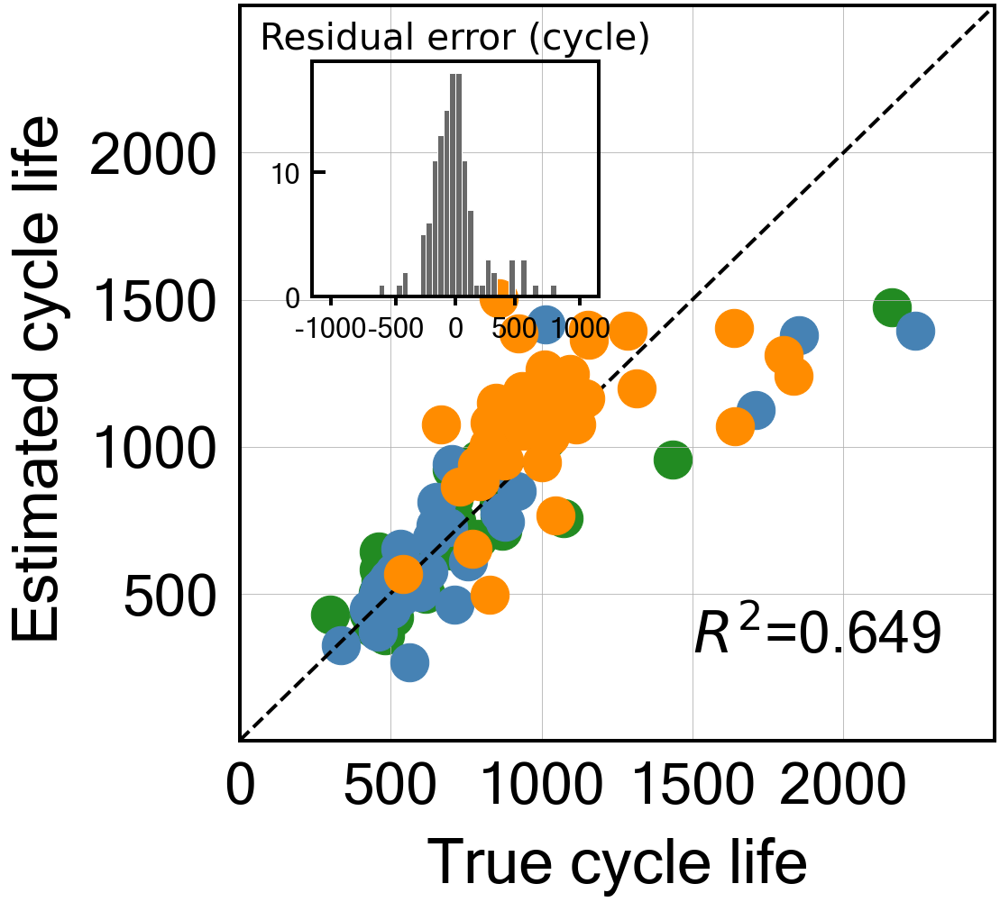


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.21260044752448637
Cycle no: Average_2to30
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to30') : 0.014542087130943421
T_Q('Charge', 'Max-Min', 'Average_2to30') : -0.17266535376667086
T_Q('Discharge', 'Variance', 'Average_2to30') : 0.1438034958389161
dTdQ('Charge', 'Mean', 'Average_2to30') : -0.012018004974666591
dTdQ('Charge', 'Skewness', 'Average_2to30') : -0.0
dTdQ('Charge', 'Maximum', 'Average_2to30') : -0.06576202559529305

Intercept: 2.793969897643637
r2-score: 0.736
MAE_all: 143.5
MAE_train: 105.0
MAE_test: 130.5
MAE_2ndTest: 196.5
MAPE_all: 16.0 %
MAPE_train: 14.0 %
MAPE_test: 14.9 %
MAPE_2ndTest: 19.3 %
RMSE_all: 212.2
RMSE_train: 165.1
RMSE_test: 210.4
RMSE_2ndTest: 253.0
RMSPE_all: 20.5 %
RMSPE_train: 17.9 %
RMSPE_test: 18.9 %
RMSPE_2ndTest: 24.2 %
Log-scale scores
All data r2-score: 0.736
Train data r2-sc

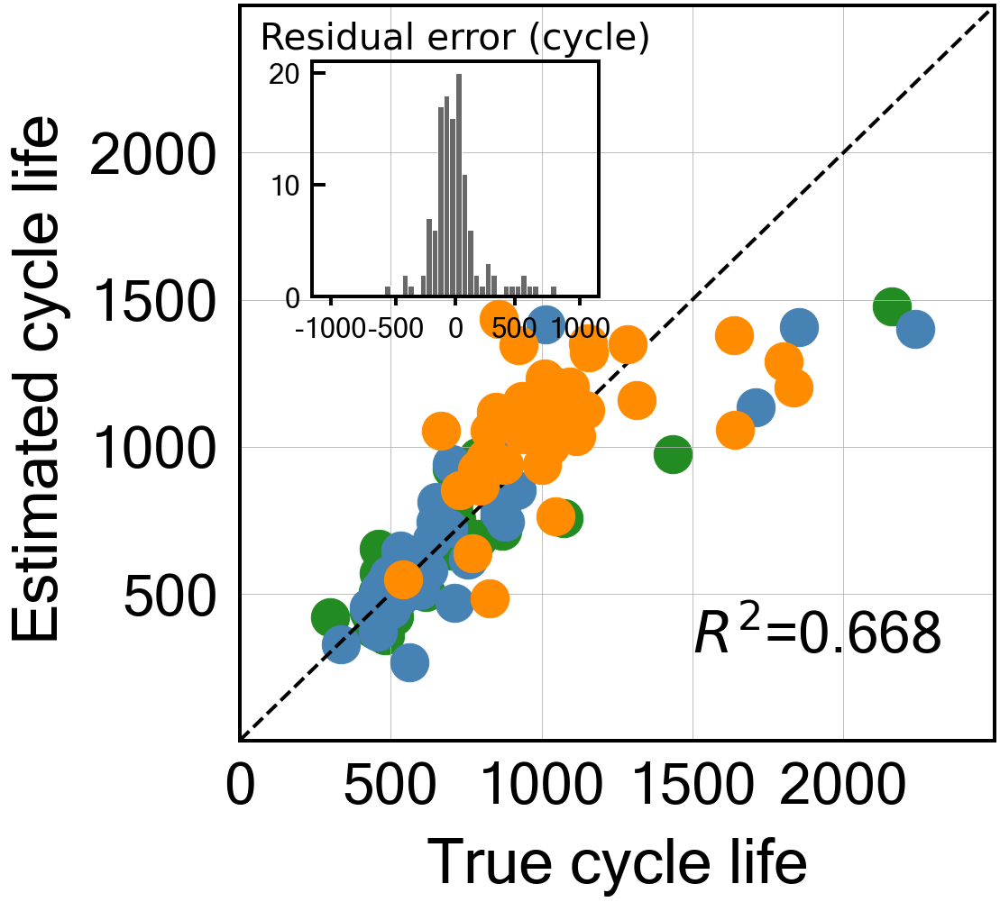


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.23266694512573127
Cycle no: Average_2to31
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to31') : 0.012903851986021769
T_Q('Charge', 'Max-Min', 'Average_2to31') : -0.17109536458742128
T_Q('Discharge', 'Variance', 'Average_2to31') : 0.14689127271508384
dTdQ('Charge', 'Mean', 'Average_2to31') : -0.016286133634899676
dTdQ('Charge', 'Skewness', 'Average_2to31') : -0.00020486677485741307
dTdQ('Charge', 'Maximum', 'Average_2to31') : -0.06600842032325899

Intercept: 2.793969897643637
r2-score: 0.740
MAE_all: 141.1
MAE_train: 105.0
MAE_test: 128.8
MAE_2ndTest: 191.1
MAPE_all: 15.7 %
MAPE_train: 14.0 %
MAPE_test: 14.6 %
MAPE_2ndTest: 18.6 %
RMSE_all: 210.7
RMSE_train: 165.4
RMSE_test: 209.5
RMSE_2ndTest: 249.8
RMSPE_all: 20.2 %
RMSPE_train: 17.8 %
RMSPE_test: 18.7 %
RMSPE_2ndTest: 23.5 %
Log-scale scores
All data r2-score: 0.

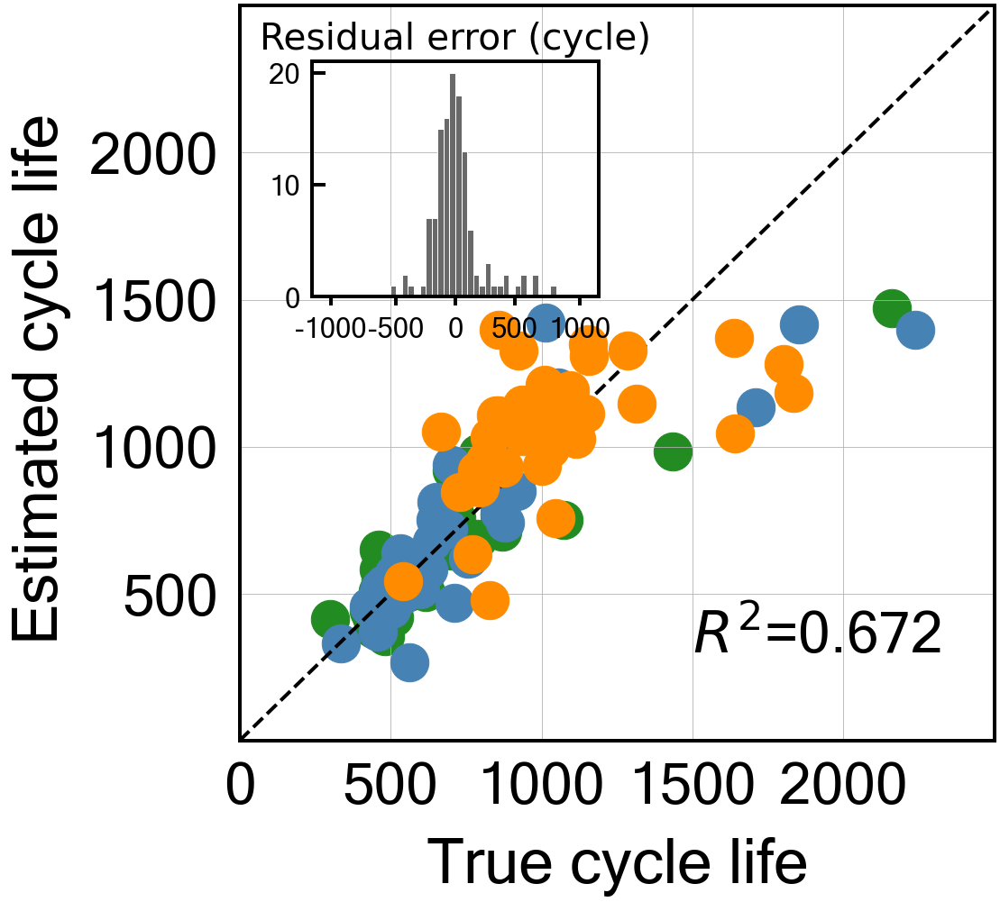


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.6
Best score obtained was: 0.22945471886782431
Cycle no: Average_2to32
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to32') : 0.011865431361580314
T_Q('Charge', 'Max-Min', 'Average_2to32') : -0.17252426143689323
T_Q('Discharge', 'Variance', 'Average_2to32') : 0.14787331893706335
dTdQ('Charge', 'Mean', 'Average_2to32') : -0.015728871631440346
dTdQ('Charge', 'Skewness', 'Average_2to32') : -0.0017950299380137843
dTdQ('Charge', 'Maximum', 'Average_2to32') : -0.0654658962229999

Intercept: 2.793969897643637
r2-score: 0.738
MAE_all: 140.8
MAE_train: 104.8
MAE_test: 128.8
MAE_2ndTest: 190.2
MAPE_all: 15.7 %
MAPE_train: 14.0 %
MAPE_test: 14.6 %
MAPE_2ndTest: 18.5 %
RMSE_all: 211.2
RMSE_train: 164.7
RMSE_test: 210.8
RMSE_2ndTest: 250.3
RMSPE_all: 20.1 %
RMSPE_train: 17.8 %
RMSPE_test: 18.8 %
RMSPE_2ndTest: 23.5 %
Log-scale scores
All data r2-score: 0.73

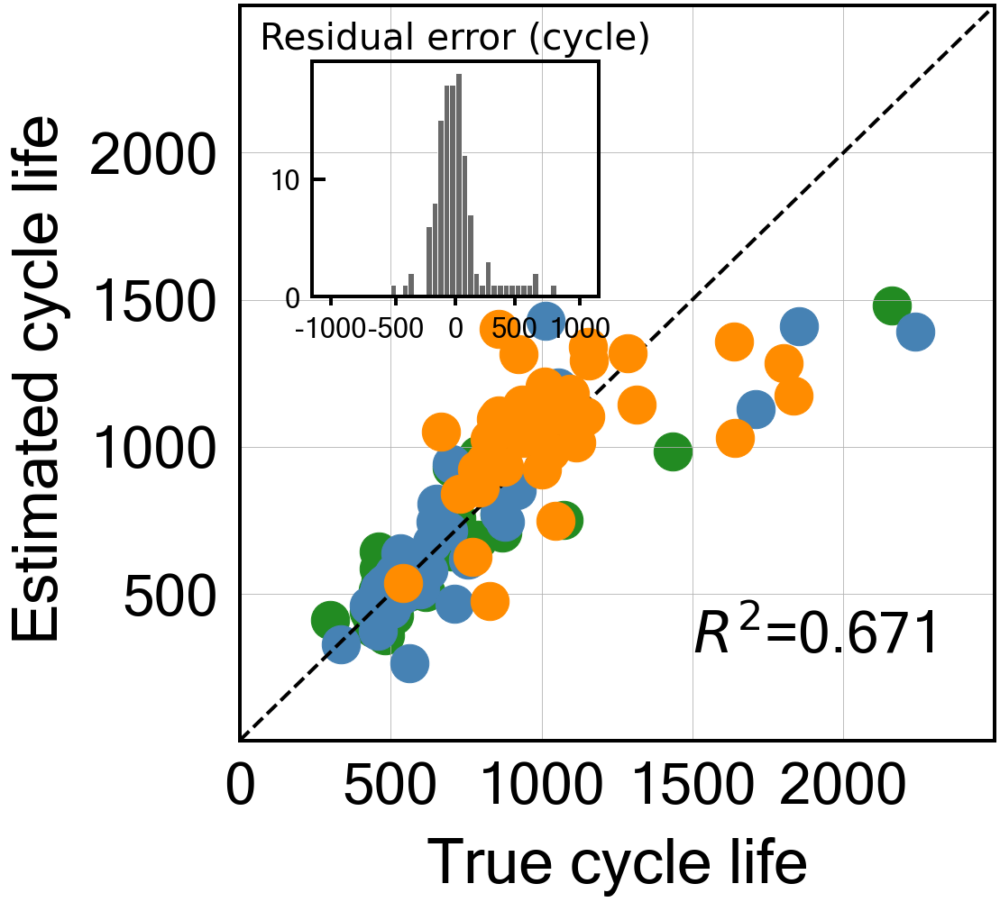


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.6
Best score obtained was: 0.21959882484579318
Cycle no: Average_2to33
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to33') : 0.010667060898383408
T_Q('Charge', 'Max-Min', 'Average_2to33') : -0.17297767663423677
T_Q('Discharge', 'Variance', 'Average_2to33') : 0.14871896115574187
dTdQ('Charge', 'Mean', 'Average_2to33') : -0.015008408203983241
dTdQ('Charge', 'Skewness', 'Average_2to33') : -0.0009753733332644306
dTdQ('Charge', 'Maximum', 'Average_2to33') : -0.06667616033506654

Intercept: 2.793969897643637
r2-score: 0.739
MAE_all: 141.0
MAE_train: 103.0
MAE_test: 128.1
MAE_2ndTest: 193.5
MAPE_all: 15.7 %
MAPE_train: 13.7 %
MAPE_test: 14.6 %
MAPE_2ndTest: 18.9 %
RMSE_all: 210.3
RMSE_train: 162.2
RMSE_test: 208.3
RMSE_2ndTest: 251.9
RMSPE_all: 20.2 %
RMSPE_train: 17.5 %
RMSPE_test: 18.8 %
RMSPE_2ndTest: 23.8 %
Log-scale scores
All data r2-score: 0.7

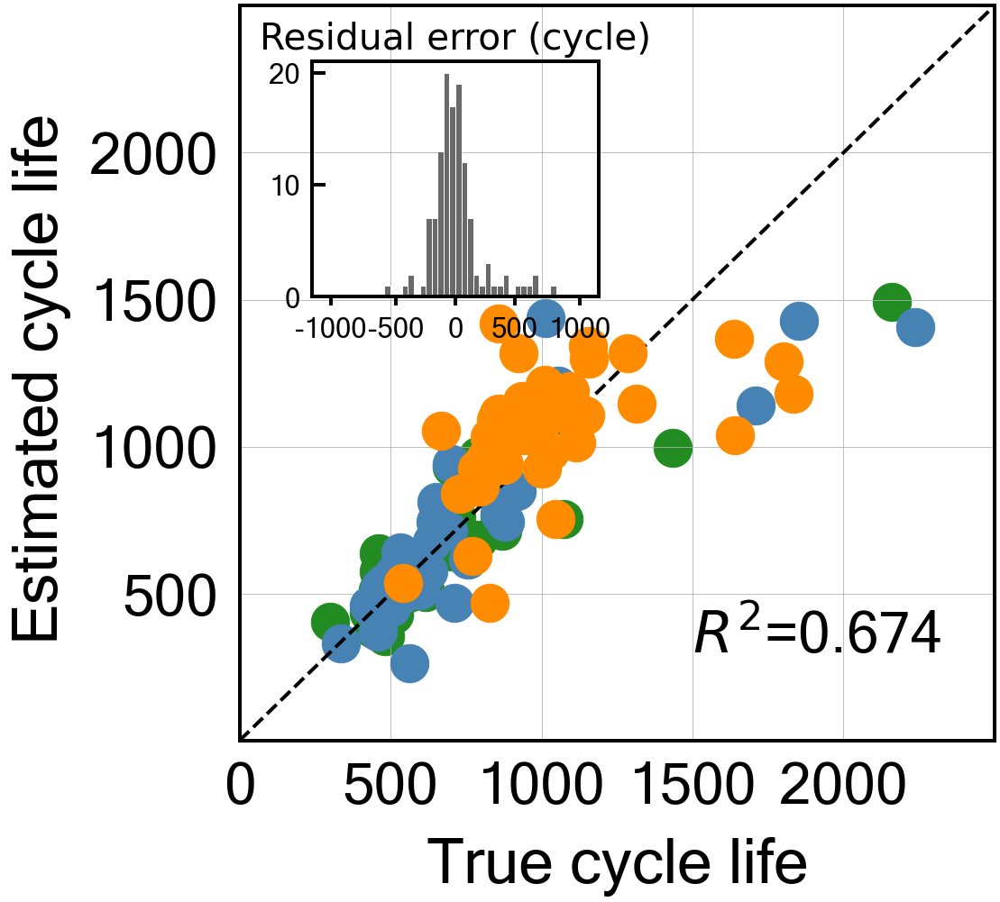


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.20353101622404468
Cycle no: Average_2to34
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to34') : 0.012618959025236598
T_Q('Charge', 'Max-Min', 'Average_2to34') : -0.17202794822016612
T_Q('Discharge', 'Variance', 'Average_2to34') : 0.1463981788507612
dTdQ('Charge', 'Mean', 'Average_2to34') : -0.013310490923899626
dTdQ('Charge', 'Skewness', 'Average_2to34') : -0.0
dTdQ('Charge', 'Maximum', 'Average_2to34') : -0.0686435365228765

Intercept: 2.7939698976436365
r2-score: 0.737
MAE_all: 142.3
MAE_train: 102.0
MAE_test: 127.2
MAE_2ndTest: 199.4
MAPE_all: 15.9 %
MAPE_train: 13.6 %
MAPE_test: 14.5 %
MAPE_2ndTest: 19.6 %
RMSE_all: 210.4
RMSE_train: 160.5
RMSE_test: 206.9
RMSE_2ndTest: 254.4
RMSPE_all: 20.4 %
RMSPE_train: 17.4 %
RMSPE_test: 18.7 %
RMSPE_2ndTest: 24.5 %
Log-scale scores
All data r2-score: 0.737
Train data r2-sc

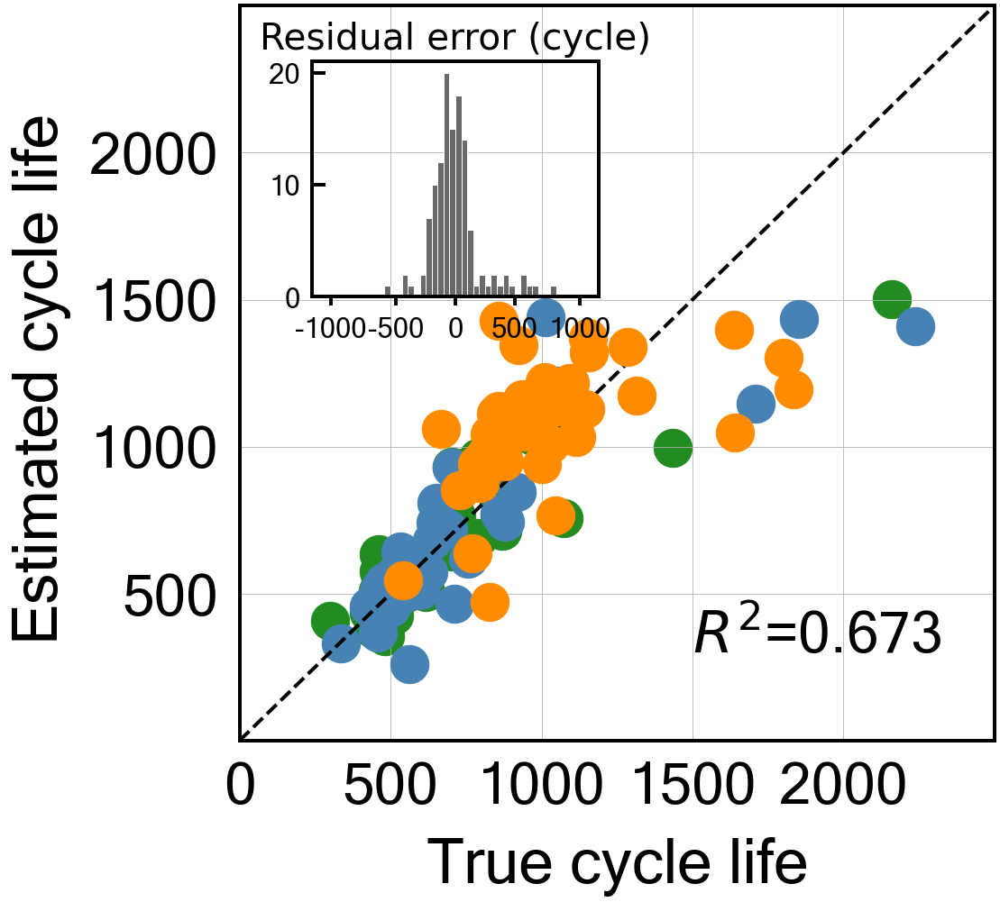


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.6
Best score obtained was: 0.21865126018926595
Cycle no: Average_2to35
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to35') : 0.011025606460908745
T_Q('Charge', 'Max-Min', 'Average_2to35') : -0.16848725081767693
T_Q('Discharge', 'Variance', 'Average_2to35') : 0.14604096686419174
dTdQ('Charge', 'Mean', 'Average_2to35') : -0.01632331350496188
dTdQ('Charge', 'Skewness', 'Average_2to35') : 0.00163803997599273
dTdQ('Charge', 'Maximum', 'Average_2to35') : -0.06912440821223148

Intercept: 2.793969897643637
r2-score: 0.741
MAE_all: 140.3
MAE_train: 101.3
MAE_test: 125.2
MAE_2ndTest: 196.1
MAPE_all: 15.6 %
MAPE_train: 13.5 %
MAPE_test: 14.3 %
MAPE_2ndTest: 19.2 %
RMSE_all: 207.9
RMSE_train: 158.9
RMSE_test: 203.6
RMSE_2ndTest: 252.0
RMSPE_all: 20.2 %
RMSPE_train: 17.2 %
RMSPE_test: 18.6 %
RMSPE_2ndTest: 24.1 %
Log-scale scores
All data r2-score: 0.741
T

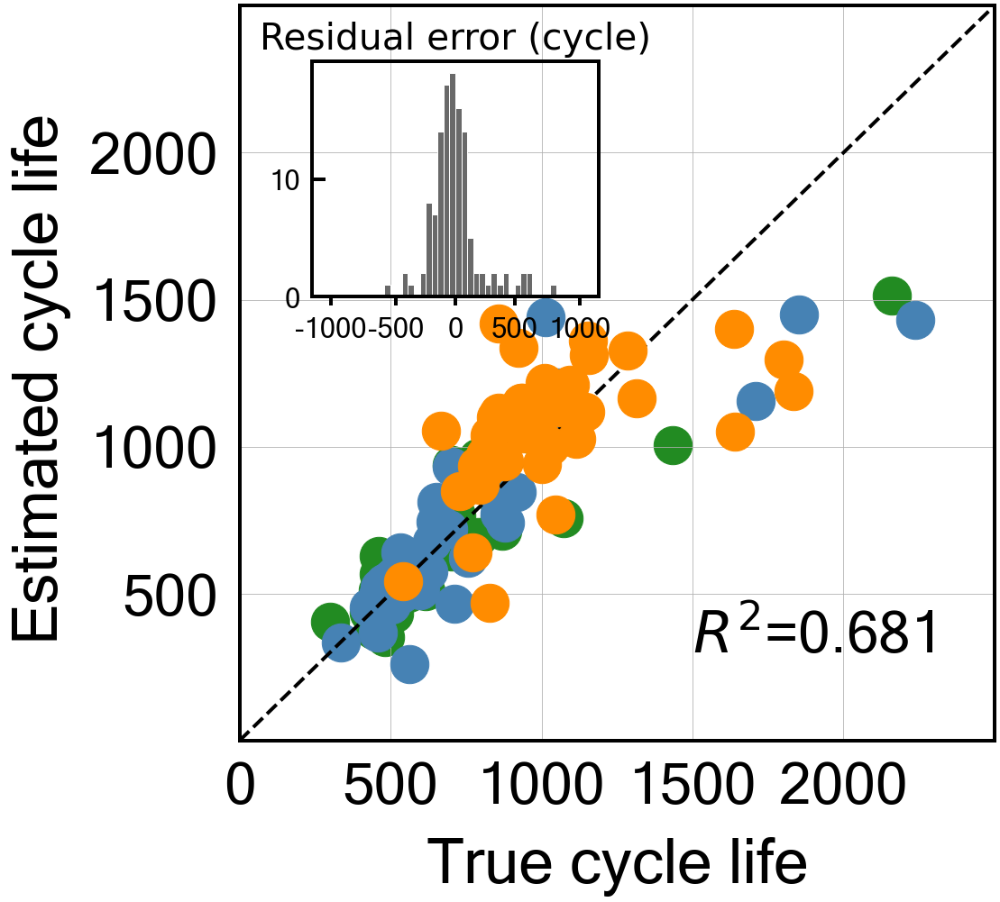


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.21688838231676733
Cycle no: Average_2to36
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to36') : 0.011252880140536794
T_Q('Charge', 'Max-Min', 'Average_2to36') : -0.1653599681949007
T_Q('Discharge', 'Variance', 'Average_2to36') : 0.14410712154077968
dTdQ('Charge', 'Mean', 'Average_2to36') : -0.018064952118928536
dTdQ('Charge', 'Skewness', 'Average_2to36') : 0.002408036220885808
dTdQ('Charge', 'Maximum', 'Average_2to36') : -0.06923640544660331

Intercept: 2.793969897643637
r2-score: 0.741
MAE_all: 140.4
MAE_train: 100.7
MAE_test: 125.7
MAE_2ndTest: 196.6
MAPE_all: 15.7 %
MAPE_train: 13.4 %
MAPE_test: 14.4 %
MAPE_2ndTest: 19.3 %
RMSE_all: 208.0
RMSE_train: 158.0
RMSE_test: 204.1
RMSE_2ndTest: 252.3
RMSPE_all: 20.2 %
RMSPE_train: 17.1 %
RMSPE_test: 18.7 %
RMSPE_2ndTest: 24.2 %
Log-scale scores
All data r2-score: 0.741


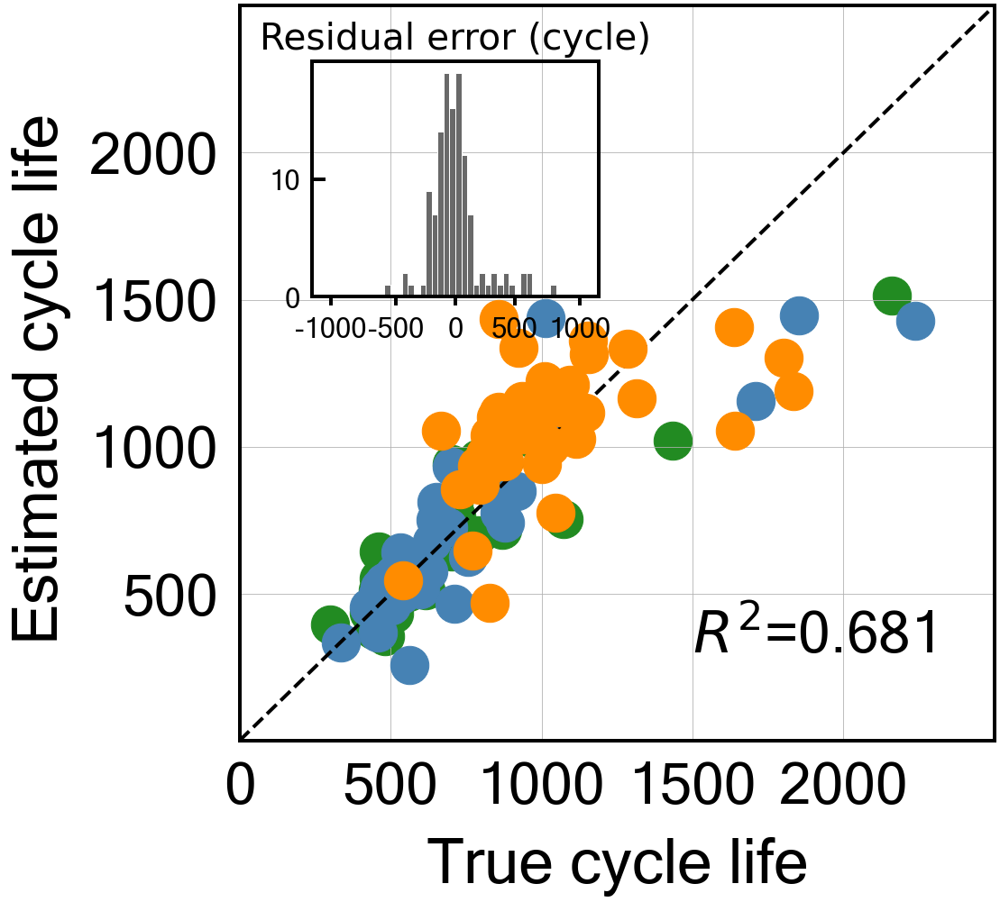


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.2011352861306276
Cycle no: Average_2to37
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to37') : 0.011711978413075978
T_Q('Charge', 'Max-Min', 'Average_2to37') : -0.1652342946760674
T_Q('Discharge', 'Variance', 'Average_2to37') : 0.14279018108859146
dTdQ('Charge', 'Mean', 'Average_2to37') : -0.017165453598408046
dTdQ('Charge', 'Skewness', 'Average_2to37') : 0.0020380858388863634
dTdQ('Charge', 'Maximum', 'Average_2to37') : -0.06953670572139026

Intercept: 2.793969897643637
r2-score: 0.739
MAE_all: 141.2
MAE_train: 100.1
MAE_test: 125.6
MAE_2ndTest: 199.7
MAPE_all: 15.7 %
MAPE_train: 13.4 %
MAPE_test: 14.3 %
MAPE_2ndTest: 19.7 %
RMSE_all: 208.8
RMSE_train: 156.7
RMSE_test: 204.7
RMSE_2ndTest: 254.8
RMSPE_all: 20.4 %
RMSPE_train: 17.0 %
RMSPE_test: 18.7 %
RMSPE_2ndTest: 24.7 %
Log-scale scores
All data r2-score: 0.739


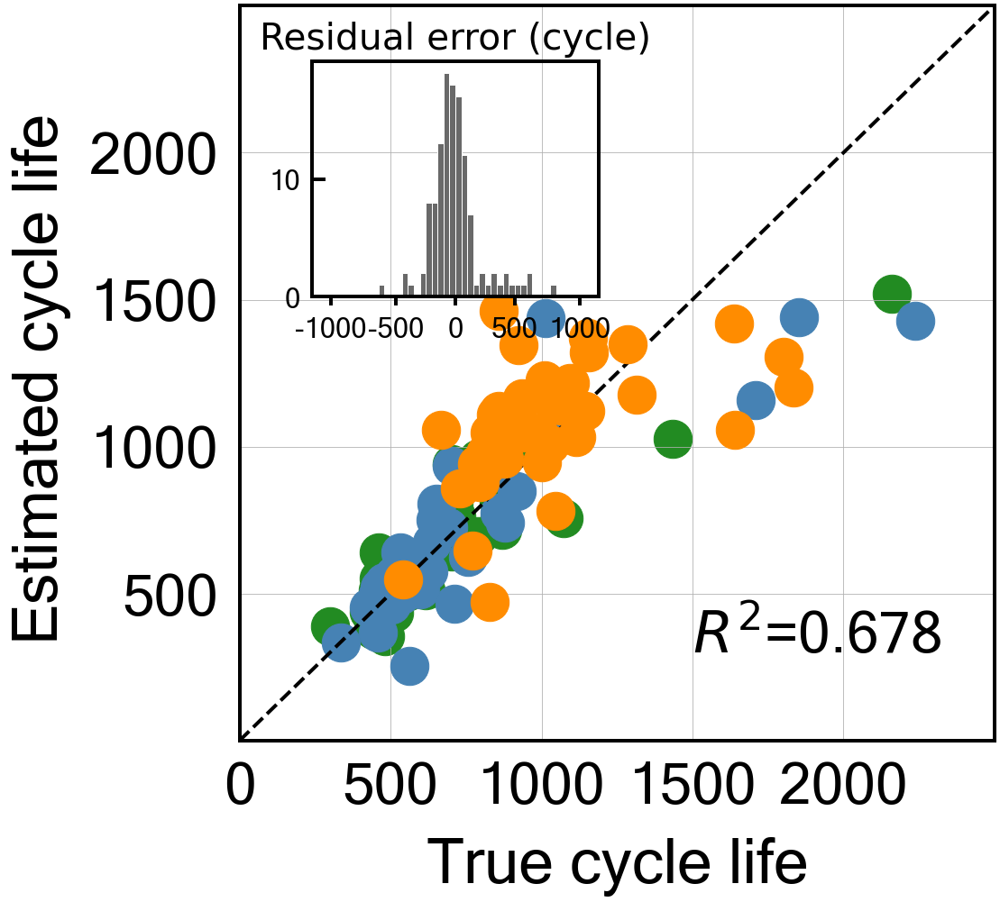


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.2049453096627929
Cycle no: Average_2to38
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to38') : 0.011234331759950696
T_Q('Charge', 'Max-Min', 'Average_2to38') : -0.16061165791211846
T_Q('Discharge', 'Variance', 'Average_2to38') : 0.14199919706385652
dTdQ('Charge', 'Mean', 'Average_2to38') : -0.019759330045455114
dTdQ('Charge', 'Skewness', 'Average_2to38') : 0.004788405673221528
dTdQ('Charge', 'Maximum', 'Average_2to38') : -0.07191918538289817

Intercept: 2.793969897643637
r2-score: 0.740
MAE_all: 140.7
MAE_train: 98.7
MAE_test: 124.9
MAE_2ndTest: 200.2
MAPE_all: 15.8 %
MAPE_train: 13.2 %
MAPE_test: 14.3 %
MAPE_2ndTest: 19.8 %
RMSE_all: 207.0
RMSE_train: 154.2
RMSE_test: 201.9
RMSE_2ndTest: 254.2
RMSPE_all: 20.3 %
RMSPE_train: 16.9 %
RMSPE_test: 18.7 %
RMSPE_2ndTest: 24.8 %
Log-scale scores
All data r2-score: 0.740
T

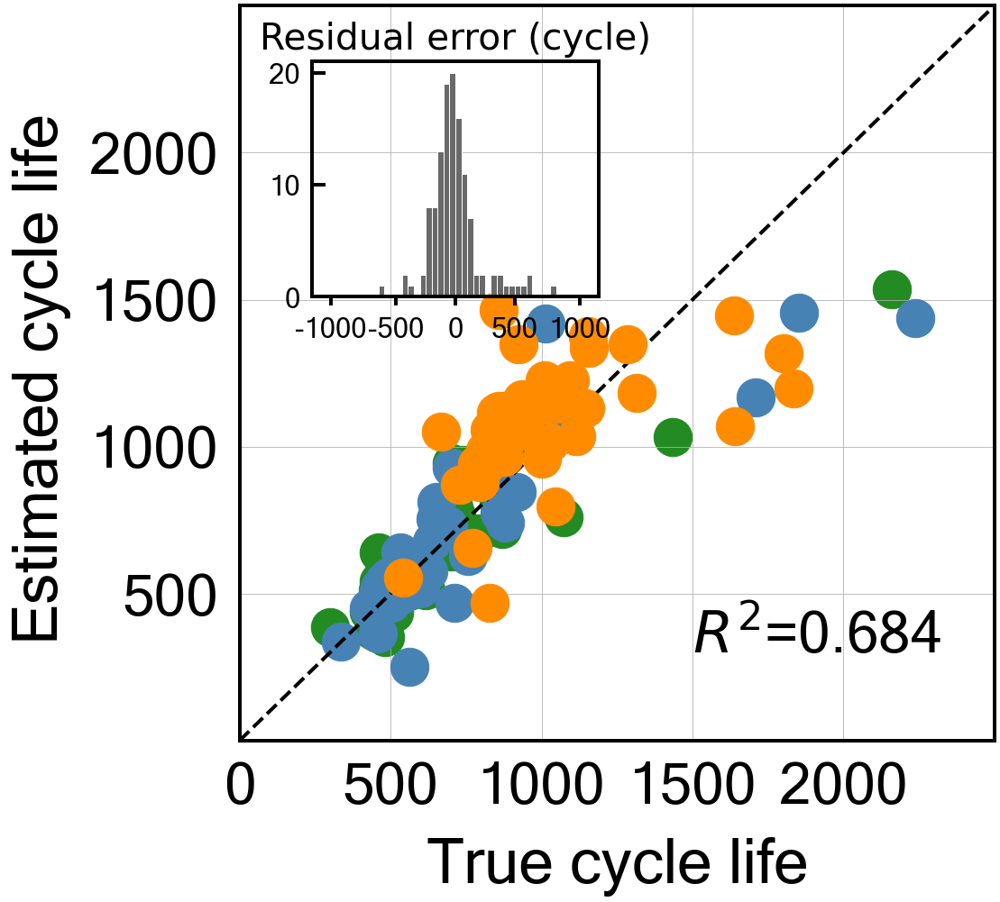


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.19491307539833425
Cycle no: Average_2to39
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to39') : 0.01258428953326128
T_Q('Charge', 'Max-Min', 'Average_2to39') : -0.15910811616963244
T_Q('Discharge', 'Variance', 'Average_2to39') : 0.14000515721897103
dTdQ('Charge', 'Mean', 'Average_2to39') : -0.019495520311232063
dTdQ('Charge', 'Skewness', 'Average_2to39') : 0.00419041595721197
dTdQ('Charge', 'Maximum', 'Average_2to39') : -0.07145213260335044

Intercept: 2.793969897643637
r2-score: 0.737
MAE_all: 141.5
MAE_train: 98.3
MAE_test: 126.8
MAE_2ndTest: 201.3
MAPE_all: 15.8 %
MAPE_train: 13.1 %
MAPE_test: 14.5 %
MAPE_2ndTest: 20.0 %
RMSE_all: 209.2
RMSE_train: 155.4
RMSE_test: 205.7
RMSE_2ndTest: 255.8
RMSPE_all: 20.5 %
RMSPE_train: 16.9 %
RMSPE_test: 18.9 %
RMSPE_2ndTest: 25.0 %
Log-scale scores
All data r2-score: 0.737
Tr

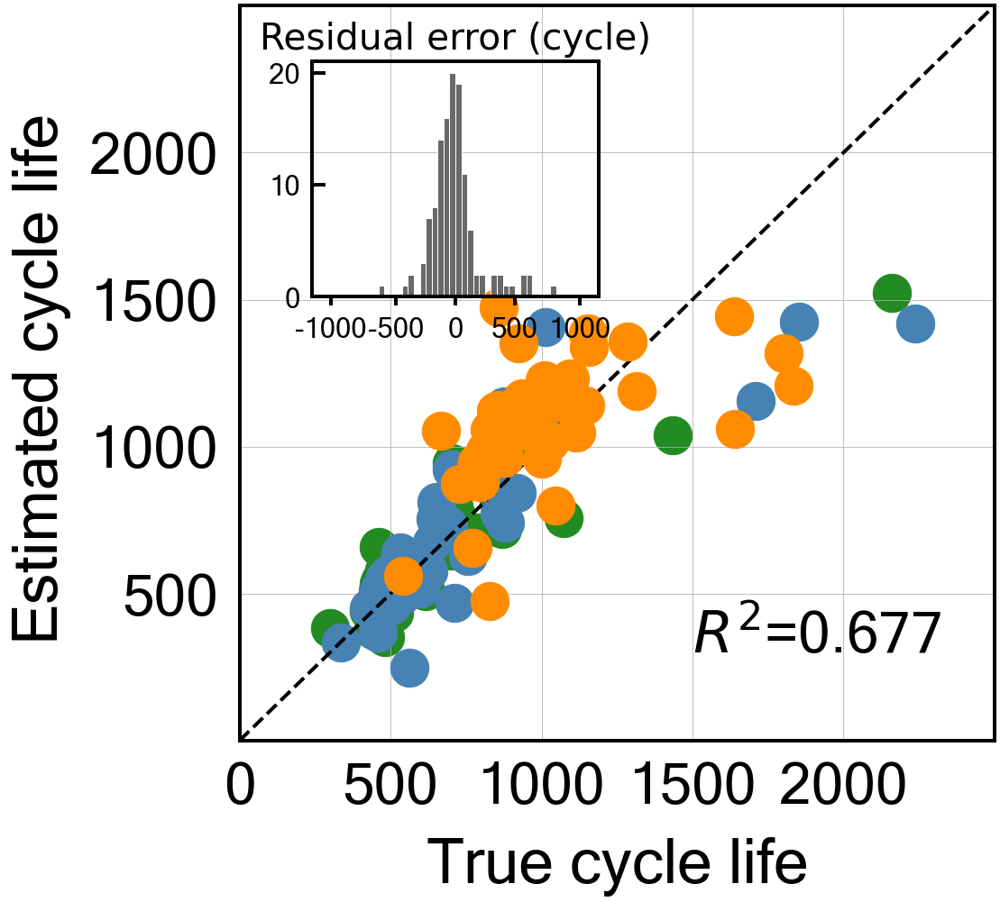


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.1872276934175503
Cycle no: Average_2to40
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to40') : 0.013217852178554727
T_Q('Charge', 'Max-Min', 'Average_2to40') : -0.15576079625154277
T_Q('Discharge', 'Variance', 'Average_2to40') : 0.13906319170740977
dTdQ('Charge', 'Mean', 'Average_2to40') : -0.021896255201969868
dTdQ('Charge', 'Skewness', 'Average_2to40') : 0.00552705168252461
dTdQ('Charge', 'Maximum', 'Average_2to40') : -0.07277957311646786

Intercept: 2.793969897643637
r2-score: 0.733
MAE_all: 142.4
MAE_train: 97.7
MAE_test: 127.5
MAE_2ndTest: 203.8
MAPE_all: 16.0 %
MAPE_train: 13.1 %
MAPE_test: 14.6 %
MAPE_2ndTest: 20.3 %
RMSE_all: 210.1
RMSE_train: 154.5
RMSE_test: 207.4
RMSE_2ndTest: 257.0
RMSPE_all: 20.7 %
RMSPE_train: 16.9 %
RMSPE_test: 19.1 %
RMSPE_2ndTest: 25.2 %
Log-scale scores
All data r2-score: 0.733
Tr

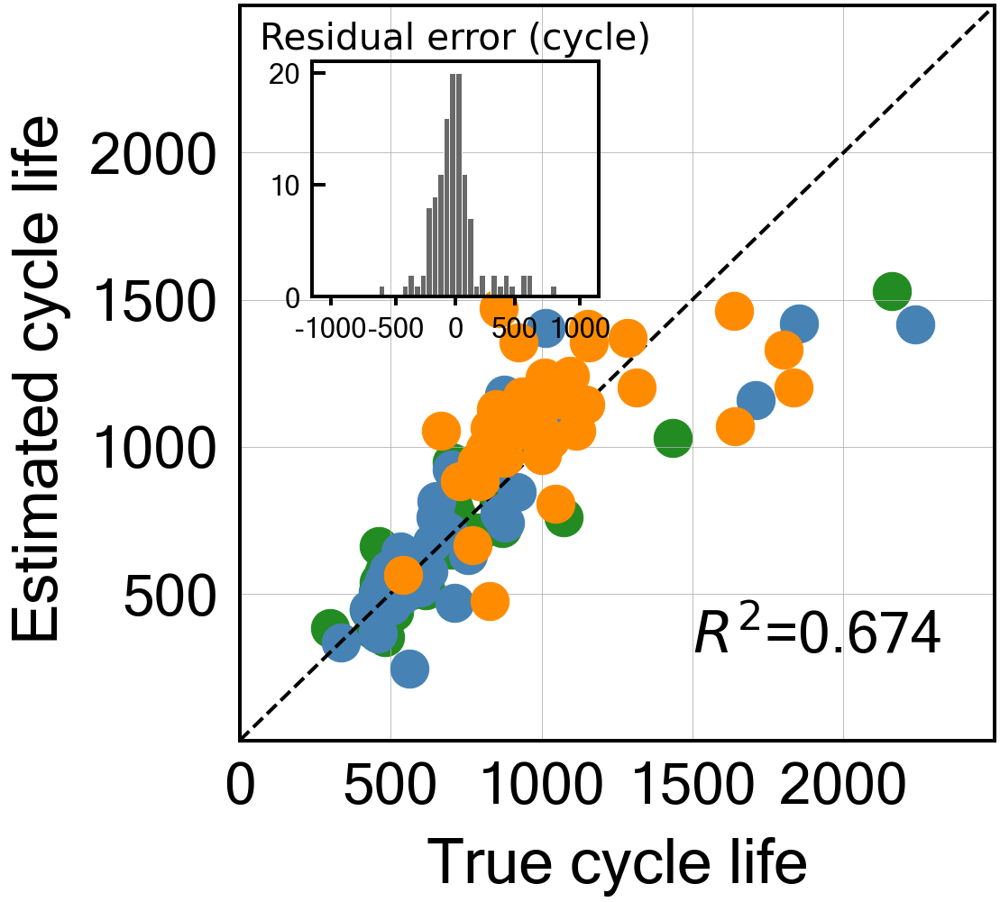


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.19215311372698063
Cycle no: Average_2to41
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to41') : 0.012855089456563851
T_Q('Charge', 'Max-Min', 'Average_2to41') : -0.15639153694589075
T_Q('Discharge', 'Variance', 'Average_2to41') : 0.1412579773280993
dTdQ('Charge', 'Mean', 'Average_2to41') : -0.023036882311342936
dTdQ('Charge', 'Skewness', 'Average_2to41') : 0.004821131079911576
dTdQ('Charge', 'Maximum', 'Average_2to41') : -0.07321964028107802

Intercept: 2.793969897643637
r2-score: 0.733
MAE_all: 142.2
MAE_train: 97.7
MAE_test: 127.0
MAE_2ndTest: 203.8
MAPE_all: 16.0 %
MAPE_train: 13.1 %
MAPE_test: 14.6 %
MAPE_2ndTest: 20.3 %
RMSE_all: 209.2
RMSE_train: 154.4
RMSE_test: 205.8
RMSE_2ndTest: 256.3
RMSPE_all: 20.6 %
RMSPE_train: 16.9 %
RMSPE_test: 19.1 %
RMSPE_2ndTest: 25.1 %
Log-scale scores
All data r2-score: 0.733
T

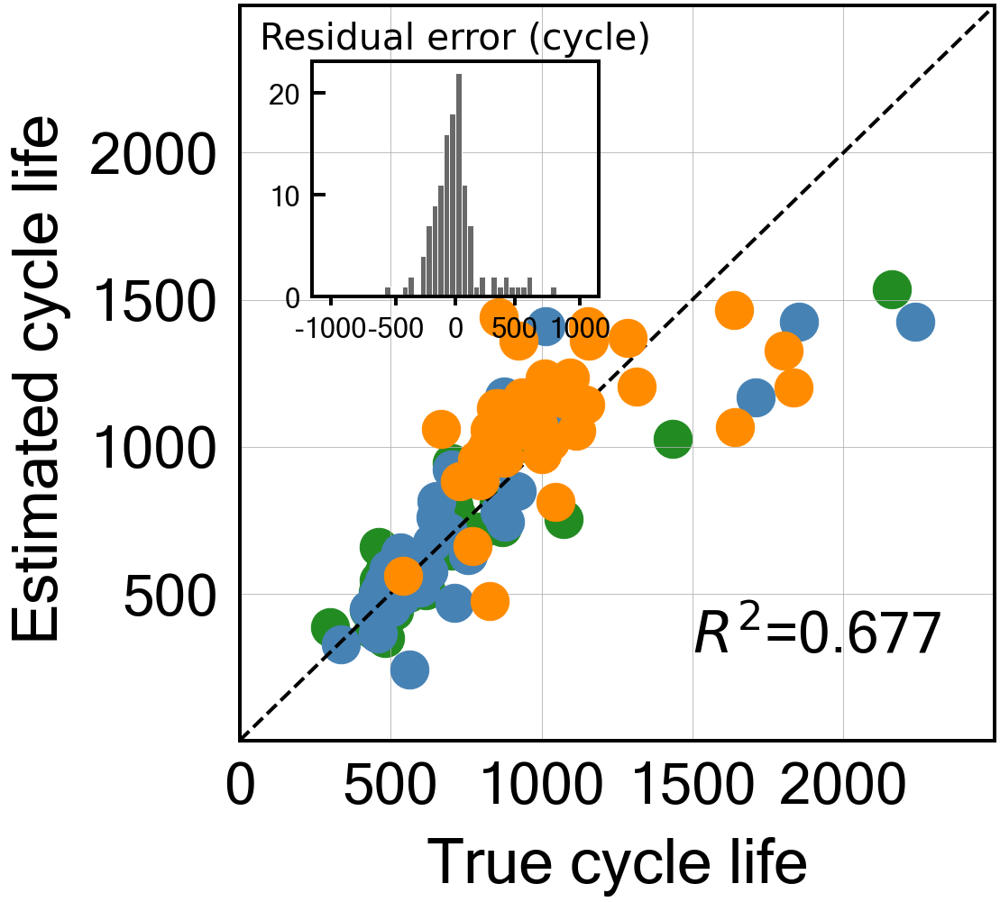


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.21135730211635728
Cycle no: Average_2to42
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to42') : 0.01155658614534063
T_Q('Charge', 'Max-Min', 'Average_2to42') : -0.155082604944166
T_Q('Discharge', 'Variance', 'Average_2to42') : 0.1417608127848999
dTdQ('Charge', 'Mean', 'Average_2to42') : -0.024895540666282315
dTdQ('Charge', 'Skewness', 'Average_2to42') : 0.0055788635523372305
dTdQ('Charge', 'Maximum', 'Average_2to42') : -0.0737505267728199

Intercept: 2.7939698976436373
r2-score: 0.736
MAE_all: 140.8
MAE_train: 97.5
MAE_test: 125.7
MAE_2ndTest: 201.2
MAPE_all: 15.8 %
MAPE_train: 13.0 %
MAPE_test: 14.4 %
MAPE_2ndTest: 20.0 %
RMSE_all: 207.7
RMSE_train: 154.2
RMSE_test: 205.0
RMSE_2ndTest: 253.2
RMSPE_all: 20.4 %
RMSPE_train: 16.8 %
RMSPE_test: 19.0 %
RMSPE_2ndTest: 24.7 %
Log-scale scores
All data r2-score: 0.736
Tra

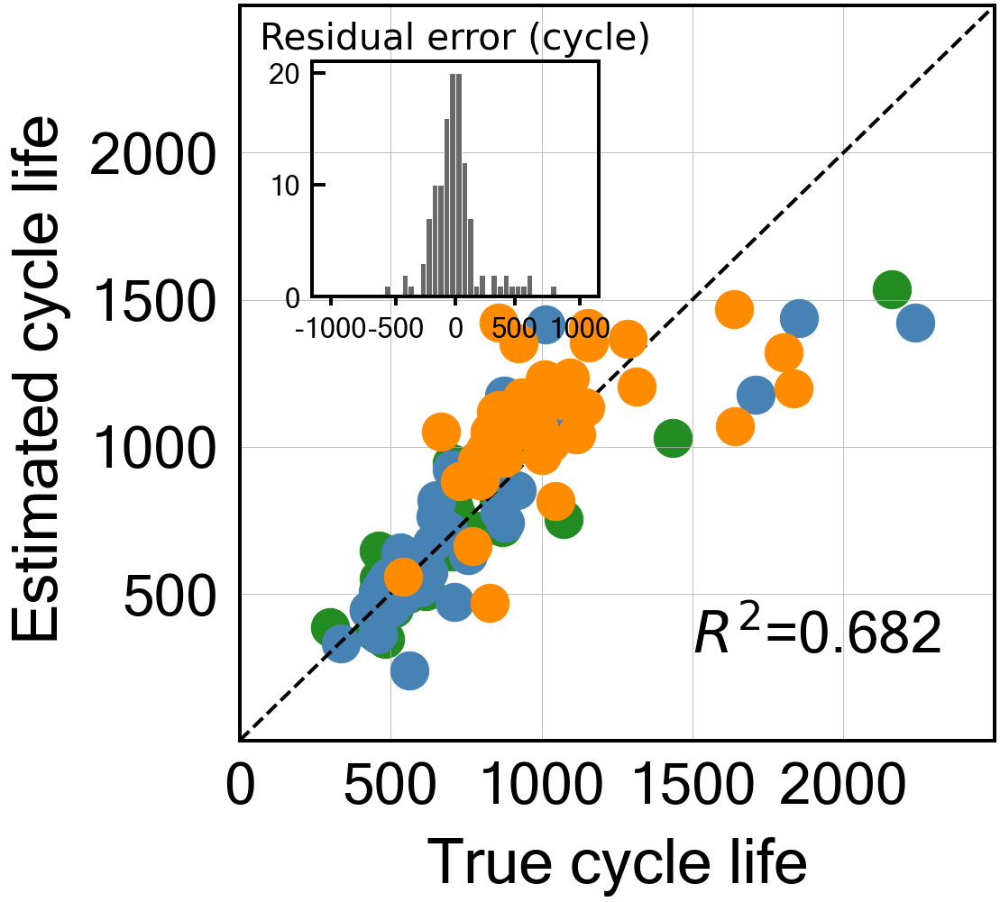


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.18761205763113775
Cycle no: Average_2to43
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to43') : 0.01273172642097365
T_Q('Charge', 'Max-Min', 'Average_2to43') : -0.15475260472756752
T_Q('Discharge', 'Variance', 'Average_2to43') : 0.14065685182258827
dTdQ('Charge', 'Mean', 'Average_2to43') : -0.023786475348329755
dTdQ('Charge', 'Skewness', 'Average_2to43') : 0.00699559546017125
dTdQ('Charge', 'Maximum', 'Average_2to43') : -0.07557786077840886

Intercept: 2.793969897643637
r2-score: 0.731
MAE_all: 142.2
MAE_train: 97.0
MAE_test: 125.4
MAE_2ndTest: 206.2
MAPE_all: 15.9 %
MAPE_train: 13.0 %
MAPE_test: 14.4 %
MAPE_2ndTest: 20.6 %
RMSE_all: 208.9
RMSE_train: 154.0
RMSE_test: 204.2
RMSE_2ndTest: 257.0
RMSPE_all: 20.7 %
RMSPE_train: 16.9 %
RMSPE_test: 19.1 %
RMSPE_2ndTest: 25.4 %
Log-scale scores
All data r2-score: 0.731
Tr

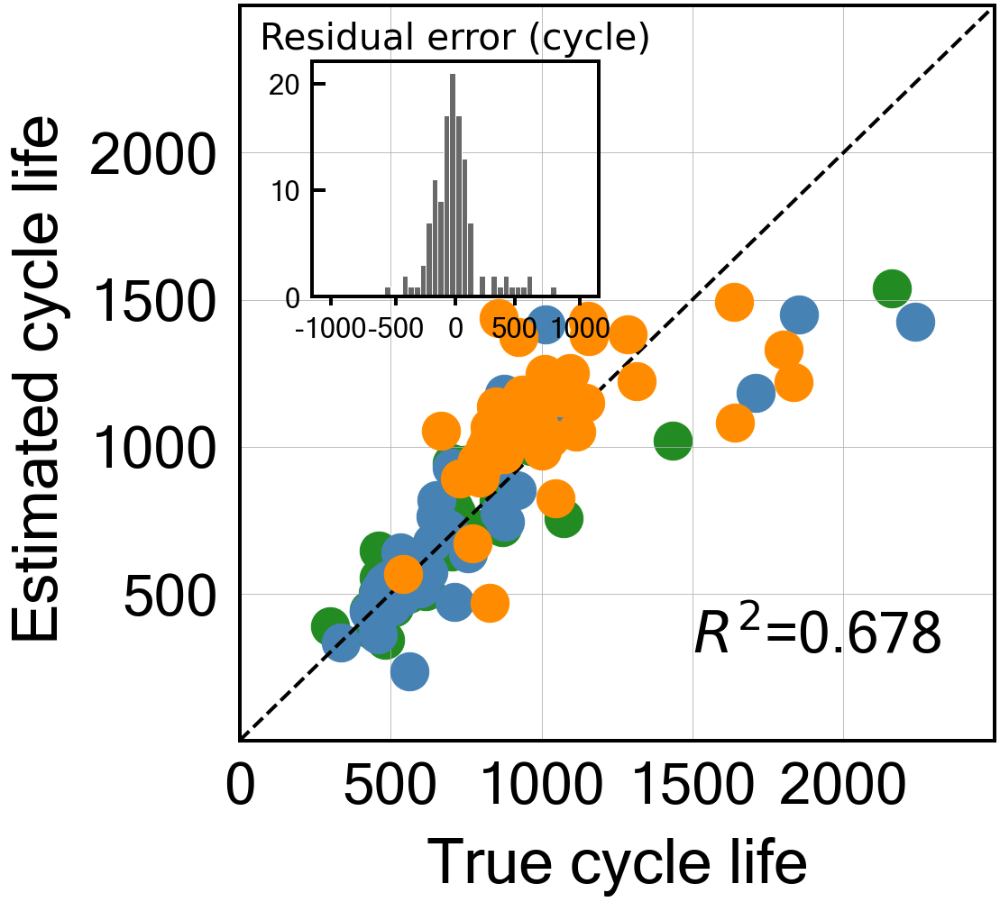


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.3
Best score obtained was: 0.19256268401043197
Cycle no: Average_2to44
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to44') : 0.010900742575253178
T_Q('Charge', 'Max-Min', 'Average_2to44') : -0.1560040243068537
T_Q('Discharge', 'Variance', 'Average_2to44') : 0.1425376867408135
dTdQ('Charge', 'Mean', 'Average_2to44') : -0.02407333616530063
dTdQ('Charge', 'Skewness', 'Average_2to44') : 0.006485896392362483
dTdQ('Charge', 'Maximum', 'Average_2to44') : -0.07517240324661278

Intercept: 2.793969897643637
r2-score: 0.731
MAE_all: 141.9
MAE_train: 97.5
MAE_test: 125.2
MAE_2ndTest: 204.7
MAPE_all: 15.9 %
MAPE_train: 13.1 %
MAPE_test: 14.4 %
MAPE_2ndTest: 20.4 %
RMSE_all: 208.1
RMSE_train: 153.8
RMSE_test: 203.0
RMSE_2ndTest: 256.2
RMSPE_all: 20.6 %
RMSPE_train: 16.8 %
RMSPE_test: 19.1 %
RMSPE_2ndTest: 25.2 %
Log-scale scores
All data r2-score: 0.731
Tra

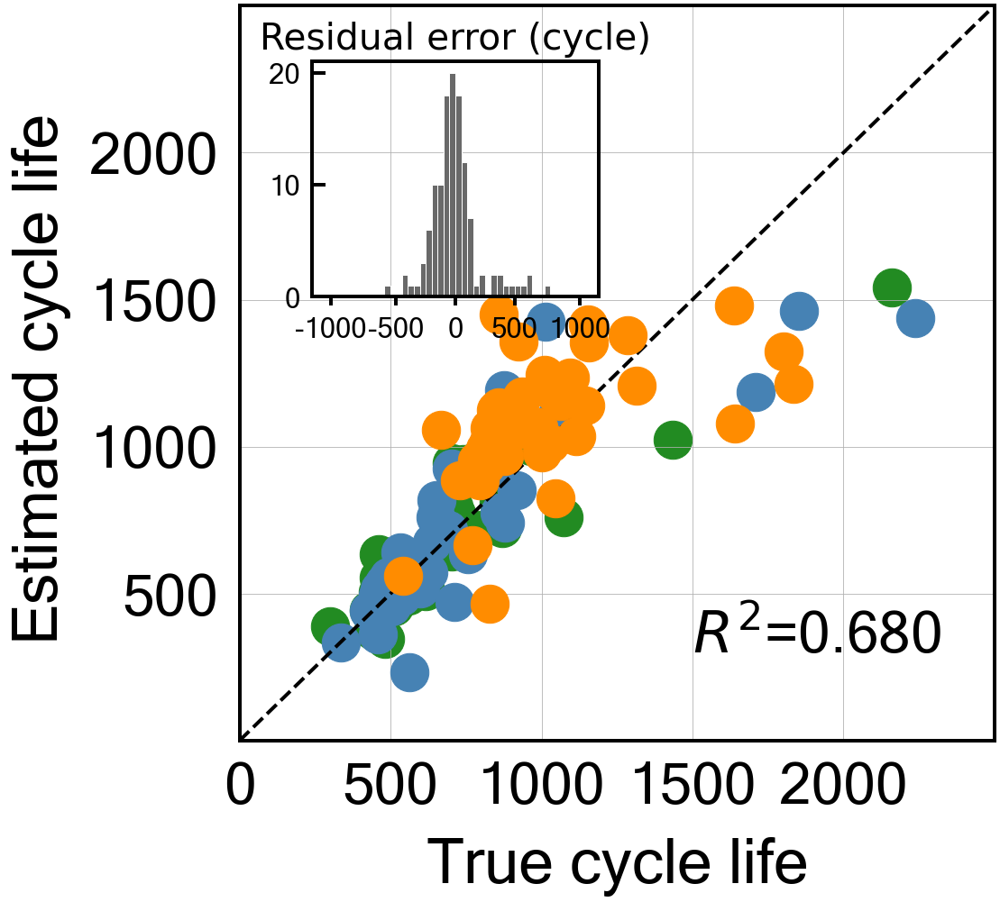


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.17358156961961768
Cycle no: Average_2to45
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to45') : 0.012032809179052216
T_Q('Charge', 'Max-Min', 'Average_2to45') : -0.15700418101088565
T_Q('Discharge', 'Variance', 'Average_2to45') : 0.14314893674541457
dTdQ('Charge', 'Mean', 'Average_2to45') : -0.022660586416735948
dTdQ('Charge', 'Skewness', 'Average_2to45') : 0.006254769682483725
dTdQ('Charge', 'Maximum', 'Average_2to45') : -0.07580815672251225

Intercept: 2.793969897643637
r2-score: 0.727
MAE_all: 142.9
MAE_train: 98.0
MAE_test: 124.7
MAE_2ndTest: 208.1
MAPE_all: 16.0 %
MAPE_train: 13.1 %
MAPE_test: 14.3 %
MAPE_2ndTest: 20.8 %
RMSE_all: 209.4
RMSE_train: 155.3
RMSE_test: 202.3
RMSE_2ndTest: 259.2
RMSPE_all: 20.8 %
RMSPE_train: 17.0 %
RMSPE_test: 19.0 %
RMSPE_2ndTest: 25.7 %
Log-scale scores
All data r2-score: 0.727


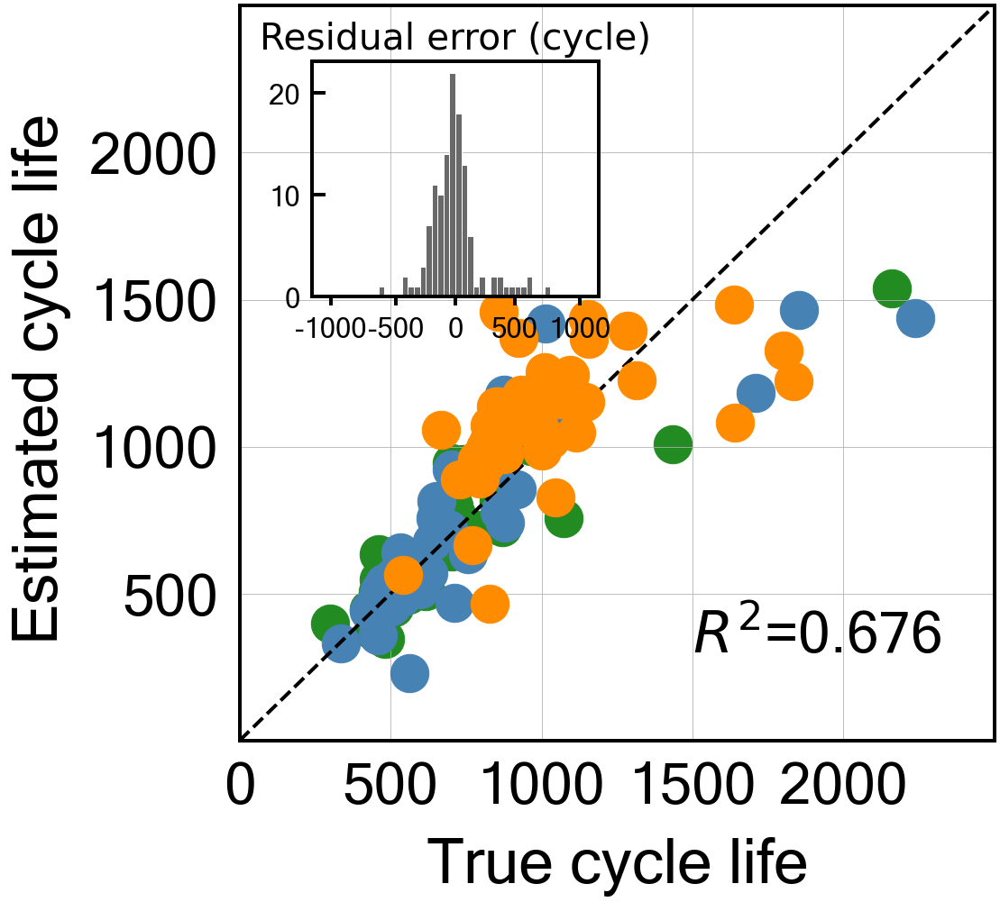


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.17245198666253836
Cycle no: Average_2to46
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to46') : 0.012490169257187154
T_Q('Charge', 'Max-Min', 'Average_2to46') : -0.1549309007374177
T_Q('Discharge', 'Variance', 'Average_2to46') : 0.14250946942555878
dTdQ('Charge', 'Mean', 'Average_2to46') : -0.02363288634835122
dTdQ('Charge', 'Skewness', 'Average_2to46') : 0.006495177862658931
dTdQ('Charge', 'Maximum', 'Average_2to46') : -0.07611397865352394

Intercept: 2.7939698976436373
r2-score: 0.727
MAE_all: 143.1
MAE_train: 98.4
MAE_test: 124.6
MAE_2ndTest: 208.4
MAPE_all: 16.1 %
MAPE_train: 13.2 %
MAPE_test: 14.3 %
MAPE_2ndTest: 20.8 %
RMSE_all: 210.3
RMSE_train: 157.1
RMSE_test: 203.2
RMSE_2ndTest: 259.4
RMSPE_all: 20.8 %
RMSPE_train: 17.1 %
RMSPE_test: 19.0 %
RMSPE_2ndTest: 25.6 %
Log-scale scores
All data r2-score: 0.727
T

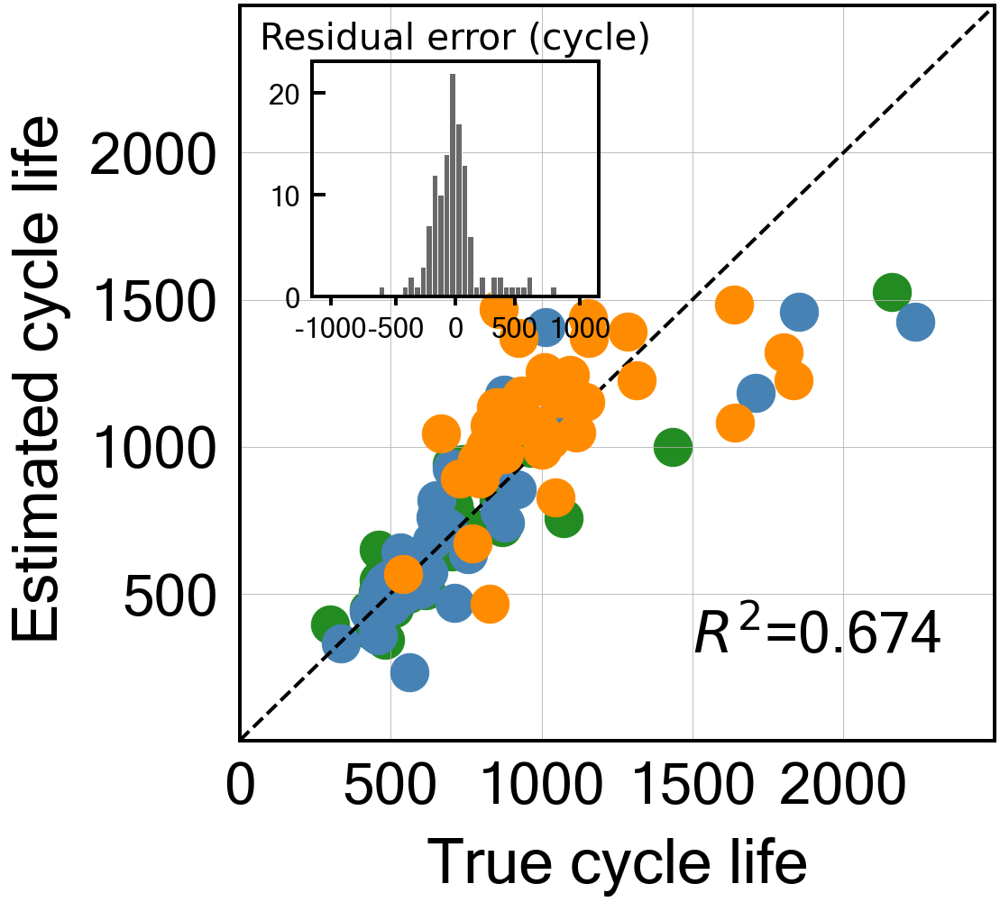


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.17728415862877567
Cycle no: Average_2to47
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to47') : 0.013276946137102272
T_Q('Charge', 'Max-Min', 'Average_2to47') : -0.15085105025014273
T_Q('Discharge', 'Variance', 'Average_2to47') : 0.14028211494745324
dTdQ('Charge', 'Mean', 'Average_2to47') : -0.02567506456891162
dTdQ('Charge', 'Skewness', 'Average_2to47') : 0.0068623772763229335
dTdQ('Charge', 'Maximum', 'Average_2to47') : -0.07600339736779085

Intercept: 2.793969897643637
r2-score: 0.728
MAE_all: 142.9
MAE_train: 98.9
MAE_test: 124.3
MAE_2ndTest: 207.4
MAPE_all: 16.0 %
MAPE_train: 13.3 %
MAPE_test: 14.2 %
MAPE_2ndTest: 20.7 %
RMSE_all: 211.2
RMSE_train: 159.4
RMSE_test: 205.4
RMSE_2ndTest: 258.6
RMSPE_all: 20.8 %
RMSPE_train: 17.4 %
RMSPE_test: 18.9 %
RMSPE_2ndTest: 25.5 %
Log-scale scores
All data r2-score: 0.728


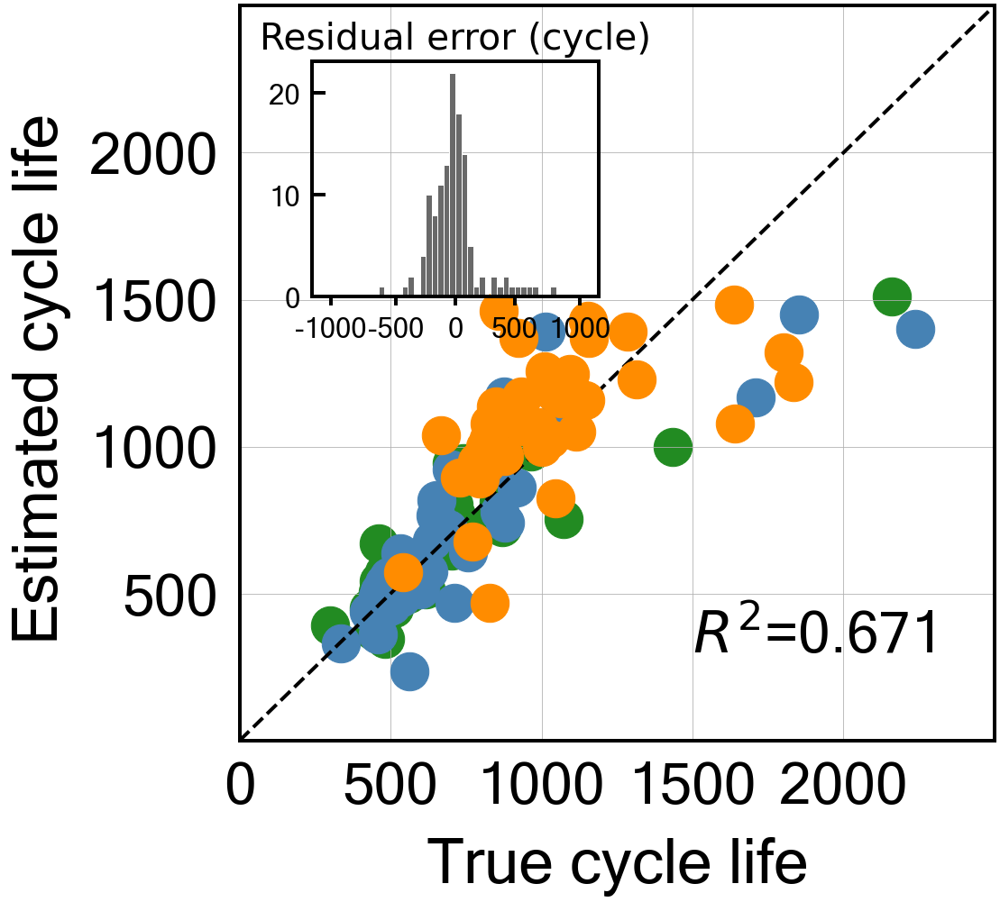


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.16010611533330565
Cycle no: Average_2to48
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to48') : 0.014108108748412973
T_Q('Charge', 'Max-Min', 'Average_2to48') : -0.15240957792833804
T_Q('Discharge', 'Variance', 'Average_2to48') : 0.1412964309284272
dTdQ('Charge', 'Mean', 'Average_2to48') : -0.024139786949536265
dTdQ('Charge', 'Skewness', 'Average_2to48') : 0.0073317606141465605
dTdQ('Charge', 'Maximum', 'Average_2to48') : -0.07728516533302388

Intercept: 2.7939698976436365
r2-score: 0.726
MAE_all: 143.6
MAE_train: 98.1
MAE_test: 123.3
MAE_2ndTest: 211.6
MAPE_all: 16.1 %
MAPE_train: 13.2 %
MAPE_test: 14.1 %
MAPE_2ndTest: 21.2 %
RMSE_all: 211.3
RMSE_train: 157.5
RMSE_test: 203.6
RMSE_2ndTest: 261.3
RMSPE_all: 20.9 %
RMSPE_train: 17.2 %
RMSPE_test: 18.8 %
RMSPE_2ndTest: 25.8 %
Log-scale scores
All data r2-score: 0.726

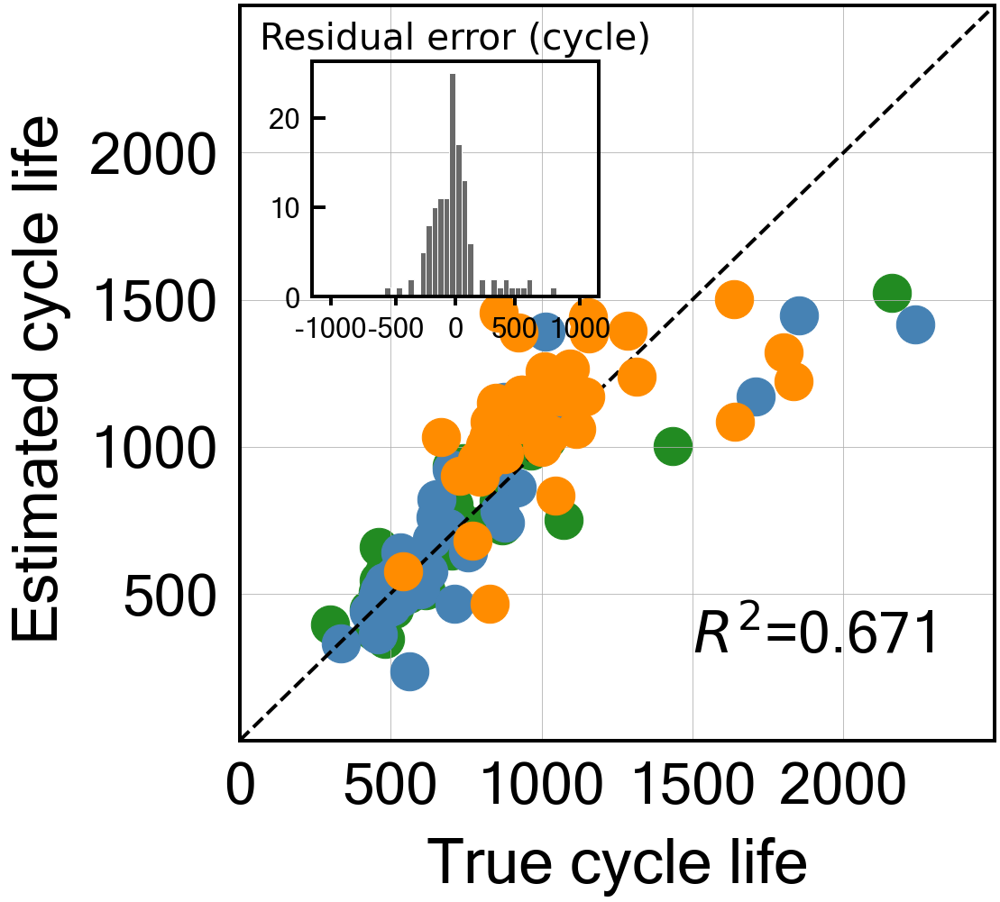


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.14747593471236342
Cycle no: Average_2to49
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to49') : 0.014750541318432902
T_Q('Charge', 'Max-Min', 'Average_2to49') : -0.15347765323743168
T_Q('Discharge', 'Variance', 'Average_2to49') : 0.1412611284605209
dTdQ('Charge', 'Mean', 'Average_2to49') : -0.021974280269177388
dTdQ('Charge', 'Skewness', 'Average_2to49') : 0.007121216796951692
dTdQ('Charge', 'Maximum', 'Average_2to49') : -0.07758096600420084

Intercept: 2.7939698976436365
r2-score: 0.724
MAE_all: 144.7
MAE_train: 98.6
MAE_test: 123.3
MAE_2ndTest: 214.4
MAPE_all: 16.2 %
MAPE_train: 13.2 %
MAPE_test: 14.1 %
MAPE_2ndTest: 21.5 %
RMSE_all: 212.2
RMSE_train: 158.1
RMSE_test: 203.6
RMSE_2ndTest: 263.2
RMSPE_all: 21.0 %
RMSPE_train: 17.2 %
RMSPE_test: 18.8 %
RMSPE_2ndTest: 26.0 %
Log-scale scores
All data r2-score: 0.724


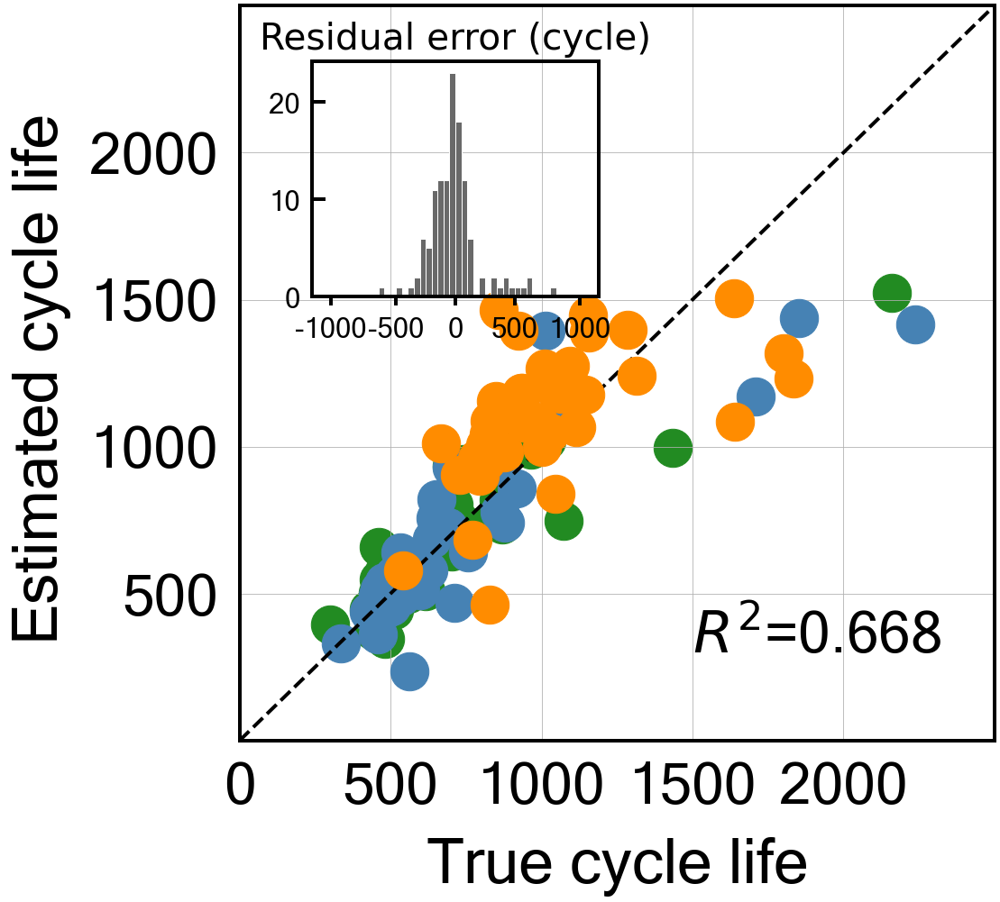


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.9
Best score obtained was: 0.16494058232585374
Cycle no: Average_2to50
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to50') : 0.014591902842682504
T_Q('Charge', 'Max-Min', 'Average_2to50') : -0.1502824298151379
T_Q('Discharge', 'Variance', 'Average_2to50') : 0.14003313983180699
dTdQ('Charge', 'Mean', 'Average_2to50') : -0.023392707616920017
dTdQ('Charge', 'Skewness', 'Average_2to50') : 0.00794502994381284
dTdQ('Charge', 'Maximum', 'Average_2to50') : -0.07757245186476451

Intercept: 2.793969897643637
r2-score: 0.728
MAE_all: 143.5
MAE_train: 98.4
MAE_test: 123.2
MAE_2ndTest: 211.1
MAPE_all: 16.1 %
MAPE_train: 13.2 %
MAPE_test: 14.1 %
MAPE_2ndTest: 21.1 %
RMSE_all: 211.2
RMSE_train: 158.2
RMSE_test: 203.7
RMSE_2ndTest: 260.5
RMSPE_all: 20.8 %
RMSPE_train: 17.3 %
RMSPE_test: 18.6 %
RMSPE_2ndTest: 25.6 %
Log-scale scores
All data r2-score: 0.728
Tr

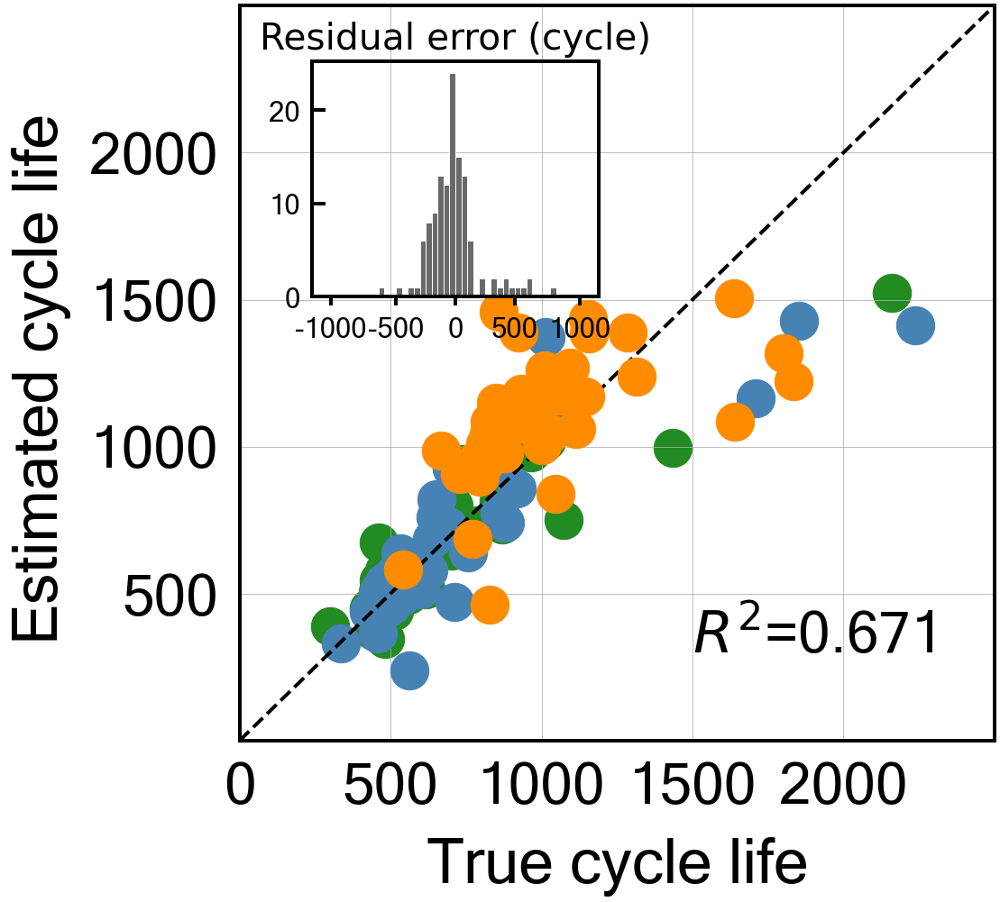


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.2
Best score obtained was: 0.15024595274681207
Cycle no: Average_2to51
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to51') : 0.015595246247672154
T_Q('Charge', 'Max-Min', 'Average_2to51') : -0.1496891501043528
T_Q('Discharge', 'Variance', 'Average_2to51') : 0.13841077606716112
dTdQ('Charge', 'Mean', 'Average_2to51') : -0.022490828074978188
dTdQ('Charge', 'Skewness', 'Average_2to51') : 0.007893617111064797
dTdQ('Charge', 'Maximum', 'Average_2to51') : -0.0777764044853978

Intercept: 2.793969897643637
r2-score: 0.726
MAE_all: 144.6
MAE_train: 98.6
MAE_test: 123.2
MAE_2ndTest: 214.2
MAPE_all: 16.2 %
MAPE_train: 13.2 %
MAPE_test: 14.0 %
MAPE_2ndTest: 21.5 %
RMSE_all: 212.8
RMSE_train: 158.7
RMSE_test: 205.6
RMSE_2ndTest: 262.8
RMSPE_all: 20.9 %
RMSPE_train: 17.3 %
RMSPE_test: 18.6 %
RMSPE_2ndTest: 26.0 %
Log-scale scores
All data r2-score: 0.726
Tr

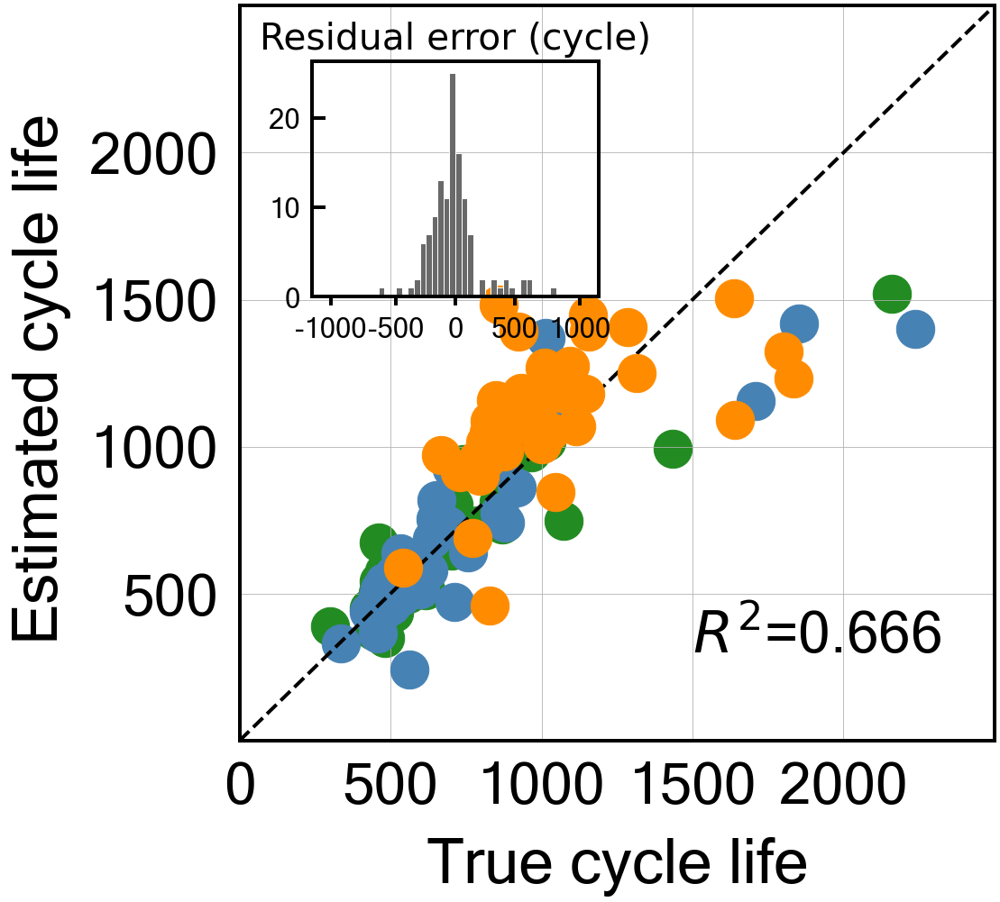


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.9
Best score obtained was: 0.1780246086376268
Cycle no: Average_2to52
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to52') : 0.01357166840291883
T_Q('Charge', 'Max-Min', 'Average_2to52') : -0.1498002234295136
T_Q('Discharge', 'Variance', 'Average_2to52') : 0.14164563011427653
dTdQ('Charge', 'Mean', 'Average_2to52') : -0.024421084750228382
dTdQ('Charge', 'Skewness', 'Average_2to52') : 0.007998480743780428
dTdQ('Charge', 'Maximum', 'Average_2to52') : -0.07787046621491393

Intercept: 2.793969897643637
r2-score: 0.731
MAE_all: 142.1
MAE_train: 98.6
MAE_test: 121.4
MAE_2ndTest: 208.4
MAPE_all: 15.9 %
MAPE_train: 13.3 %
MAPE_test: 13.8 %
MAPE_2ndTest: 20.8 %
RMSE_all: 210.0
RMSE_train: 158.3
RMSE_test: 202.6
RMSE_2ndTest: 258.5
RMSPE_all: 20.5 %
RMSPE_train: 17.3 %
RMSPE_test: 18.4 %
RMSPE_2ndTest: 25.2 %
Log-scale scores
All data r2-score: 0.731
Tra

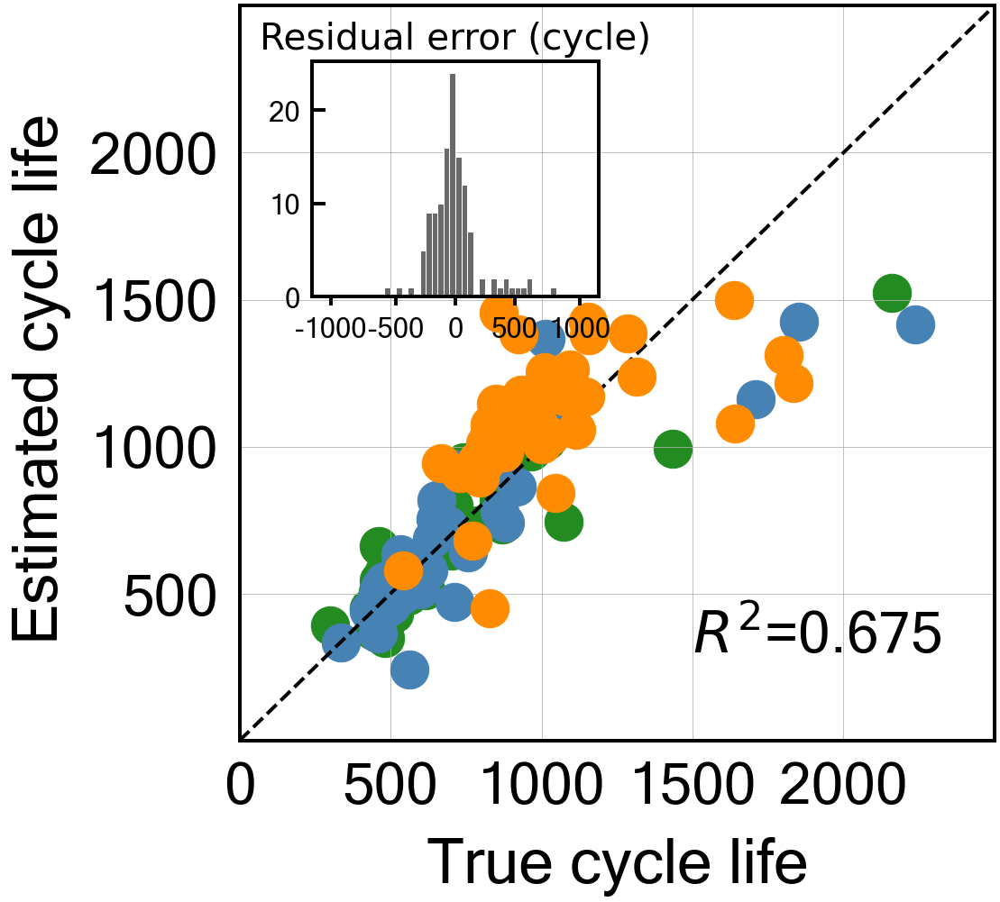


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.14419759461684478
Cycle no: Average_2to53
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to53') : 0.015897453565008126
T_Q('Charge', 'Max-Min', 'Average_2to53') : -0.14978599205647025
T_Q('Discharge', 'Variance', 'Average_2to53') : 0.13793814862016296
dTdQ('Charge', 'Mean', 'Average_2to53') : -0.021045675731735207
dTdQ('Charge', 'Skewness', 'Average_2to53') : 0.008495044012243075
dTdQ('Charge', 'Maximum', 'Average_2to53') : -0.07812140469859198

Intercept: 2.7939698976436373
r2-score: 0.726
MAE_all: 145.0
MAE_train: 99.6
MAE_test: 122.2
MAE_2ndTest: 215.4
MAPE_all: 16.2 %
MAPE_train: 13.4 %
MAPE_test: 13.8 %
MAPE_2ndTest: 21.6 %
RMSE_all: 213.2
RMSE_train: 159.6
RMSE_test: 205.0
RMSE_2ndTest: 263.8
RMSPE_all: 20.9 %
RMSPE_train: 17.5 %
RMSPE_test: 18.5 %
RMSPE_2ndTest: 26.0 %
Log-scale scores
All data r2-score: 0.726

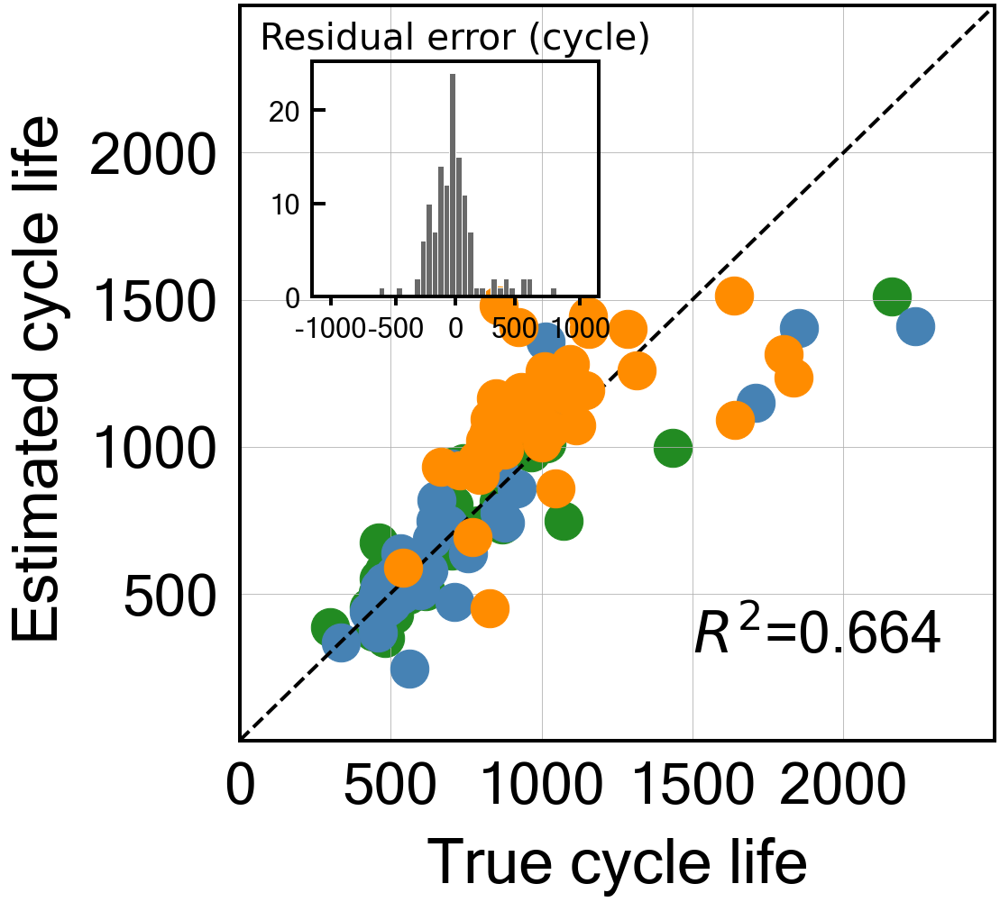


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.1287601664855792
Cycle no: Average_2to54
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to54') : 0.01725839615448598
T_Q('Charge', 'Max-Min', 'Average_2to54') : -0.1492809788024304
T_Q('Discharge', 'Variance', 'Average_2to54') : 0.13798837606197056
dTdQ('Charge', 'Mean', 'Average_2to54') : -0.020462262037663433
dTdQ('Charge', 'Skewness', 'Average_2to54') : 0.009303511958067343
dTdQ('Charge', 'Maximum', 'Average_2to54') : -0.07976394017629394

Intercept: 2.793969897643637
r2-score: 0.726
MAE_all: 145.6
MAE_train: 99.0
MAE_test: 120.6
MAE_2ndTest: 219.6
MAPE_all: 16.3 %
MAPE_train: 13.3 %
MAPE_test: 13.6 %
MAPE_2ndTest: 22.1 %
RMSE_all: 213.4
RMSE_train: 158.7
RMSE_test: 203.4
RMSE_2ndTest: 266.1
RMSPE_all: 21.0 %
RMSPE_train: 17.4 %
RMSPE_test: 18.3 %
RMSPE_2ndTest: 26.3 %
Log-scale scores
All data r2-score: 0.726
Tra

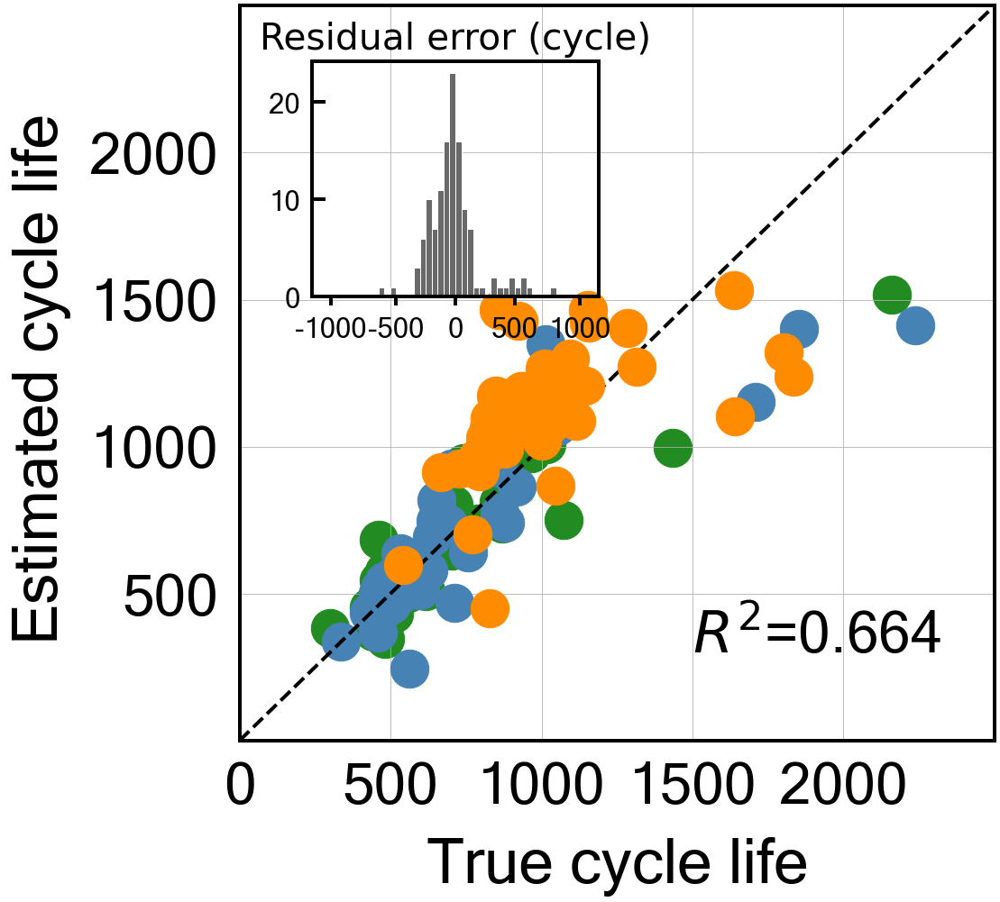


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.15079917564873724
Cycle no: Average_2to55
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to55') : 0.016903536530100394
T_Q('Charge', 'Max-Min', 'Average_2to55') : -0.14909486324959215
T_Q('Discharge', 'Variance', 'Average_2to55') : 0.13966048352011928
dTdQ('Charge', 'Mean', 'Average_2to55') : -0.02104309060313623
dTdQ('Charge', 'Skewness', 'Average_2to55') : 0.009613416688549311
dTdQ('Charge', 'Maximum', 'Average_2to55') : -0.08033860920813997

Intercept: 2.793969897643637
r2-score: 0.730
MAE_all: 144.2
MAE_train: 99.1
MAE_test: 119.5
MAE_2ndTest: 216.2
MAPE_all: 16.1 %
MAPE_train: 13.3 %
MAPE_test: 13.5 %
MAPE_2ndTest: 21.7 %
RMSE_all: 211.7
RMSE_train: 159.0
RMSE_test: 201.9
RMSE_2ndTest: 262.7
RMSPE_all: 20.7 %
RMSPE_train: 17.4 %
RMSPE_test: 18.1 %
RMSPE_2ndTest: 25.7 %
Log-scale scores
All data r2-score: 0.730
T

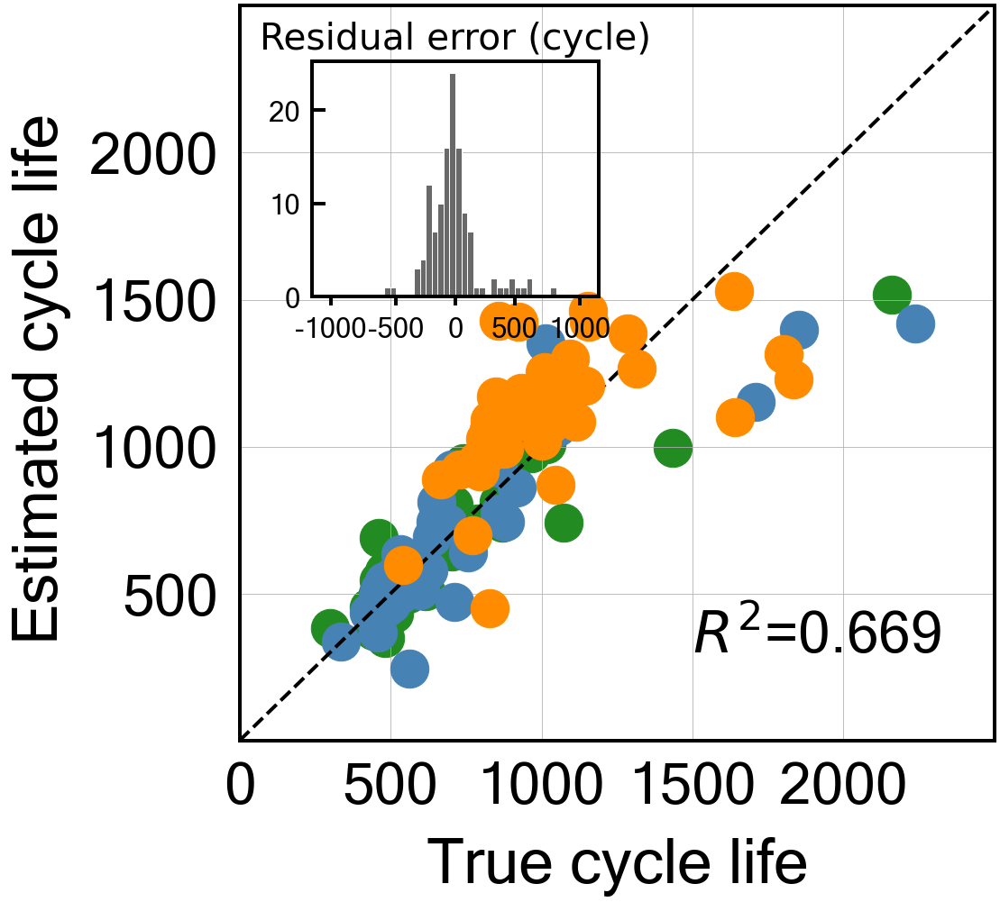


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.16795351067197983
Cycle no: Average_2to56
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to56') : 0.016716427617588972
T_Q('Charge', 'Max-Min', 'Average_2to56') : -0.14794601124457826
T_Q('Discharge', 'Variance', 'Average_2to56') : 0.14087314618154934
dTdQ('Charge', 'Mean', 'Average_2to56') : -0.022133190138375895
dTdQ('Charge', 'Skewness', 'Average_2to56') : 0.00968972610432133
dTdQ('Charge', 'Maximum', 'Average_2to56') : -0.08125815136570552

Intercept: 2.793969897643637
r2-score: 0.734
MAE_all: 142.9
MAE_train: 98.7
MAE_test: 118.2
MAE_2ndTest: 214.1
MAPE_all: 16.0 %
MAPE_train: 13.3 %
MAPE_test: 13.4 %
MAPE_2ndTest: 21.4 %
RMSE_all: 209.8
RMSE_train: 158.8
RMSE_test: 199.7
RMSE_2ndTest: 260.1
RMSPE_all: 20.5 %
RMSPE_train: 17.4 %
RMSPE_test: 17.9 %
RMSPE_2ndTest: 25.3 %
Log-scale scores
All data r2-score: 0.734
T

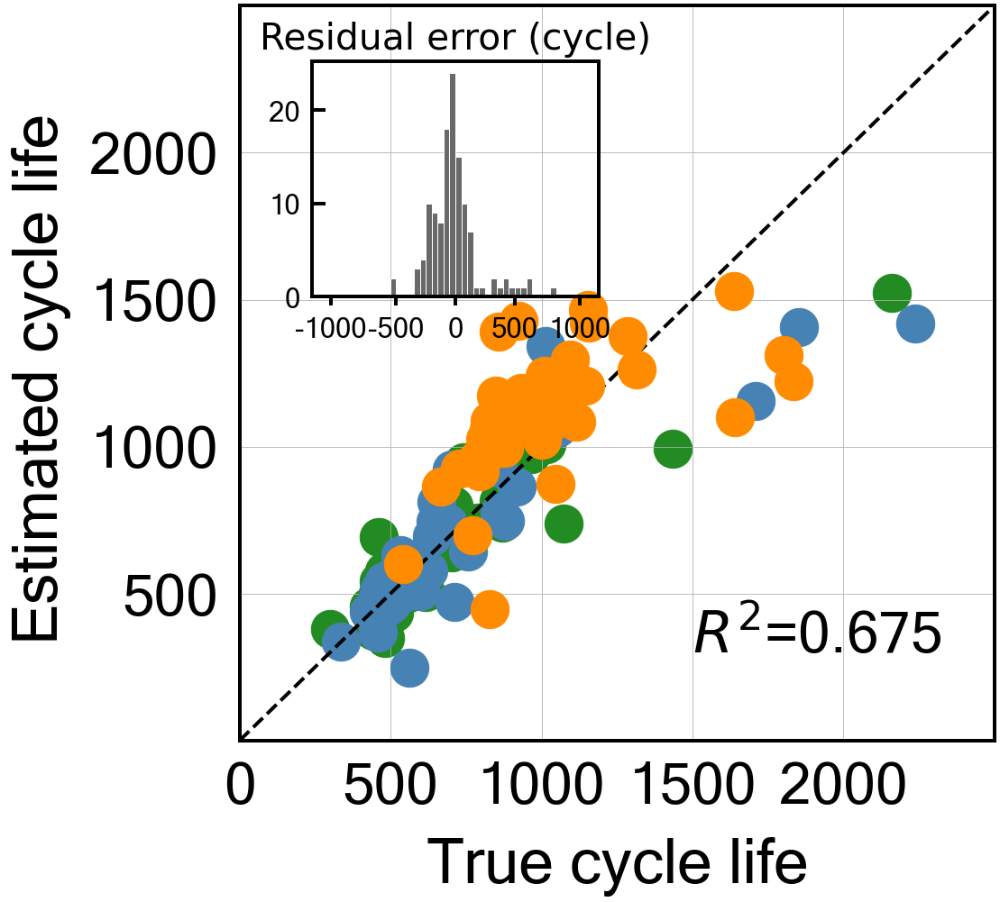


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.9
Best score obtained was: 0.1953953201321471
Cycle no: Average_2to57
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to57') : 0.014769890231572056
T_Q('Charge', 'Max-Min', 'Average_2to57') : -0.14586056406643746
T_Q('Discharge', 'Variance', 'Average_2to57') : 0.1435534997700886
dTdQ('Charge', 'Mean', 'Average_2to57') : -0.025558905202647697
dTdQ('Charge', 'Skewness', 'Average_2to57') : 0.01009249515314127
dTdQ('Charge', 'Maximum', 'Average_2to57') : -0.08215938287921559

Intercept: 2.793969897643637
r2-score: 0.740
MAE_all: 140.2
MAE_train: 97.7
MAE_test: 116.1
MAE_2ndTest: 209.0
MAPE_all: 15.7 %
MAPE_train: 13.2 %
MAPE_test: 13.2 %
MAPE_2ndTest: 20.8 %
RMSE_all: 206.2
RMSE_train: 156.1
RMSE_test: 196.2
RMSE_2ndTest: 255.7
RMSPE_all: 20.1 %
RMSPE_train: 17.2 %
RMSPE_test: 17.6 %
RMSPE_2ndTest: 24.6 %
Log-scale scores
All data r2-score: 0.740
Tra

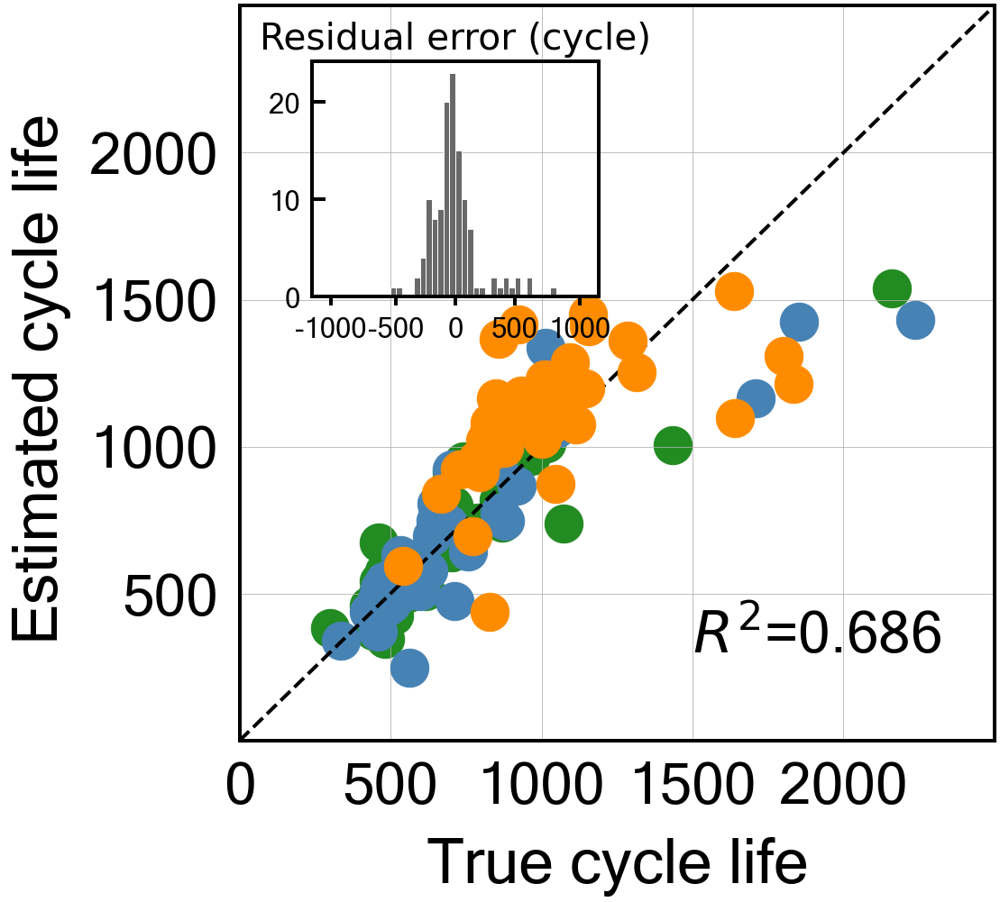


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.20784216710262693
Cycle no: Average_2to58
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to58') : 0.014984945343707312
T_Q('Charge', 'Max-Min', 'Average_2to58') : -0.1451280334203136
T_Q('Discharge', 'Variance', 'Average_2to58') : 0.14239043105389673
dTdQ('Charge', 'Mean', 'Average_2to58') : -0.02564946461372268
dTdQ('Charge', 'Skewness', 'Average_2to58') : 0.010139655315699287
dTdQ('Charge', 'Maximum', 'Average_2to58') : -0.08172189381763553

Intercept: 2.7939698976436365
r2-score: 0.744
MAE_all: 139.8
MAE_train: 99.0
MAE_test: 115.8
MAE_2ndTest: 206.7
MAPE_all: 15.6 %
MAPE_train: 13.4 %
MAPE_test: 13.1 %
MAPE_2ndTest: 20.5 %
RMSE_all: 206.0
RMSE_train: 157.8
RMSE_test: 196.6
RMSE_2ndTest: 253.8
RMSPE_all: 19.9 %
RMSPE_train: 17.3 %
RMSPE_test: 17.5 %
RMSPE_2ndTest: 24.3 %
Log-scale scores
All data r2-score: 0.744
T

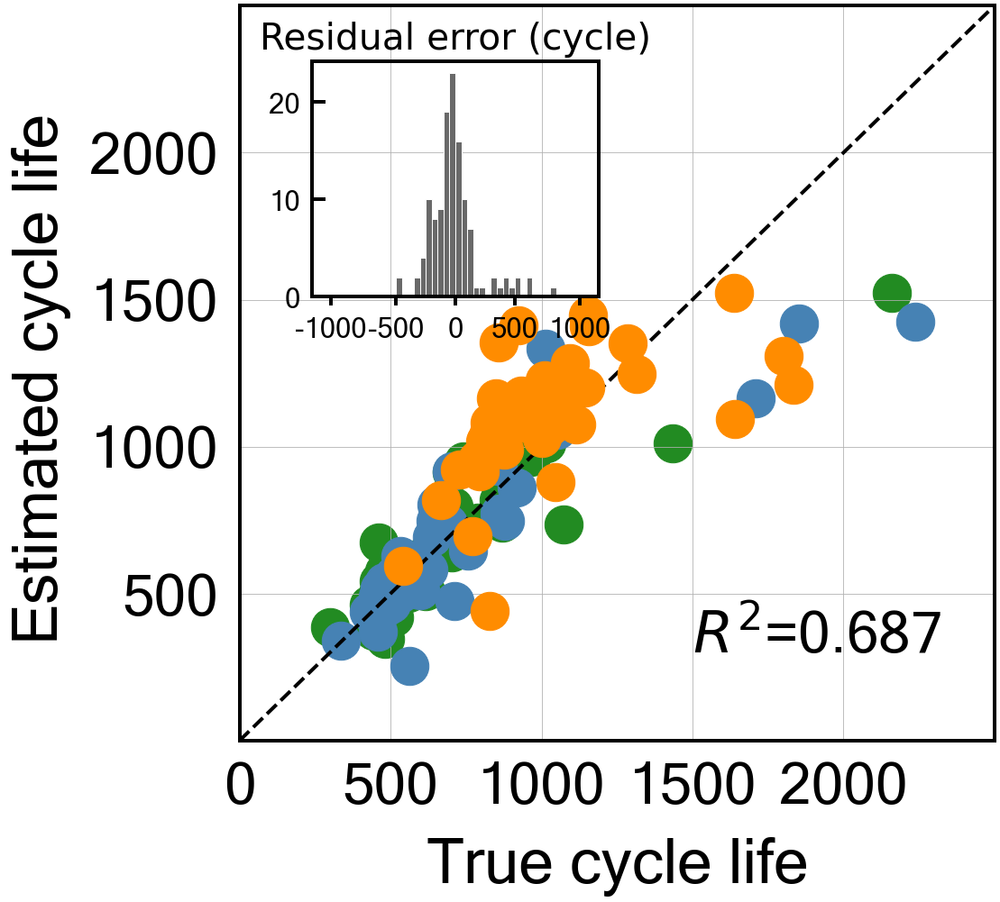


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.24011617935305785
Cycle no: Average_2to59
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to59') : 0.013859987371120971
T_Q('Charge', 'Max-Min', 'Average_2to59') : -0.14253407914279442
T_Q('Discharge', 'Variance', 'Average_2to59') : 0.14236484345110934
dTdQ('Charge', 'Mean', 'Average_2to59') : -0.0285642258160053
dTdQ('Charge', 'Skewness', 'Average_2to59') : 0.010076705462974142
dTdQ('Charge', 'Maximum', 'Average_2to59') : -0.08102130161058231

Intercept: 2.7939698976436373
r2-score: 0.750
MAE_all: 137.4
MAE_train: 98.9
MAE_test: 115.6
MAE_2ndTest: 199.9
MAPE_all: 15.3 %
MAPE_train: 13.3 %
MAPE_test: 13.1 %
MAPE_2ndTest: 19.7 %
RMSE_all: 204.3
RMSE_train: 158.6
RMSE_test: 197.1
RMSE_2ndTest: 248.5
RMSPE_all: 19.6 %
RMSPE_train: 17.4 %
RMSPE_test: 17.4 %
RMSPE_2ndTest: 23.5 %
Log-scale scores
All data r2-score: 0.750
T

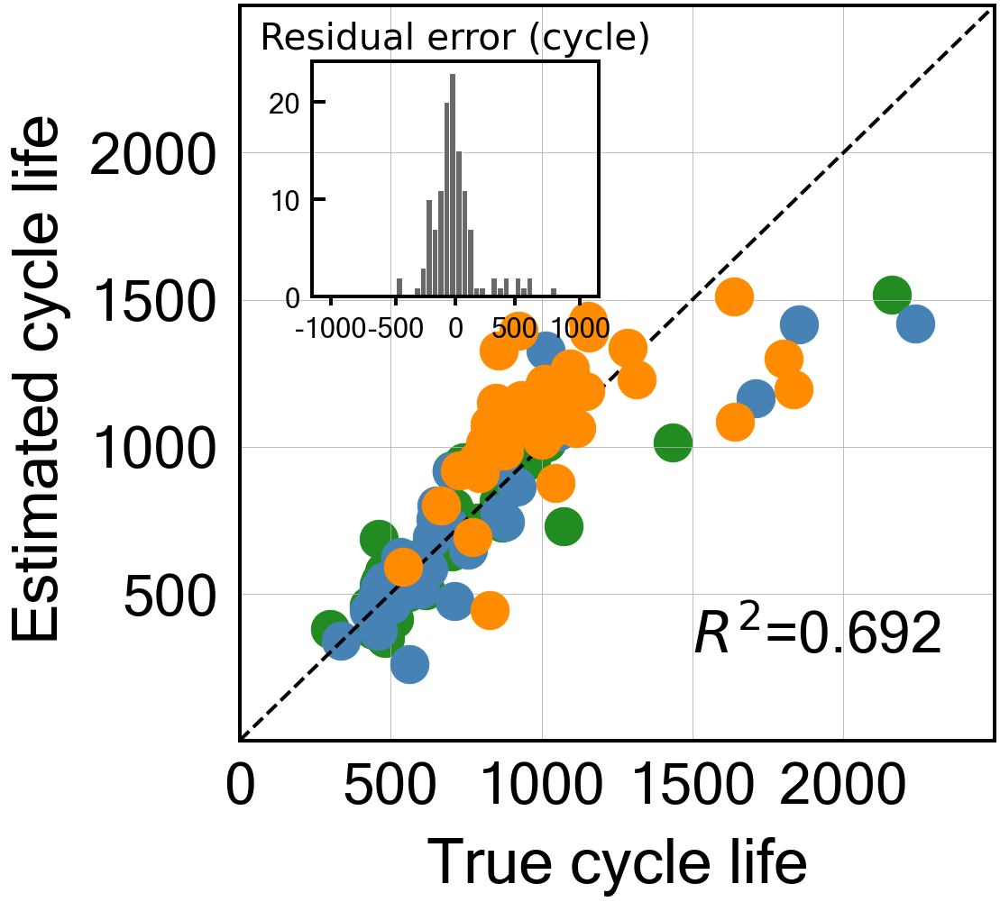


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.24124215579293262
Cycle no: Average_2to60
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to60') : 0.014727526690369032
T_Q('Charge', 'Max-Min', 'Average_2to60') : -0.13765923101339222
T_Q('Discharge', 'Variance', 'Average_2to60') : 0.13922634580502574
dTdQ('Charge', 'Mean', 'Average_2to60') : -0.03071095303166972
dTdQ('Charge', 'Skewness', 'Average_2to60') : 0.010926461762179084
dTdQ('Charge', 'Maximum', 'Average_2to60') : -0.08119685075558739

Intercept: 2.793969897643637
r2-score: 0.754
MAE_all: 137.5
MAE_train: 98.9
MAE_test: 115.6
MAE_2ndTest: 200.1
MAPE_all: 15.3 %
MAPE_train: 13.3 %
MAPE_test: 13.0 %
MAPE_2ndTest: 19.8 %
RMSE_all: 205.0
RMSE_train: 159.1
RMSE_test: 199.0
RMSE_2ndTest: 248.4
RMSPE_all: 19.5 %
RMSPE_train: 17.3 %
RMSPE_test: 17.3 %
RMSPE_2ndTest: 23.4 %
Log-scale scores
All data r2-score: 0.754
T

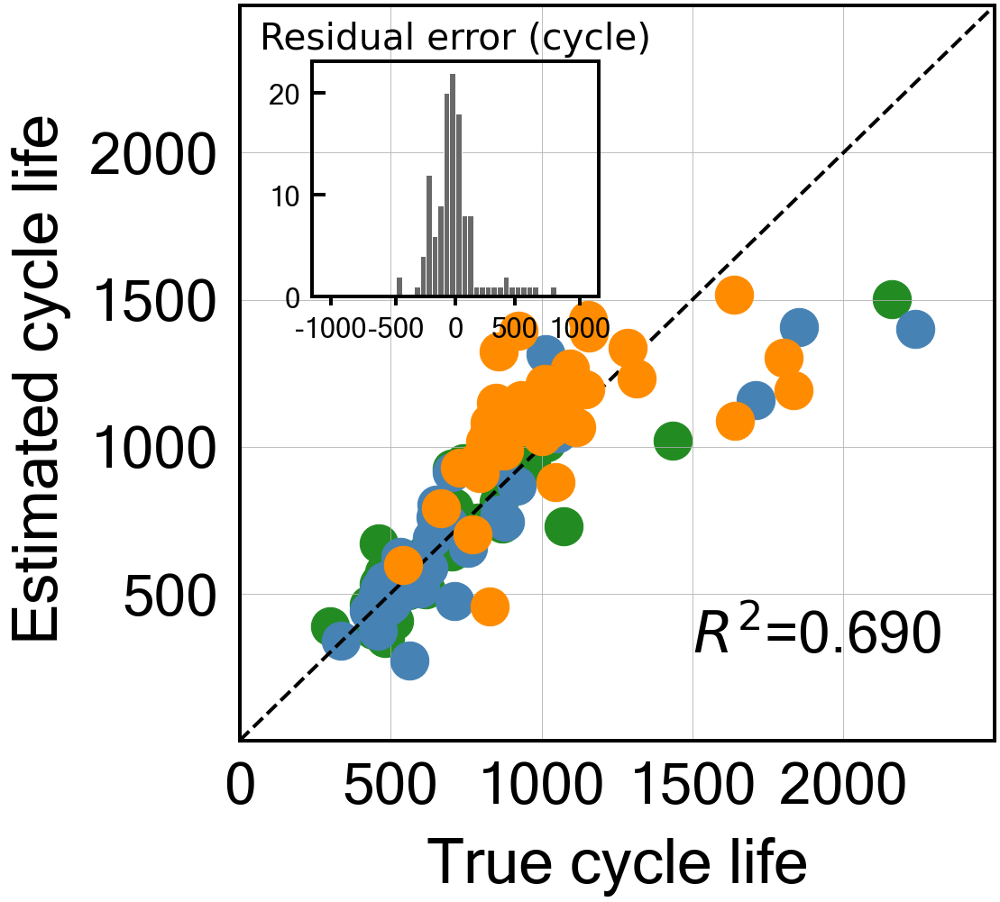


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.25099273330693683
Cycle no: Average_2to61
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to61') : 0.012201220233051473
T_Q('Charge', 'Max-Min', 'Average_2to61') : -0.14366502561155794
T_Q('Discharge', 'Variance', 'Average_2to61') : 0.14493816727553818
dTdQ('Charge', 'Mean', 'Average_2to61') : -0.02853085476914832
dTdQ('Charge', 'Skewness', 'Average_2to61') : 0.01070199500156756
dTdQ('Charge', 'Maximum', 'Average_2to61') : -0.08138745375663119

Intercept: 2.793969897643637
r2-score: 0.757
MAE_all: 136.5
MAE_train: 99.0
MAE_test: 115.0
MAE_2ndTest: 197.3
MAPE_all: 15.2 %
MAPE_train: 13.4 %
MAPE_test: 13.0 %
MAPE_2ndTest: 19.4 %
RMSE_all: 202.9
RMSE_train: 157.8
RMSE_test: 195.7
RMSE_2ndTest: 246.8
RMSPE_all: 19.4 %
RMSPE_train: 17.2 %
RMSPE_test: 17.2 %
RMSPE_2ndTest: 23.2 %
Log-scale scores
All data r2-score: 0.757
Tr

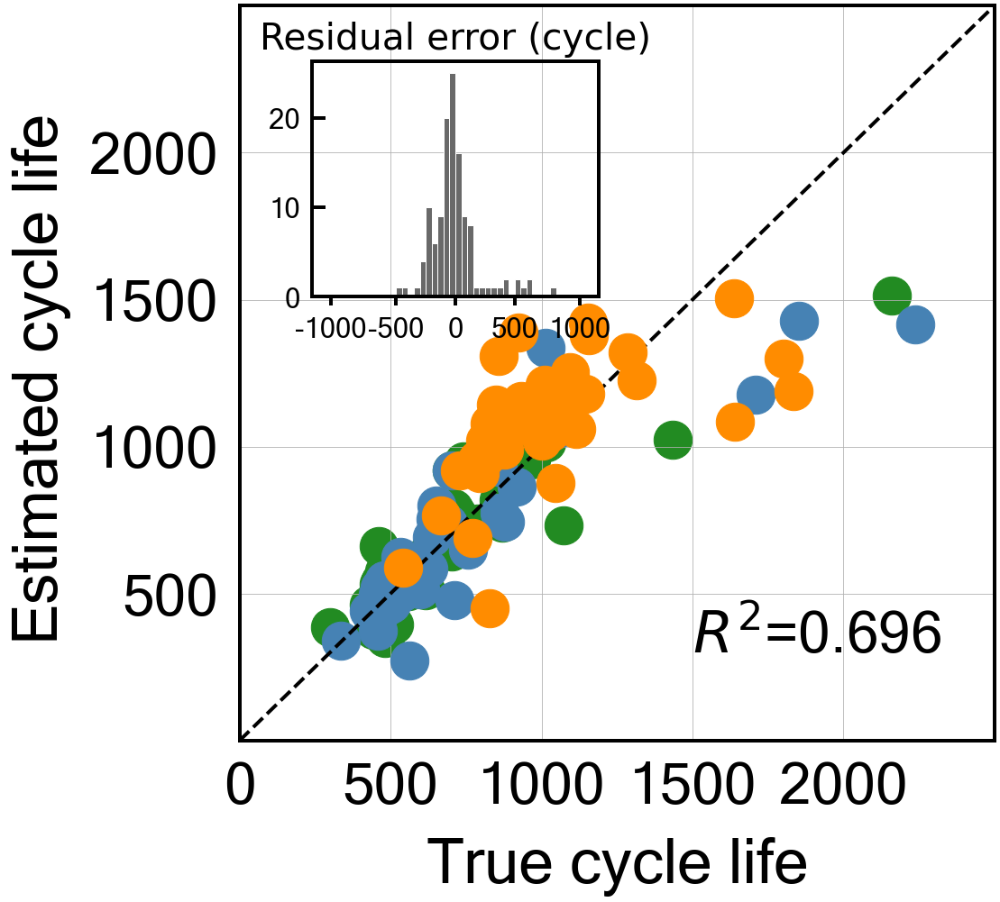


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.19001136341924774
Cycle no: Average_2to62
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to62') : 0.026196861083035844
T_Q('Charge', 'Max-Min', 'Average_2to62') : -0.11007128264304629
T_Q('Discharge', 'Variance', 'Average_2to62') : 0.11171509243986548
dTdQ('Charge', 'Mean', 'Average_2to62') : -0.03781892463822333
dTdQ('Charge', 'Skewness', 'Average_2to62') : 0.013804561780641622
dTdQ('Charge', 'Maximum', 'Average_2to62') : -0.07818121181187274

Intercept: 2.7939698976436373
r2-score: 0.750
MAE_all: 142.1
MAE_train: 100.8
MAE_test: 120.3
MAE_2ndTest: 207.2
MAPE_all: 15.5 %
MAPE_train: 13.2 %
MAPE_test: 12.9 %
MAPE_2ndTest: 20.6 %
RMSE_all: 220.0
RMSE_train: 173.6
RMSE_test: 222.7
RMSE_2ndTest: 256.6
RMSPE_all: 20.0 %
RMSPE_train: 17.6 %
RMSPE_test: 17.4 %
RMSPE_2ndTest: 24.4 %
Log-scale scores
All data r2-score: 0.750

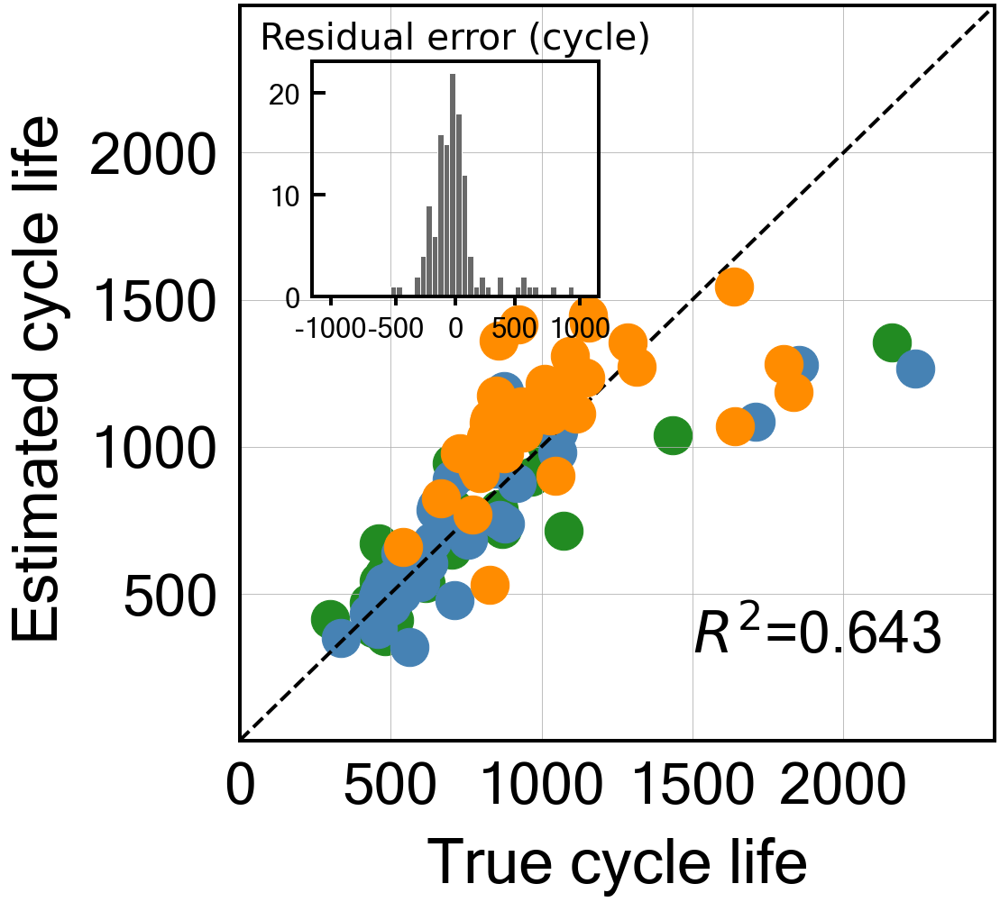


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.17125783460238508
Cycle no: Average_2to63
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to63') : 0.03410930685901322
T_Q('Charge', 'Max-Min', 'Average_2to63') : -0.09276416304734422
T_Q('Discharge', 'Variance', 'Average_2to63') : 0.08912333634059864
dTdQ('Charge', 'Mean', 'Average_2to63') : -0.04002824063047496
dTdQ('Charge', 'Skewness', 'Average_2to63') : 0.013586428387869142
dTdQ('Charge', 'Maximum', 'Average_2to63') : -0.0720926243329155

Intercept: 2.793969897643637
r2-score: 0.738
MAE_all: 144.8
MAE_train: 102.4
MAE_test: 127.0
MAE_2ndTest: 206.8
MAPE_all: 15.6 %
MAPE_train: 13.2 %
MAPE_test: 13.2 %
MAPE_2ndTest: 20.5 %
RMSE_all: 232.6
RMSE_train: 185.9
RMSE_test: 246.2
RMSE_2ndTest: 259.6
RMSPE_all: 20.5 %
RMSPE_train: 18.1 %
RMSPE_test: 18.3 %
RMSPE_2ndTest: 24.5 %
Log-scale scores
All data r2-score: 0.738
Tr

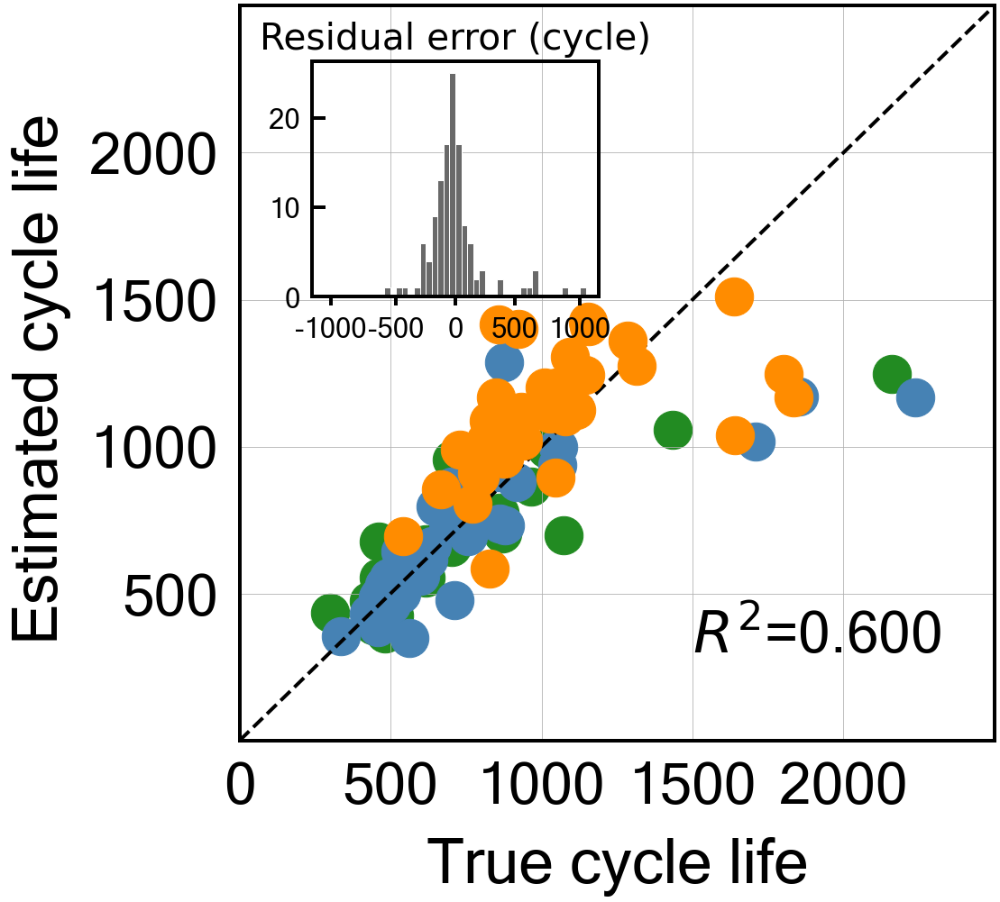


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.16171323285950623
Cycle no: Average_2to64
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to64') : 0.03526082140186509
T_Q('Charge', 'Max-Min', 'Average_2to64') : -0.09285924611306731
T_Q('Discharge', 'Variance', 'Average_2to64') : 0.08787788976753606
dTdQ('Charge', 'Mean', 'Average_2to64') : -0.038400812258465616
dTdQ('Charge', 'Skewness', 'Average_2to64') : 0.014361640122640653
dTdQ('Charge', 'Maximum', 'Average_2to64') : -0.07256933582589123

Intercept: 2.7939698976436373
r2-score: 0.737
MAE_all: 145.8
MAE_train: 102.9
MAE_test: 126.9
MAE_2ndTest: 209.4
MAPE_all: 15.7 %
MAPE_train: 13.3 %
MAPE_test: 13.1 %
MAPE_2ndTest: 20.8 %
RMSE_all: 233.7
RMSE_train: 186.8
RMSE_test: 246.8
RMSE_2ndTest: 261.0
RMSPE_all: 20.6 %
RMSPE_train: 18.3 %
RMSPE_test: 18.2 %
RMSPE_2ndTest: 24.8 %
Log-scale scores
All data r2-score: 0.737

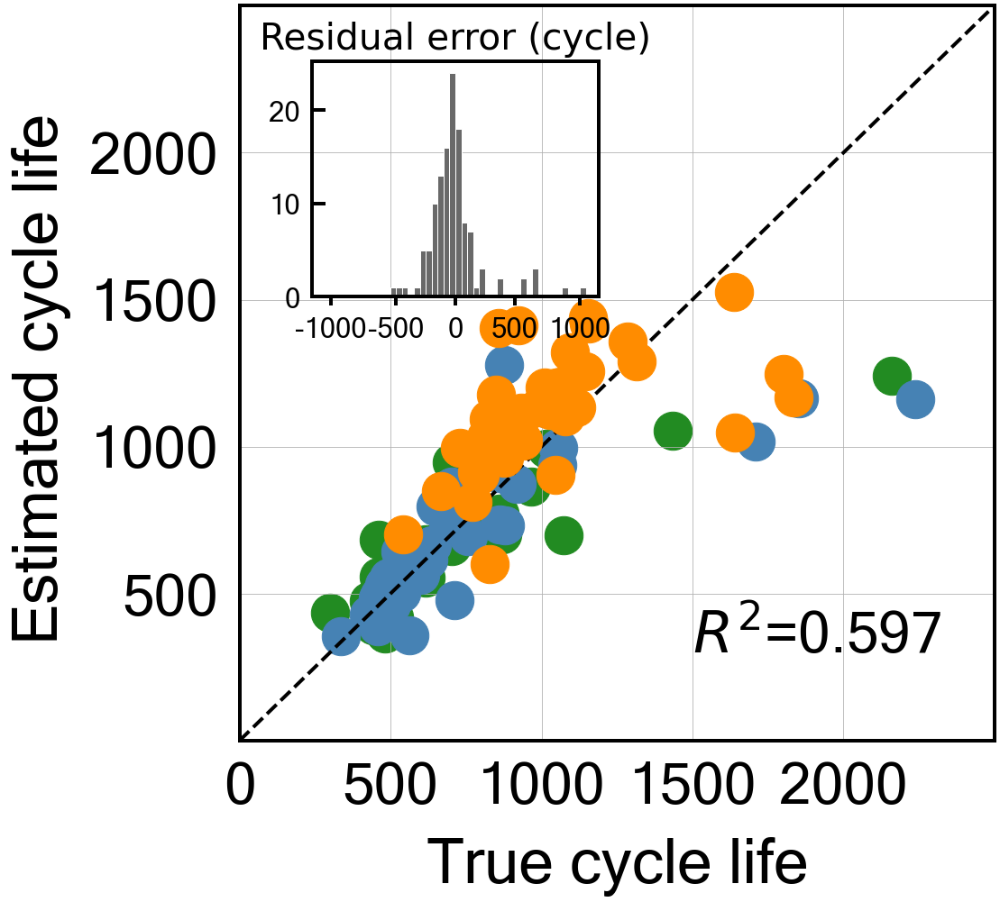


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.16556793843717454
Cycle no: Average_2to65
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to65') : 0.03558639503509408
T_Q('Charge', 'Max-Min', 'Average_2to65') : -0.09240477570931928
T_Q('Discharge', 'Variance', 'Average_2to65') : 0.08730416528436447
dTdQ('Charge', 'Mean', 'Average_2to65') : -0.0386926507897902
dTdQ('Charge', 'Skewness', 'Average_2to65') : 0.014000872974946295
dTdQ('Charge', 'Maximum', 'Average_2to65') : -0.07186131432199185

Intercept: 2.793969897643637
r2-score: 0.738
MAE_all: 145.2
MAE_train: 103.3
MAE_test: 126.6
MAE_2ndTest: 207.7
MAPE_all: 15.6 %
MAPE_train: 13.3 %
MAPE_test: 13.0 %
MAPE_2ndTest: 20.6 %
RMSE_all: 234.2
RMSE_train: 188.4
RMSE_test: 247.8
RMSE_2ndTest: 260.4
RMSPE_all: 20.5 %
RMSPE_train: 18.3 %
RMSPE_test: 18.2 %
RMSPE_2ndTest: 24.6 %
Log-scale scores
All data r2-score: 0.738
Tr

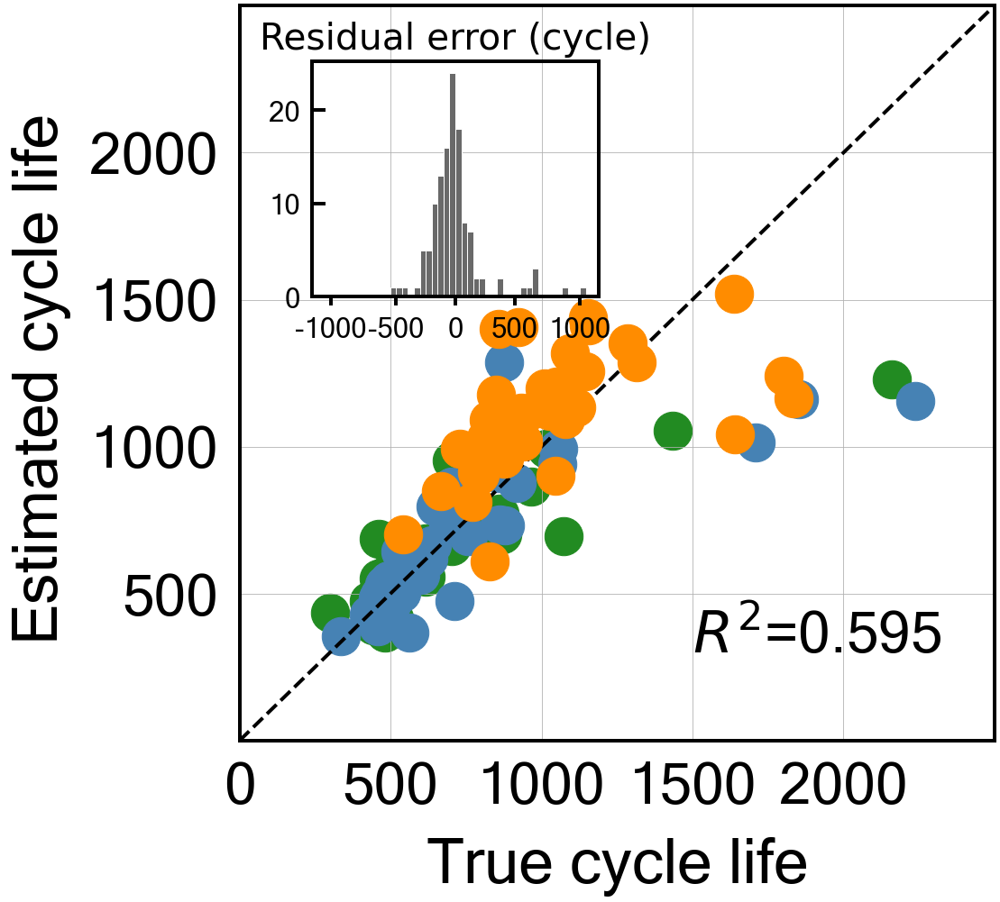


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.18692834024390526
Cycle no: Average_2to66
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to66') : 0.03925888416123815
T_Q('Charge', 'Max-Min', 'Average_2to66') : -0.08149030634892966
T_Q('Discharge', 'Variance', 'Average_2to66') : 0.07123348052670586
dTdQ('Charge', 'Mean', 'Average_2to66') : -0.03951693449497955
dTdQ('Charge', 'Skewness', 'Average_2to66') : 0.01202077552029152
dTdQ('Charge', 'Maximum', 'Average_2to66') : -0.06461055344834907

Intercept: 2.793969897643636
r2-score: 0.728
MAE_all: 143.9
MAE_train: 105.6
MAE_test: 131.8
MAE_2ndTest: 195.9
MAPE_all: 15.3 %
MAPE_train: 13.5 %
MAPE_test: 13.2 %
MAPE_2ndTest: 19.2 %
RMSE_all: 242.9
RMSE_train: 198.8
RMSE_test: 266.9
RMSE_2ndTest: 257.1
RMSPE_all: 20.6 %
RMSPE_train: 18.9 %
RMSPE_test: 19.1 %
RMSPE_2ndTest: 23.6 %
Log-scale scores
All data r2-score: 0.728
Tr

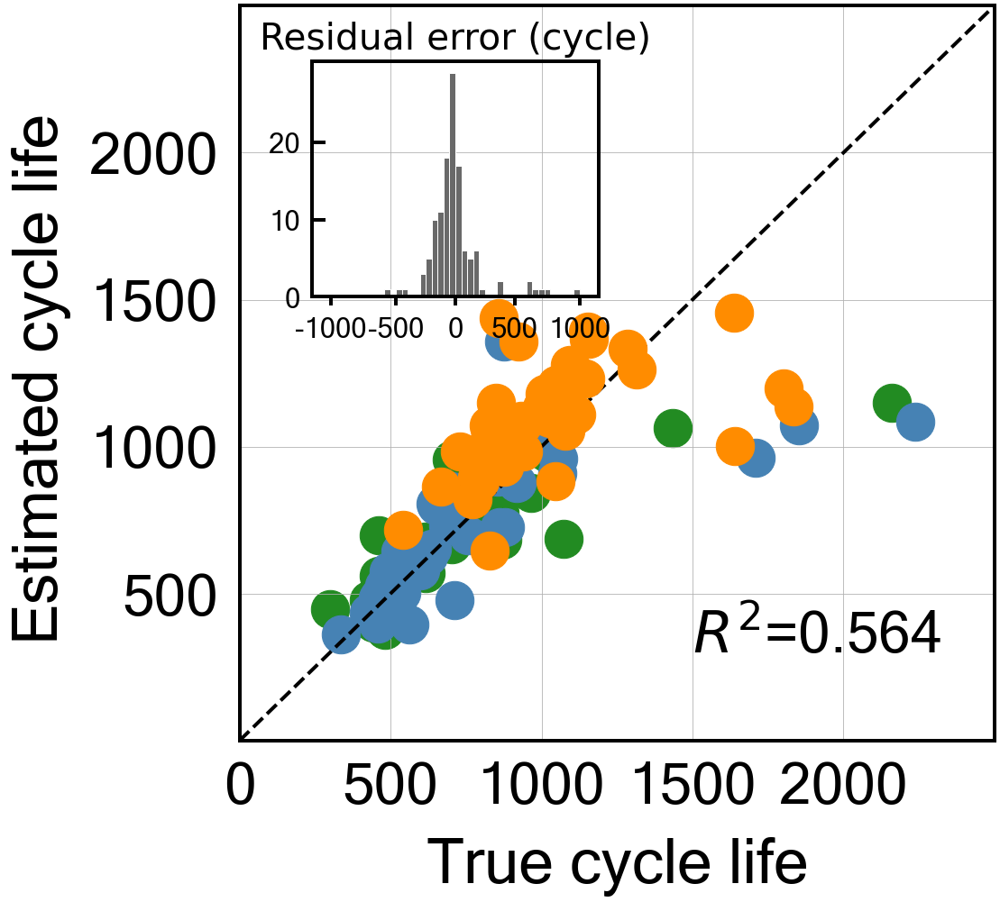


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.1812625251510388
Cycle no: Average_2to67
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to67') : 0.03960362130562975
T_Q('Charge', 'Max-Min', 'Average_2to67') : -0.08103749322524326
T_Q('Discharge', 'Variance', 'Average_2to67') : 0.07088367065603465
dTdQ('Charge', 'Mean', 'Average_2to67') : -0.03920884033614073
dTdQ('Charge', 'Skewness', 'Average_2to67') : 0.012482112941675817
dTdQ('Charge', 'Maximum', 'Average_2to67') : -0.06491043028232477

Intercept: 2.793969897643638
r2-score: 0.728
MAE_all: 144.3
MAE_train: 105.7
MAE_test: 131.3
MAE_2ndTest: 197.5
MAPE_all: 15.3 %
MAPE_train: 13.5 %
MAPE_test: 13.2 %
MAPE_2ndTest: 19.4 %
RMSE_all: 243.0
RMSE_train: 198.9
RMSE_test: 266.3
RMSE_2ndTest: 258.0
RMSPE_all: 20.6 %
RMSPE_train: 18.9 %
RMSPE_test: 18.9 %
RMSPE_2ndTest: 23.8 %
Log-scale scores
All data r2-score: 0.728
Tr

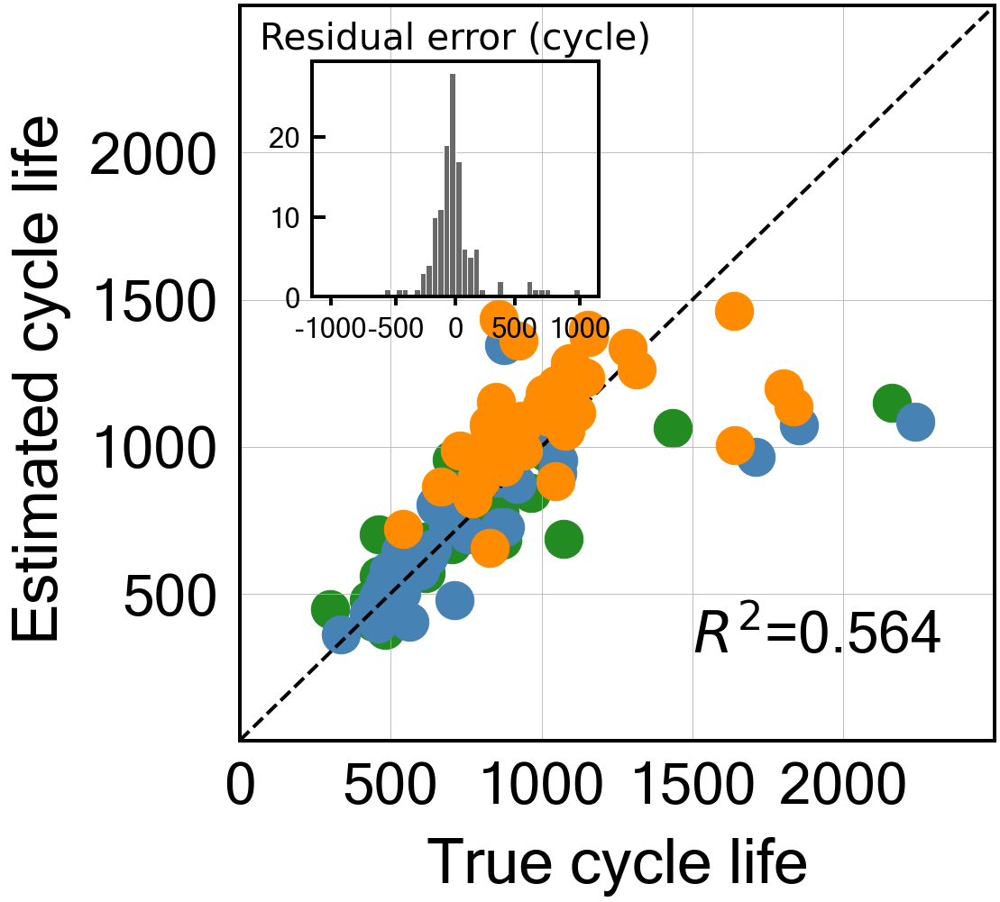


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.9
Best score obtained was: 0.144637686271888
Cycle no: Average_2to68
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to68') : 0.04259250888358757
T_Q('Charge', 'Max-Min', 'Average_2to68') : -0.08229840368488005
T_Q('Discharge', 'Variance', 'Average_2to68') : 0.06874295037942667
dTdQ('Charge', 'Mean', 'Average_2to68') : -0.03635956849522275
dTdQ('Charge', 'Skewness', 'Average_2to68') : 0.012381450949612674
dTdQ('Charge', 'Maximum', 'Average_2to68') : -0.06470872018318687

Intercept: 2.793969897643637
r2-score: 0.722
MAE_all: 147.3
MAE_train: 106.4
MAE_test: 131.1
MAE_2ndTest: 206.2
MAPE_all: 15.6 %
MAPE_train: 13.6 %
MAPE_test: 13.1 %
MAPE_2ndTest: 20.4 %
RMSE_all: 245.9
RMSE_train: 200.7
RMSE_test: 267.5
RMSE_2ndTest: 263.7
RMSPE_all: 20.9 %
RMSPE_train: 18.9 %
RMSPE_test: 18.9 %
RMSPE_2ndTest: 24.6 %
Log-scale scores
All data r2-score: 0.722
Tra

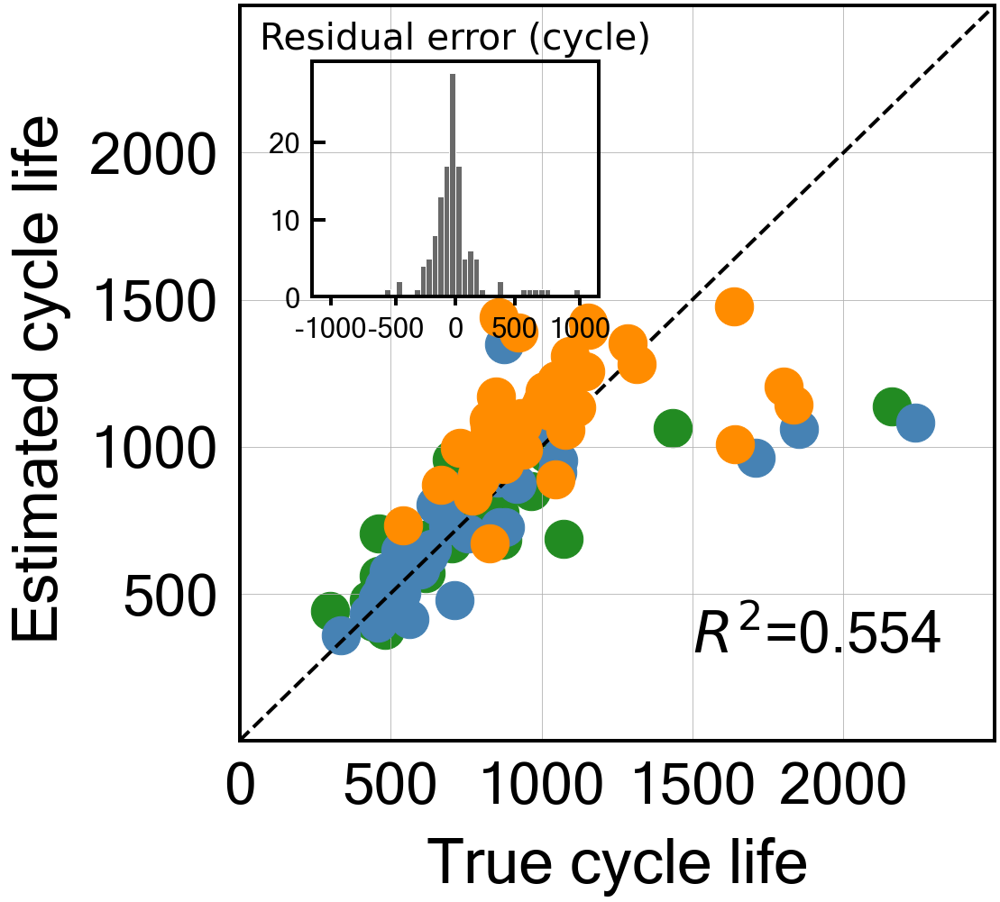


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.9
Best score obtained was: 0.1384820838489097
Cycle no: Average_2to69
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to69') : 0.04312596253555029
T_Q('Charge', 'Max-Min', 'Average_2to69') : -0.08201185647655981
T_Q('Discharge', 'Variance', 'Average_2to69') : 0.06835740726086918
dTdQ('Charge', 'Mean', 'Average_2to69') : -0.036240289551511706
dTdQ('Charge', 'Skewness', 'Average_2to69') : 0.012830770193453111
dTdQ('Charge', 'Maximum', 'Average_2to69') : -0.06491881722424388

Intercept: 2.793969897643636
r2-score: 0.721
MAE_all: 148.0
MAE_train: 106.6
MAE_test: 130.9
MAE_2ndTest: 208.3
MAPE_all: 15.7 %
MAPE_train: 13.6 %
MAPE_test: 13.0 %
MAPE_2ndTest: 20.6 %
RMSE_all: 246.2
RMSE_train: 200.6
RMSE_test: 267.6
RMSE_2ndTest: 264.6
RMSPE_all: 21.0 %
RMSPE_train: 19.0 %
RMSPE_test: 18.9 %
RMSPE_2ndTest: 24.8 %
Log-scale scores
All data r2-score: 0.721
T

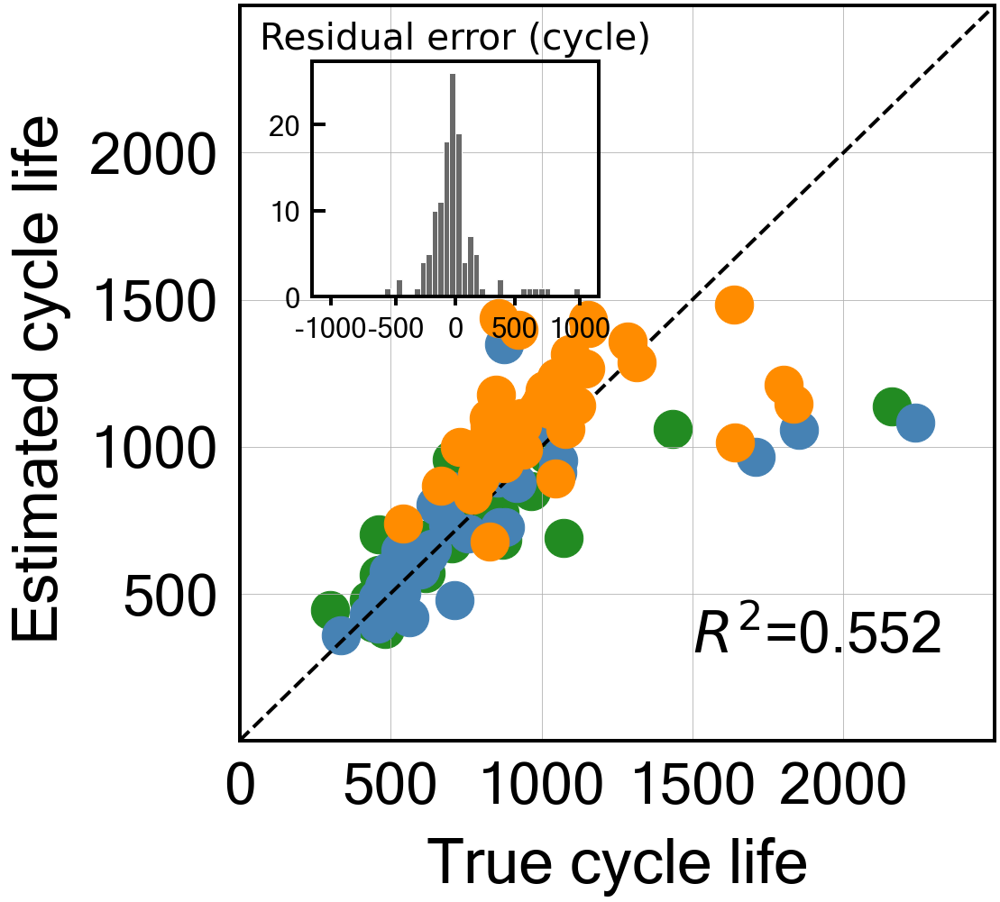


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.9
Best score obtained was: 0.1602958240723099
Cycle no: Average_2to70
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to70') : 0.04132122094891829
T_Q('Charge', 'Max-Min', 'Average_2to70') : -0.08078729183320985
T_Q('Discharge', 'Variance', 'Average_2to70') : 0.06948758046491676
dTdQ('Charge', 'Mean', 'Average_2to70') : -0.037900215442736036
dTdQ('Charge', 'Skewness', 'Average_2to70') : 0.013631654575731697
dTdQ('Charge', 'Maximum', 'Average_2to70') : -0.06531621428254863

Intercept: 2.7939698976436382
r2-score: 0.725
MAE_all: 146.3
MAE_train: 106.5
MAE_test: 130.6
MAE_2ndTest: 203.7
MAPE_all: 15.5 %
MAPE_train: 13.6 %
MAPE_test: 13.0 %
MAPE_2ndTest: 20.1 %
RMSE_all: 244.8
RMSE_train: 200.4
RMSE_test: 267.1
RMSE_2ndTest: 261.3
RMSPE_all: 20.8 %
RMSPE_train: 19.0 %
RMSPE_test: 18.9 %
RMSPE_2ndTest: 24.3 %
Log-scale scores
All data r2-score: 0.725


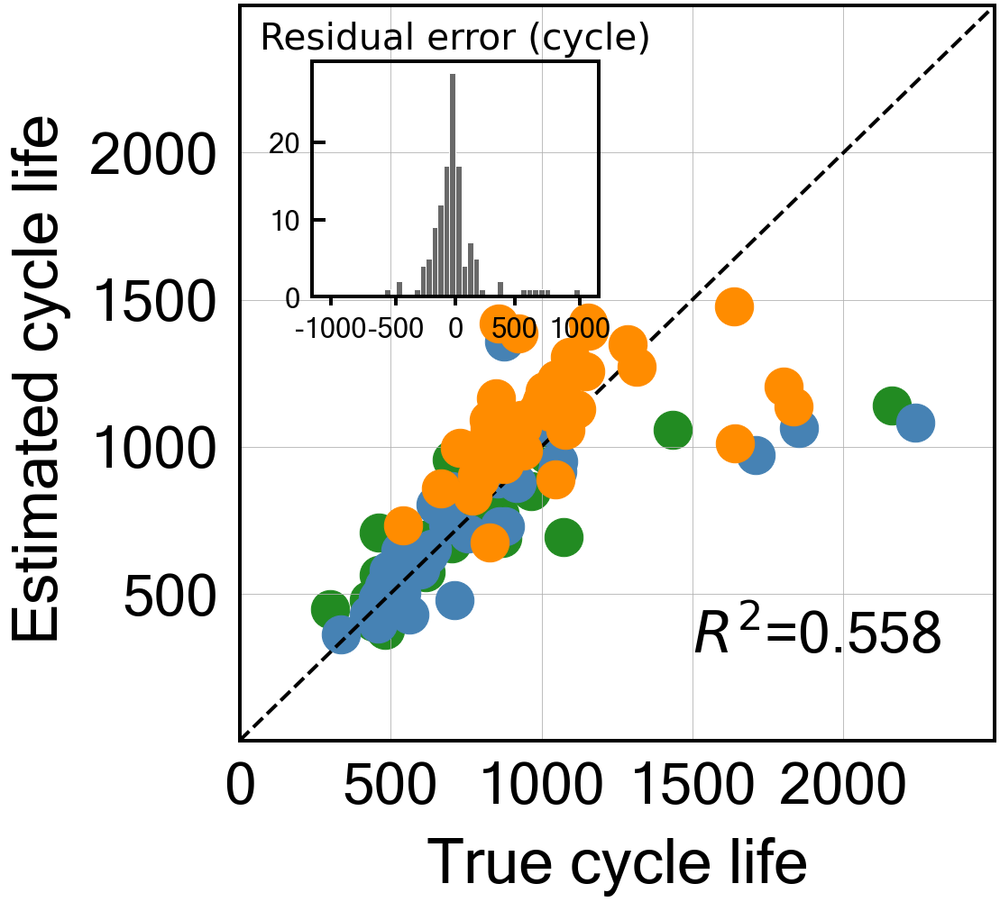


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.12379374059293669
Cycle no: Average_2to71
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to71') : 0.04387763167787883
T_Q('Charge', 'Max-Min', 'Average_2to71') : -0.08183189344654918
T_Q('Discharge', 'Variance', 'Average_2to71') : 0.06694124155452187
dTdQ('Charge', 'Mean', 'Average_2to71') : -0.03544305305484005
dTdQ('Charge', 'Skewness', 'Average_2to71') : 0.013370004586512678
dTdQ('Charge', 'Maximum', 'Average_2to71') : -0.06502437532461722

Intercept: 2.7939698976436373
r2-score: 0.718
MAE_all: 149.1
MAE_train: 106.9
MAE_test: 131.4
MAE_2ndTest: 211.0
MAPE_all: 15.8 %
MAPE_train: 13.7 %
MAPE_test: 13.0 %
MAPE_2ndTest: 20.9 %
RMSE_all: 248.2
RMSE_train: 201.4
RMSE_test: 270.0
RMSE_2ndTest: 266.9
RMSPE_all: 21.2 %
RMSPE_train: 19.1 %
RMSPE_test: 19.0 %
RMSPE_2ndTest: 25.1 %
Log-scale scores
All data r2-score: 0.718


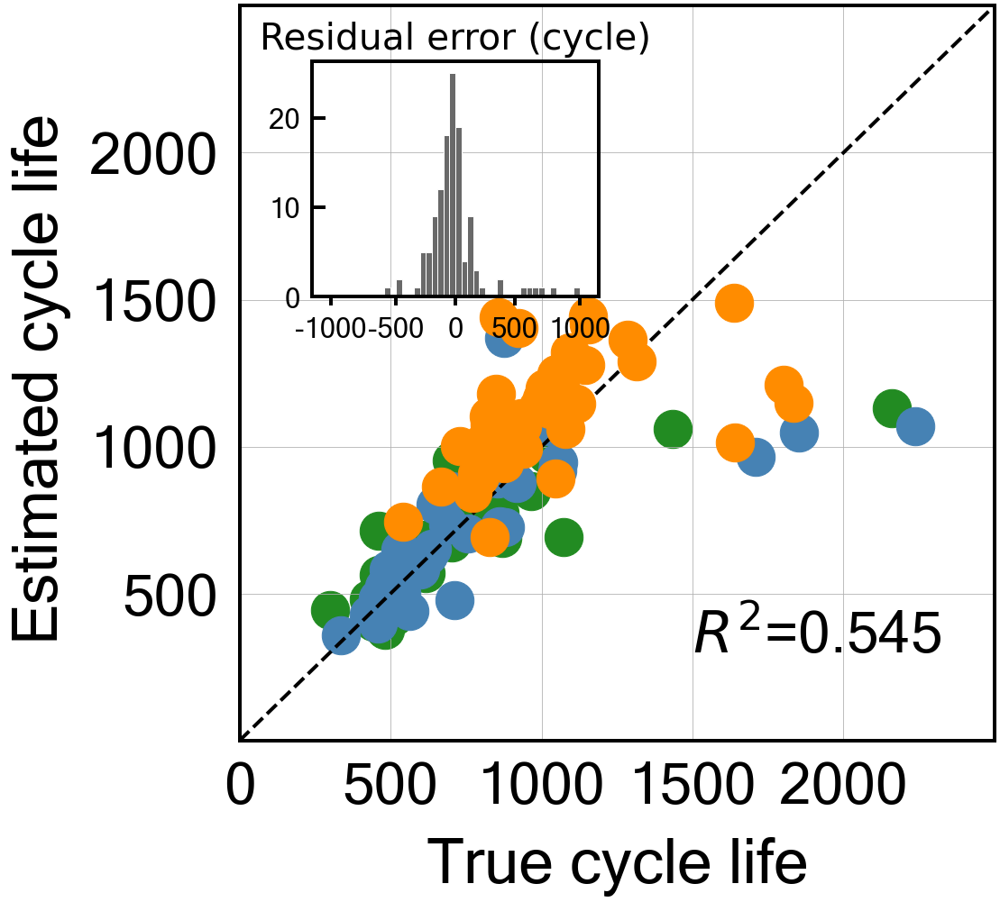


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.7
Best score obtained was: 0.14389124844321566
Cycle no: Average_2to72
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to72') : 0.04239175591091419
T_Q('Charge', 'Max-Min', 'Average_2to72') : -0.07929529999684784
T_Q('Discharge', 'Variance', 'Average_2to72') : 0.06831014778779676
dTdQ('Charge', 'Mean', 'Average_2to72') : -0.03823532478915818
dTdQ('Charge', 'Skewness', 'Average_2to72') : 0.014427807912698456
dTdQ('Charge', 'Maximum', 'Average_2to72') : -0.06605515105126057

Intercept: 2.7939698976436365
r2-score: 0.723
MAE_all: 147.4
MAE_train: 106.5
MAE_test: 130.2
MAE_2ndTest: 207.2
MAPE_all: 15.6 %
MAPE_train: 13.6 %
MAPE_test: 12.9 %
MAPE_2ndTest: 20.5 %
RMSE_all: 246.0
RMSE_train: 200.9
RMSE_test: 267.6
RMSE_2ndTest: 263.8
RMSPE_all: 21.0 %
RMSPE_train: 19.1 %
RMSPE_test: 18.8 %
RMSPE_2ndTest: 24.7 %
Log-scale scores
All data r2-score: 0.723


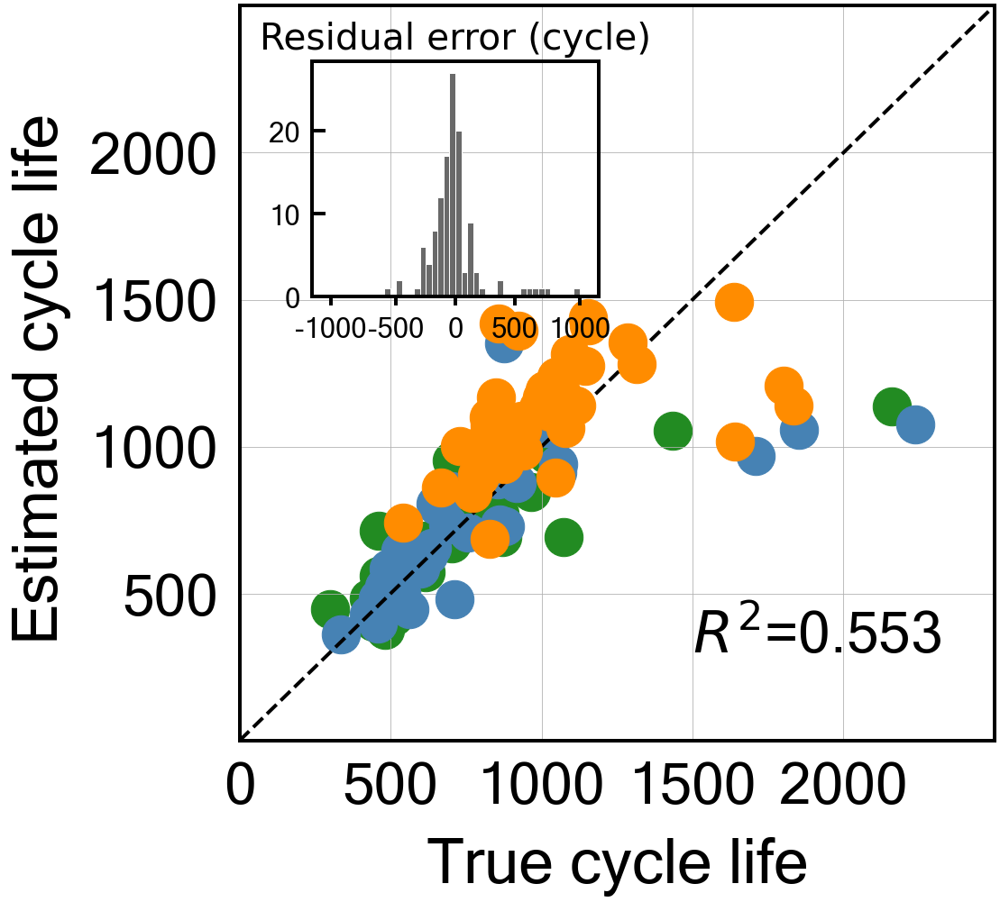


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.9
Best score obtained was: 0.1371185138994273
Cycle no: Average_2to73
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to73') : 0.04267615698377325
T_Q('Charge', 'Max-Min', 'Average_2to73') : -0.07867769332070976
T_Q('Discharge', 'Variance', 'Average_2to73') : 0.06822910632787908
dTdQ('Charge', 'Mean', 'Average_2to73') : -0.03845503521273742
dTdQ('Charge', 'Skewness', 'Average_2to73') : 0.015066731605480237
dTdQ('Charge', 'Maximum', 'Average_2to73') : -0.06668156307241542

Intercept: 2.7939698976436365
r2-score: 0.722
MAE_all: 147.9
MAE_train: 106.6
MAE_test: 130.2
MAE_2ndTest: 208.9
MAPE_all: 15.7 %
MAPE_train: 13.6 %
MAPE_test: 12.9 %
MAPE_2ndTest: 20.7 %
RMSE_all: 246.3
RMSE_train: 201.1
RMSE_test: 267.3
RMSE_2ndTest: 264.8
RMSPE_all: 21.1 %
RMSPE_train: 19.2 %
RMSPE_test: 18.8 %
RMSPE_2ndTest: 24.8 %
Log-scale scores
All data r2-score: 0.722
T

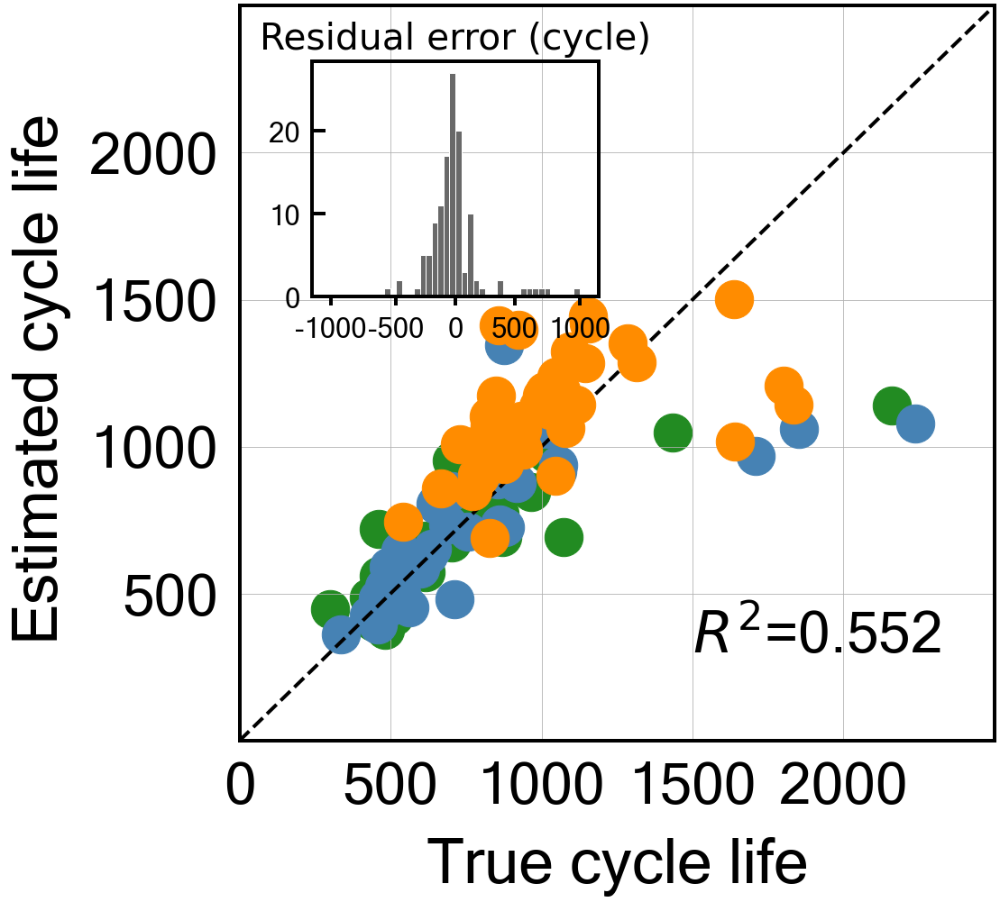


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.12768288177040066
Cycle no: Average_2to74
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to74') : 0.04310320274026197
T_Q('Charge', 'Max-Min', 'Average_2to74') : -0.07816073389359479
T_Q('Discharge', 'Variance', 'Average_2to74') : 0.06762053215659684
dTdQ('Charge', 'Mean', 'Average_2to74') : -0.03835680075007978
dTdQ('Charge', 'Skewness', 'Average_2to74') : 0.01536268800498699
dTdQ('Charge', 'Maximum', 'Average_2to74') : -0.06680059627611029

Intercept: 2.7939698976436356
r2-score: 0.719
MAE_all: 148.8
MAE_train: 106.9
MAE_test: 130.3
MAE_2ndTest: 211.2
MAPE_all: 15.8 %
MAPE_train: 13.6 %
MAPE_test: 13.0 %
MAPE_2ndTest: 21.0 %
RMSE_all: 247.3
RMSE_train: 201.9
RMSE_test: 268.1
RMSE_2ndTest: 266.3
RMSPE_all: 21.2 %
RMSPE_train: 19.3 %
RMSPE_test: 18.8 %
RMSPE_2ndTest: 25.1 %
Log-scale scores
All data r2-score: 0.719
T

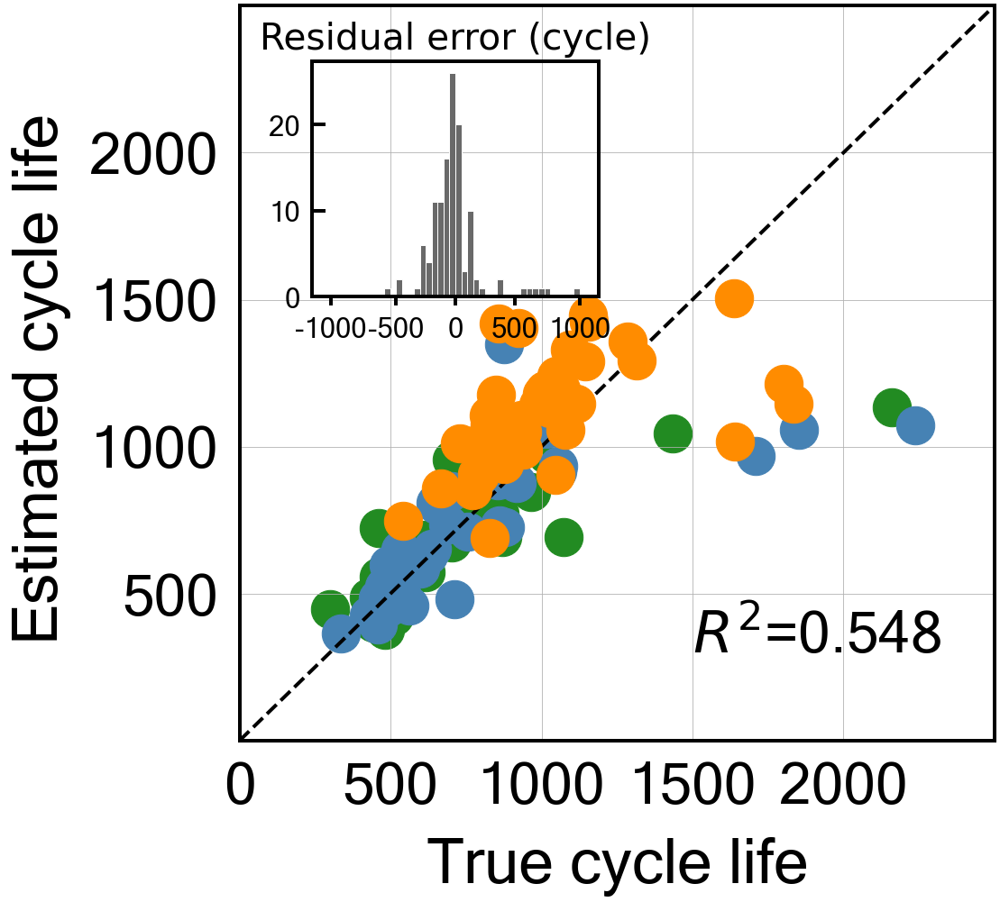


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.13013065975744087
Cycle no: Average_2to75
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to75') : 0.04284852284191883
T_Q('Charge', 'Max-Min', 'Average_2to75') : -0.07809008977669823
T_Q('Discharge', 'Variance', 'Average_2to75') : 0.06802088582456856
dTdQ('Charge', 'Mean', 'Average_2to75') : -0.038434781004609495
dTdQ('Charge', 'Skewness', 'Average_2to75') : 0.015344711016660295
dTdQ('Charge', 'Maximum', 'Average_2to75') : -0.06703620747072608

Intercept: 2.793969897643637
r2-score: 0.719
MAE_all: 148.7
MAE_train: 106.9
MAE_test: 130.2
MAE_2ndTest: 210.9
MAPE_all: 15.8 %
MAPE_train: 13.7 %
MAPE_test: 12.9 %
MAPE_2ndTest: 21.0 %
RMSE_all: 247.4
RMSE_train: 201.9
RMSE_test: 268.5
RMSE_2ndTest: 265.9
RMSPE_all: 21.2 %
RMSPE_train: 19.3 %
RMSPE_test: 18.8 %
RMSPE_2ndTest: 25.1 %
Log-scale scores
All data r2-score: 0.719


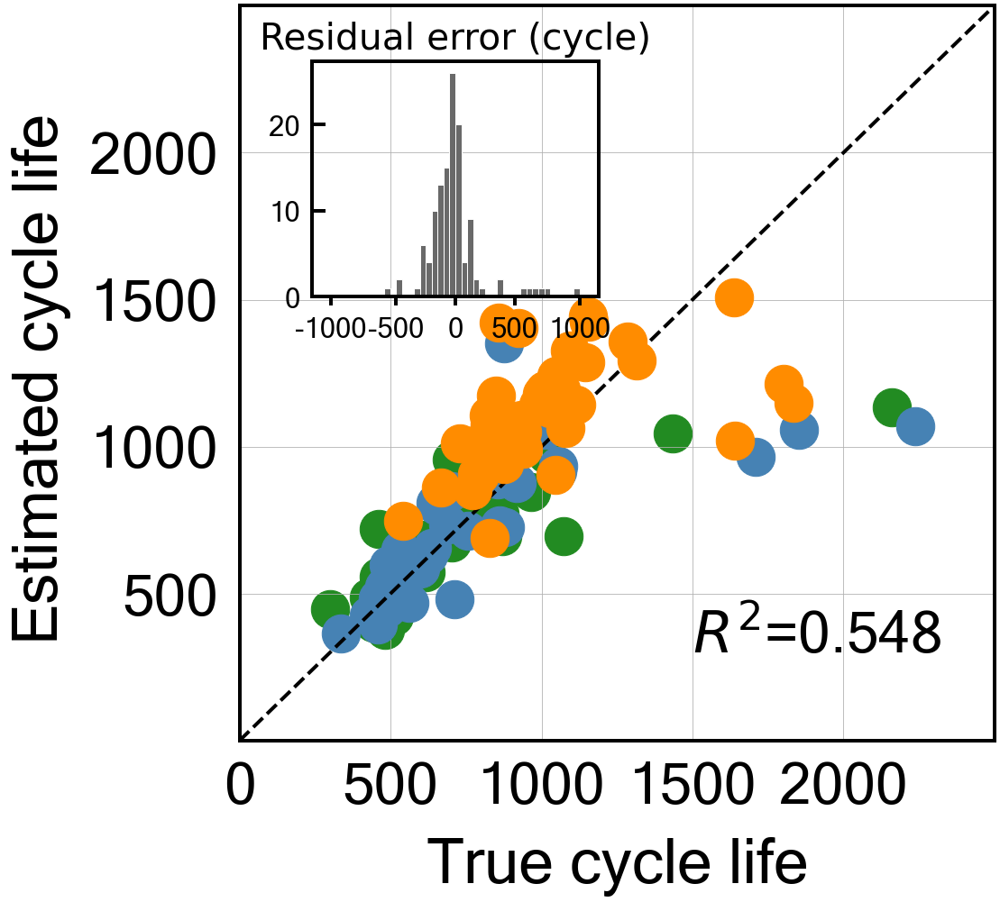


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.8
Best score obtained was: 0.12575531495416714
Cycle no: Average_2to76
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to76') : 0.043036928474936835
T_Q('Charge', 'Max-Min', 'Average_2to76') : -0.07812485336539844
T_Q('Discharge', 'Variance', 'Average_2to76') : 0.06803582421181949
dTdQ('Charge', 'Mean', 'Average_2to76') : -0.03797975761749195
dTdQ('Charge', 'Skewness', 'Average_2to76') : 0.01565342002196843
dTdQ('Charge', 'Maximum', 'Average_2to76') : -0.06732721784650499

Intercept: 2.7939698976436365
r2-score: 0.718
MAE_all: 148.8
MAE_train: 107.2
MAE_test: 129.5
MAE_2ndTest: 211.9
MAPE_all: 15.8 %
MAPE_train: 13.7 %
MAPE_test: 12.8 %
MAPE_2ndTest: 21.1 %
RMSE_all: 247.8
RMSE_train: 202.6
RMSE_test: 268.4
RMSE_2ndTest: 266.6
RMSPE_all: 21.2 %
RMSPE_train: 19.4 %
RMSPE_test: 18.7 %
RMSPE_2ndTest: 25.2 %
Log-scale scores
All data r2-score: 0.718


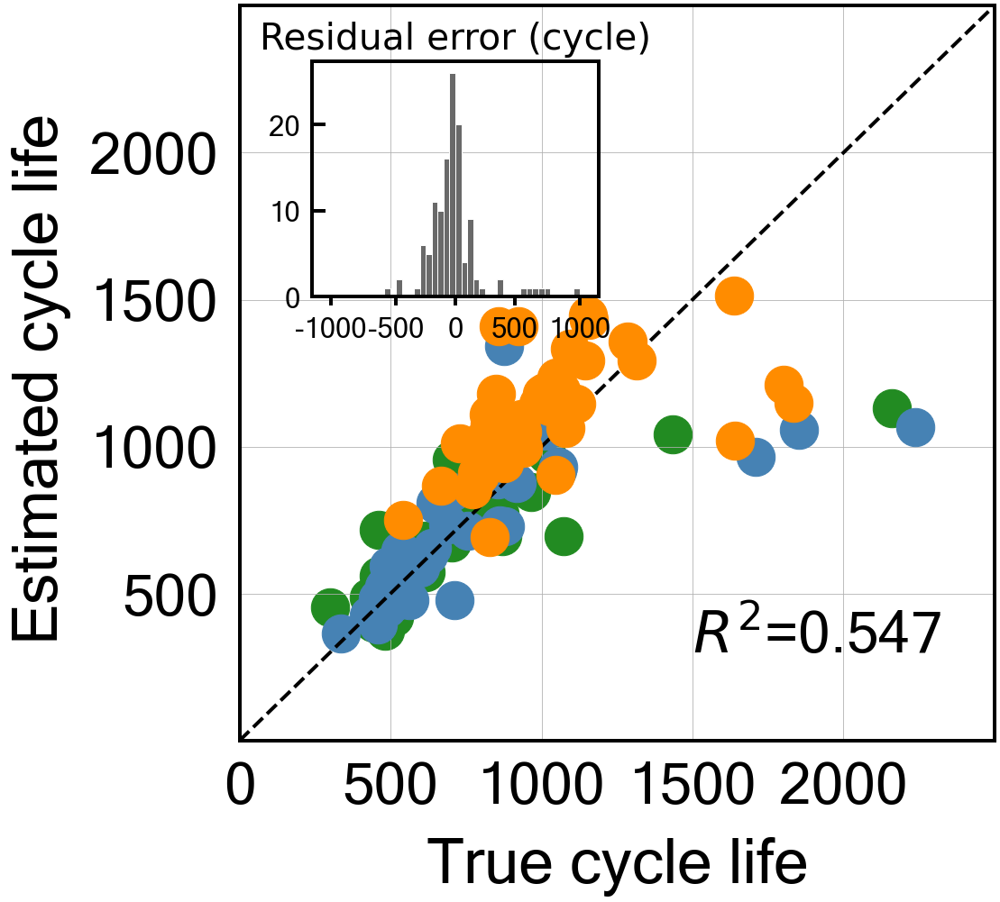


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.4
Best score obtained was: 0.1281547679465017
Cycle no: Average_2to77
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to77') : 0.04284720150060142
T_Q('Charge', 'Max-Min', 'Average_2to77') : -0.07803122246067787
T_Q('Discharge', 'Variance', 'Average_2to77') : 0.0681662099861569
dTdQ('Charge', 'Mean', 'Average_2to77') : -0.03813677549210698
dTdQ('Charge', 'Skewness', 'Average_2to77') : 0.01570419704253693
dTdQ('Charge', 'Maximum', 'Average_2to77') : -0.06726853068643852

Intercept: 2.7939698976436382
r2-score: 0.719
MAE_all: 148.6
MAE_train: 107.4
MAE_test: 129.1
MAE_2ndTest: 211.3
MAPE_all: 15.8 %
MAPE_train: 13.7 %
MAPE_test: 12.7 %
MAPE_2ndTest: 21.0 %
RMSE_all: 247.5
RMSE_train: 202.8
RMSE_test: 267.9
RMSE_2ndTest: 266.2
RMSPE_all: 21.2 %
RMSPE_train: 19.4 %
RMSPE_test: 18.7 %
RMSPE_2ndTest: 25.1 %
Log-scale scores
All data r2-score: 0.719
Tra

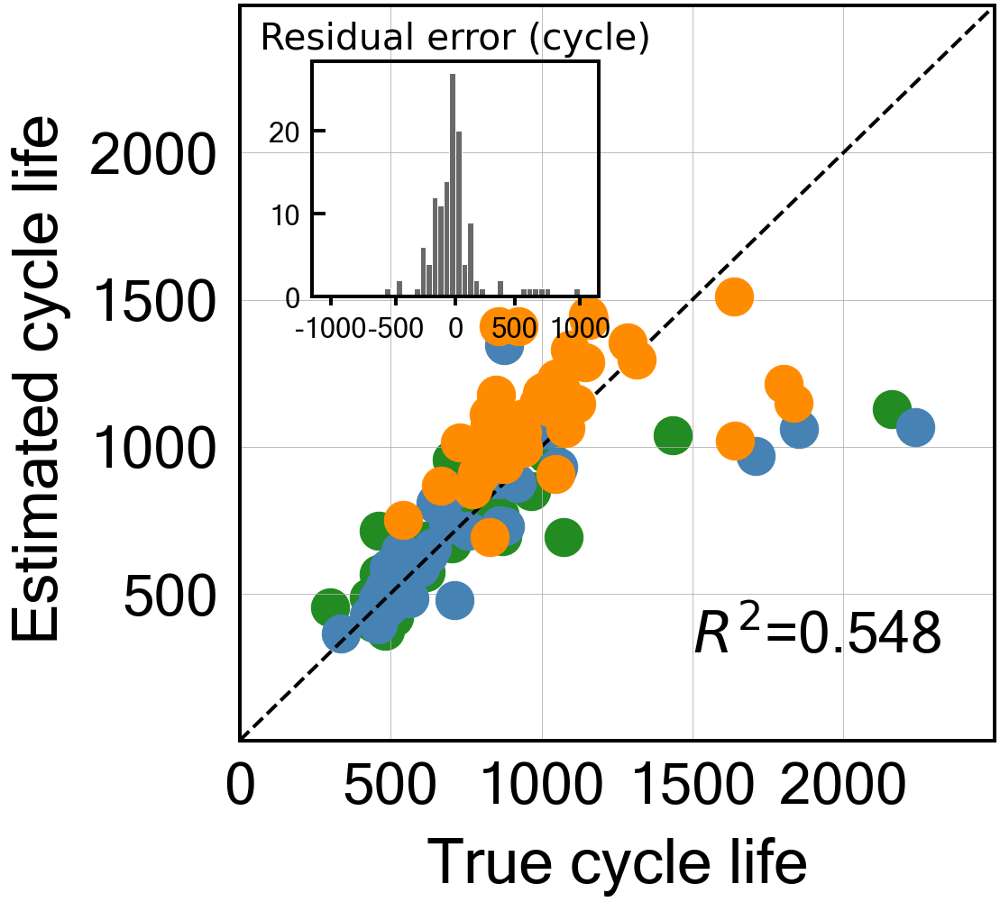


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 6.0
Best score obtained was: 0.1780135994686357
Cycle no: Average_2to78
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to78') : 0.04428073600548119
T_Q('Charge', 'Max-Min', 'Average_2to78') : -0.07182013437160224
T_Q('Discharge', 'Variance', 'Average_2to78') : 0.05624629996102806
dTdQ('Charge', 'Mean', 'Average_2to78') : -0.03778437219858745
dTdQ('Charge', 'Skewness', 'Average_2to78') : 0.012587702757013725
dTdQ('Charge', 'Maximum', 'Average_2to78') : -0.059320876643838415

Intercept: 2.7939698976436373
r2-score: 0.710
MAE_all: 144.6
MAE_train: 109.4
MAE_test: 132.7
MAE_2ndTest: 193.2
MAPE_all: 15.1 %
MAPE_train: 13.9 %
MAPE_test: 12.8 %
MAPE_2ndTest: 18.8 %
RMSE_all: 253.2
RMSE_train: 212.2
RMSE_test: 283.1
RMSE_2ndTest: 258.5
RMSPE_all: 21.0 %
RMSPE_train: 19.9 %
RMSPE_test: 19.5 %
RMSPE_2ndTest: 23.4 %
Log-scale scores
All data r2-score: 0.710


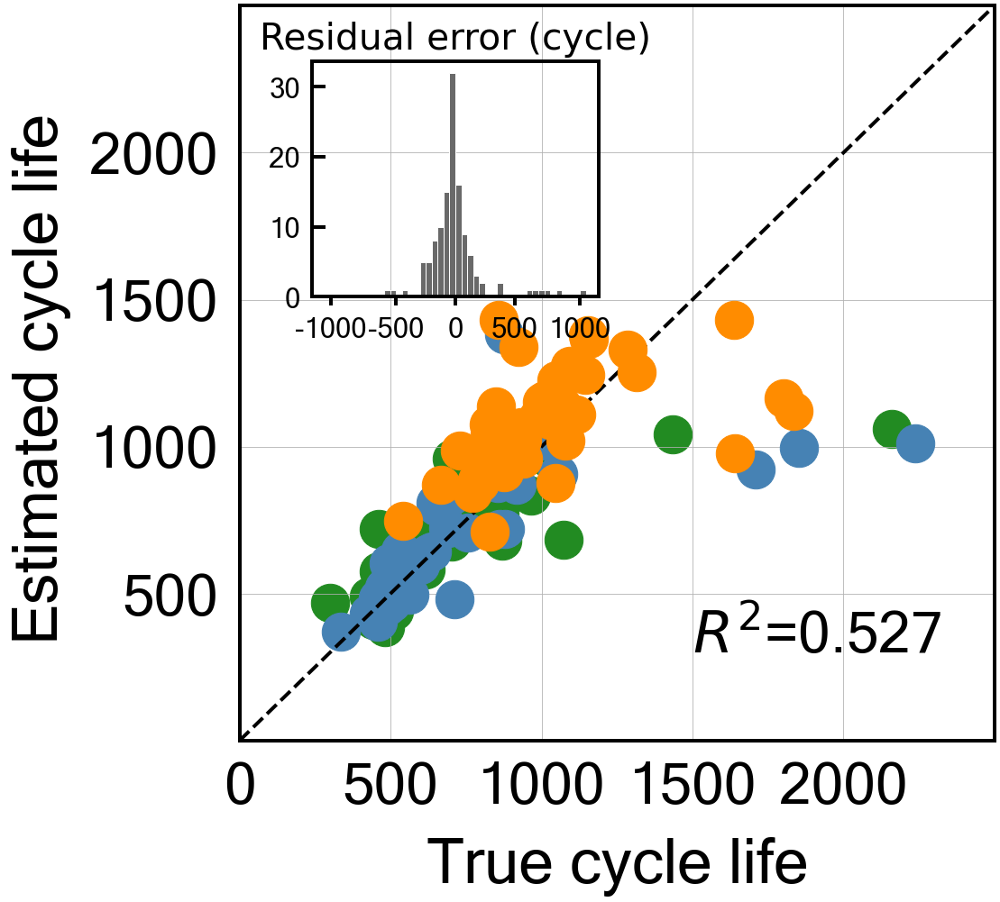


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.4
Best score obtained was: 0.1773691963076638
Cycle no: Average_2to79
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to79') : 0.04423446255672401
T_Q('Charge', 'Max-Min', 'Average_2to79') : -0.07174336208164722
T_Q('Discharge', 'Variance', 'Average_2to79') : 0.055721019687929474
dTdQ('Charge', 'Mean', 'Average_2to79') : -0.03763452216567317
dTdQ('Charge', 'Skewness', 'Average_2to79') : 0.01285556145339578
dTdQ('Charge', 'Maximum', 'Average_2to79') : -0.059296140505404646

Intercept: 2.793969897643636
r2-score: 0.710
MAE_all: 144.8
MAE_train: 109.3
MAE_test: 132.8
MAE_2ndTest: 193.8
MAPE_all: 15.2 %
MAPE_train: 13.9 %
MAPE_test: 12.8 %
MAPE_2ndTest: 18.9 %
RMSE_all: 253.5
RMSE_train: 212.2
RMSE_test: 283.9
RMSE_2ndTest: 258.6
RMSPE_all: 21.1 %
RMSPE_train: 20.0 %
RMSPE_test: 19.5 %
RMSPE_2ndTest: 23.5 %
Log-scale scores
All data r2-score: 0.710
T

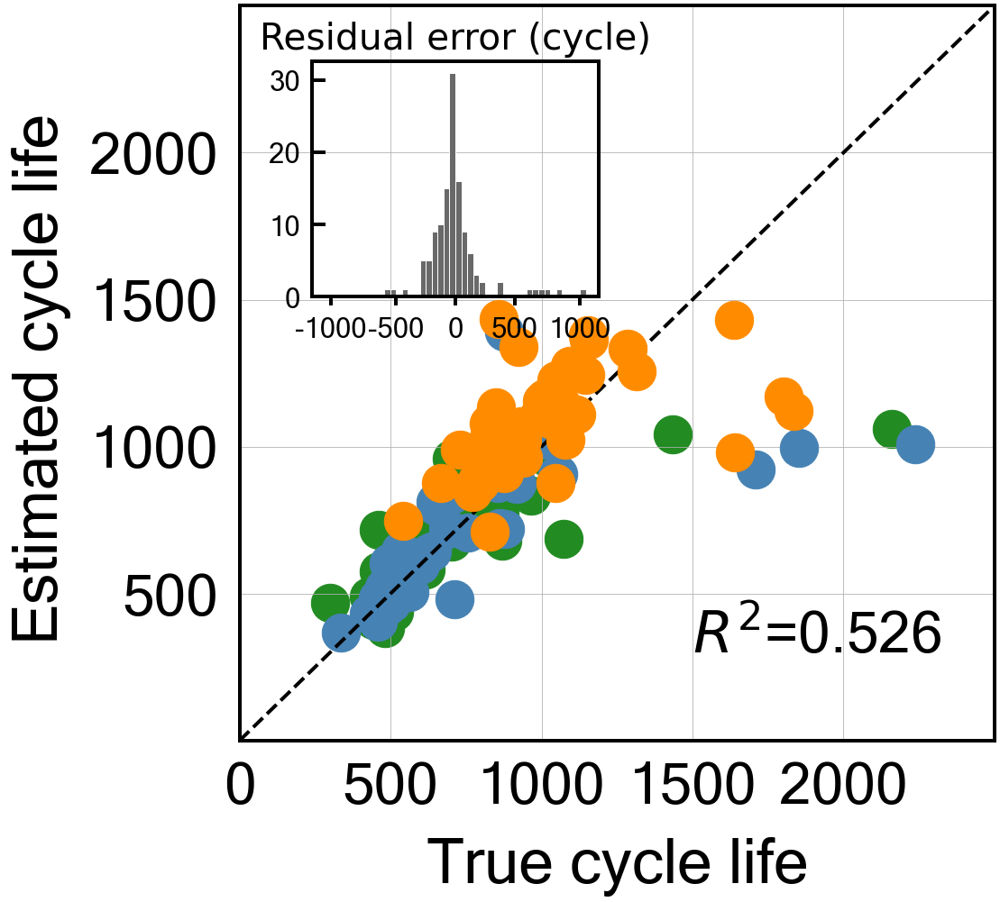


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.7
Best score obtained was: 0.17662049348118336
Cycle no: Average_2to80
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to80') : 0.04423862150481116
T_Q('Charge', 'Max-Min', 'Average_2to80') : -0.07153629466654463
T_Q('Discharge', 'Variance', 'Average_2to80') : 0.05577463113692074
dTdQ('Charge', 'Mean', 'Average_2to80') : -0.037609756807983806
dTdQ('Charge', 'Skewness', 'Average_2to80') : 0.013374011779229455
dTdQ('Charge', 'Maximum', 'Average_2to80') : -0.059433901190649084

Intercept: 2.7939698976436365
r2-score: 0.709
MAE_all: 144.8
MAE_train: 109.4
MAE_test: 132.5
MAE_2ndTest: 194.0
MAPE_all: 15.2 %
MAPE_train: 13.9 %
MAPE_test: 12.8 %
MAPE_2ndTest: 18.9 %
RMSE_all: 253.5
RMSE_train: 212.6
RMSE_test: 283.5
RMSE_2ndTest: 258.7
RMSPE_all: 21.1 %
RMSPE_train: 20.0 %
RMSPE_test: 19.5 %
RMSPE_2ndTest: 23.5 %
Log-scale scores
All data r2-score: 0.70

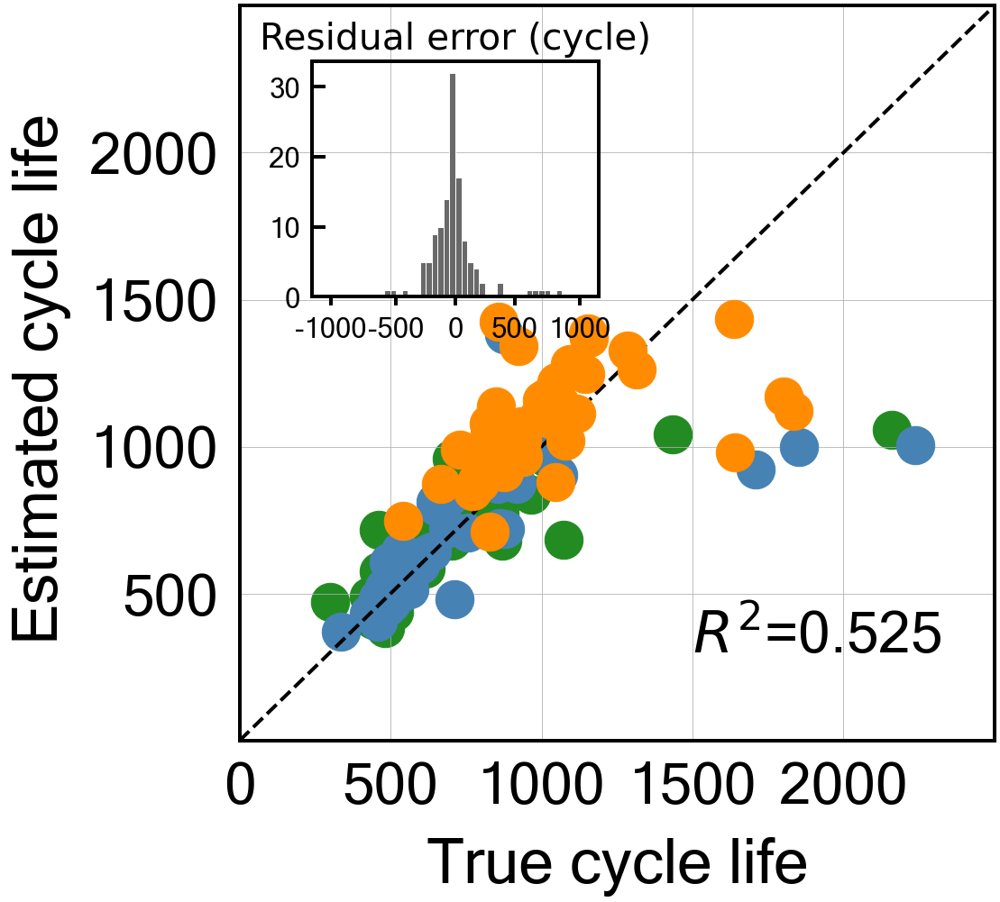


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.2
Best score obtained was: 0.18349578606849992
Cycle no: Average_2to81
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to81') : 0.04429665606658676
T_Q('Charge', 'Max-Min', 'Average_2to81') : -0.07088413224414607
T_Q('Discharge', 'Variance', 'Average_2to81') : 0.055351613015823614
dTdQ('Charge', 'Mean', 'Average_2to81') : -0.038054123950643844
dTdQ('Charge', 'Skewness', 'Average_2to81') : 0.012790863684635853
dTdQ('Charge', 'Maximum', 'Average_2to81') : -0.05888340366591365

Intercept: 2.7939698976436365
r2-score: 0.708
MAE_all: 144.4
MAE_train: 109.8
MAE_test: 132.7
MAE_2ndTest: 192.1
MAPE_all: 15.1 %
MAPE_train: 14.0 %
MAPE_test: 12.8 %
MAPE_2ndTest: 18.7 %
RMSE_all: 254.1
RMSE_train: 214.2
RMSE_test: 284.8
RMSE_2ndTest: 257.6
RMSPE_all: 21.0 %
RMSPE_train: 20.2 %
RMSPE_test: 19.5 %
RMSPE_2ndTest: 23.2 %
Log-scale scores
All data r2-score: 0.70

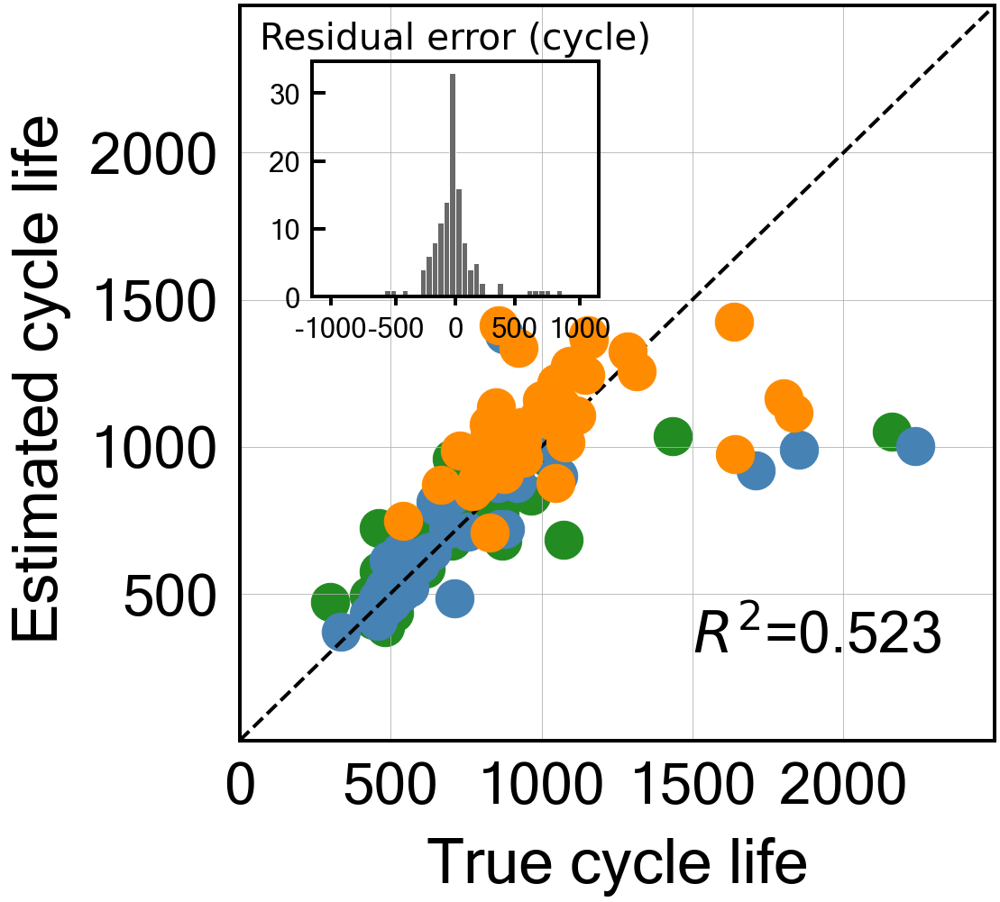


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.18061211687869883
Cycle no: Average_2to82
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to82') : 0.04458916924809488
T_Q('Charge', 'Max-Min', 'Average_2to82') : -0.07159074886777492
T_Q('Discharge', 'Variance', 'Average_2to82') : 0.055160708043869494
dTdQ('Charge', 'Mean', 'Average_2to82') : -0.037328149662471145
dTdQ('Charge', 'Skewness', 'Average_2to82') : 0.012206414867288577
dTdQ('Charge', 'Maximum', 'Average_2to82') : -0.05858531393988328

Intercept: 2.7939698976436373
r2-score: 0.707
MAE_all: 144.6
MAE_train: 110.2
MAE_test: 132.6
MAE_2ndTest: 192.5
MAPE_all: 15.1 %
MAPE_train: 14.0 %
MAPE_test: 12.7 %
MAPE_2ndTest: 18.7 %
RMSE_all: 254.6
RMSE_train: 214.5
RMSE_test: 285.3
RMSE_2ndTest: 258.1
RMSPE_all: 21.0 %
RMSPE_train: 20.2 %
RMSPE_test: 19.5 %
RMSPE_2ndTest: 23.3 %
Log-scale scores
All data r2-score: 0.70

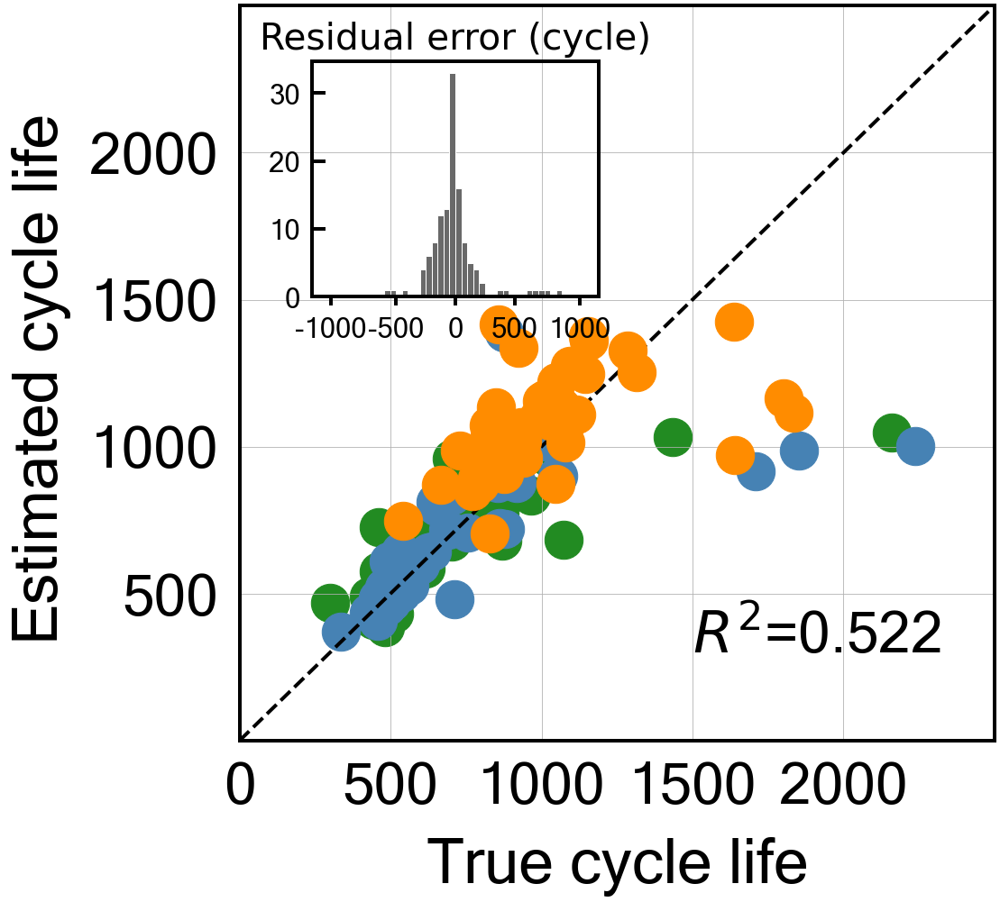


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 6.7
Best score obtained was: 0.17814702603922394
Cycle no: Average_2to83
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to83') : 0.04512673378499749
T_Q('Charge', 'Max-Min', 'Average_2to83') : -0.07167678851317848
T_Q('Discharge', 'Variance', 'Average_2to83') : 0.05492488032876149
dTdQ('Charge', 'Mean', 'Average_2to83') : -0.03673615320891761
dTdQ('Charge', 'Skewness', 'Average_2to83') : 0.012549872555911598
dTdQ('Charge', 'Maximum', 'Average_2to83') : -0.05884486678623519

Intercept: 2.7939698976436365
r2-score: 0.706
MAE_all: 145.0
MAE_train: 110.4
MAE_test: 132.4
MAE_2ndTest: 193.6
MAPE_all: 15.1 %
MAPE_train: 14.0 %
MAPE_test: 12.7 %
MAPE_2ndTest: 18.9 %
RMSE_all: 254.8
RMSE_train: 214.9
RMSE_test: 285.3
RMSE_2ndTest: 258.5
RMSPE_all: 21.1 %
RMSPE_train: 20.3 %
RMSPE_test: 19.5 %
RMSPE_2ndTest: 23.4 %
Log-scale scores
All data r2-score: 0.706


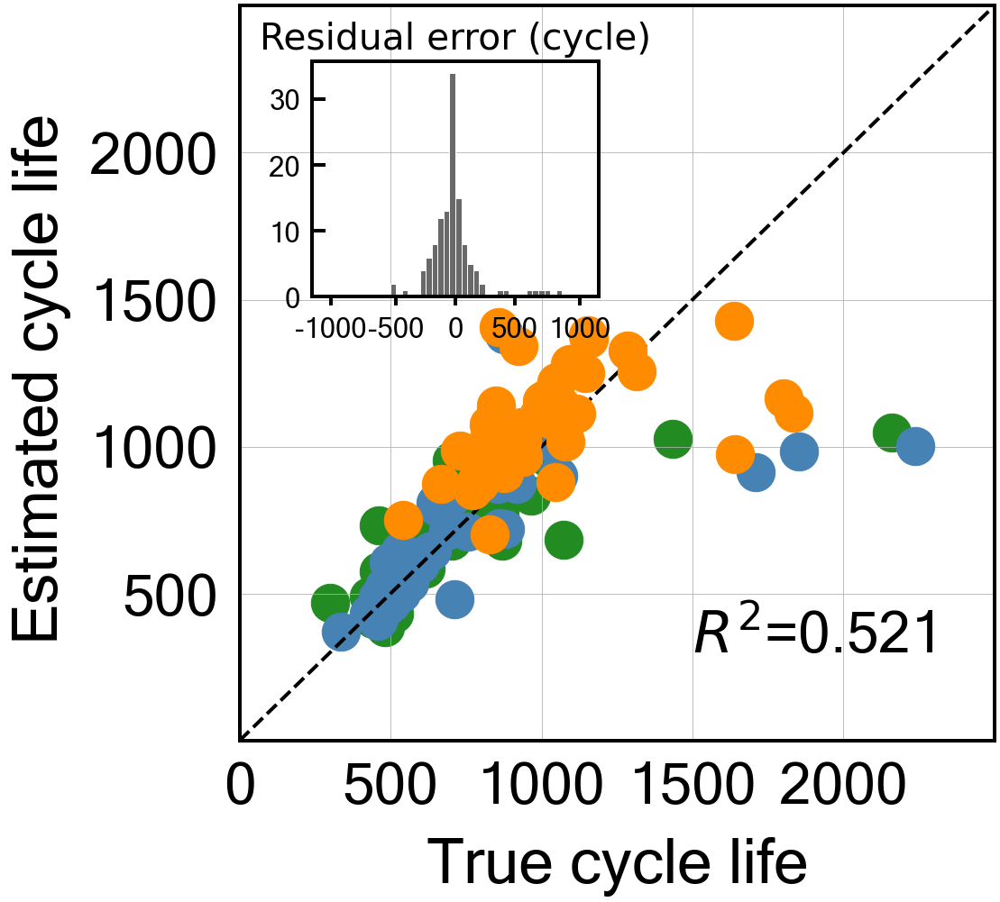


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 6.0
Best score obtained was: 0.18290383207069572
Cycle no: Average_2to84
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to84') : 0.045170137325186134
T_Q('Charge', 'Max-Min', 'Average_2to84') : -0.07125954319090401
T_Q('Discharge', 'Variance', 'Average_2to84') : 0.05530642510625066
dTdQ('Charge', 'Mean', 'Average_2to84') : -0.03711348402928425
dTdQ('Charge', 'Skewness', 'Average_2to84') : 0.012425903987060737
dTdQ('Charge', 'Maximum', 'Average_2to84') : -0.058887233978025304

Intercept: 2.793969897643636
r2-score: 0.706
MAE_all: 144.6
MAE_train: 110.5
MAE_test: 132.2
MAE_2ndTest: 192.4
MAPE_all: 15.1 %
MAPE_train: 14.0 %
MAPE_test: 12.7 %
MAPE_2ndTest: 18.7 %
RMSE_all: 254.9
RMSE_train: 215.6
RMSE_test: 285.6
RMSE_2ndTest: 257.7
RMSPE_all: 21.0 %
RMSPE_train: 20.3 %
RMSPE_test: 19.4 %
RMSPE_2ndTest: 23.2 %
Log-scale scores
All data r2-score: 0.706

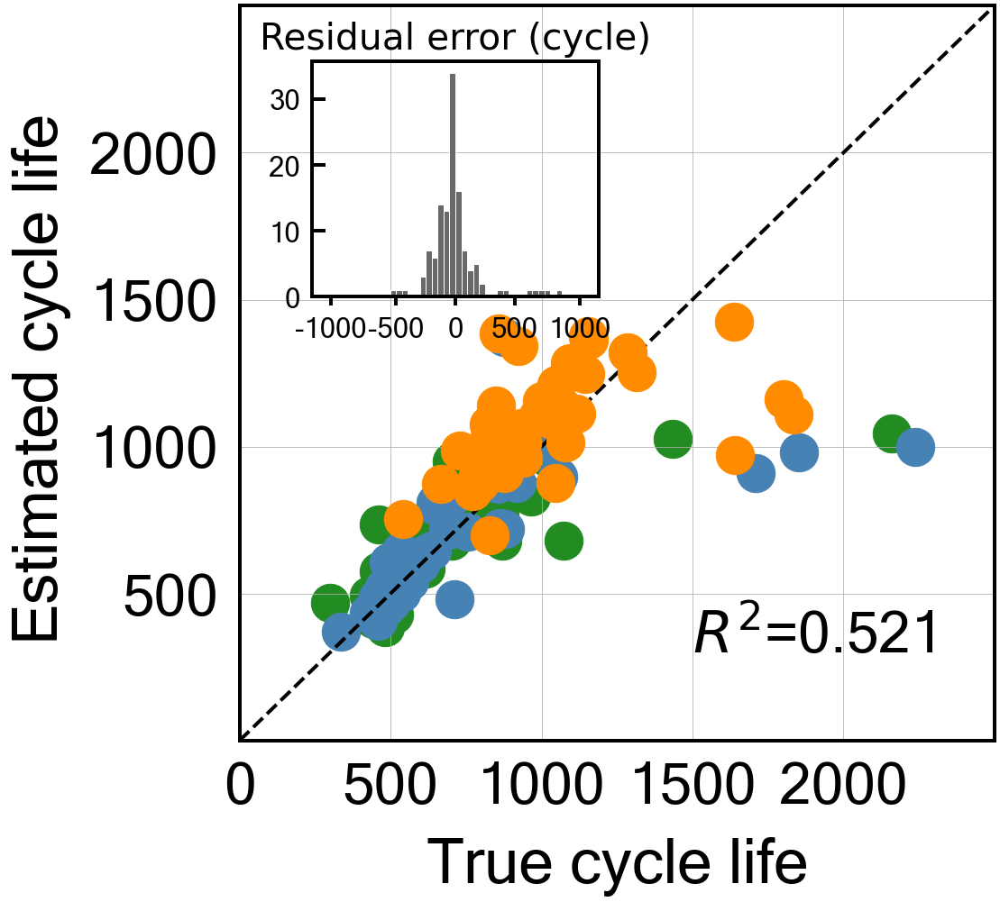


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.6
Best score obtained was: 0.1791970272556086
Cycle no: Average_2to85
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to85') : 0.04572292358346231
T_Q('Charge', 'Max-Min', 'Average_2to85') : -0.07198596352273552
T_Q('Discharge', 'Variance', 'Average_2to85') : 0.05517662691672932
dTdQ('Charge', 'Mean', 'Average_2to85') : -0.03612052375344626
dTdQ('Charge', 'Skewness', 'Average_2to85') : 0.012213866297453647
dTdQ('Charge', 'Maximum', 'Average_2to85') : -0.05896563914850467

Intercept: 2.793969897643639
r2-score: 0.706
MAE_all: 144.8
MAE_train: 110.6
MAE_test: 131.5
MAE_2ndTest: 193.7
MAPE_all: 15.1 %
MAPE_train: 14.1 %
MAPE_test: 12.5 %
MAPE_2ndTest: 18.9 %
RMSE_all: 255.0
RMSE_train: 215.7
RMSE_test: 285.5
RMSE_2ndTest: 258.3
RMSPE_all: 21.0 %
RMSPE_train: 20.3 %
RMSPE_test: 19.3 %
RMSPE_2ndTest: 23.2 %
Log-scale scores
All data r2-score: 0.706
Tr

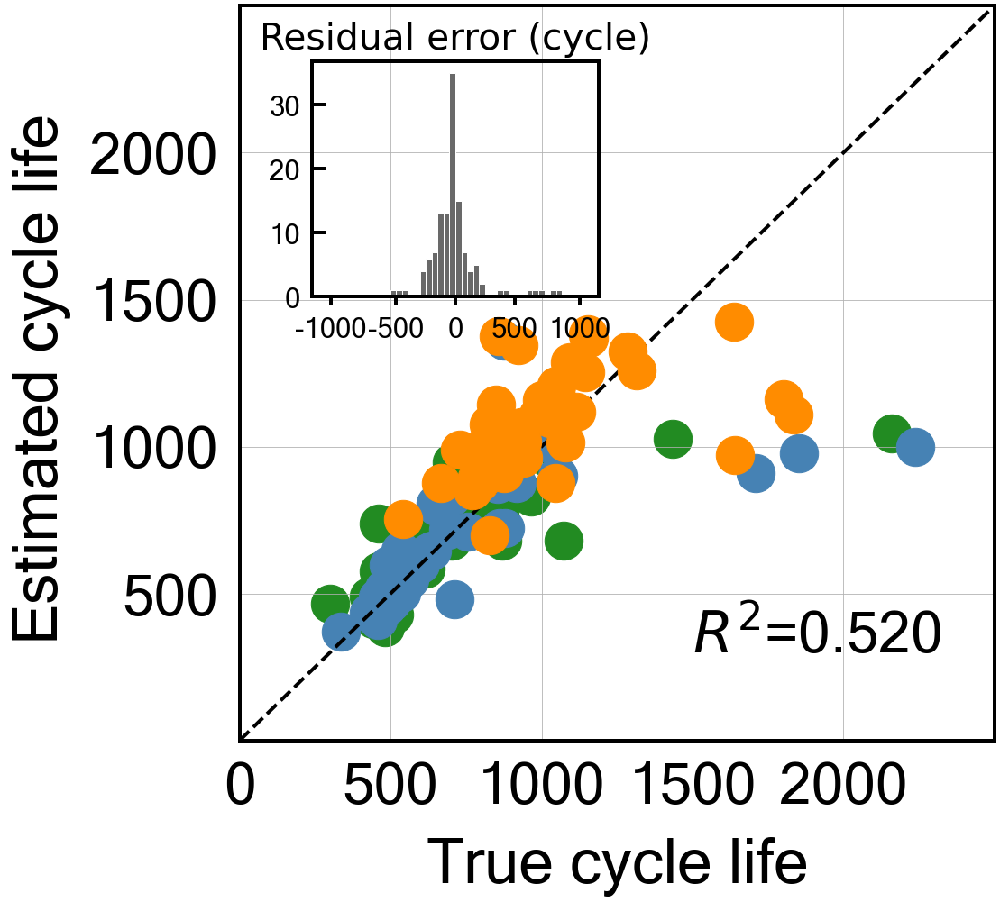


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: 0.18061066748116783
Cycle no: Average_2to86
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to86') : 0.04554592999252985
T_Q('Charge', 'Max-Min', 'Average_2to86') : -0.07180095972915218
T_Q('Discharge', 'Variance', 'Average_2to86') : 0.055383041651312505
dTdQ('Charge', 'Mean', 'Average_2to86') : -0.03634293058225761
dTdQ('Charge', 'Skewness', 'Average_2to86') : 0.012474711429381795
dTdQ('Charge', 'Maximum', 'Average_2to86') : -0.0590407128016813

Intercept: 2.7939698976436373
r2-score: 0.706
MAE_all: 144.6
MAE_train: 110.5
MAE_test: 131.2
MAE_2ndTest: 193.5
MAPE_all: 15.1 %
MAPE_train: 14.0 %
MAPE_test: 12.5 %
MAPE_2ndTest: 18.8 %
RMSE_all: 254.7
RMSE_train: 215.5
RMSE_test: 285.1
RMSE_2ndTest: 258.1
RMSPE_all: 20.9 %
RMSPE_train: 20.3 %
RMSPE_test: 19.2 %
RMSPE_2ndTest: 23.2 %
Log-scale scores
All data r2-score: 0.706


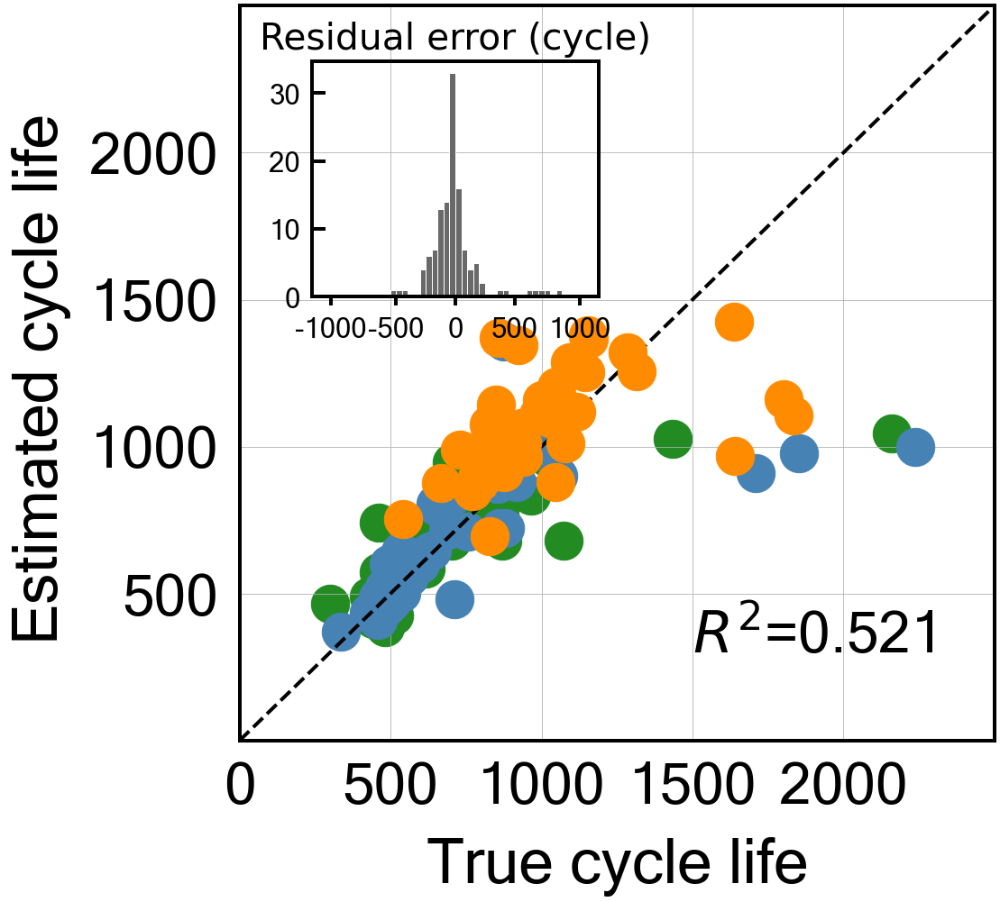


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 6.5
Best score obtained was: 0.1859274132675478
Cycle no: Average_2to87
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to87') : 0.045292117882843895
T_Q('Charge', 'Max-Min', 'Average_2to87') : -0.07234711850039592
T_Q('Discharge', 'Variance', 'Average_2to87') : 0.05567214633996772
dTdQ('Charge', 'Mean', 'Average_2to87') : -0.03611424120158793
dTdQ('Charge', 'Skewness', 'Average_2to87') : 0.012025771731696746
dTdQ('Charge', 'Maximum', 'Average_2to87') : -0.058667992704123775

Intercept: 2.7939698976436382
r2-score: 0.707
MAE_all: 144.1
MAE_train: 110.8
MAE_test: 130.8
MAE_2ndTest: 192.0
MAPE_all: 15.0 %
MAPE_train: 14.1 %
MAPE_test: 12.4 %
MAPE_2ndTest: 18.7 %
RMSE_all: 254.6
RMSE_train: 215.6
RMSE_test: 285.3
RMSE_2ndTest: 257.2
RMSPE_all: 20.9 %
RMSPE_train: 20.3 %
RMSPE_test: 19.2 %
RMSPE_2ndTest: 23.0 %
Log-scale scores
All data r2-score: 0.707

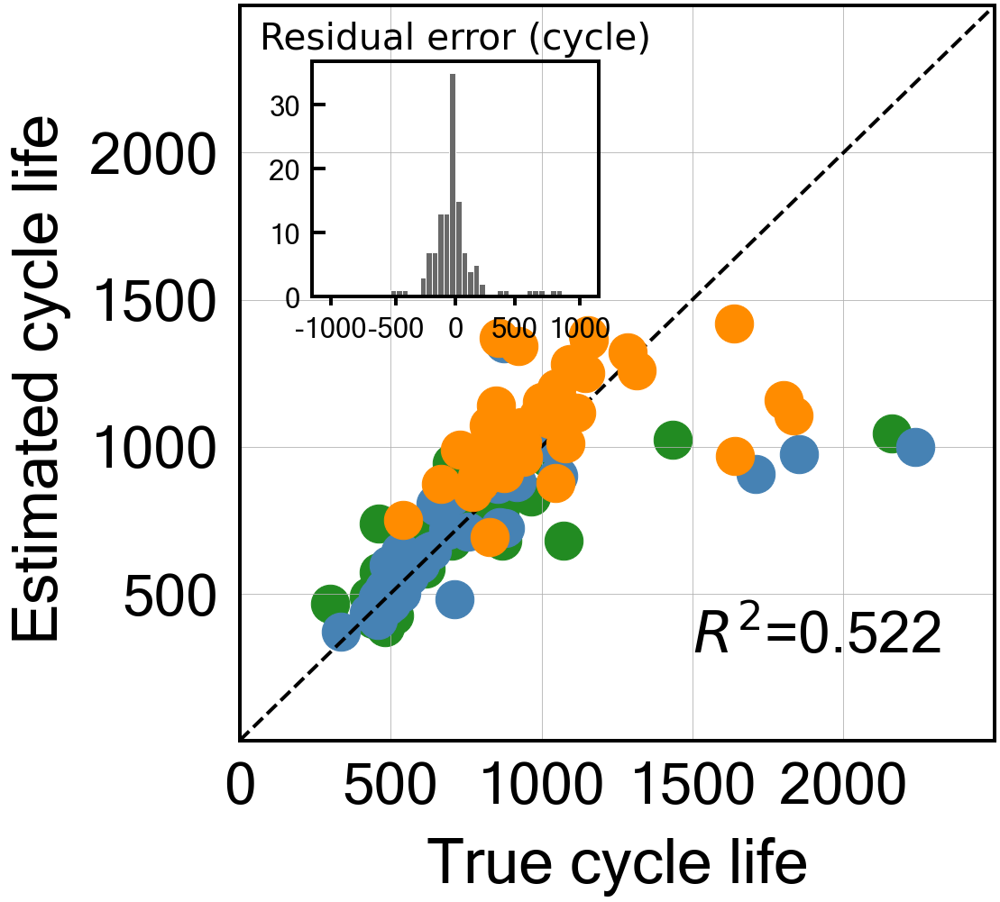


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.3
Best score obtained was: 0.18503434595906276
Cycle no: Average_2to88
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to88') : 0.045386152192302055
T_Q('Charge', 'Max-Min', 'Average_2to88') : -0.07298660564377735
T_Q('Discharge', 'Variance', 'Average_2to88') : 0.05593698194843436
dTdQ('Charge', 'Mean', 'Average_2to88') : -0.03574755934322582
dTdQ('Charge', 'Skewness', 'Average_2to88') : 0.011620478284741949
dTdQ('Charge', 'Maximum', 'Average_2to88') : -0.05849571784831155

Intercept: 2.793969897643638
r2-score: 0.706
MAE_all: 144.2
MAE_train: 110.9
MAE_test: 130.9
MAE_2ndTest: 192.2
MAPE_all: 15.0 %
MAPE_train: 14.1 %
MAPE_test: 12.4 %
MAPE_2ndTest: 18.7 %
RMSE_all: 254.9
RMSE_train: 215.7
RMSE_test: 286.1
RMSE_2ndTest: 257.4
RMSPE_all: 20.9 %
RMSPE_train: 20.3 %
RMSPE_test: 19.2 %
RMSPE_2ndTest: 23.0 %
Log-scale scores
All data r2-score: 0.706


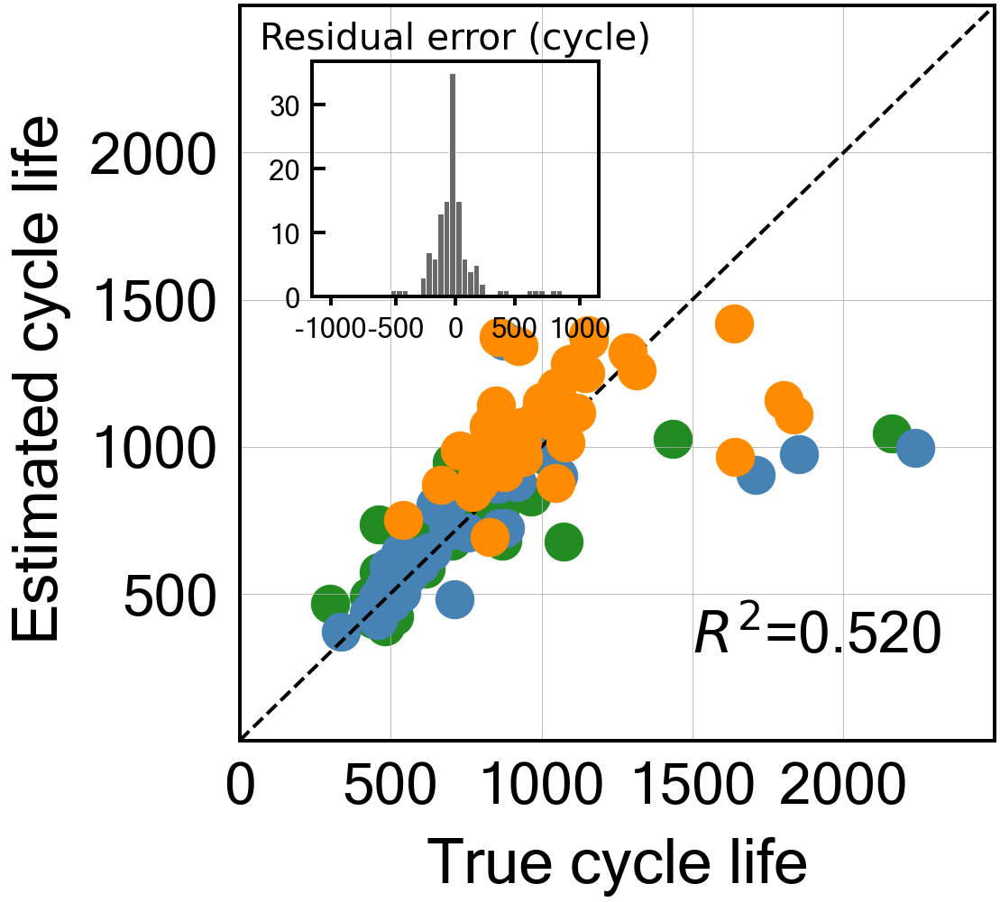


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: 0.18370928156897737
Cycle no: Average_2to89
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to89') : 0.045714114381603686
T_Q('Charge', 'Max-Min', 'Average_2to89') : -0.07404801758511377
T_Q('Discharge', 'Variance', 'Average_2to89') : 0.05608837621804291
dTdQ('Charge', 'Mean', 'Average_2to89') : -0.03459322573917018
dTdQ('Charge', 'Skewness', 'Average_2to89') : 0.011080542582137228
dTdQ('Charge', 'Maximum', 'Average_2to89') : -0.05830088043765971

Intercept: 2.793969897643637
r2-score: 0.705
MAE_all: 144.4
MAE_train: 111.3
MAE_test: 130.8
MAE_2ndTest: 192.6
MAPE_all: 15.0 %
MAPE_train: 14.2 %
MAPE_test: 12.4 %
MAPE_2ndTest: 18.7 %
RMSE_all: 255.3
RMSE_train: 216.6
RMSE_test: 286.1
RMSE_2ndTest: 257.6
RMSPE_all: 20.9 %
RMSPE_train: 20.4 %
RMSPE_test: 19.1 %
RMSPE_2ndTest: 23.0 %
Log-scale scores
All data r2-score: 0.705


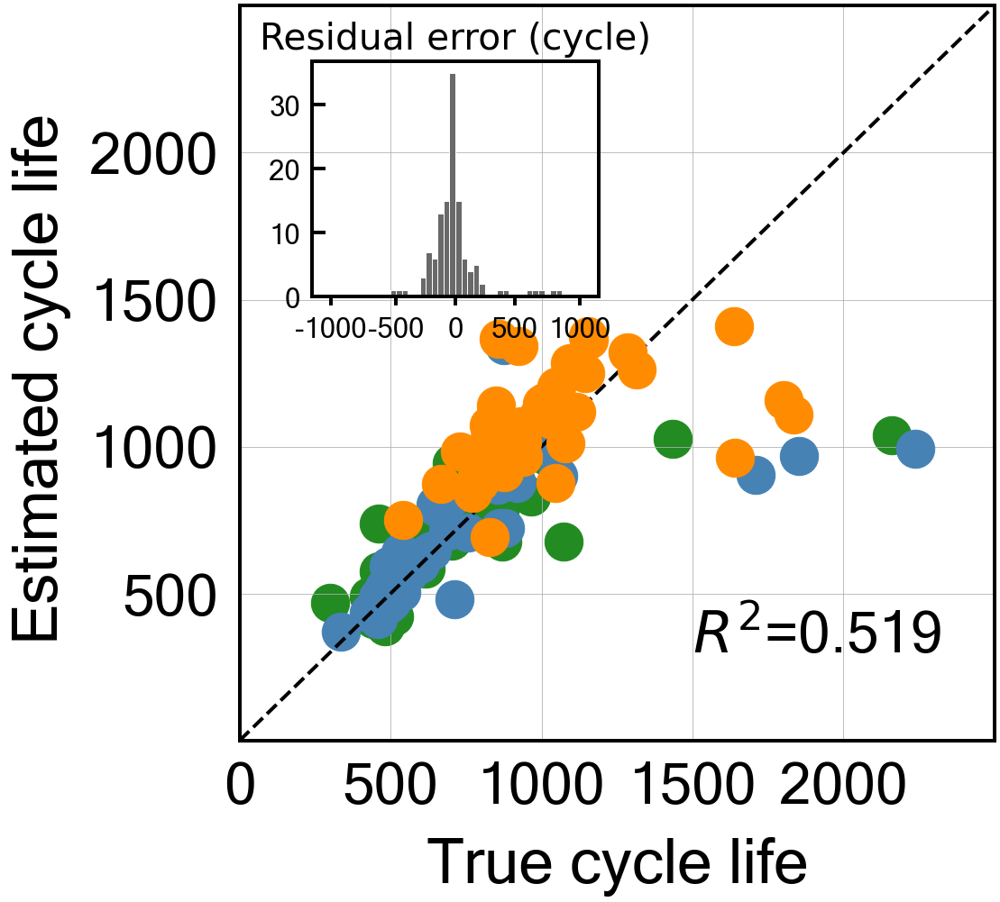


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.5
Best score obtained was: 0.18325026968308522
Cycle no: Average_2to90
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to90') : 0.04561659246115621
T_Q('Charge', 'Max-Min', 'Average_2to90') : -0.07389263494615299
T_Q('Discharge', 'Variance', 'Average_2to90') : 0.05604087768235587
dTdQ('Charge', 'Mean', 'Average_2to90') : -0.03478622063337833
dTdQ('Charge', 'Skewness', 'Average_2to90') : 0.010899083987061253
dTdQ('Charge', 'Maximum', 'Average_2to90') : -0.058179230035420096

Intercept: 2.7939698976436365
r2-score: 0.705
MAE_all: 144.5
MAE_train: 111.4
MAE_test: 130.9
MAE_2ndTest: 192.6
MAPE_all: 15.0 %
MAPE_train: 14.2 %
MAPE_test: 12.4 %
MAPE_2ndTest: 18.7 %
RMSE_all: 255.5
RMSE_train: 217.0
RMSE_test: 286.3
RMSE_2ndTest: 257.7
RMSPE_all: 20.9 %
RMSPE_train: 20.4 %
RMSPE_test: 19.1 %
RMSPE_2ndTest: 23.1 %
Log-scale scores
All data r2-score: 0.705

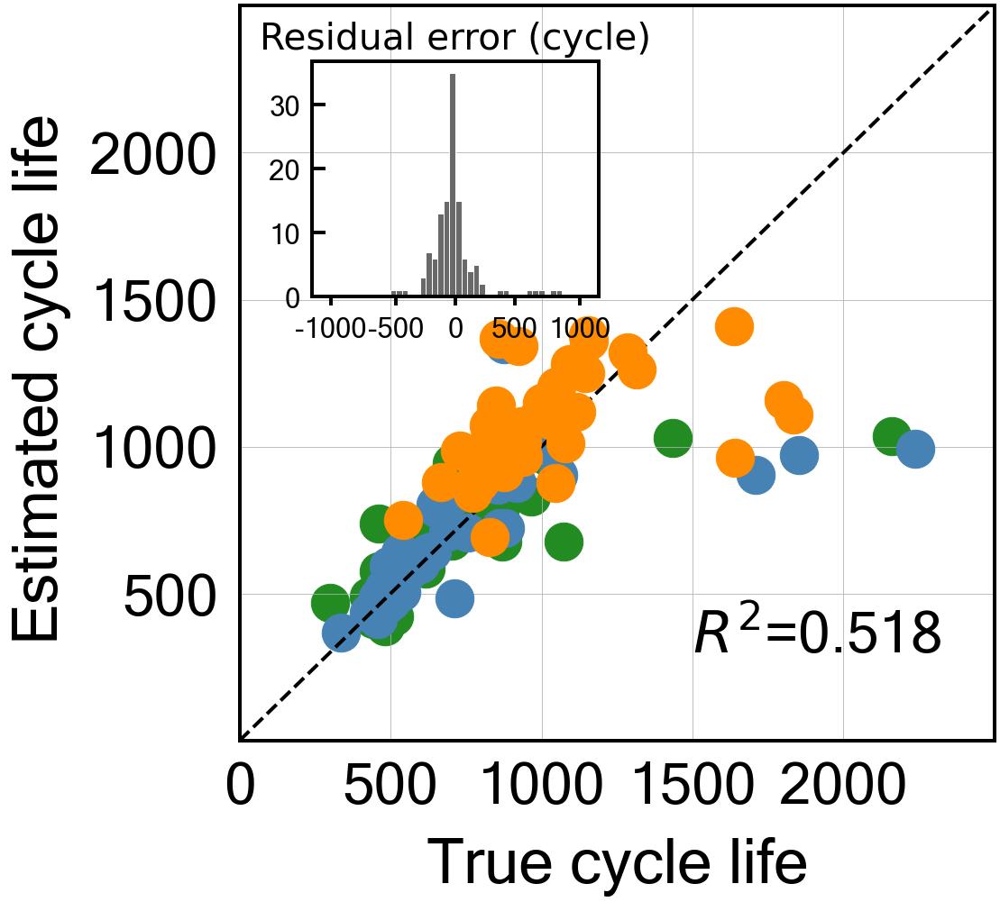


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.9
Best score obtained was: 0.18558151323881522
Cycle no: Average_2to91
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to91') : 0.0457303778619483
T_Q('Charge', 'Max-Min', 'Average_2to91') : -0.07381153194914734
T_Q('Discharge', 'Variance', 'Average_2to91') : 0.056124130072019725
dTdQ('Charge', 'Mean', 'Average_2to91') : -0.03473574551063523
dTdQ('Charge', 'Skewness', 'Average_2to91') : 0.010664085598148134
dTdQ('Charge', 'Maximum', 'Average_2to91') : -0.058273412329219475

Intercept: 2.793969897643637
r2-score: 0.705
MAE_all: 144.5
MAE_train: 111.5
MAE_test: 130.9
MAE_2ndTest: 192.5
MAPE_all: 15.0 %
MAPE_train: 14.2 %
MAPE_test: 12.4 %
MAPE_2ndTest: 18.7 %
RMSE_all: 255.4
RMSE_train: 216.9
RMSE_test: 286.3
RMSE_2ndTest: 257.3
RMSPE_all: 20.9 %
RMSPE_train: 20.4 %
RMSPE_test: 19.1 %
RMSPE_2ndTest: 23.0 %
Log-scale scores
All data r2-score: 0.705


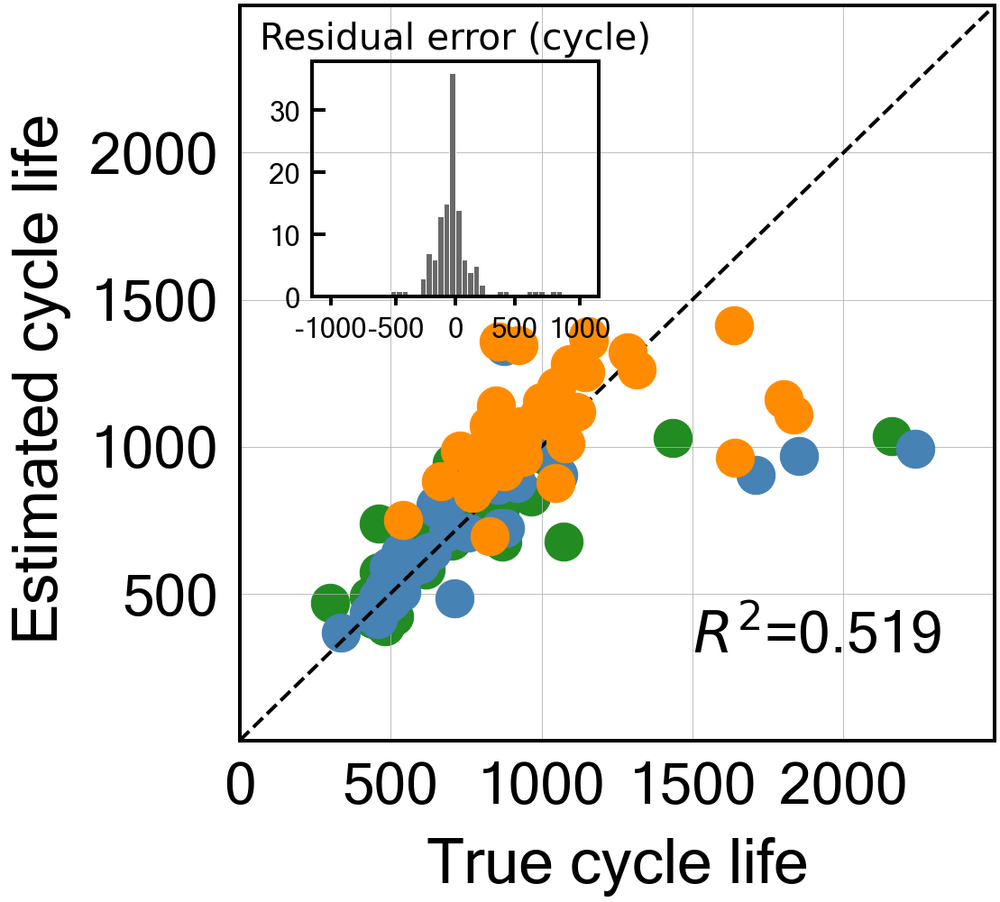


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: 0.18762379012233554
Cycle no: Average_2to92
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to92') : 0.0456476736148898
T_Q('Charge', 'Max-Min', 'Average_2to92') : -0.07366432189785102
T_Q('Discharge', 'Variance', 'Average_2to92') : 0.05619258586024829
dTdQ('Charge', 'Mean', 'Average_2to92') : -0.03485002802840809
dTdQ('Charge', 'Skewness', 'Average_2to92') : 0.010841895731221981
dTdQ('Charge', 'Maximum', 'Average_2to92') : -0.05838194492291621

Intercept: 2.7939698976436373
r2-score: 0.705
MAE_all: 144.4
MAE_train: 111.4
MAE_test: 131.0
MAE_2ndTest: 192.1
MAPE_all: 15.0 %
MAPE_train: 14.1 %
MAPE_test: 12.4 %
MAPE_2ndTest: 18.7 %
RMSE_all: 255.3
RMSE_train: 217.1
RMSE_test: 286.2
RMSE_2ndTest: 257.0
RMSPE_all: 20.8 %
RMSPE_train: 20.4 %
RMSPE_test: 19.0 %
RMSPE_2ndTest: 23.0 %
Log-scale scores
All data r2-score: 0.705
T

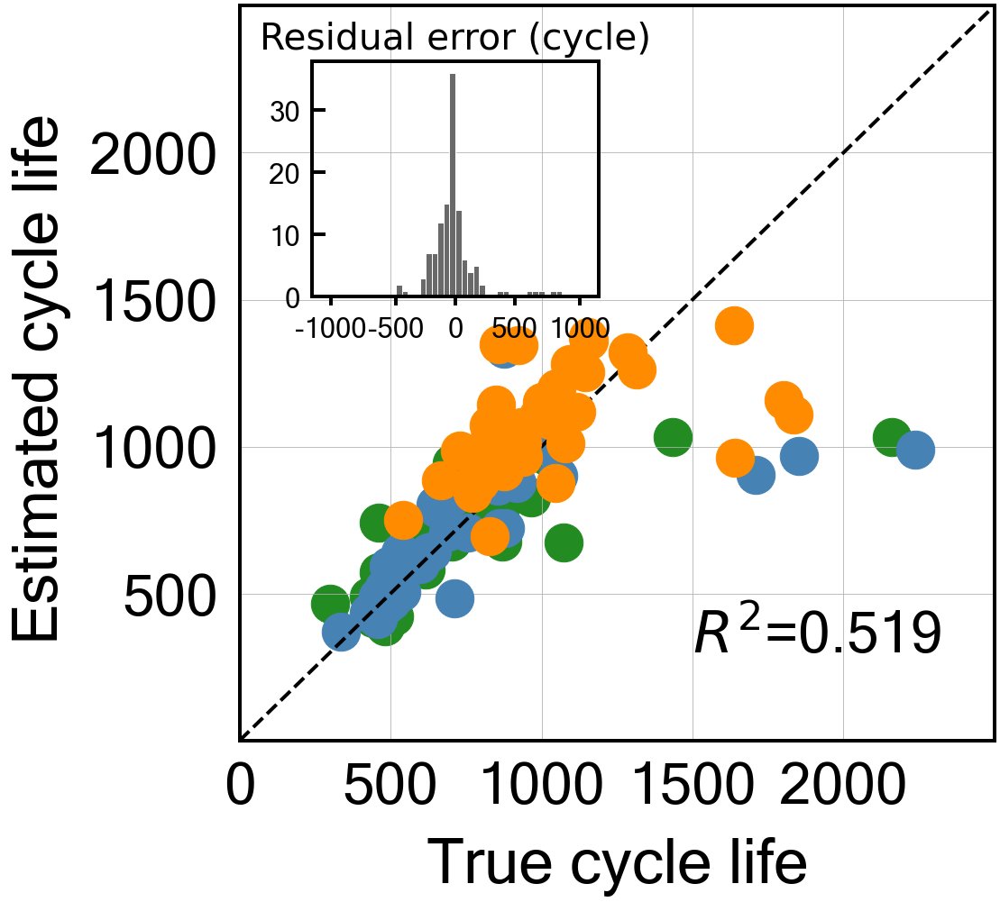


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.4
Best score obtained was: 0.18762512298535217
Cycle no: Average_2to93
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to93') : 0.04533807838364951
T_Q('Charge', 'Max-Min', 'Average_2to93') : -0.07406895069054516
T_Q('Discharge', 'Variance', 'Average_2to93') : 0.056865816337560986
dTdQ('Charge', 'Mean', 'Average_2to93') : -0.03468299525488579
dTdQ('Charge', 'Skewness', 'Average_2to93') : 0.011027768152262585
dTdQ('Charge', 'Maximum', 'Average_2to93') : -0.0588100867431371

Intercept: 2.793969897643637
r2-score: 0.707
MAE_all: 144.4
MAE_train: 111.3
MAE_test: 130.6
MAE_2ndTest: 192.8
MAPE_all: 15.0 %
MAPE_train: 14.1 %
MAPE_test: 12.4 %
MAPE_2ndTest: 18.8 %
RMSE_all: 254.6
RMSE_train: 216.5
RMSE_test: 285.0
RMSE_2ndTest: 257.0
RMSPE_all: 20.8 %
RMSPE_train: 20.2 %
RMSPE_test: 19.0 %
RMSPE_2ndTest: 23.0 %
Log-scale scores
All data r2-score: 0.707
T

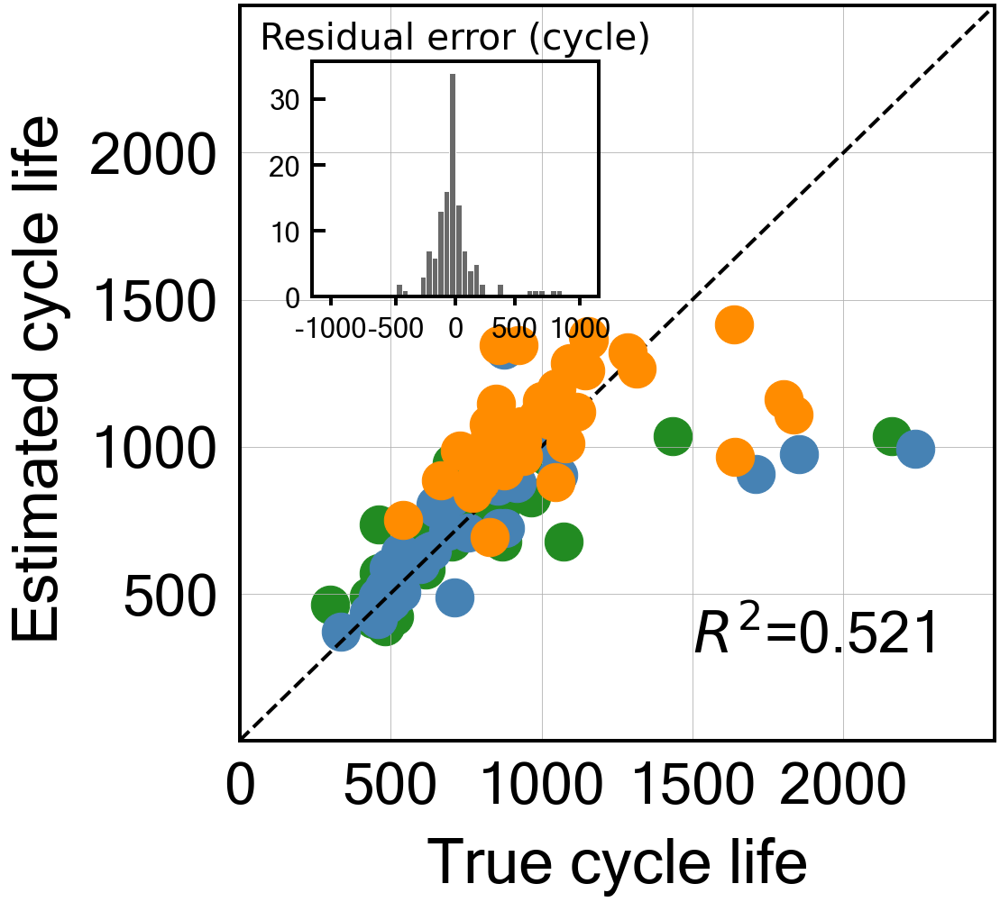


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.2
Best score obtained was: 0.12509177109391434
Cycle no: Average_2to94
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to94') : 0.04525464728725708
T_Q('Charge', 'Max-Min', 'Average_2to94') : -0.08326282296487947
T_Q('Discharge', 'Variance', 'Average_2to94') : 0.06776527223416426
dTdQ('Charge', 'Mean', 'Average_2to94') : -0.03186619219706343
dTdQ('Charge', 'Skewness', 'Average_2to94') : 0.012818151890194324
dTdQ('Charge', 'Maximum', 'Average_2to94') : -0.06562570343141755

Intercept: 2.793969897643637
r2-score: 0.713
MAE_all: 149.2
MAE_train: 109.8
MAE_test: 126.5
MAE_2ndTest: 213.4
MAPE_all: 15.7 %
MAPE_train: 14.0 %
MAPE_test: 12.1 %
MAPE_2ndTest: 21.2 %
RMSE_all: 250.8
RMSE_train: 209.2
RMSE_test: 271.7
RMSE_2ndTest: 266.7
RMSPE_all: 21.1 %
RMSPE_train: 19.7 %
RMSPE_test: 18.1 %
RMSPE_2ndTest: 25.0 %
Log-scale scores
All data r2-score: 0.713
T

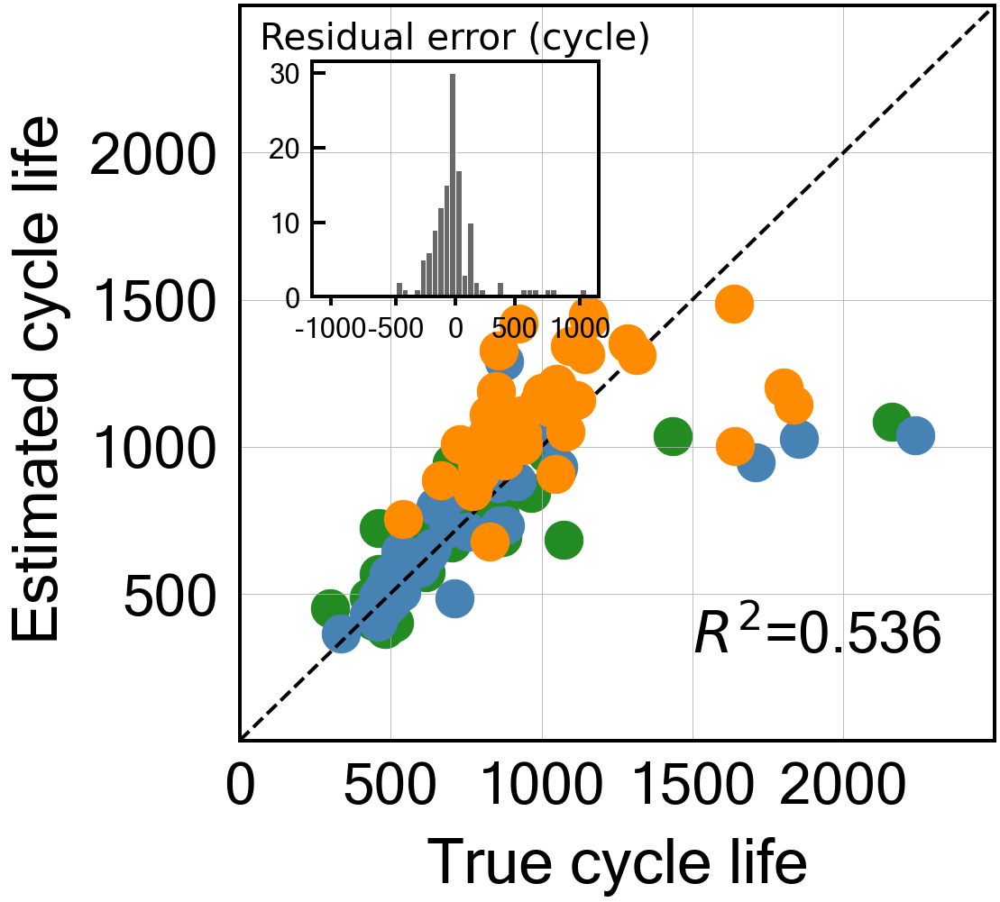


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.13668738635551614
Cycle no: Average_2to95
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to95') : 0.044592631511919896
T_Q('Charge', 'Max-Min', 'Average_2to95') : -0.08365553073236623
T_Q('Discharge', 'Variance', 'Average_2to95') : 0.06887986752579385
dTdQ('Charge', 'Mean', 'Average_2to95') : -0.03225303114422069
dTdQ('Charge', 'Skewness', 'Average_2to95') : 0.01231446120439202
dTdQ('Charge', 'Maximum', 'Average_2to95') : -0.06545143380509537

Intercept: 2.793969897643636
r2-score: 0.715
MAE_all: 148.5
MAE_train: 109.8
MAE_test: 126.4
MAE_2ndTest: 211.3
MAPE_all: 15.6 %
MAPE_train: 14.0 %
MAPE_test: 12.1 %
MAPE_2ndTest: 20.9 %
RMSE_all: 250.1
RMSE_train: 209.1
RMSE_test: 271.4
RMSE_2ndTest: 264.9
RMSPE_all: 20.9 %
RMSPE_train: 19.7 %
RMSPE_test: 18.1 %
RMSPE_2ndTest: 24.7 %
Log-scale scores
All data r2-score: 0.715
T

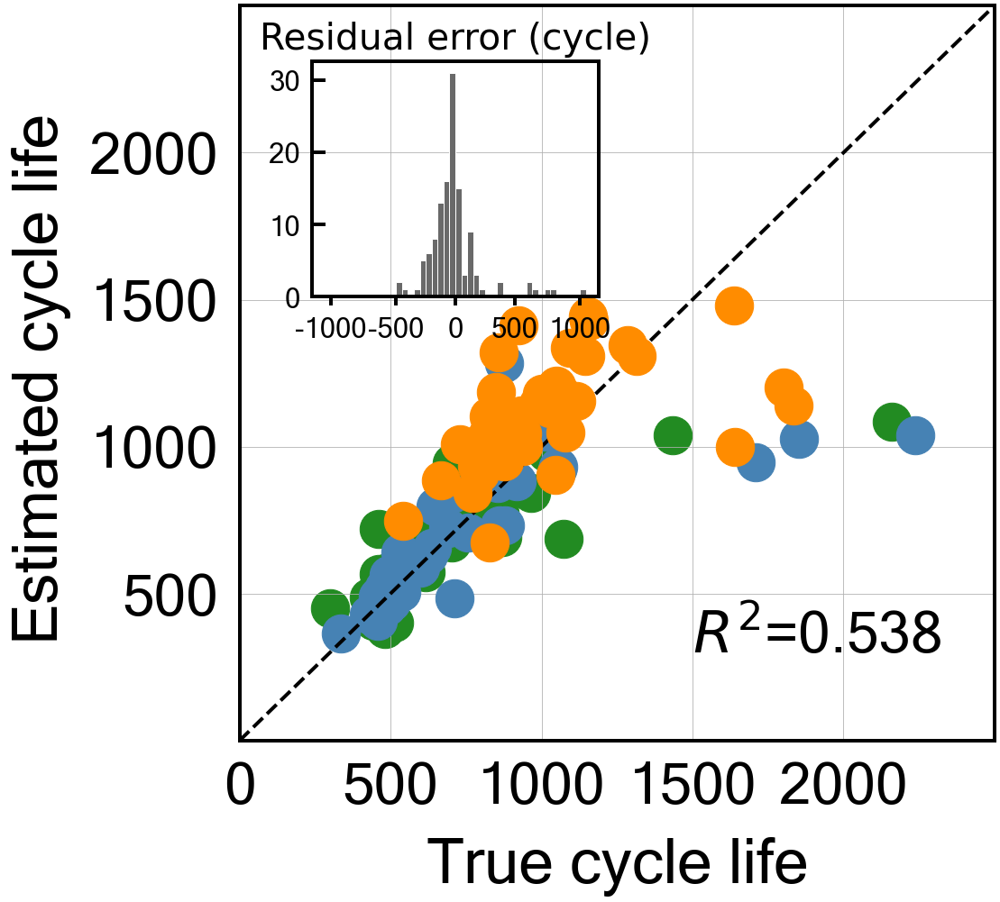


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 4.9
Best score obtained was: 0.19772156207398273
Cycle no: Average_2to96
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to96') : 0.04441296477971102
T_Q('Charge', 'Max-Min', 'Average_2to96') : -0.07464763507801771
T_Q('Discharge', 'Variance', 'Average_2to96') : 0.05875087675255263
dTdQ('Charge', 'Mean', 'Average_2to96') : -0.03506417960610301
dTdQ('Charge', 'Skewness', 'Average_2to96') : 0.010150335367885843
dTdQ('Charge', 'Maximum', 'Average_2to96') : -0.0588522117953172

Intercept: 2.7939698976436365
r2-score: 0.709
MAE_all: 143.3
MAE_train: 111.5
MAE_test: 130.2
MAE_2ndTest: 189.8
MAPE_all: 14.9 %
MAPE_train: 14.2 %
MAPE_test: 12.4 %
MAPE_2ndTest: 18.4 %
RMSE_all: 254.0
RMSE_train: 216.7
RMSE_test: 284.6
RMSE_2ndTest: 255.4
RMSPE_all: 20.5 %
RMSPE_train: 20.2 %
RMSPE_test: 18.8 %
RMSPE_2ndTest: 22.6 %
Log-scale scores
All data r2-score: 0.709
T

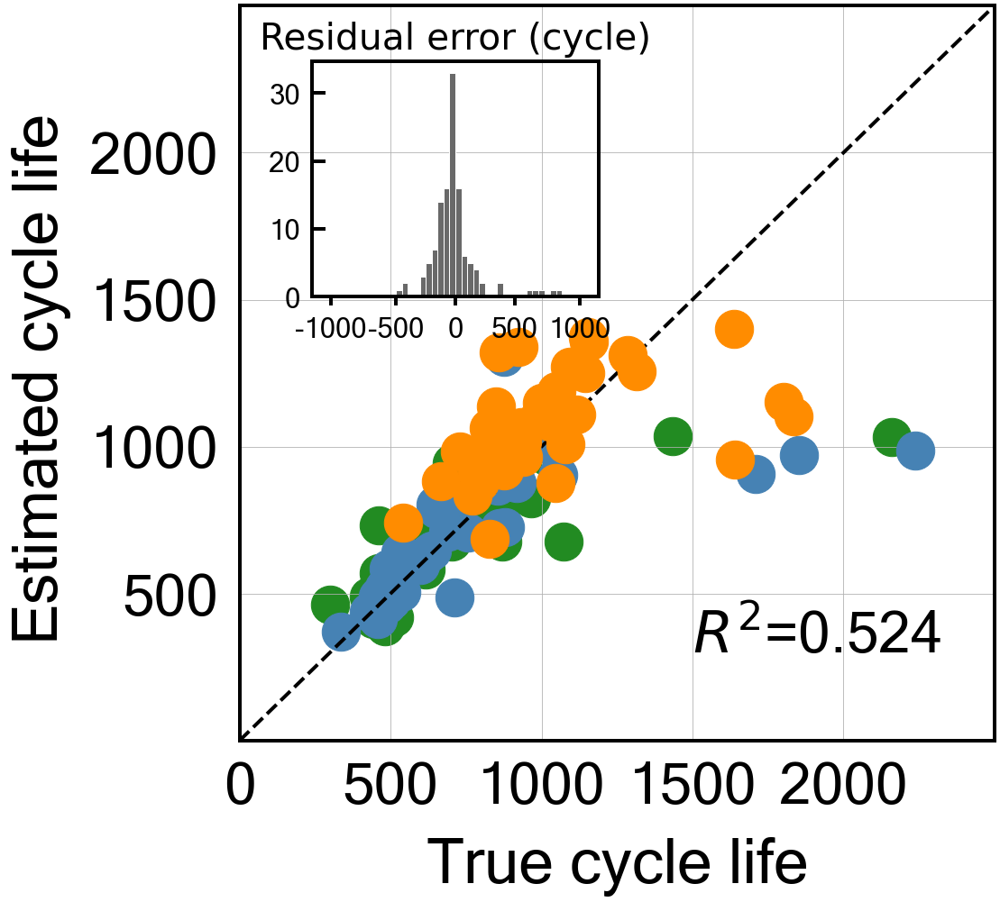


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.14469943157485132
Cycle no: Average_2to97
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to97') : 0.04379870419504606
T_Q('Charge', 'Max-Min', 'Average_2to97') : -0.08359419564480919
T_Q('Discharge', 'Variance', 'Average_2to97') : 0.07052875303197127
dTdQ('Charge', 'Mean', 'Average_2to97') : -0.03320704844748274
dTdQ('Charge', 'Skewness', 'Average_2to97') : 0.01228550474796788
dTdQ('Charge', 'Maximum', 'Average_2to97') : -0.06576767619336828

Intercept: 2.7939698976436365
r2-score: 0.717
MAE_all: 147.7
MAE_train: 109.7
MAE_test: 126.3
MAE_2ndTest: 209.3
MAPE_all: 15.5 %
MAPE_train: 14.0 %
MAPE_test: 12.1 %
MAPE_2ndTest: 20.7 %
RMSE_all: 249.4
RMSE_train: 208.7
RMSE_test: 270.9
RMSE_2ndTest: 263.7
RMSPE_all: 20.8 %
RMSPE_train: 19.6 %
RMSPE_test: 18.0 %
RMSPE_2ndTest: 24.4 %
Log-scale scores
All data r2-score: 0.717
T

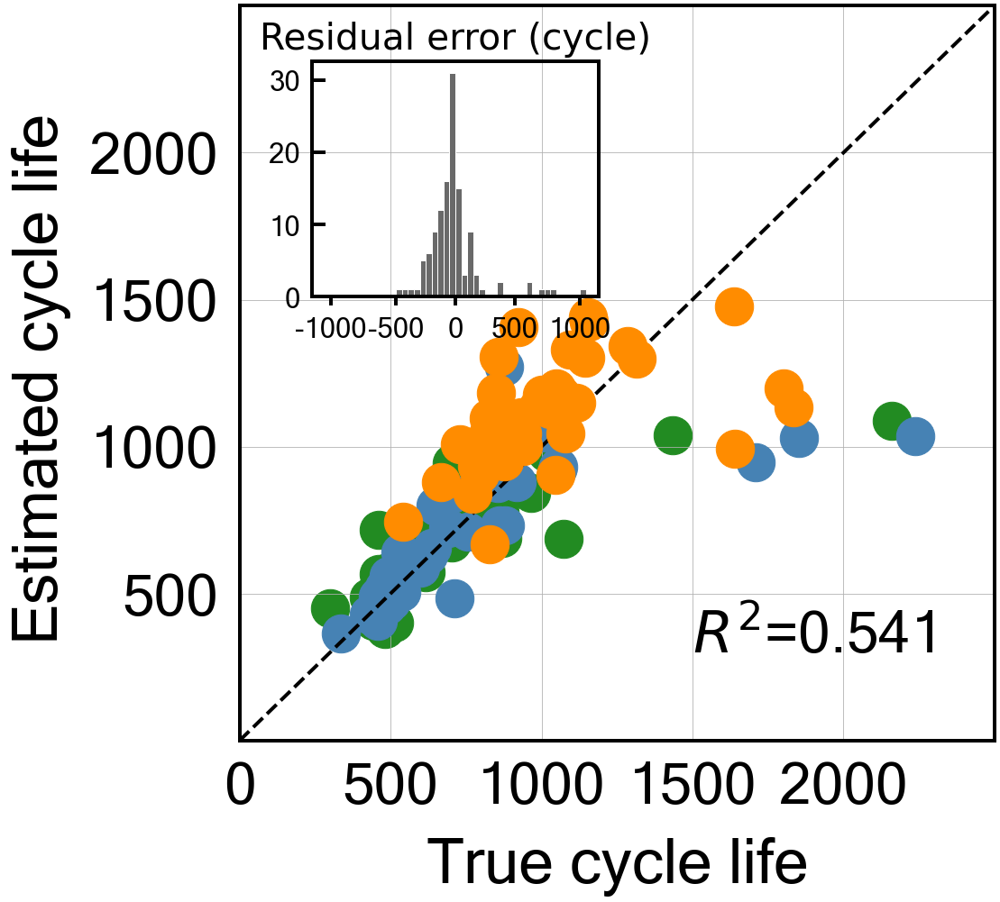


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.9
Best score obtained was: 0.14817231545602205
Cycle no: Average_2to98
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to98') : 0.04335032423735041
T_Q('Charge', 'Max-Min', 'Average_2to98') : -0.08438816665902389
T_Q('Discharge', 'Variance', 'Average_2to98') : 0.0713615592355781
dTdQ('Charge', 'Mean', 'Average_2to98') : -0.03313050907032107
dTdQ('Charge', 'Skewness', 'Average_2to98') : 0.011600058312652171
dTdQ('Charge', 'Maximum', 'Average_2to98') : -0.06547910438752533

Intercept: 2.793969897643636
r2-score: 0.718
MAE_all: 147.3
MAE_train: 109.9
MAE_test: 126.3
MAE_2ndTest: 207.8
MAPE_all: 15.5 %
MAPE_train: 14.0 %
MAPE_test: 12.1 %
MAPE_2ndTest: 20.5 %
RMSE_all: 249.4
RMSE_train: 208.9
RMSE_test: 271.4
RMSE_2ndTest: 263.1
RMSPE_all: 20.7 %
RMSPE_train: 19.6 %
RMSPE_test: 18.0 %
RMSPE_2ndTest: 24.2 %
Log-scale scores
All data r2-score: 0.718
Tr

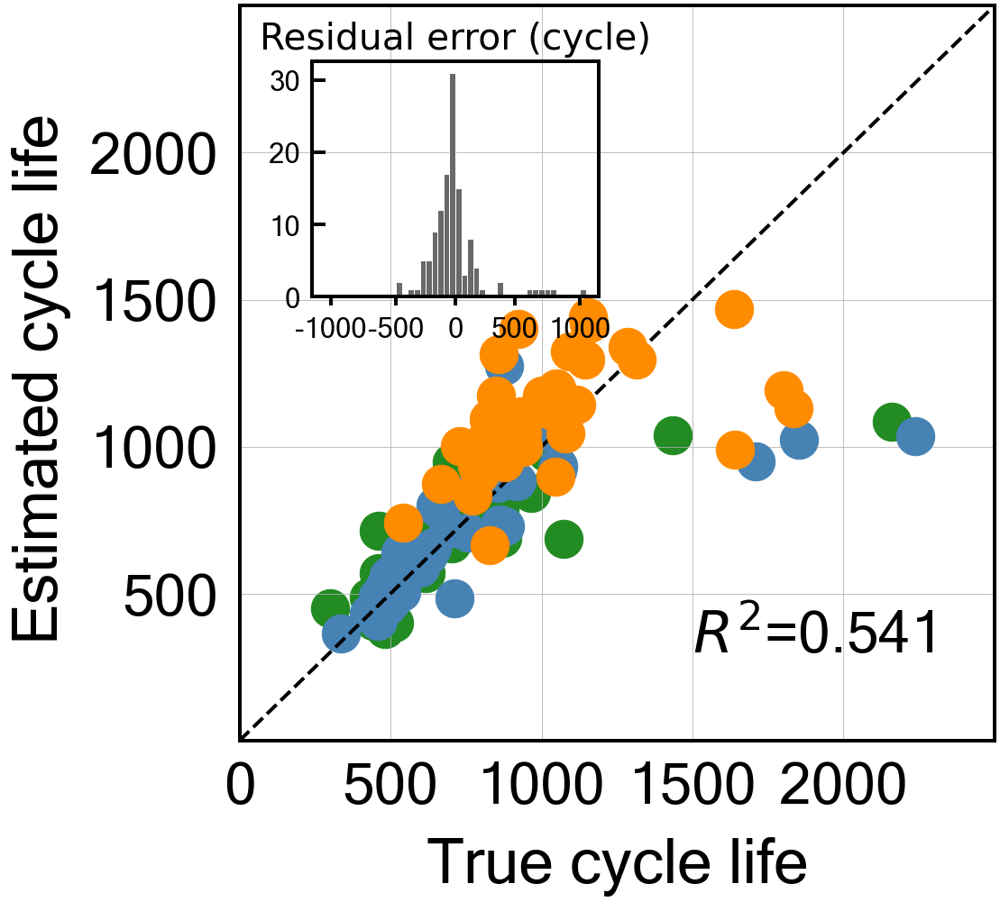


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 7.3
Best score obtained was: 0.15232537613674735
Cycle no: Average_2to99
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to99') : 0.04300123971562741
T_Q('Charge', 'Max-Min', 'Average_2to99') : -0.0843568870224663
T_Q('Discharge', 'Variance', 'Average_2to99') : 0.07168083531380512
dTdQ('Charge', 'Mean', 'Average_2to99') : -0.033464177609955736
dTdQ('Charge', 'Skewness', 'Average_2to99') : 0.01138680625579559
dTdQ('Charge', 'Maximum', 'Average_2to99') : -0.06512579560308178

Intercept: 2.7939698976436373
r2-score: 0.718
MAE_all: 146.8
MAE_train: 110.1
MAE_test: 126.3
MAE_2ndTest: 205.9
MAPE_all: 15.4 %
MAPE_train: 14.1 %
MAPE_test: 12.1 %
MAPE_2ndTest: 20.2 %
RMSE_all: 249.4
RMSE_train: 209.2
RMSE_test: 271.6
RMSE_2ndTest: 262.5
RMSPE_all: 20.7 %
RMSPE_train: 19.7 %
RMSPE_test: 18.0 %
RMSPE_2ndTest: 24.0 %
Log-scale scores
All data r2-score: 0.718
T

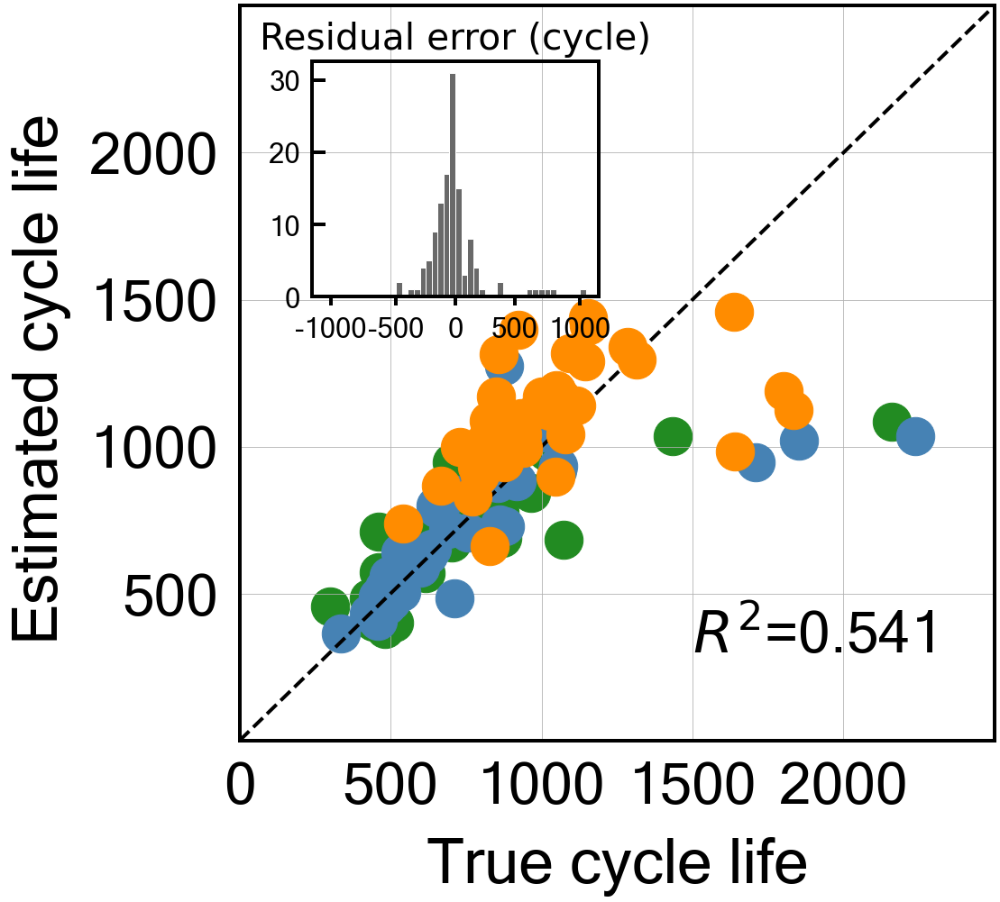


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.3
Best score obtained was: 0.15812168066604182
Cycle no: Average_2to100
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to100') : 0.04288253060099971
T_Q('Charge', 'Max-Min', 'Average_2to100') : -0.08465601834385716
T_Q('Discharge', 'Variance', 'Average_2to100') : 0.07195422738552382
dTdQ('Charge', 'Mean', 'Average_2to100') : -0.03350566539201394
dTdQ('Charge', 'Skewness', 'Average_2to100') : 0.010919425805530552
dTdQ('Charge', 'Maximum', 'Average_2to100') : -0.06476797955715612

Intercept: 2.793969897643636
r2-score: 0.718
MAE_all: 146.3
MAE_train: 110.3
MAE_test: 126.2
MAE_2ndTest: 204.2
MAPE_all: 15.3 %
MAPE_train: 14.1 %
MAPE_test: 12.1 %
MAPE_2ndTest: 20.0 %
RMSE_all: 249.3
RMSE_train: 209.6
RMSE_test: 272.1
RMSE_2ndTest: 261.6
RMSPE_all: 20.6 %
RMSPE_train: 19.7 %
RMSPE_test: 18.0 %
RMSPE_2ndTest: 23.8 %
Log-scale scores
All data r2-score: 

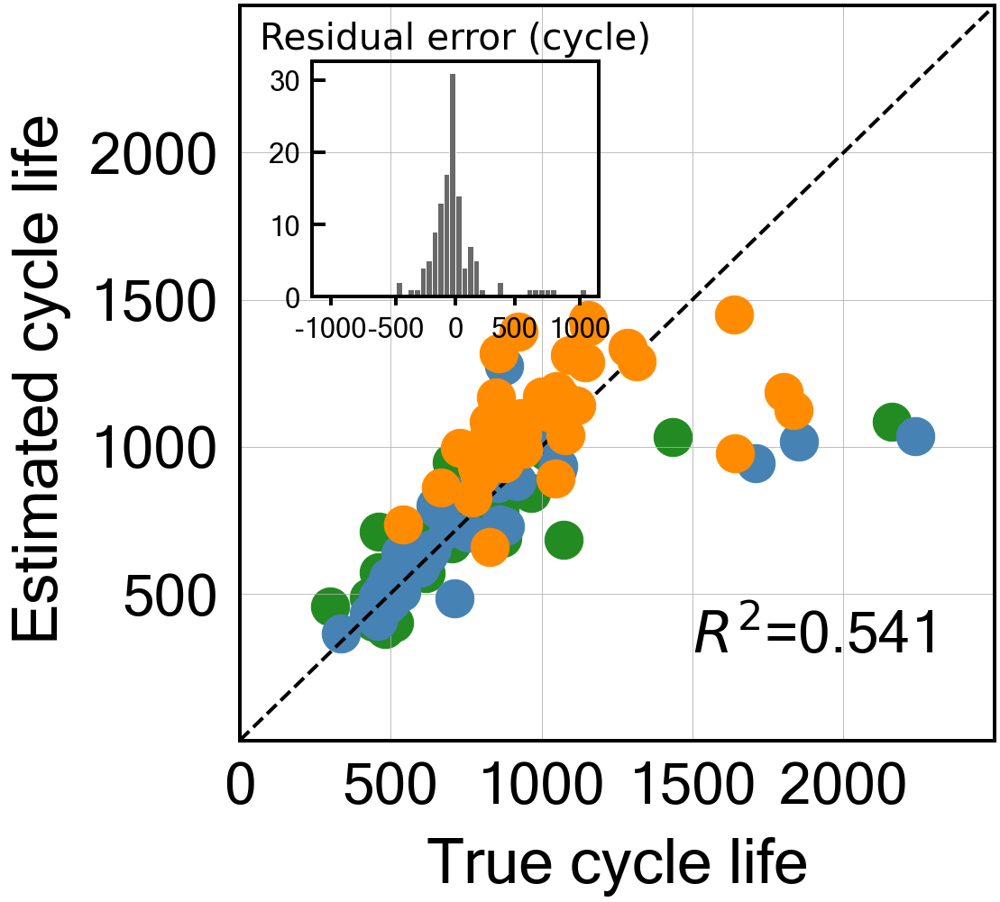


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.1540118191180887
Cycle no: Average_2to101
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to101') : 0.042937756989940776
T_Q('Charge', 'Max-Min', 'Average_2to101') : -0.08394941147754627
T_Q('Discharge', 'Variance', 'Average_2to101') : 0.07147981090676592
dTdQ('Charge', 'Mean', 'Average_2to101') : -0.03389222831578038
dTdQ('Charge', 'Skewness', 'Average_2to101') : 0.011107775966452954
dTdQ('Charge', 'Maximum', 'Average_2to101') : -0.06493915336124877

Intercept: 2.793969897643637
r2-score: 0.717
MAE_all: 146.5
MAE_train: 110.3
MAE_test: 126.2
MAE_2ndTest: 204.8
MAPE_all: 15.4 %
MAPE_train: 14.1 %
MAPE_test: 12.1 %
MAPE_2ndTest: 20.1 %
RMSE_all: 249.6
RMSE_train: 209.8
RMSE_test: 271.9
RMSE_2ndTest: 262.2
RMSPE_all: 20.6 %
RMSPE_train: 19.8 %
RMSPE_test: 18.0 %
RMSPE_2ndTest: 23.8 %
Log-scale scores
All data r2-score: 

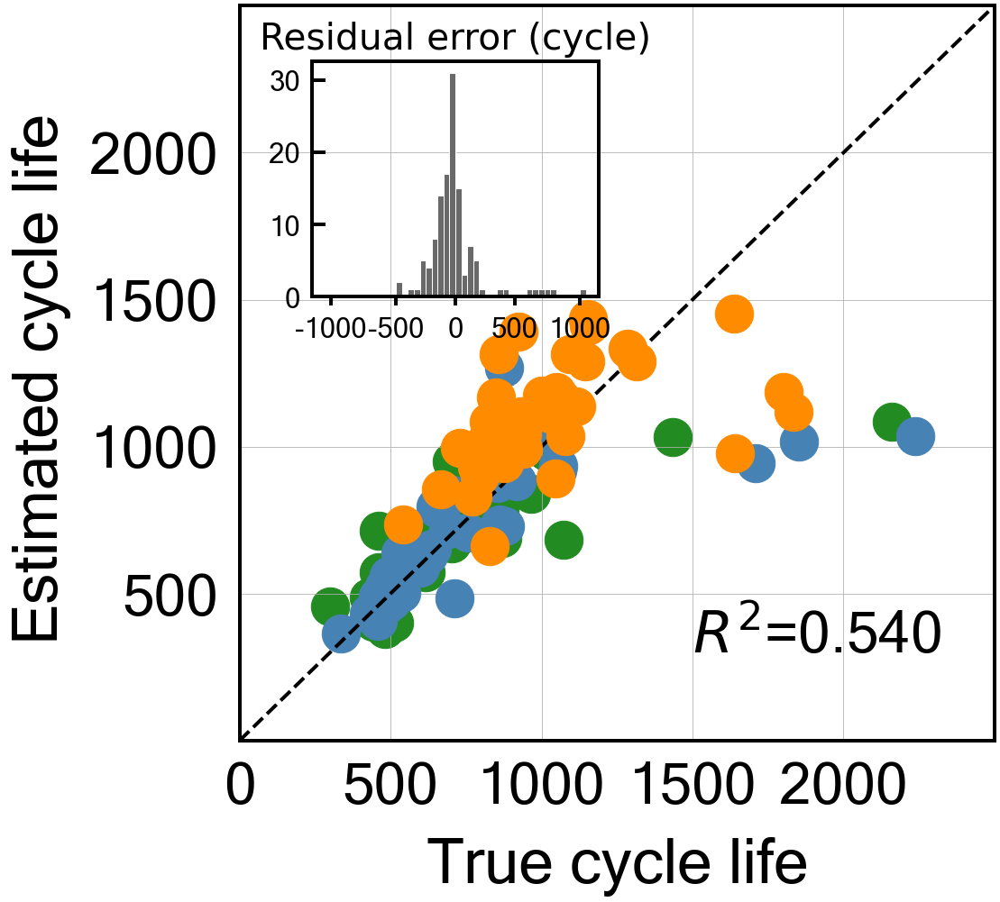


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.4
Best score obtained was: 0.15180548852277287
Cycle no: Average_2to102
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to102') : 0.04287139392434179
T_Q('Charge', 'Max-Min', 'Average_2to102') : -0.08439744545004368
T_Q('Discharge', 'Variance', 'Average_2to102') : 0.07181974216958503
dTdQ('Charge', 'Mean', 'Average_2to102') : -0.03374782004191823
dTdQ('Charge', 'Skewness', 'Average_2to102') : 0.010795722737931031
dTdQ('Charge', 'Maximum', 'Average_2to102') : -0.0650592306952223

Intercept: 2.793969897643637
r2-score: 0.718
MAE_all: 146.5
MAE_train: 110.2
MAE_test: 126.1
MAE_2ndTest: 205.1
MAPE_all: 15.4 %
MAPE_train: 14.1 %
MAPE_test: 12.1 %
MAPE_2ndTest: 20.1 %
RMSE_all: 249.3
RMSE_train: 209.3
RMSE_test: 271.4
RMSE_2ndTest: 262.6
RMSPE_all: 20.6 %
RMSPE_train: 19.7 %
RMSPE_test: 18.0 %
RMSPE_2ndTest: 23.8 %
Log-scale scores
All data r2-score: 0

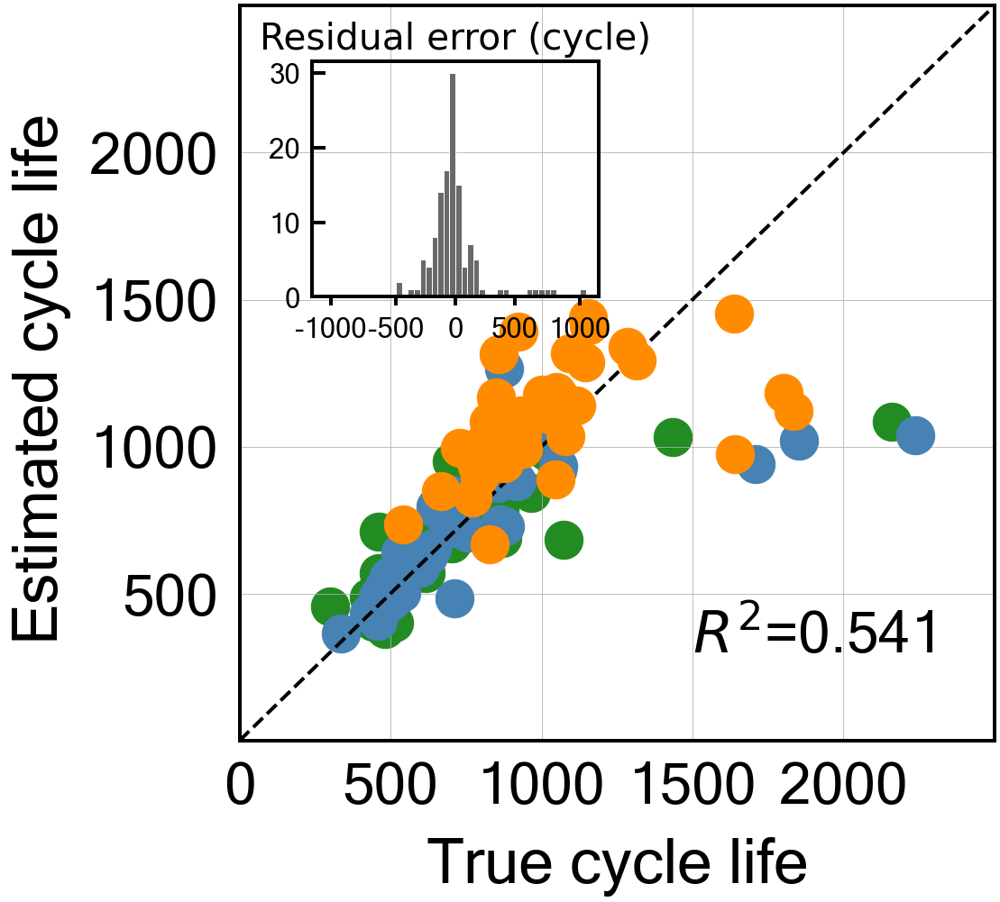


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.7
Best score obtained was: 0.15305429509003166
Cycle no: Average_2to103
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to103') : 0.04253527004130605
T_Q('Charge', 'Max-Min', 'Average_2to103') : -0.08474506615914716
T_Q('Discharge', 'Variance', 'Average_2to103') : 0.07263727052182252
dTdQ('Charge', 'Mean', 'Average_2to103') : -0.033770076148087205
dTdQ('Charge', 'Skewness', 'Average_2to103') : 0.011028273895398157
dTdQ('Charge', 'Maximum', 'Average_2to103') : -0.06540515646992921

Intercept: 2.7939698976436365
r2-score: 0.720
MAE_all: 146.1
MAE_train: 110.0
MAE_test: 125.8
MAE_2ndTest: 204.3
MAPE_all: 15.3 %
MAPE_train: 14.1 %
MAPE_test: 12.1 %
MAPE_2ndTest: 20.0 %
RMSE_all: 248.9
RMSE_train: 208.8
RMSE_test: 270.6
RMSE_2ndTest: 262.4
RMSPE_all: 20.5 %
RMSPE_train: 19.7 %
RMSPE_test: 17.9 %
RMSPE_2ndTest: 23.8 %
Log-scale scores
All data r2-score

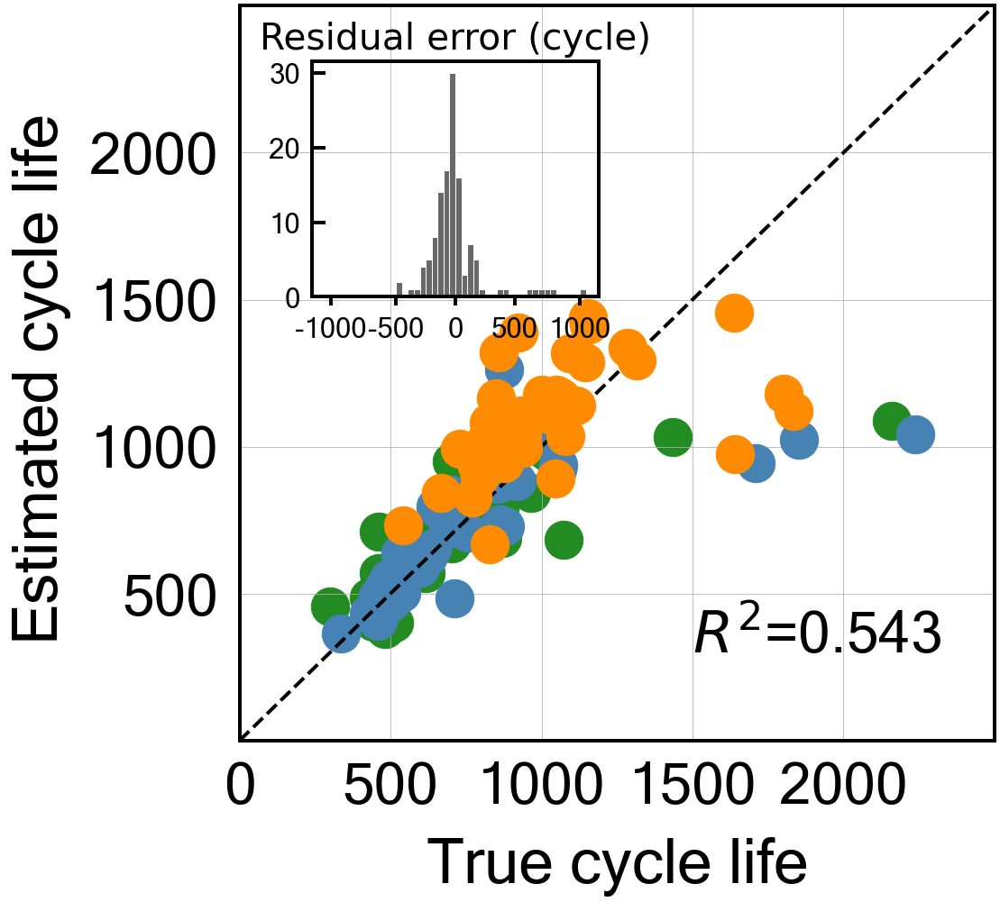


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.2
Best score obtained was: 0.15656064055258345
Cycle no: Average_2to104
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to104') : 0.04221050022294708
T_Q('Charge', 'Max-Min', 'Average_2to104') : -0.0842538831882516
T_Q('Discharge', 'Variance', 'Average_2to104') : 0.07351976509430501
dTdQ('Charge', 'Mean', 'Average_2to104') : -0.03451765179299808
dTdQ('Charge', 'Skewness', 'Average_2to104') : 0.011415138170042062
dTdQ('Charge', 'Maximum', 'Average_2to104') : -0.0658036581232281

Intercept: 2.7939698976436373
r2-score: 0.721
MAE_all: 145.7
MAE_train: 109.9
MAE_test: 125.5
MAE_2ndTest: 203.7
MAPE_all: 15.3 %
MAPE_train: 14.0 %
MAPE_test: 12.1 %
MAPE_2ndTest: 19.9 %
RMSE_all: 248.4
RMSE_train: 208.6
RMSE_test: 270.0
RMSE_2ndTest: 261.8
RMSPE_all: 20.5 %
RMSPE_train: 19.6 %
RMSPE_test: 17.9 %
RMSPE_2ndTest: 23.7 %
Log-scale scores
All data r2-score: 0

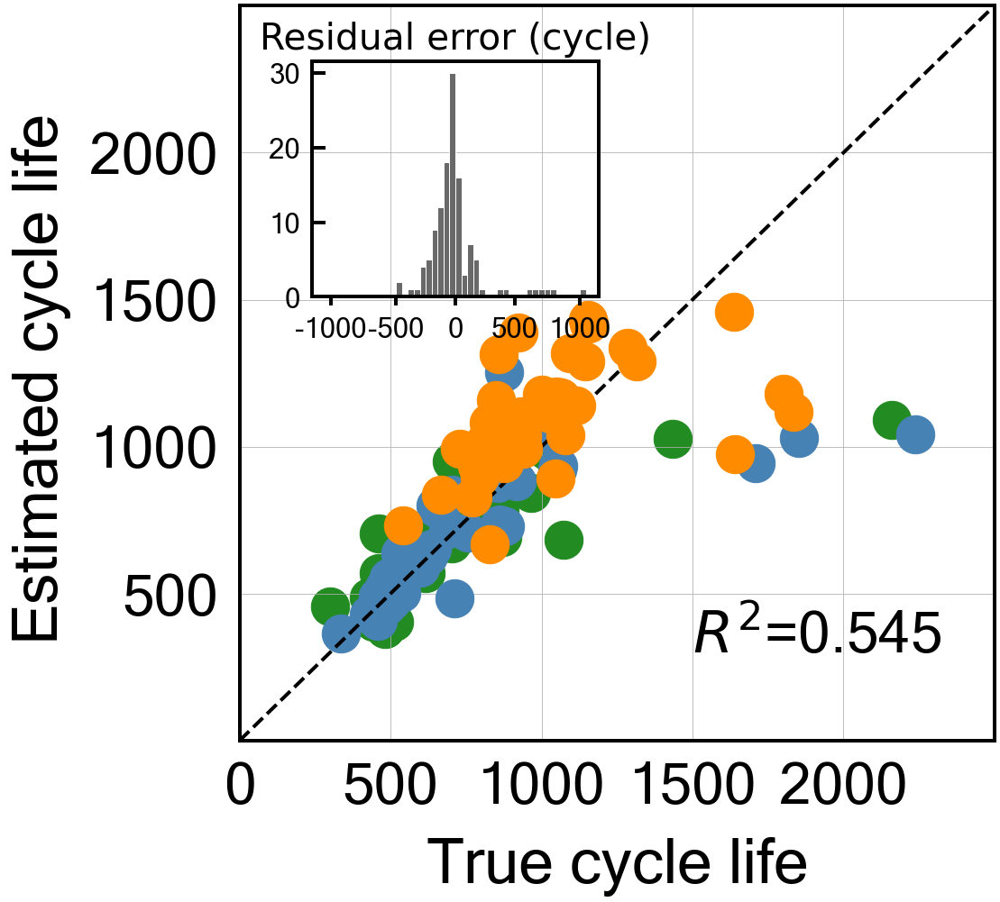


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: 0.15927215030868924
Cycle no: Average_2to105
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to105') : 0.04189635395927415
T_Q('Charge', 'Max-Min', 'Average_2to105') : -0.08477789132402466
T_Q('Discharge', 'Variance', 'Average_2to105') : 0.07419188711094477
dTdQ('Charge', 'Mean', 'Average_2to105') : -0.034504048217659455
dTdQ('Charge', 'Skewness', 'Average_2to105') : 0.0114209058691197
dTdQ('Charge', 'Maximum', 'Average_2to105') : -0.06585902998288541

Intercept: 2.7939698976436365
r2-score: 0.722
MAE_all: 145.4
MAE_train: 109.7
MAE_test: 125.2
MAE_2ndTest: 203.2
MAPE_all: 15.2 %
MAPE_train: 14.0 %
MAPE_test: 12.0 %
MAPE_2ndTest: 19.9 %
RMSE_all: 248.0
RMSE_train: 208.3
RMSE_test: 269.5
RMSE_2ndTest: 261.4
RMSPE_all: 20.4 %
RMSPE_train: 19.6 %
RMSPE_test: 17.8 %
RMSPE_2ndTest: 23.6 %
Log-scale scores
All data r2-score: 

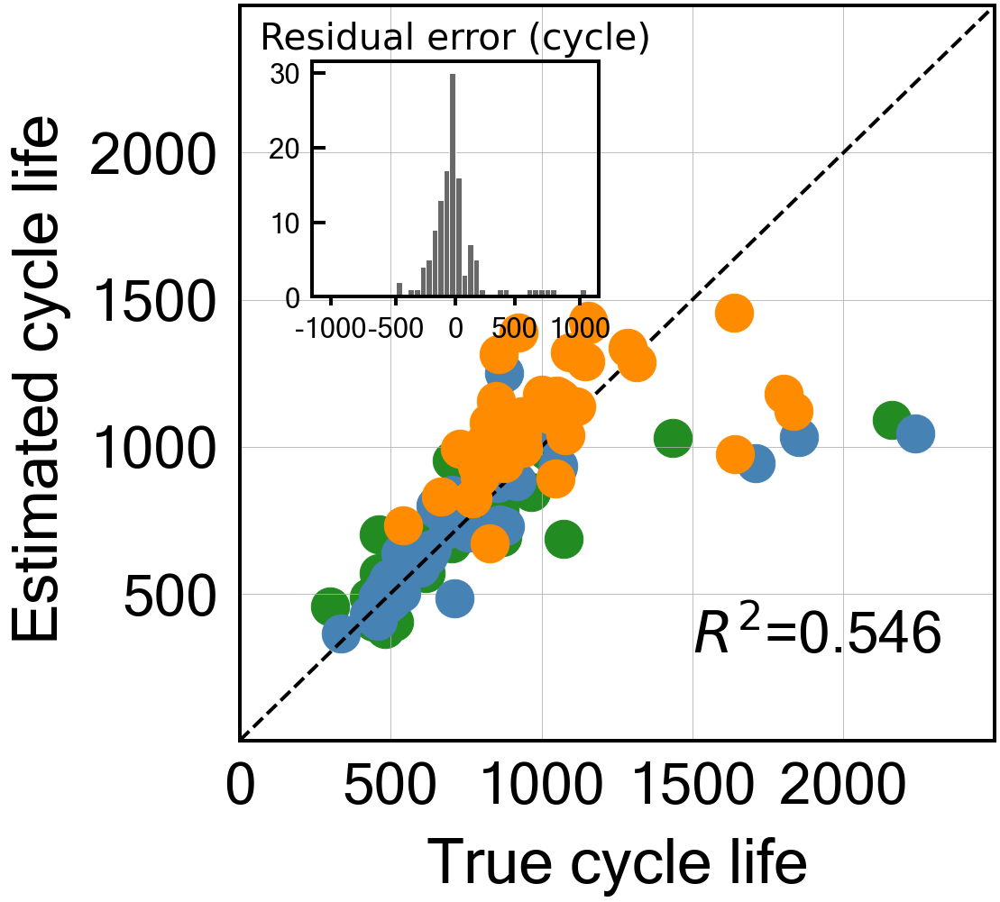


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.1556495120505863
Cycle no: Average_2to106
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to106') : 0.04201344485750315
T_Q('Charge', 'Max-Min', 'Average_2to106') : -0.08525321542923146
T_Q('Discharge', 'Variance', 'Average_2to106') : 0.07475795543315725
dTdQ('Charge', 'Mean', 'Average_2to106') : -0.03405427400036258
dTdQ('Charge', 'Skewness', 'Average_2to106') : 0.01167848560055973
dTdQ('Charge', 'Maximum', 'Average_2to106') : -0.06625247126172085

Intercept: 2.793969897643638
r2-score: 0.722
MAE_all: 145.8
MAE_train: 109.9
MAE_test: 124.9
MAE_2ndTest: 204.6
MAPE_all: 15.3 %
MAPE_train: 14.0 %
MAPE_test: 12.0 %
MAPE_2ndTest: 20.0 %
RMSE_all: 248.0
RMSE_train: 208.4
RMSE_test: 269.0
RMSE_2ndTest: 262.0
RMSPE_all: 20.5 %
RMSPE_train: 19.6 %
RMSPE_test: 17.7 %
RMSPE_2ndTest: 23.7 %
Log-scale scores
All data r2-score: 0.

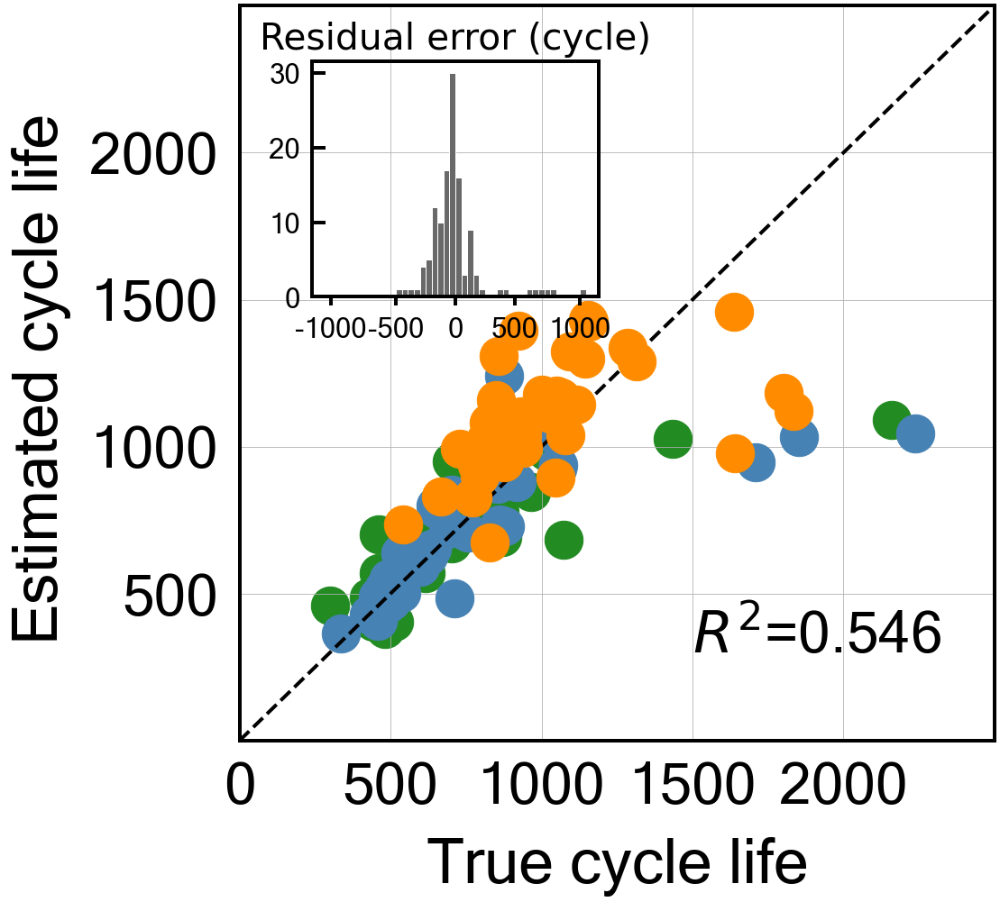


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 6.0
Best score obtained was: 0.1566017450920092
Cycle no: Average_2to107
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to107') : 0.04196919695619357
T_Q('Charge', 'Max-Min', 'Average_2to107') : -0.08500107130899602
T_Q('Discharge', 'Variance', 'Average_2to107') : 0.07471653434682814
dTdQ('Charge', 'Mean', 'Average_2to107') : -0.034035029798508906
dTdQ('Charge', 'Skewness', 'Average_2to107') : 0.01187736498598752
dTdQ('Charge', 'Maximum', 'Average_2to107') : -0.0663855827427746

Intercept: 2.7939698976436365
r2-score: 0.722
MAE_all: 145.8
MAE_train: 110.1
MAE_test: 124.8
MAE_2ndTest: 204.4
MAPE_all: 15.3 %
MAPE_train: 14.1 %
MAPE_test: 12.0 %
MAPE_2ndTest: 20.0 %
RMSE_all: 248.0
RMSE_train: 209.1
RMSE_test: 268.7
RMSE_2ndTest: 261.8
RMSPE_all: 20.4 %
RMSPE_train: 19.7 %
RMSPE_test: 17.7 %
RMSPE_2ndTest: 23.6 %
Log-scale scores
All data r2-score: 0

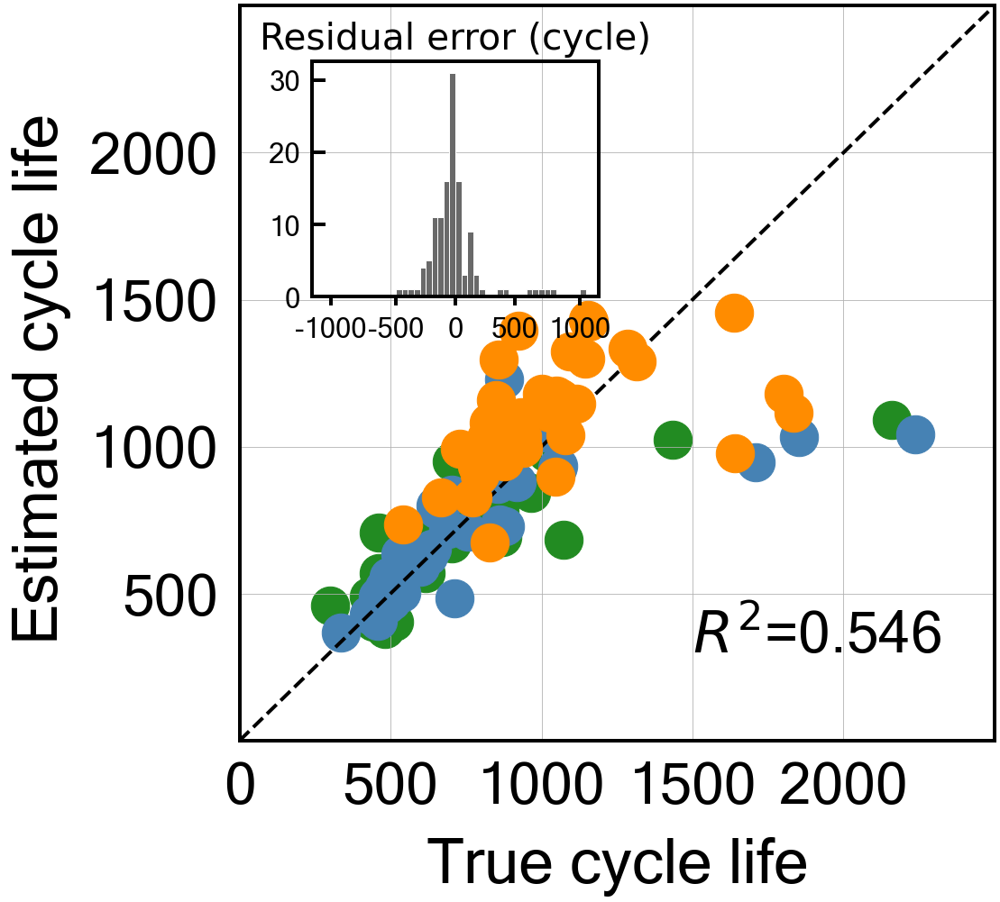


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.4
Best score obtained was: 0.15940755353790803
Cycle no: Average_2to108
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to108') : 0.0417797761647967
T_Q('Charge', 'Max-Min', 'Average_2to108') : -0.08554157150806932
T_Q('Discharge', 'Variance', 'Average_2to108') : 0.075386523367157
dTdQ('Charge', 'Mean', 'Average_2to108') : -0.03391085911994278
dTdQ('Charge', 'Skewness', 'Average_2to108') : 0.011548907553795848
dTdQ('Charge', 'Maximum', 'Average_2to108') : -0.06633832871725445

Intercept: 2.7939698976436365
r2-score: 0.723
MAE_all: 145.5
MAE_train: 110.1
MAE_test: 124.7
MAE_2ndTest: 203.8
MAPE_all: 15.2 %
MAPE_train: 14.0 %
MAPE_test: 12.0 %
MAPE_2ndTest: 19.9 %
RMSE_all: 247.8
RMSE_train: 209.2
RMSE_test: 268.3
RMSE_2ndTest: 261.4
RMSPE_all: 20.4 %
RMSPE_train: 19.6 %
RMSPE_test: 17.6 %
RMSPE_2ndTest: 23.6 %
Log-scale scores
All data r2-score: 0.

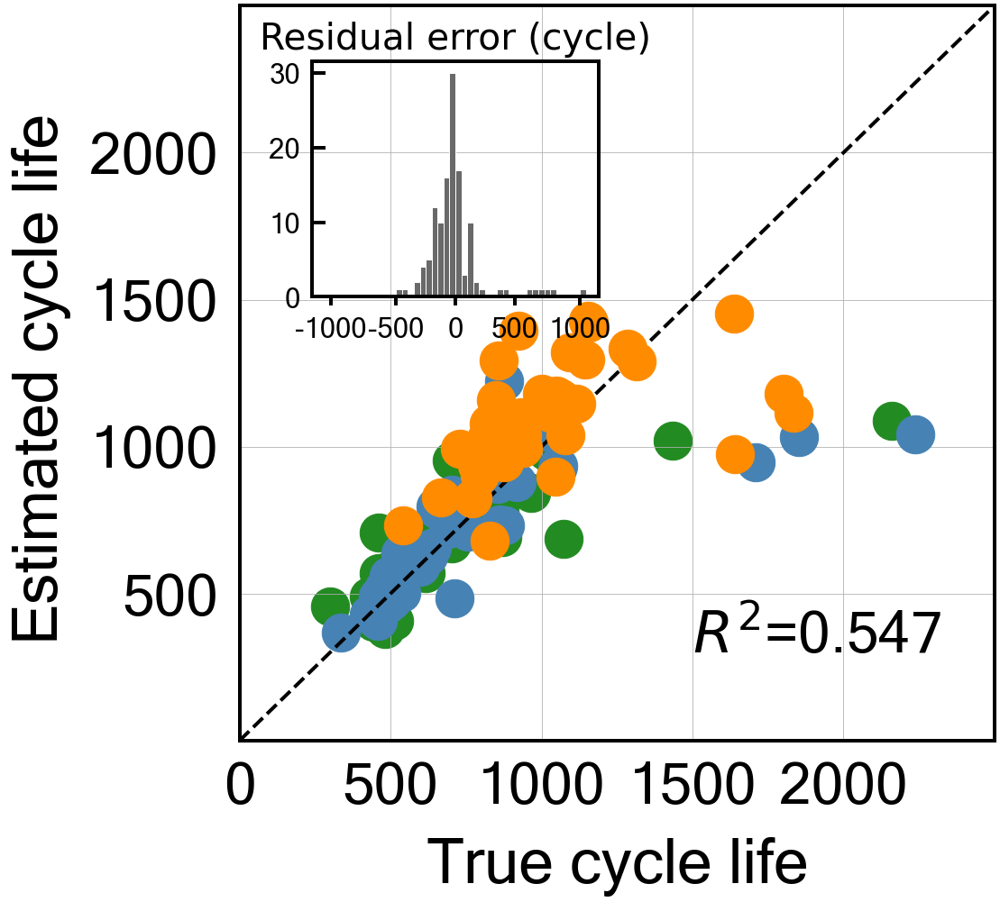


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: 0.16049016891539825
Cycle no: Average_2to109
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to109') : 0.04159553360206604
T_Q('Charge', 'Max-Min', 'Average_2to109') : -0.08576266623134027
T_Q('Discharge', 'Variance', 'Average_2to109') : 0.0758583301309139
dTdQ('Charge', 'Mean', 'Average_2to109') : -0.03400862036715494
dTdQ('Charge', 'Skewness', 'Average_2to109') : 0.01147584825297998
dTdQ('Charge', 'Maximum', 'Average_2to109') : -0.06629391495961308

Intercept: 2.793969897643636
r2-score: 0.723
MAE_all: 145.3
MAE_train: 110.2
MAE_test: 124.4
MAE_2ndTest: 203.2
MAPE_all: 15.2 %
MAPE_train: 14.1 %
MAPE_test: 12.0 %
MAPE_2ndTest: 19.8 %
RMSE_all: 247.6
RMSE_train: 209.1
RMSE_test: 268.0
RMSE_2ndTest: 261.2
RMSPE_all: 20.3 %
RMSPE_train: 19.6 %
RMSPE_test: 17.6 %
RMSPE_2ndTest: 23.5 %
Log-scale scores
All data r2-score: 0.

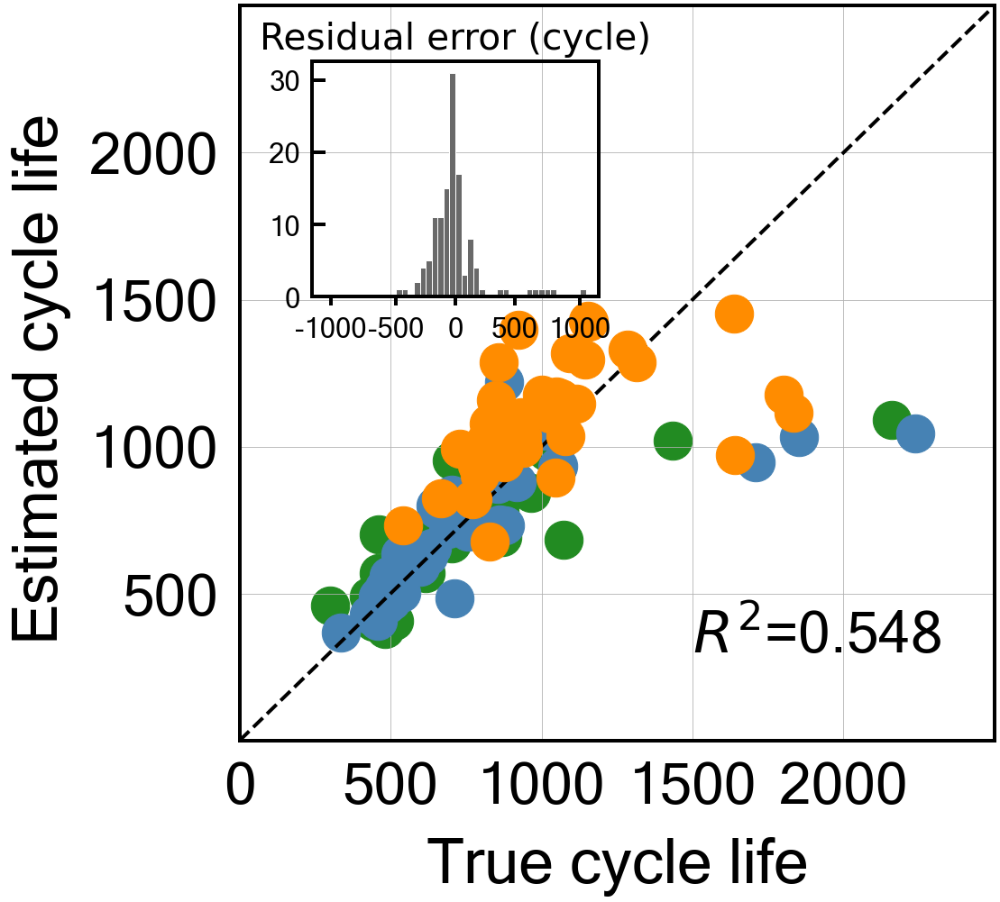


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.6
Best score obtained was: 0.15694477658845085
Cycle no: Average_2to110
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to110') : 0.04155066438659067
T_Q('Charge', 'Max-Min', 'Average_2to110') : -0.08558549742887789
T_Q('Discharge', 'Variance', 'Average_2to110') : 0.07609628989913766
dTdQ('Charge', 'Mean', 'Average_2to110') : -0.03420589016914144
dTdQ('Charge', 'Skewness', 'Average_2to110') : 0.011414779841404125
dTdQ('Charge', 'Maximum', 'Average_2to110') : -0.06641872512350536

Intercept: 2.793969897643637
r2-score: 0.723
MAE_all: 145.2
MAE_train: 110.2
MAE_test: 124.1
MAE_2ndTest: 203.3
MAPE_all: 15.2 %
MAPE_train: 14.1 %
MAPE_test: 11.9 %
MAPE_2ndTest: 19.8 %
RMSE_all: 247.8
RMSE_train: 209.5
RMSE_test: 267.8
RMSE_2ndTest: 261.8
RMSPE_all: 20.3 %
RMSPE_train: 19.7 %
RMSPE_test: 17.5 %
RMSPE_2ndTest: 23.5 %
Log-scale scores
All data r2-score: 

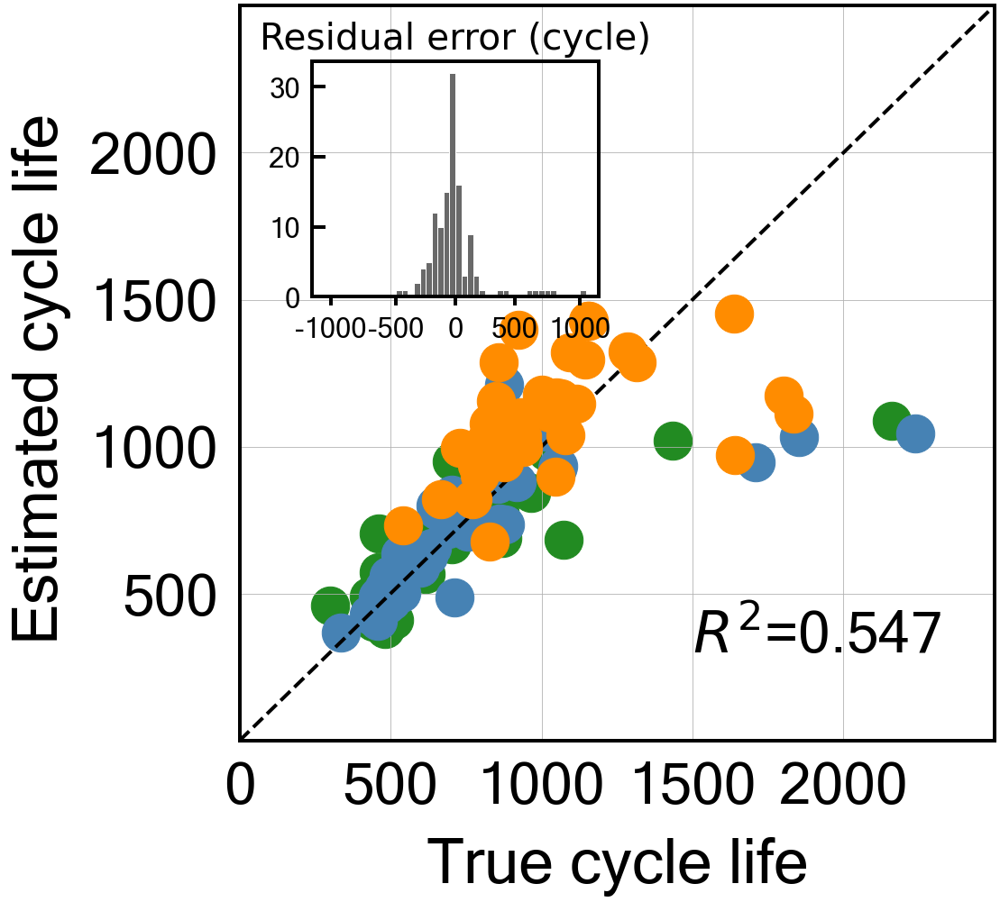


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.2
Best score obtained was: 0.1580619503644639
Cycle no: Average_2to111
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to111') : 0.04147833071046493
T_Q('Charge', 'Max-Min', 'Average_2to111') : -0.08564625224358463
T_Q('Discharge', 'Variance', 'Average_2to111') : 0.07657922340922431
dTdQ('Charge', 'Mean', 'Average_2to111') : -0.03440171614523768
dTdQ('Charge', 'Skewness', 'Average_2to111') : 0.011016151374094766
dTdQ('Charge', 'Maximum', 'Average_2to111') : -0.06655123518079724

Intercept: 2.793969897643637
r2-score: 0.724
MAE_all: 145.0
MAE_train: 110.0
MAE_test: 123.7
MAE_2ndTest: 203.2
MAPE_all: 15.2 %
MAPE_train: 14.0 %
MAPE_test: 11.9 %
MAPE_2ndTest: 19.8 %
RMSE_all: 247.4
RMSE_train: 209.2
RMSE_test: 267.2
RMSE_2ndTest: 261.6
RMSPE_all: 20.3 %
RMSPE_train: 19.6 %
RMSPE_test: 17.4 %
RMSPE_2ndTest: 23.5 %
Log-scale scores
All data r2-score: 0

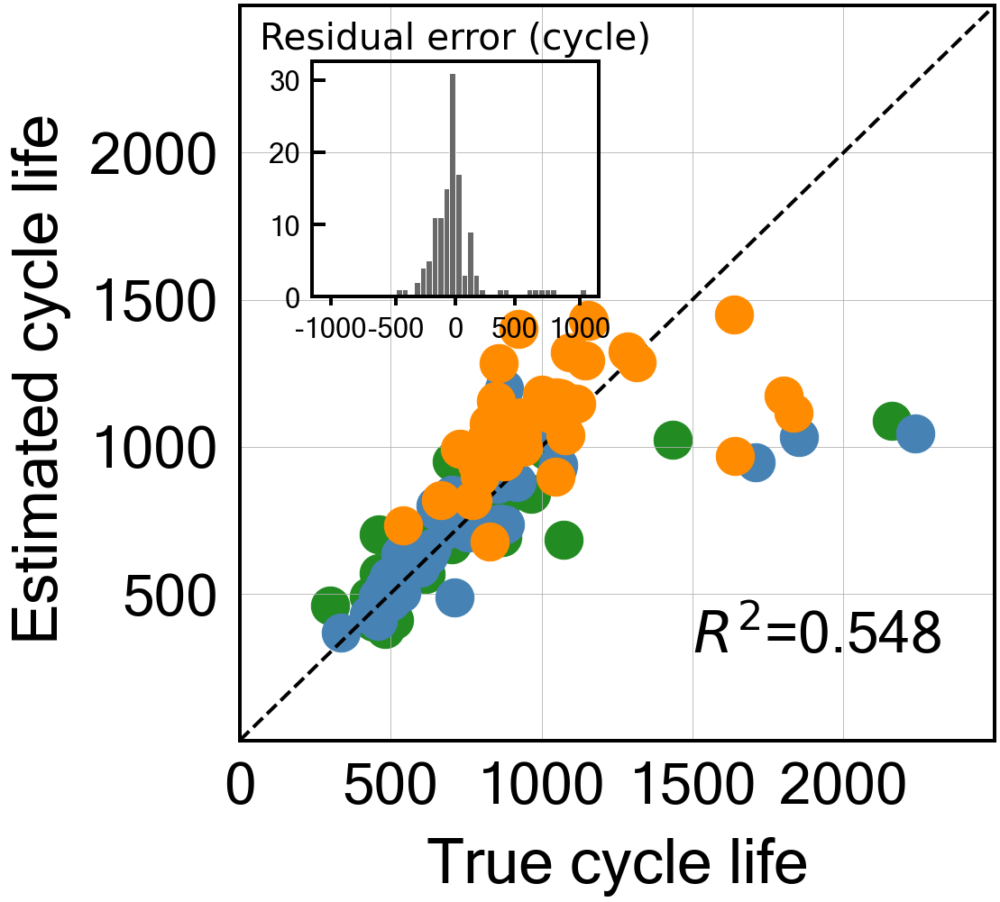


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: 0.15896909797723802
Cycle no: Average_2to112
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to112') : 0.04144606649352018
T_Q('Charge', 'Max-Min', 'Average_2to112') : -0.08571256340859282
T_Q('Discharge', 'Variance', 'Average_2to112') : 0.07661466379947388
dTdQ('Charge', 'Mean', 'Average_2to112') : -0.03445009299240141
dTdQ('Charge', 'Skewness', 'Average_2to112') : 0.011232038490462342
dTdQ('Charge', 'Maximum', 'Average_2to112') : -0.0665931721736275

Intercept: 2.7939698976436382
r2-score: 0.724
MAE_all: 144.9
MAE_train: 110.0
MAE_test: 123.6
MAE_2ndTest: 202.9
MAPE_all: 15.2 %
MAPE_train: 14.0 %
MAPE_test: 11.9 %
MAPE_2ndTest: 19.8 %
RMSE_all: 247.4
RMSE_train: 209.2
RMSE_test: 267.1
RMSE_2ndTest: 261.5
RMSPE_all: 20.3 %
RMSPE_train: 19.6 %
RMSPE_test: 17.4 %
RMSPE_2ndTest: 23.5 %
Log-scale scores
All data r2-score: 

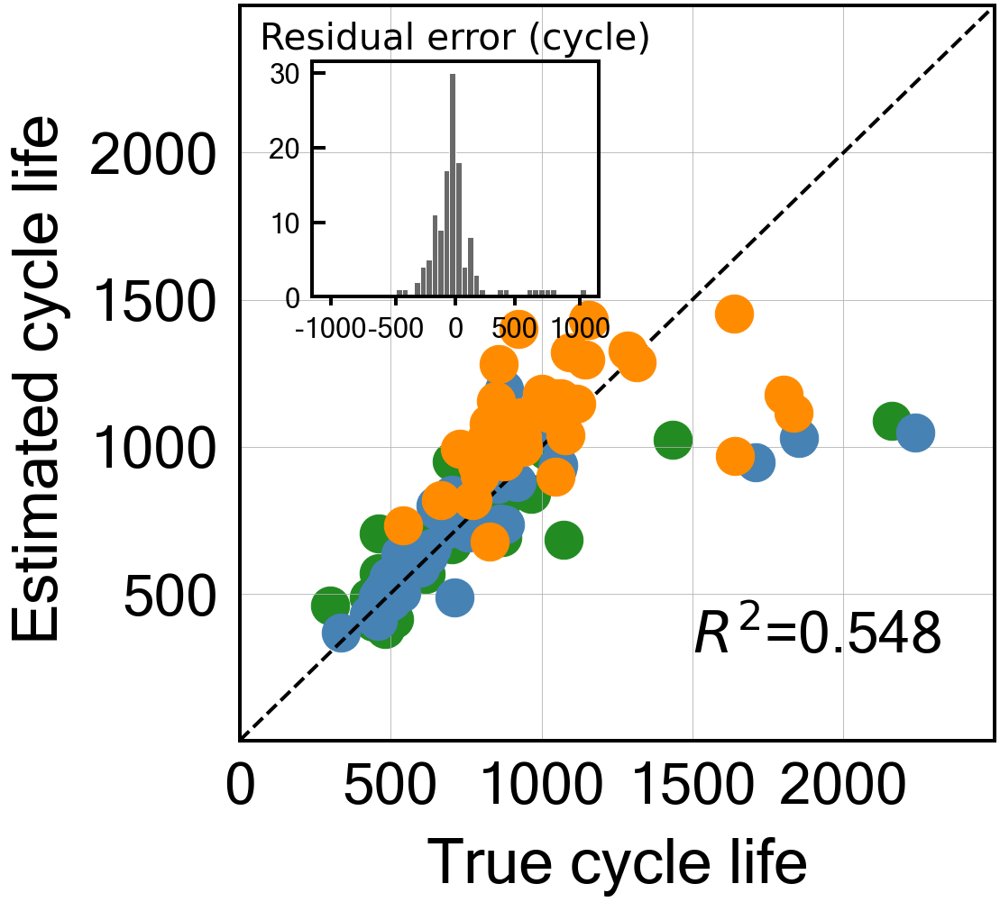


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 6.8
Best score obtained was: 0.16033972379804173
Cycle no: Average_2to113
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to113') : 0.04096935789842861
T_Q('Charge', 'Max-Min', 'Average_2to113') : -0.08652158632371774
T_Q('Discharge', 'Variance', 'Average_2to113') : 0.07753801808344361
dTdQ('Charge', 'Mean', 'Average_2to113') : -0.03430451743722308
dTdQ('Charge', 'Skewness', 'Average_2to113') : 0.011602762353723555
dTdQ('Charge', 'Maximum', 'Average_2to113') : -0.06689923113881516

Intercept: 2.793969897643637
r2-score: 0.727
MAE_all: 144.5
MAE_train: 109.6
MAE_test: 123.0
MAE_2ndTest: 202.8
MAPE_all: 15.1 %
MAPE_train: 14.0 %
MAPE_test: 11.8 %
MAPE_2ndTest: 19.8 %
RMSE_all: 246.5
RMSE_train: 208.2
RMSE_test: 265.9
RMSE_2ndTest: 261.3
RMSPE_all: 20.2 %
RMSPE_train: 19.5 %
RMSPE_test: 17.3 %
RMSPE_2ndTest: 23.4 %
Log-scale scores
All data r2-score: 

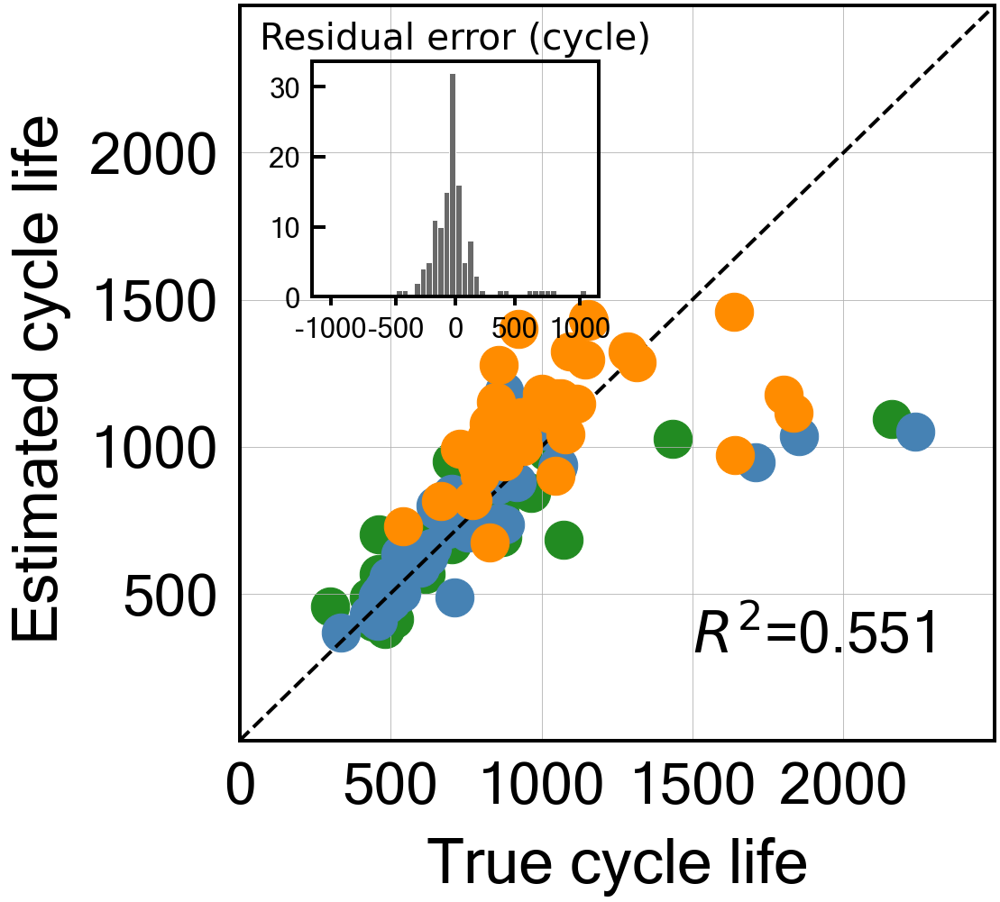


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.5
Best score obtained was: 0.16491864193573524
Cycle no: Average_2to114
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to114') : 0.0403628589059667
T_Q('Charge', 'Max-Min', 'Average_2to114') : -0.08738079244793796
T_Q('Discharge', 'Variance', 'Average_2to114') : 0.07865813315444167
dTdQ('Charge', 'Mean', 'Average_2to114') : -0.03431025060246782
dTdQ('Charge', 'Skewness', 'Average_2to114') : 0.011168455637228573
dTdQ('Charge', 'Maximum', 'Average_2to114') : -0.06686904889476922

Intercept: 2.793969897643637
r2-score: 0.729
MAE_all: 143.9
MAE_train: 109.3
MAE_test: 122.7
MAE_2ndTest: 201.7
MAPE_all: 15.0 %
MAPE_train: 13.9 %
MAPE_test: 11.8 %
MAPE_2ndTest: 19.6 %
RMSE_all: 245.8
RMSE_train: 207.5
RMSE_test: 265.0
RMSE_2ndTest: 260.5
RMSPE_all: 20.1 %
RMSPE_train: 19.4 %
RMSPE_test: 17.3 %
RMSPE_2ndTest: 23.3 %
Log-scale scores
All data r2-score: 0

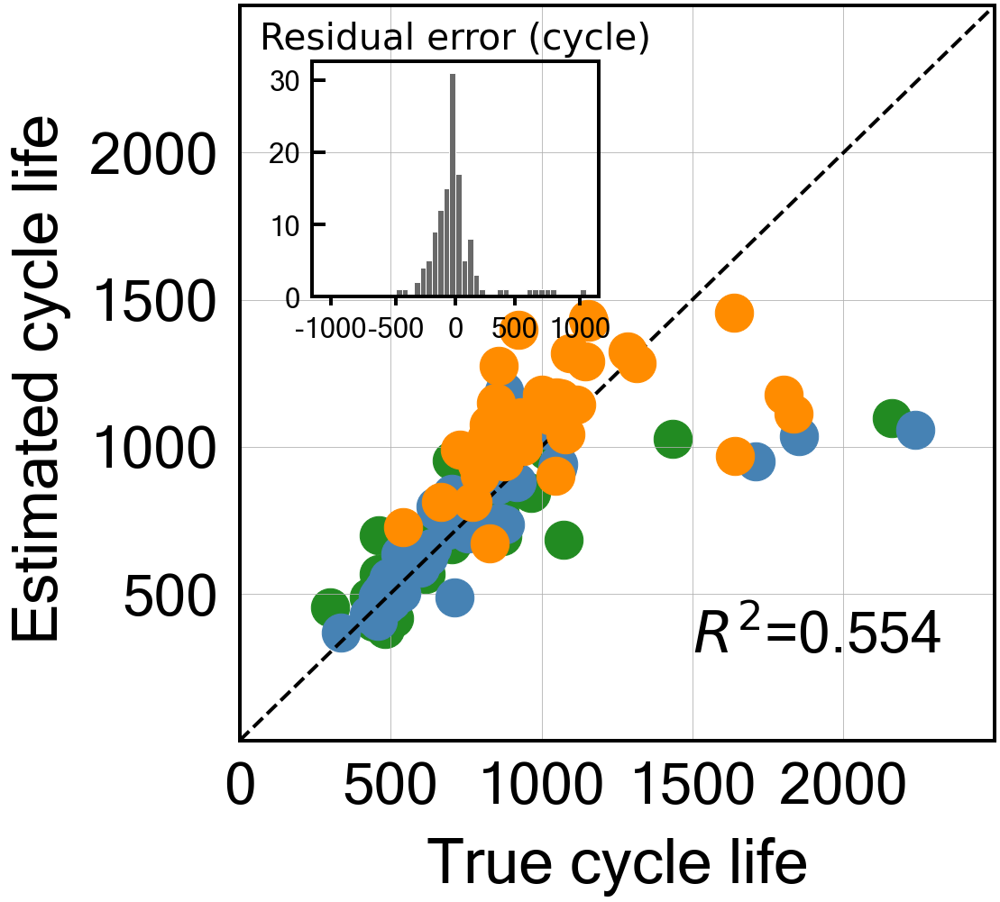


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.14886157196693484
Cycle no: Average_2to115
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to115') : 0.040569875625049406
T_Q('Charge', 'Max-Min', 'Average_2to115') : -0.08769338153435746
T_Q('Discharge', 'Variance', 'Average_2to115') : 0.08037677324764726
dTdQ('Charge', 'Mean', 'Average_2to115') : -0.03466368797495799
dTdQ('Charge', 'Skewness', 'Average_2to115') : 0.011722534056472582
dTdQ('Charge', 'Maximum', 'Average_2to115') : -0.06841300129783373

Intercept: 2.793969897643637
r2-score: 0.728
MAE_all: 144.9
MAE_train: 109.1
MAE_test: 121.7
MAE_2ndTest: 206.1
MAPE_all: 15.2 %
MAPE_train: 13.9 %
MAPE_test: 11.7 %
MAPE_2ndTest: 20.1 %
RMSE_all: 245.6
RMSE_train: 206.7
RMSE_test: 262.7
RMSE_2ndTest: 263.0
RMSPE_all: 20.2 %
RMSPE_train: 19.4 %
RMSPE_test: 17.1 %
RMSPE_2ndTest: 23.7 %
Log-scale scores
All data r2-score:

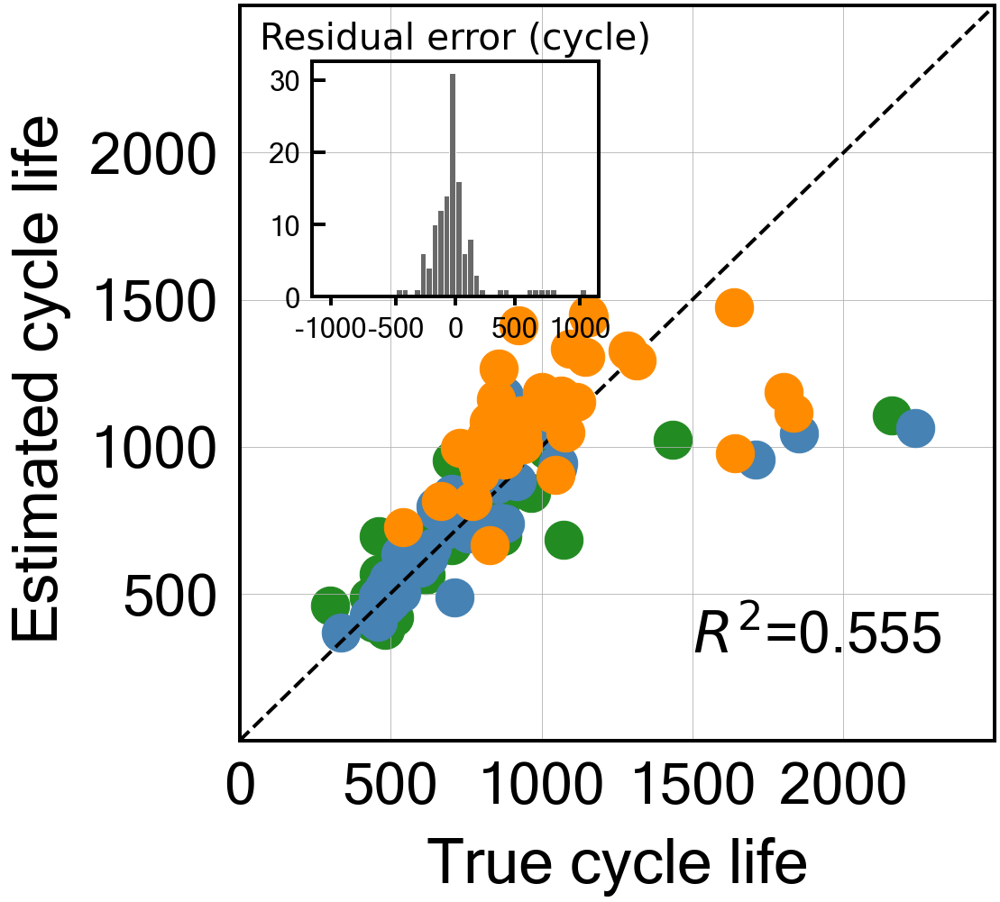


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.4
Best score obtained was: 0.14459435642219198
Cycle no: Average_2to116
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to116') : 0.03461046544484142
T_Q('Charge', 'Max-Min', 'Average_2to116') : -0.09988767341526597
T_Q('Discharge', 'Variance', 'Average_2to116') : 0.09834981347809472
dTdQ('Charge', 'Mean', 'Average_2to116') : -0.03384753658734501
dTdQ('Charge', 'Skewness', 'Average_2to116') : 0.013278487125007265
dTdQ('Charge', 'Maximum', 'Average_2to116') : -0.07459897766142454

Intercept: 2.793969897643637
r2-score: 0.745
MAE_all: 143.6
MAE_train: 106.9
MAE_test: 116.7
MAE_2ndTest: 209.5
MAPE_all: 15.2 %
MAPE_train: 13.8 %
MAPE_test: 11.5 %
MAPE_2ndTest: 20.6 %
RMSE_all: 236.2
RMSE_train: 196.4
RMSE_test: 243.9
RMSE_2ndTest: 263.7
RMSPE_all: 19.9 %
RMSPE_train: 18.9 %
RMSPE_test: 16.2 %
RMSPE_2ndTest: 24.1 %
Log-scale scores
All data r2-score: 

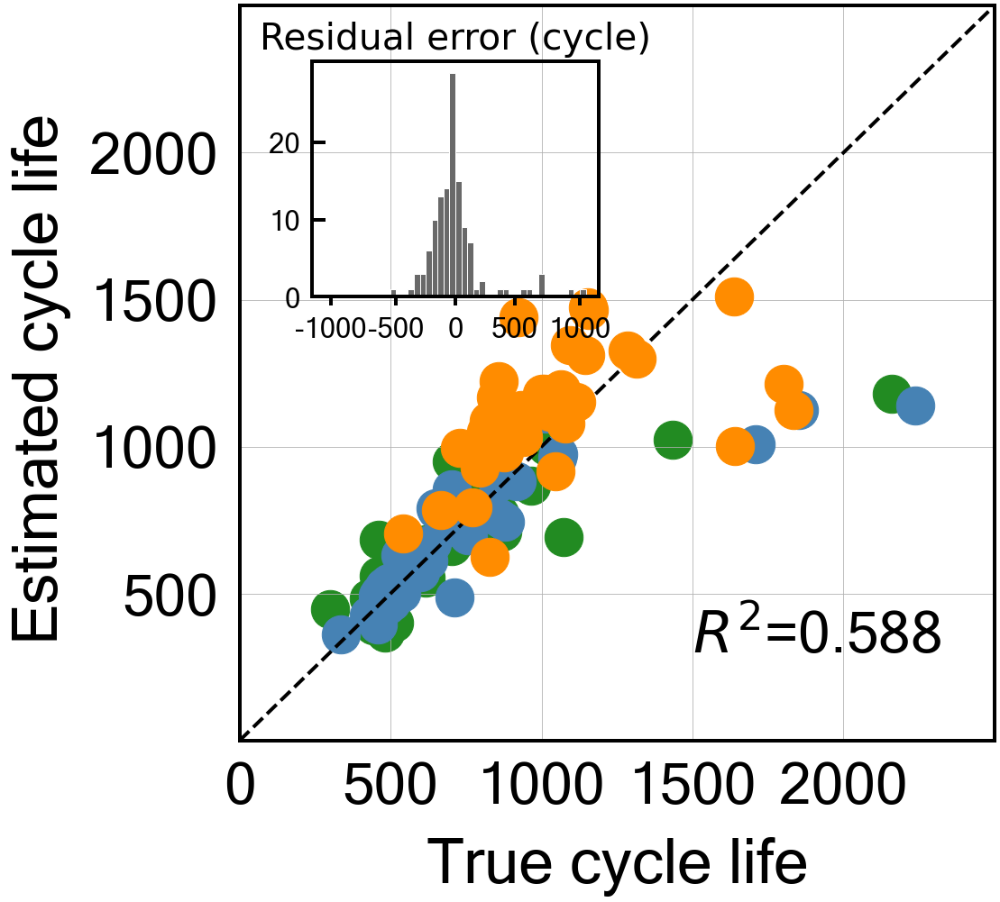


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.9
Best score obtained was: 0.13844808907374095
Cycle no: Average_2to117
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to117') : 0.03448119316963438
T_Q('Charge', 'Max-Min', 'Average_2to117') : -0.0999955461441531
T_Q('Discharge', 'Variance', 'Average_2to117') : 0.09884645672625497
dTdQ('Charge', 'Mean', 'Average_2to117') : -0.03380796177529529
dTdQ('Charge', 'Skewness', 'Average_2to117') : 0.01382566042572011
dTdQ('Charge', 'Maximum', 'Average_2to117') : -0.07519121477546657

Intercept: 2.7939698976436365
r2-score: 0.745
MAE_all: 143.8
MAE_train: 106.7
MAE_test: 116.3
MAE_2ndTest: 210.7
MAPE_all: 15.3 %
MAPE_train: 13.8 %
MAPE_test: 11.5 %
MAPE_2ndTest: 20.7 %
RMSE_all: 236.1
RMSE_train: 196.1
RMSE_test: 243.0
RMSE_2ndTest: 264.6
RMSPE_all: 19.9 %
RMSPE_train: 18.8 %
RMSPE_test: 16.1 %
RMSPE_2ndTest: 24.2 %
Log-scale scores
All data r2-score: 0

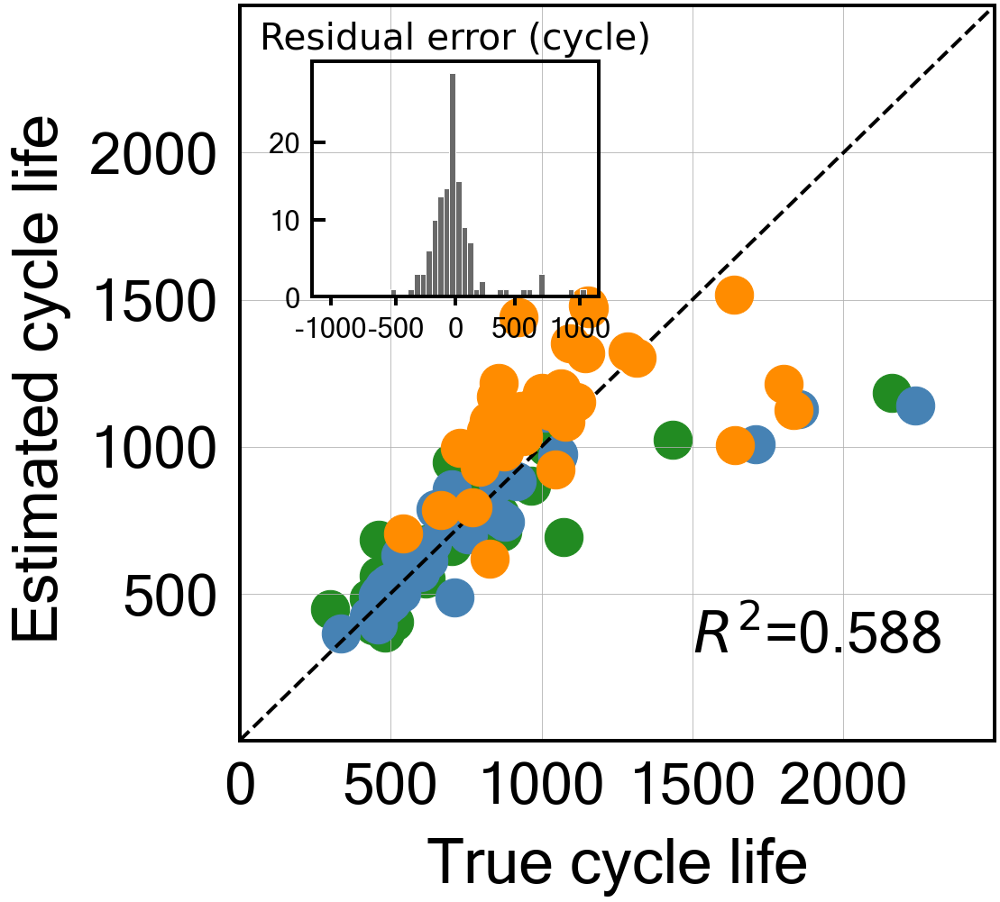


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.6
Best score obtained was: 0.13423352110544273
Cycle no: Average_2to118
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to118') : 0.034477159359253544
T_Q('Charge', 'Max-Min', 'Average_2to118') : -0.09981660822046644
T_Q('Discharge', 'Variance', 'Average_2to118') : 0.09917034857612982
dTdQ('Charge', 'Mean', 'Average_2to118') : -0.033856752760028044
dTdQ('Charge', 'Skewness', 'Average_2to118') : 0.014122079871283012
dTdQ('Charge', 'Maximum', 'Average_2to118') : -0.07581286728805842

Intercept: 2.793969897643638
r2-score: 0.745
MAE_all: 144.1
MAE_train: 106.7
MAE_test: 116.0
MAE_2ndTest: 211.8
MAPE_all: 15.3 %
MAPE_train: 13.8 %
MAPE_test: 11.5 %
MAPE_2ndTest: 20.8 %
RMSE_all: 236.1
RMSE_train: 195.7
RMSE_test: 242.5
RMSE_2ndTest: 265.3
RMSPE_all: 19.9 %
RMSPE_train: 18.8 %
RMSPE_test: 16.0 %
RMSPE_2ndTest: 24.3 %
Log-scale scores
All data r2-score

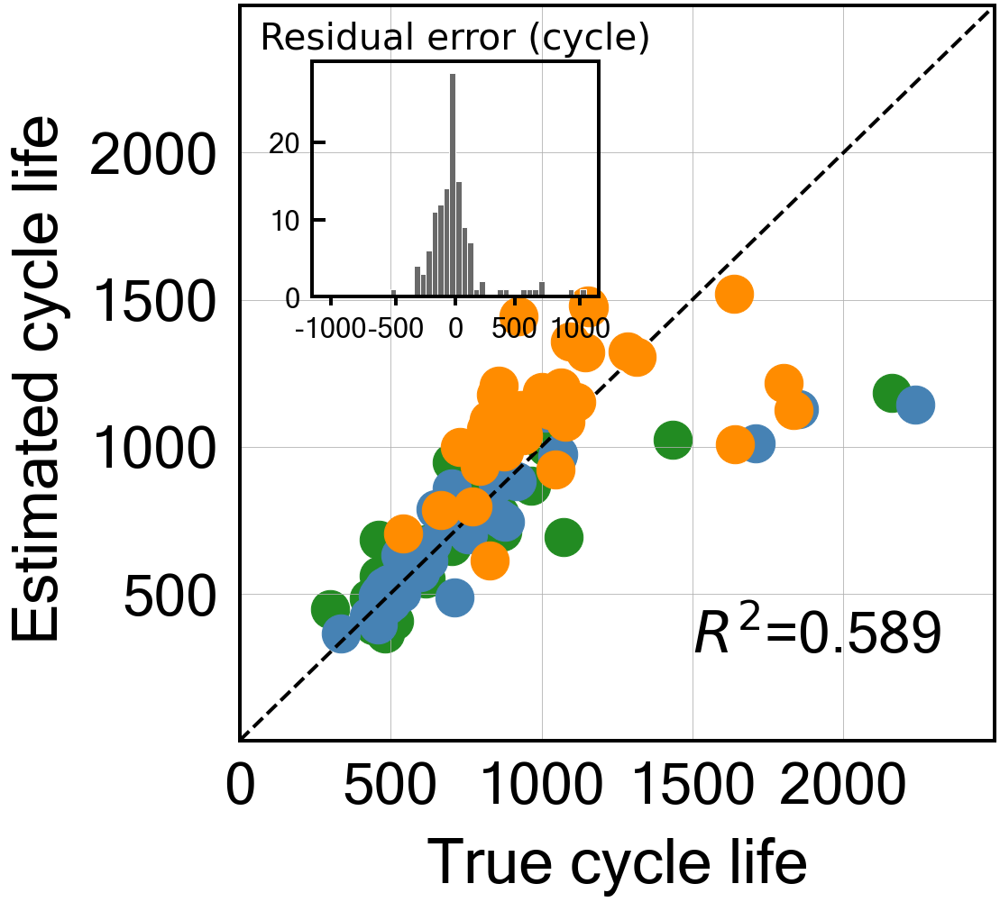


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.6
Best score obtained was: 0.1286773750890442
Cycle no: Average_2to119
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to119') : 0.034511259248795764
T_Q('Charge', 'Max-Min', 'Average_2to119') : -0.10087828516161397
T_Q('Discharge', 'Variance', 'Average_2to119') : 0.10007342737285926
dTdQ('Charge', 'Mean', 'Average_2to119') : -0.03332436567868589
dTdQ('Charge', 'Skewness', 'Average_2to119') : 0.013973182545076056
dTdQ('Charge', 'Maximum', 'Average_2to119') : -0.07615261593922995

Intercept: 2.793969897643637
r2-score: 0.745
MAE_all: 144.1
MAE_train: 106.3
MAE_test: 115.5
MAE_2ndTest: 213.0
MAPE_all: 15.3 %
MAPE_train: 13.7 %
MAPE_test: 11.4 %
MAPE_2ndTest: 21.0 %
RMSE_all: 236.0
RMSE_train: 195.1
RMSE_test: 241.9
RMSE_2ndTest: 266.1
RMSPE_all: 19.9 %
RMSPE_train: 18.7 %
RMSPE_test: 16.0 %
RMSPE_2ndTest: 24.5 %
Log-scale scores
All data r2-score: 

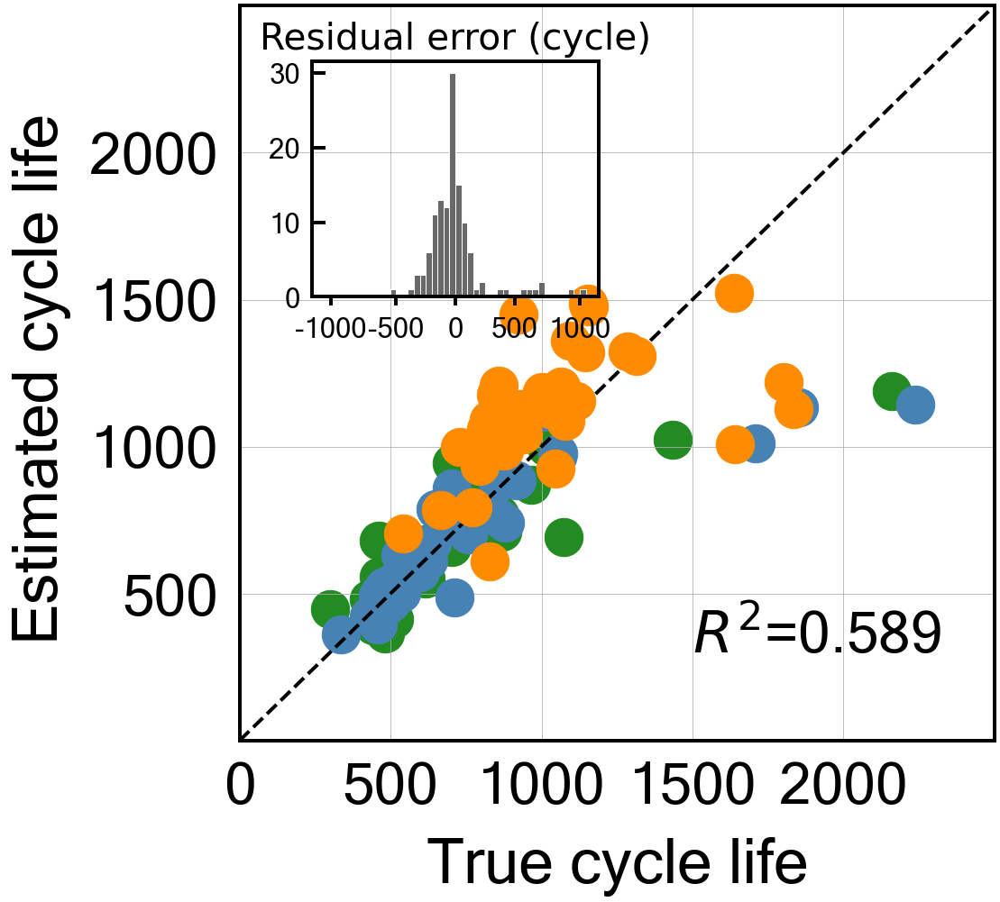


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.2
Best score obtained was: 0.150001998416046
Cycle no: Average_2to120
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to120') : 0.02246936972173559
T_Q('Charge', 'Max-Min', 'Average_2to120') : -0.13004077538573178
T_Q('Discharge', 'Variance', 'Average_2to120') : 0.13464939988707267
dTdQ('Charge', 'Mean', 'Average_2to120') : -0.027168595709955876
dTdQ('Charge', 'Skewness', 'Average_2to120') : 0.013602303518386403
dTdQ('Charge', 'Maximum', 'Average_2to120') : -0.08328589729293247

Intercept: 2.7939698976436365
r2-score: 0.767
MAE_all: 139.5
MAE_train: 103.2
MAE_test: 106.0
MAE_2ndTest: 211.8
MAPE_all: 15.1 %
MAPE_train: 13.6 %
MAPE_test: 11.0 %
MAPE_2ndTest: 20.8 %
RMSE_all: 219.8
RMSE_train: 177.8
RMSE_test: 211.7
RMSE_2ndTest: 262.9
RMSPE_all: 19.3 %
RMSPE_train: 17.9 %
RMSPE_test: 14.9 %
RMSPE_2ndTest: 24.2 %
Log-scale scores
All data r2-score: 

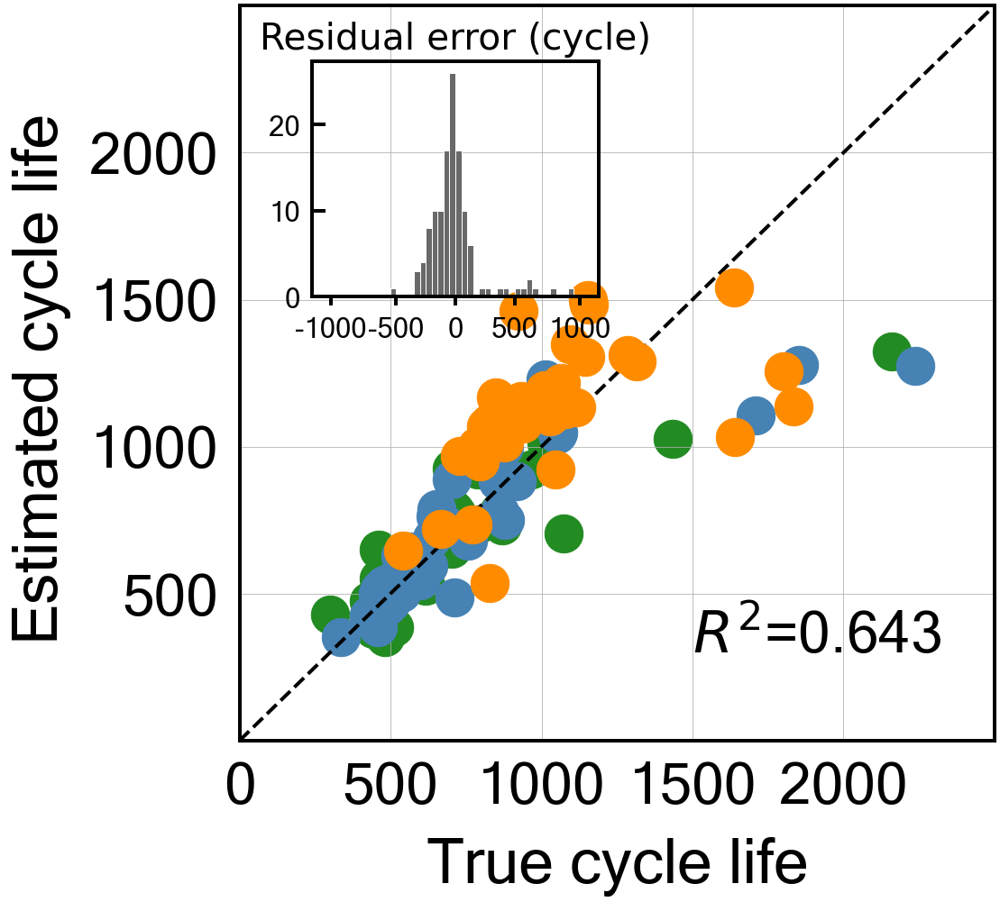


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.6
Best score obtained was: 0.15562126497092832
Cycle no: Average_2to121
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to121') : 0.021847623850630844
T_Q('Charge', 'Max-Min', 'Average_2to121') : -0.13038722869743227
T_Q('Discharge', 'Variance', 'Average_2to121') : 0.13610484414007218
dTdQ('Charge', 'Mean', 'Average_2to121') : -0.027770407022221538
dTdQ('Charge', 'Skewness', 'Average_2to121') : 0.013624787422464457
dTdQ('Charge', 'Maximum', 'Average_2to121') : -0.08352006342514148

Intercept: 2.793969897643637
r2-score: 0.768
MAE_all: 139.0
MAE_train: 103.4
MAE_test: 105.7
MAE_2ndTest: 210.3
MAPE_all: 15.0 %
MAPE_train: 13.7 %
MAPE_test: 10.9 %
MAPE_2ndTest: 20.7 %
RMSE_all: 219.4
RMSE_train: 178.0
RMSE_test: 211.3
RMSE_2ndTest: 262.0
RMSPE_all: 19.3 %
RMSPE_train: 17.9 %
RMSPE_test: 14.9 %
RMSPE_2ndTest: 24.0 %
Log-scale scores
All data r2-score

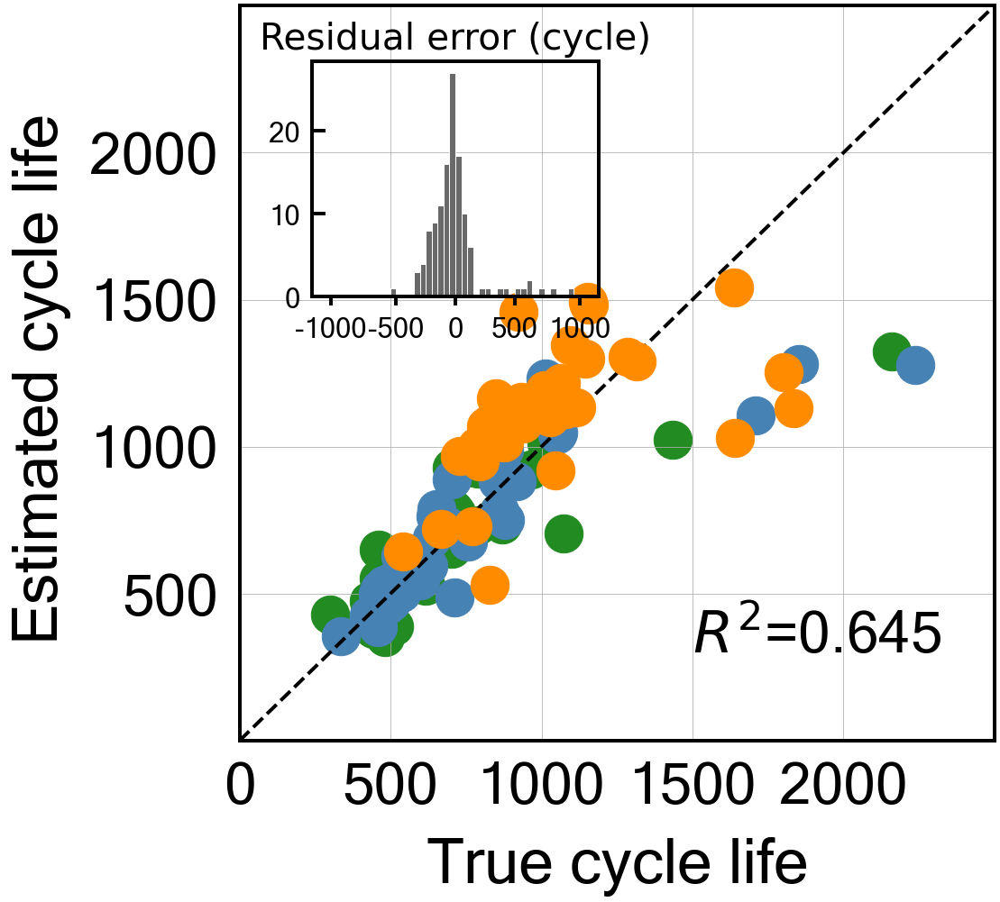


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.7
Best score obtained was: 0.18333342885807824
Cycle no: Average_2to122
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to122') : 0.015837339580482914
T_Q('Charge', 'Max-Min', 'Average_2to122') : -0.14641503876767634
T_Q('Discharge', 'Variance', 'Average_2to122') : 0.15207545917989962
dTdQ('Charge', 'Mean', 'Average_2to122') : -0.02322823545767413
dTdQ('Charge', 'Skewness', 'Average_2to122') : 0.011976225428645805
dTdQ('Charge', 'Maximum', 'Average_2to122') : -0.08470510856425828

Intercept: 2.793969897643638
r2-score: 0.775
MAE_all: 136.4
MAE_train: 102.4
MAE_test: 104.7
MAE_2ndTest: 204.6
MAPE_all: 14.8 %
MAPE_train: 13.7 %
MAPE_test: 11.1 %
MAPE_2ndTest: 20.0 %
RMSE_all: 212.5
RMSE_train: 171.7
RMSE_test: 200.7
RMSE_2ndTest: 257.7
RMSPE_all: 18.9 %
RMSPE_train: 17.7 %
RMSPE_test: 14.8 %
RMSPE_2ndTest: 23.5 %
Log-scale scores
All data r2-score:

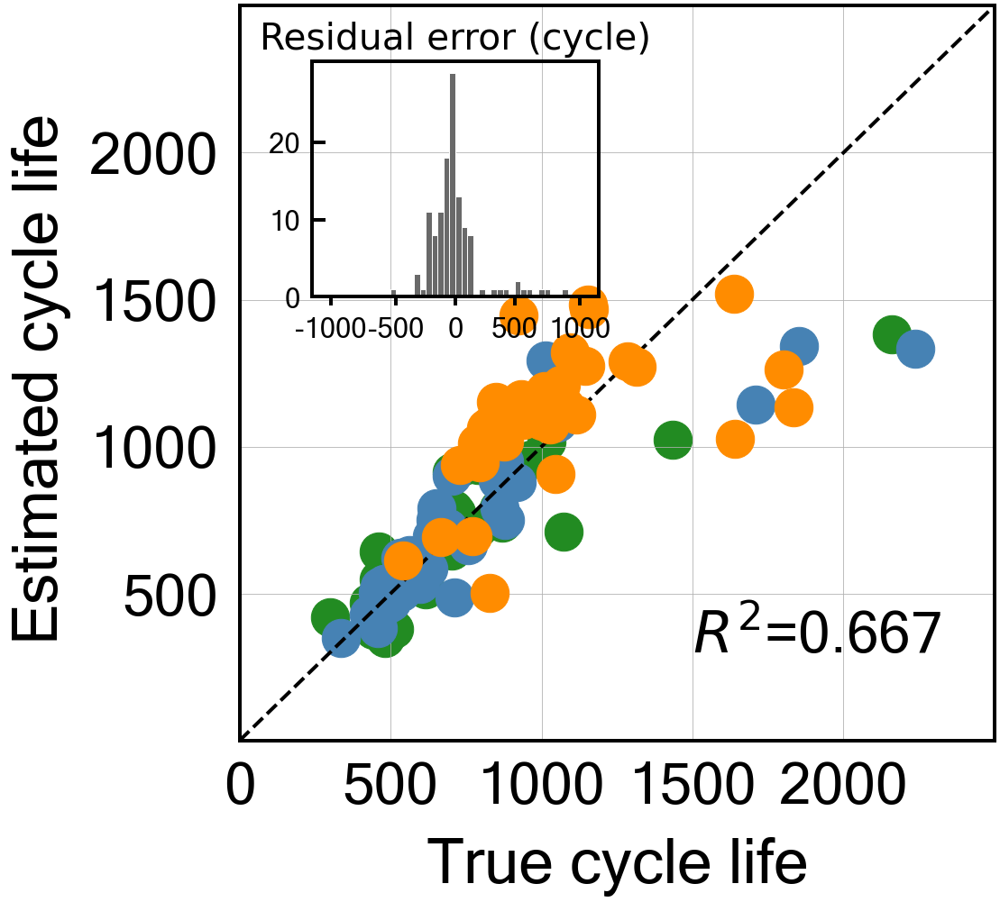


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.6
Best score obtained was: 0.19676582234968054
Cycle no: Average_2to123
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to123') : 0.007921645606431407
T_Q('Charge', 'Max-Min', 'Average_2to123') : -0.16924797713416337
T_Q('Discharge', 'Variance', 'Average_2to123') : 0.17372075156083555
dTdQ('Charge', 'Mean', 'Average_2to123') : -0.01540399129709242
dTdQ('Charge', 'Skewness', 'Average_2to123') : 0.010725214586893714
dTdQ('Charge', 'Maximum', 'Average_2to123') : -0.08696554101294213

Intercept: 2.7939698976436373
r2-score: 0.777
MAE_all: 135.6
MAE_train: 102.2
MAE_test: 105.2
MAE_2ndTest: 201.8
MAPE_all: 14.9 %
MAPE_train: 13.9 %
MAPE_test: 11.5 %
MAPE_2ndTest: 19.6 %
RMSE_all: 205.1
RMSE_train: 162.4
RMSE_test: 187.8
RMSE_2ndTest: 255.5
RMSPE_all: 18.8 %
RMSPE_train: 17.5 %
RMSPE_test: 15.0 %
RMSPE_2ndTest: 23.3 %
Log-scale scores
All data r2-score

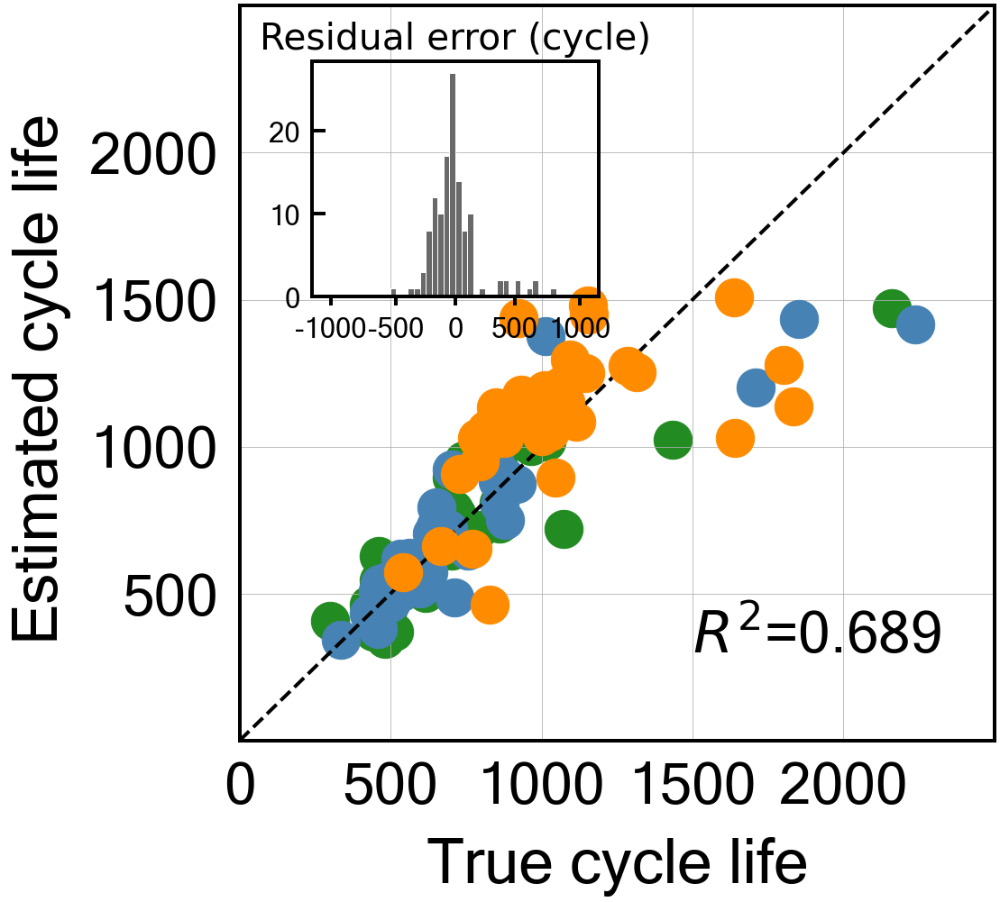


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.8
Best score obtained was: 0.19594807259143665
Cycle no: Average_2to124
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to124') : 0.007199410804042837
T_Q('Charge', 'Max-Min', 'Average_2to124') : -0.1712118569320361
T_Q('Discharge', 'Variance', 'Average_2to124') : 0.1761690253272489
dTdQ('Charge', 'Mean', 'Average_2to124') : -0.014738245760423213
dTdQ('Charge', 'Skewness', 'Average_2to124') : 0.01102407902054245
dTdQ('Charge', 'Maximum', 'Average_2to124') : -0.08765822733812317

Intercept: 2.793969897643637
r2-score: 0.777
MAE_all: 135.4
MAE_train: 102.3
MAE_test: 104.6
MAE_2ndTest: 201.8
MAPE_all: 14.9 %
MAPE_train: 13.9 %
MAPE_test: 11.5 %
MAPE_2ndTest: 19.6 %
RMSE_all: 204.7
RMSE_train: 162.5
RMSE_test: 186.2
RMSE_2ndTest: 255.7
RMSPE_all: 18.9 %
RMSPE_train: 17.5 %
RMSPE_test: 15.0 %
RMSPE_2ndTest: 23.3 %
Log-scale scores
All data r2-score: 0

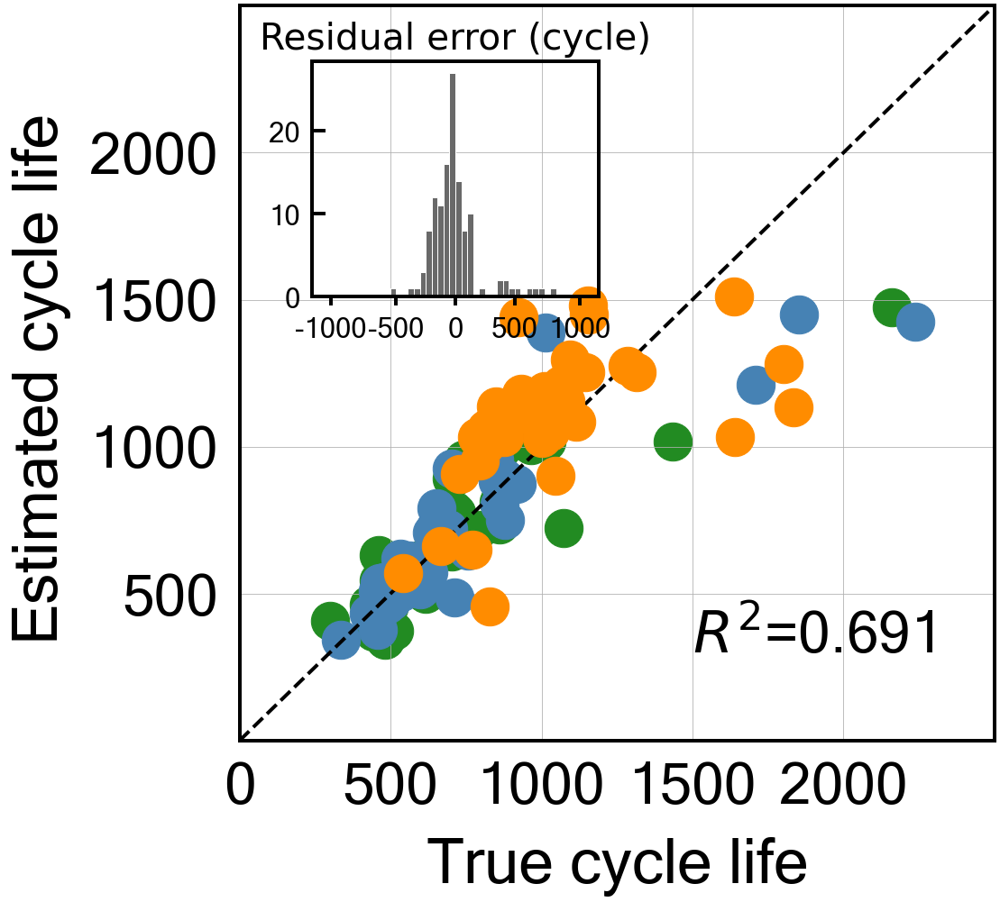


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.3
Best score obtained was: 0.1855096902976806
Cycle no: Average_2to125
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to125') : 0.00705651028342261
T_Q('Charge', 'Max-Min', 'Average_2to125') : -0.17304964165383424
T_Q('Discharge', 'Variance', 'Average_2to125') : 0.177595676732994
dTdQ('Charge', 'Mean', 'Average_2to125') : -0.01360497624187098
dTdQ('Charge', 'Skewness', 'Average_2to125') : 0.01097093382176899
dTdQ('Charge', 'Maximum', 'Average_2to125') : -0.08813956500699782

Intercept: 2.793969897643637
r2-score: 0.776
MAE_all: 136.0
MAE_train: 102.0
MAE_test: 104.7
MAE_2ndTest: 203.8
MAPE_all: 15.0 %
MAPE_train: 13.8 %
MAPE_test: 11.5 %
MAPE_2ndTest: 19.8 %
RMSE_all: 204.9
RMSE_train: 161.7
RMSE_test: 185.5
RMSE_2ndTest: 257.3
RMSPE_all: 19.0 %
RMSPE_train: 17.4 %
RMSPE_test: 15.1 %
RMSPE_2ndTest: 23.6 %
Log-scale scores
All data r2-score: 0.77

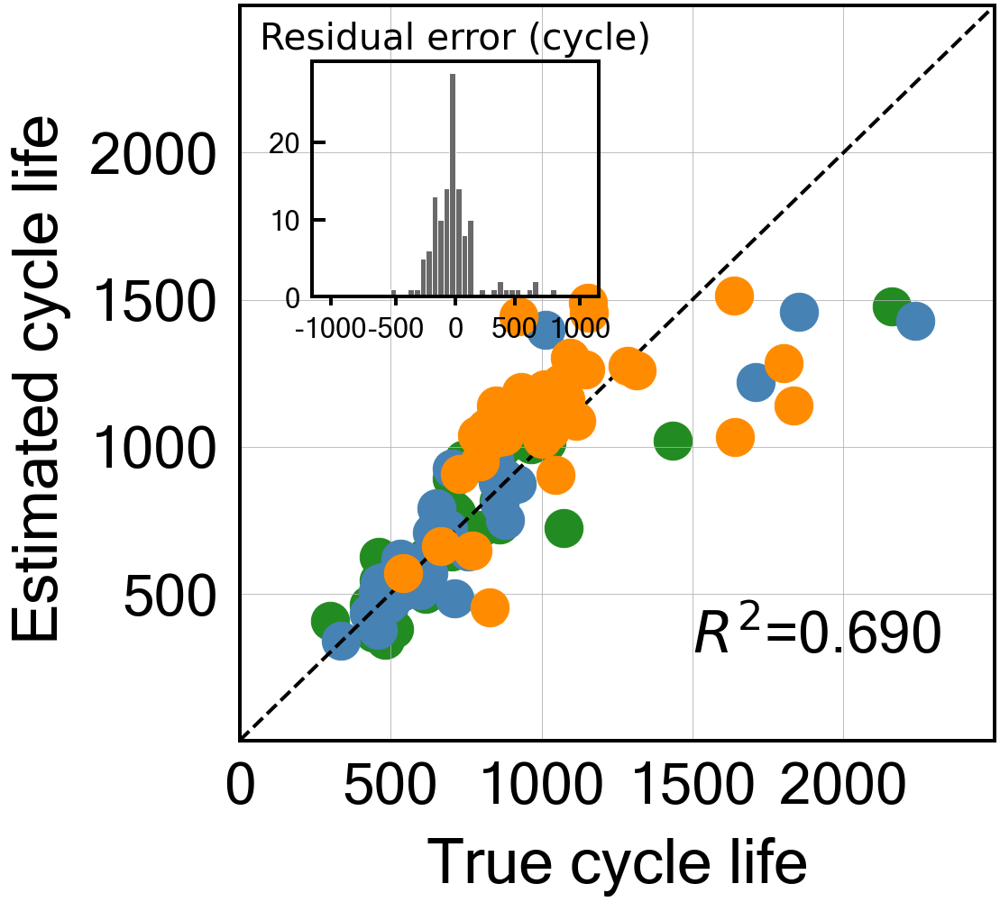


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.4
Best score obtained was: 0.18107257449203196
Cycle no: Average_2to126
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to126') : 0.0073341282499825985
T_Q('Charge', 'Max-Min', 'Average_2to126') : -0.17494219162969207
T_Q('Discharge', 'Variance', 'Average_2to126') : 0.17848116103120618
dTdQ('Charge', 'Mean', 'Average_2to126') : -0.012522122122244142
dTdQ('Charge', 'Skewness', 'Average_2to126') : 0.010255551136765446
dTdQ('Charge', 'Maximum', 'Average_2to126') : -0.08797444662151571

Intercept: 2.793969897643637
r2-score: 0.774
MAE_all: 136.3
MAE_train: 102.4
MAE_test: 104.8
MAE_2ndTest: 204.1
MAPE_all: 15.0 %
MAPE_train: 13.9 %
MAPE_test: 11.5 %
MAPE_2ndTest: 19.9 %
RMSE_all: 205.7
RMSE_train: 162.4
RMSE_test: 186.3
RMSE_2ndTest: 258.0
RMSPE_all: 19.0 %
RMSPE_train: 17.5 %
RMSPE_test: 15.1 %
RMSPE_2ndTest: 23.7 %
Log-scale scores
All data r2-scor

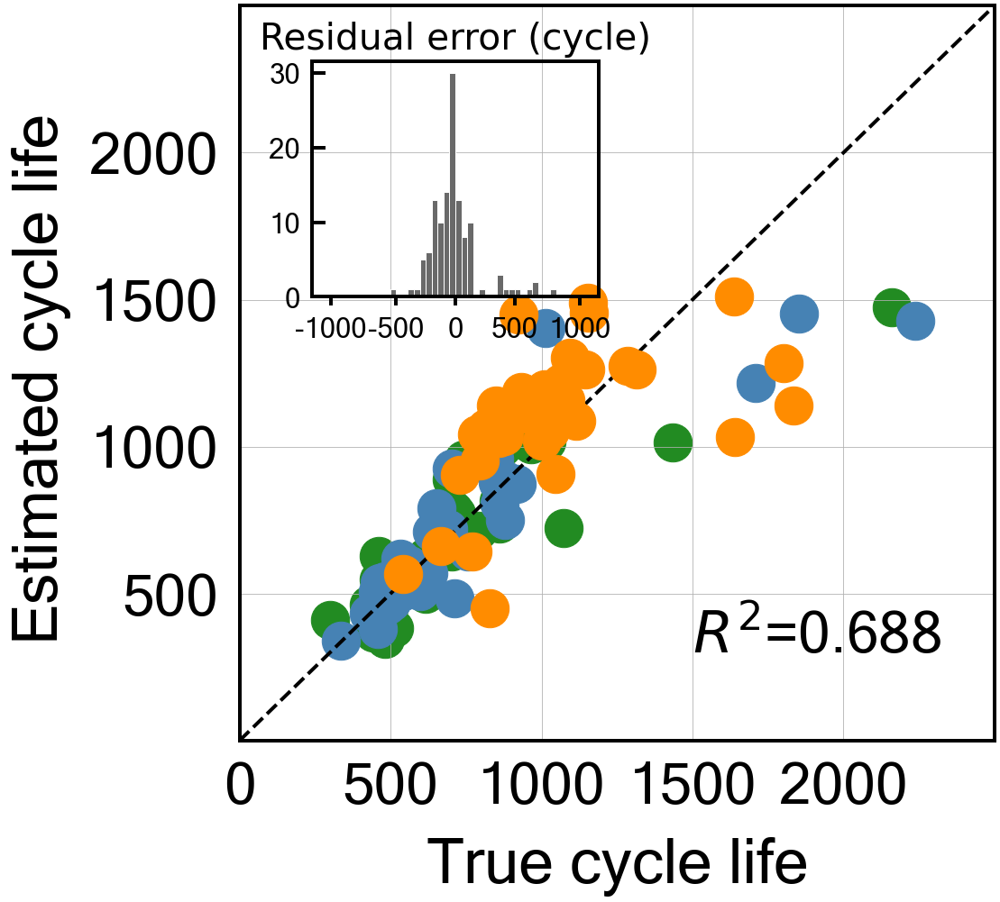


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.3
Best score obtained was: 0.1713055444671876
Cycle no: Average_2to127
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to127') : 0.007292934433788001
T_Q('Charge', 'Max-Min', 'Average_2to127') : -0.17630787608512785
T_Q('Discharge', 'Variance', 'Average_2to127') : 0.17936520103738143
dTdQ('Charge', 'Mean', 'Average_2to127') : -0.011678643982365842
dTdQ('Charge', 'Skewness', 'Average_2to127') : 0.010050494249147373
dTdQ('Charge', 'Maximum', 'Average_2to127') : -0.08835090959446064

Intercept: 2.793969897643637
r2-score: 0.773
MAE_all: 136.7
MAE_train: 102.4
MAE_test: 104.5
MAE_2ndTest: 205.7
MAPE_all: 15.1 %
MAPE_train: 13.9 %
MAPE_test: 11.5 %
MAPE_2ndTest: 20.1 %
RMSE_all: 206.1
RMSE_train: 162.2
RMSE_test: 185.9
RMSE_2ndTest: 259.5
RMSPE_all: 19.1 %
RMSPE_train: 17.5 %
RMSPE_test: 15.1 %
RMSPE_2ndTest: 23.9 %
Log-scale scores
All data r2-score:

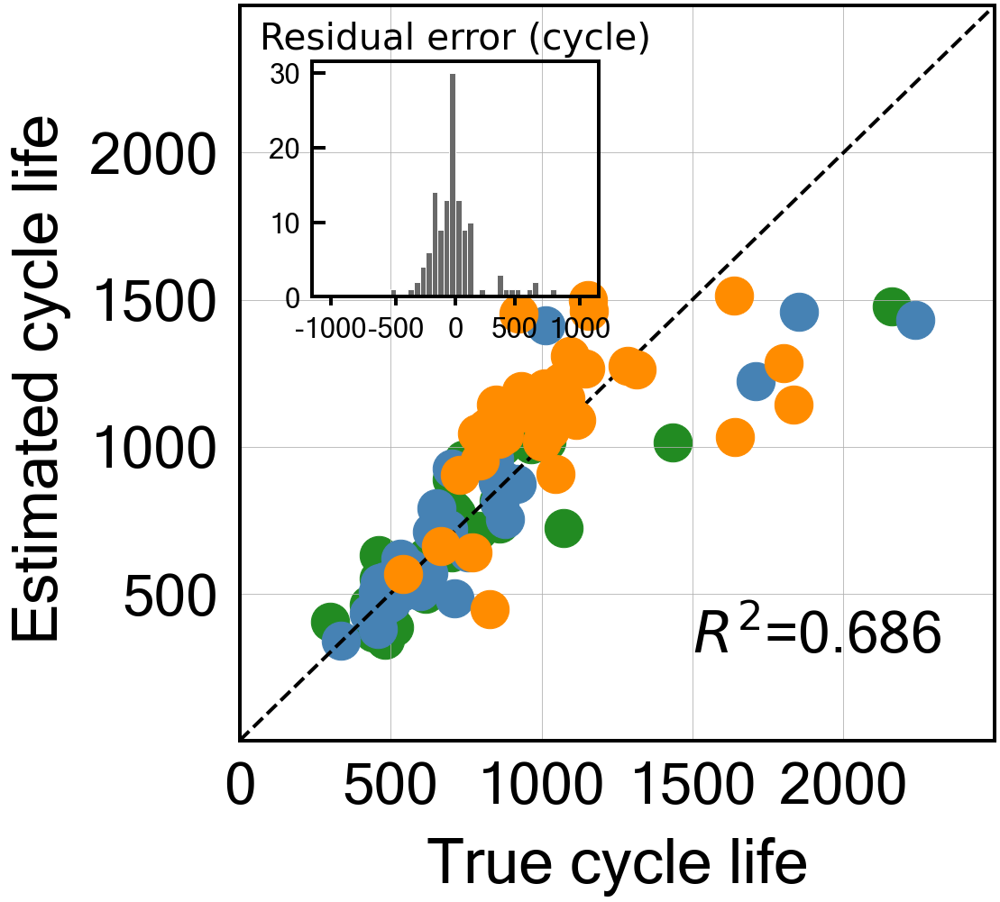


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.14172364845476926
Cycle no: Average_2to128
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to128') : 0.008039185087163097
T_Q('Charge', 'Max-Min', 'Average_2to128') : -0.1777390572617488
T_Q('Discharge', 'Variance', 'Average_2to128') : 0.1794074186397523
dTdQ('Charge', 'Mean', 'Average_2to128') : -0.009822772489364511
dTdQ('Charge', 'Skewness', 'Average_2to128') : 0.010841659175212891
dTdQ('Charge', 'Maximum', 'Average_2to128') : -0.08946673799805362

Intercept: 2.793969897643637
r2-score: 0.769
MAE_all: 138.4
MAE_train: 102.2
MAE_test: 104.5
MAE_2ndTest: 211.2
MAPE_all: 15.3 %
MAPE_train: 13.8 %
MAPE_test: 11.5 %
MAPE_2ndTest: 20.7 %
RMSE_all: 207.7
RMSE_train: 161.6
RMSE_test: 185.4
RMSE_2ndTest: 264.1
RMSPE_all: 19.4 %
RMSPE_train: 17.4 %
RMSPE_test: 15.2 %
RMSPE_2ndTest: 24.6 %
Log-scale scores
All data r2-score: 

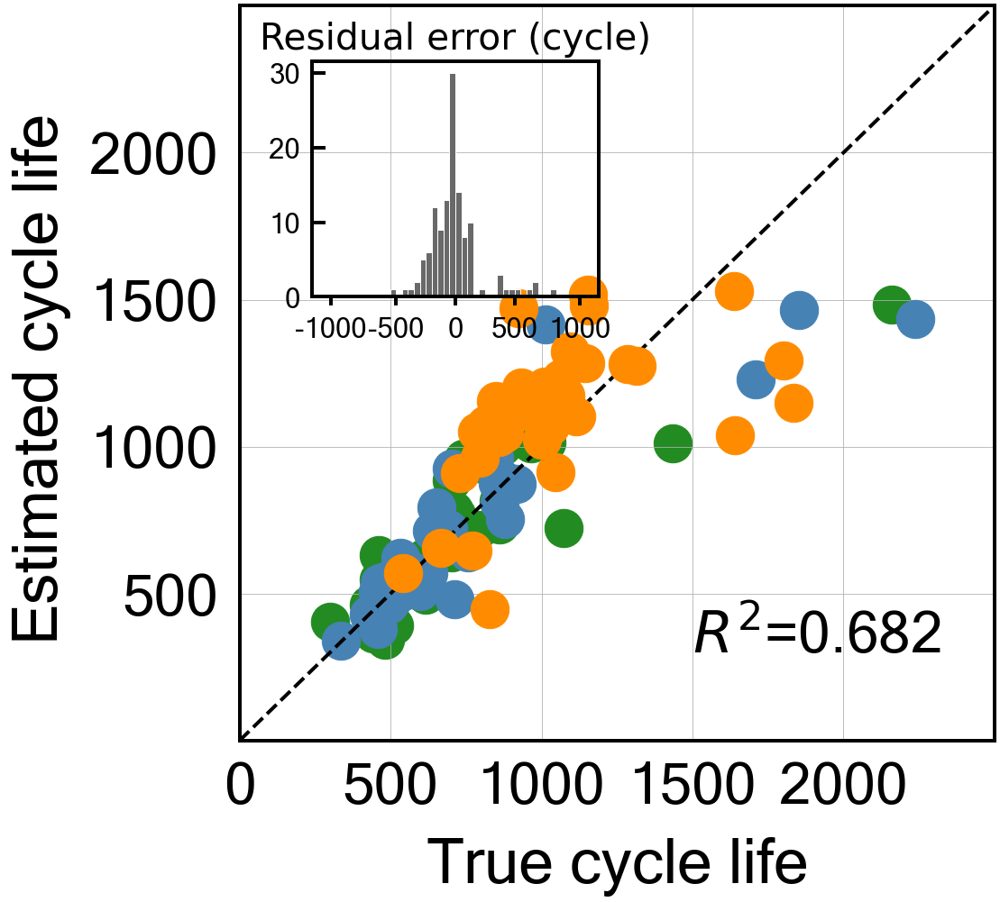


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: 0.13801371952436825
Cycle no: Average_2to129
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to129') : 0.007858008085811507
T_Q('Charge', 'Max-Min', 'Average_2to129') : -0.1782481802208048
T_Q('Discharge', 'Variance', 'Average_2to129') : 0.17993327388890956
dTdQ('Charge', 'Mean', 'Average_2to129') : -0.00969657531796799
dTdQ('Charge', 'Skewness', 'Average_2to129') : 0.011061487588905837
dTdQ('Charge', 'Maximum', 'Average_2to129') : -0.089644881198584

Intercept: 2.793969897643637
r2-score: 0.768
MAE_all: 138.8
MAE_train: 102.5
MAE_test: 104.4
MAE_2ndTest: 212.1
MAPE_all: 15.3 %
MAPE_train: 13.9 %
MAPE_test: 11.5 %
MAPE_2ndTest: 20.8 %
RMSE_all: 208.0
RMSE_train: 161.8
RMSE_test: 185.4
RMSE_2ndTest: 264.7
RMSPE_all: 19.5 %
RMSPE_train: 17.5 %
RMSPE_test: 15.2 %
RMSPE_2ndTest: 24.7 %
Log-scale scores
All data r2-score: 0.

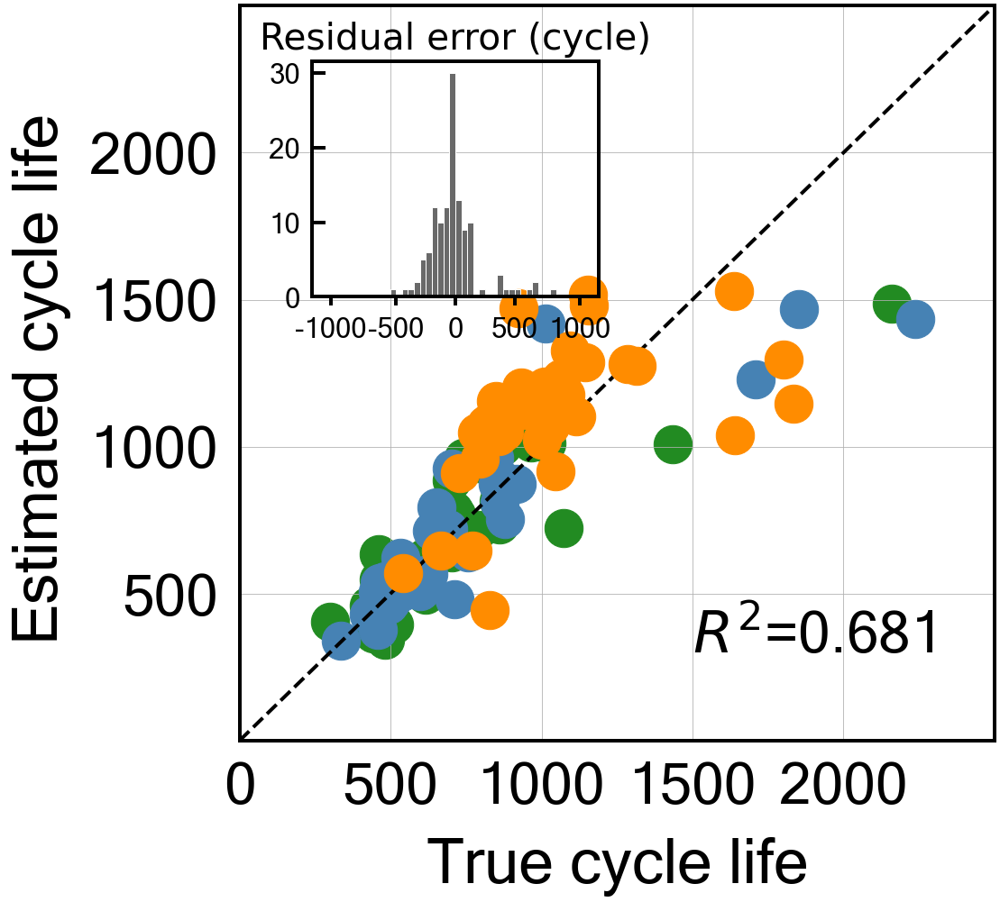


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: 0.13804950738731248
Cycle no: Average_2to130
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to130') : 0.0071897776671529115
T_Q('Charge', 'Max-Min', 'Average_2to130') : -0.17979551972990016
T_Q('Discharge', 'Variance', 'Average_2to130') : 0.18167585722771806
dTdQ('Charge', 'Mean', 'Average_2to130') : -0.009123612151581997
dTdQ('Charge', 'Skewness', 'Average_2to130') : 0.011066776269531389
dTdQ('Charge', 'Maximum', 'Average_2to130') : -0.09000569034799275

Intercept: 2.7939698976436365
r2-score: 0.769
MAE_all: 138.7
MAE_train: 102.3
MAE_test: 104.0
MAE_2ndTest: 212.5
MAPE_all: 15.3 %
MAPE_train: 13.8 %
MAPE_test: 11.4 %
MAPE_2ndTest: 20.9 %
RMSE_all: 207.5
RMSE_train: 161.3
RMSE_test: 184.4
RMSE_2ndTest: 264.7
RMSPE_all: 19.4 %
RMSPE_train: 17.4 %
RMSPE_test: 15.2 %
RMSPE_2ndTest: 24.7 %
Log-scale scores
All data r2-sco

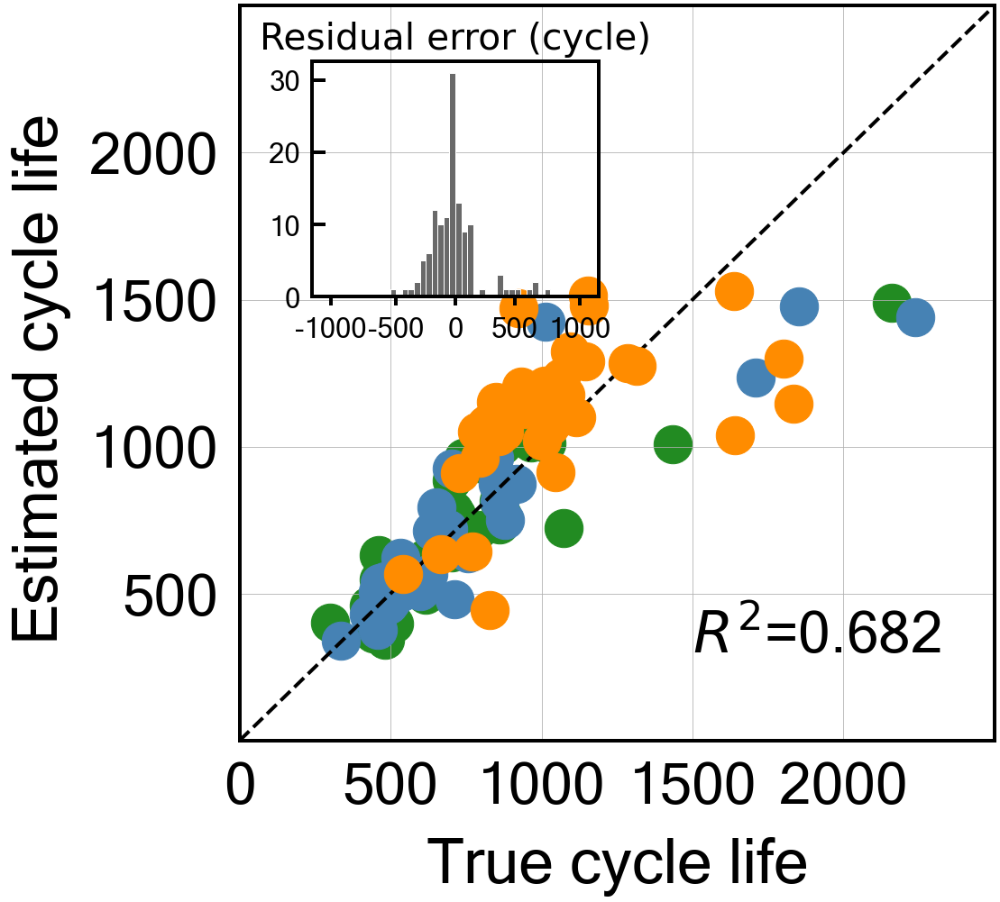


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: 0.13230962236812127
Cycle no: Average_2to131
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to131') : 0.007104645784171945
T_Q('Charge', 'Max-Min', 'Average_2to131') : -0.18069118138139798
T_Q('Discharge', 'Variance', 'Average_2to131') : 0.1825138954940675
dTdQ('Charge', 'Mean', 'Average_2to131') : -0.008502809009508176
dTdQ('Charge', 'Skewness', 'Average_2to131') : 0.01105845088774342
dTdQ('Charge', 'Maximum', 'Average_2to131') : -0.09031818317951867

Intercept: 2.793969897643637
r2-score: 0.768
MAE_all: 139.1
MAE_train: 102.2
MAE_test: 103.9
MAE_2ndTest: 213.9
MAPE_all: 15.3 %
MAPE_train: 13.8 %
MAPE_test: 11.4 %
MAPE_2ndTest: 21.0 %
RMSE_all: 207.8
RMSE_train: 161.0
RMSE_test: 184.3
RMSE_2ndTest: 265.6
RMSPE_all: 19.5 %
RMSPE_train: 17.4 %
RMSPE_test: 15.2 %
RMSPE_2ndTest: 24.8 %
Log-scale scores
All data r2-score: 

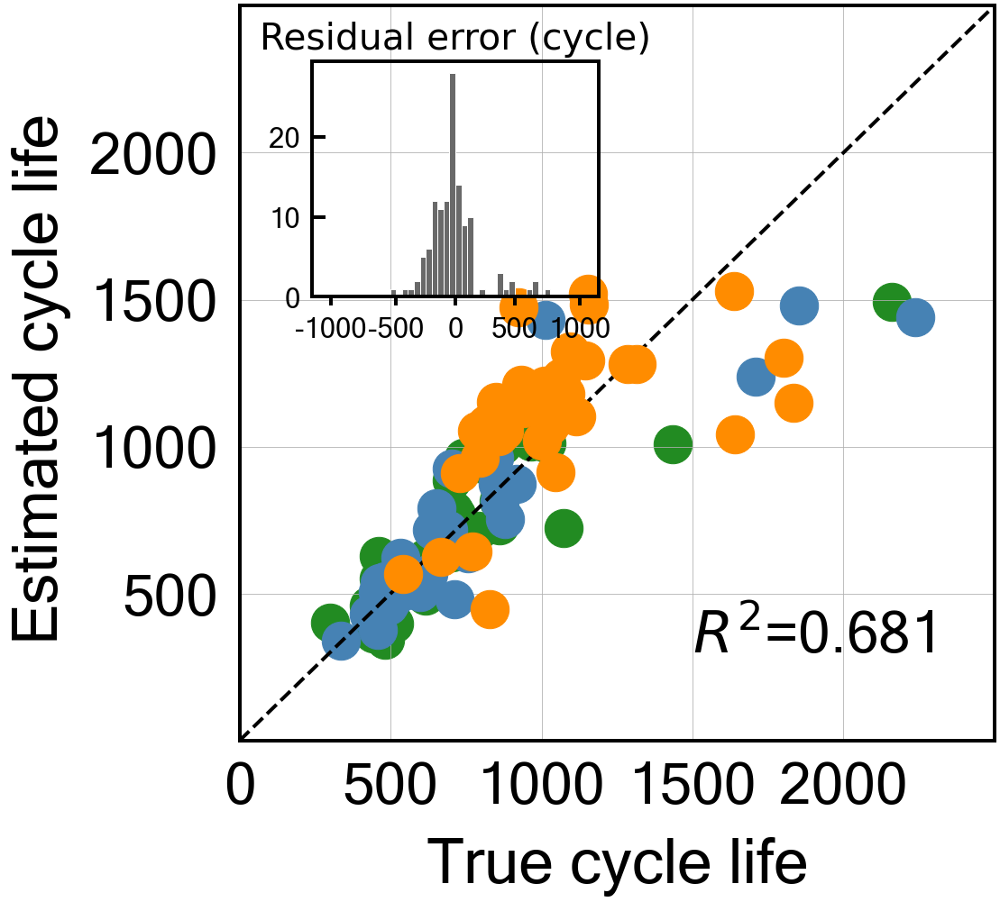


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.11607429240088096
Cycle no: Average_2to132
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to132') : 0.0074807230035485095
T_Q('Charge', 'Max-Min', 'Average_2to132') : -0.18113670604147528
T_Q('Discharge', 'Variance', 'Average_2to132') : 0.18275316698810784
dTdQ('Charge', 'Mean', 'Average_2to132') : -0.007606622290875599
dTdQ('Charge', 'Skewness', 'Average_2to132') : 0.01149406504386658
dTdQ('Charge', 'Maximum', 'Average_2to132') : -0.09116305005498138

Intercept: 2.793969897643637
r2-score: 0.767
MAE_all: 140.0
MAE_train: 102.2
MAE_test: 104.0
MAE_2ndTest: 216.7
MAPE_all: 15.5 %
MAPE_train: 13.8 %
MAPE_test: 11.5 %
MAPE_2ndTest: 21.4 %
RMSE_all: 208.6
RMSE_train: 160.8
RMSE_test: 183.6
RMSE_2ndTest: 268.1
RMSPE_all: 19.6 %
RMSPE_train: 17.4 %
RMSPE_test: 15.2 %
RMSPE_2ndTest: 25.2 %
Log-scale scores
All data r2-score

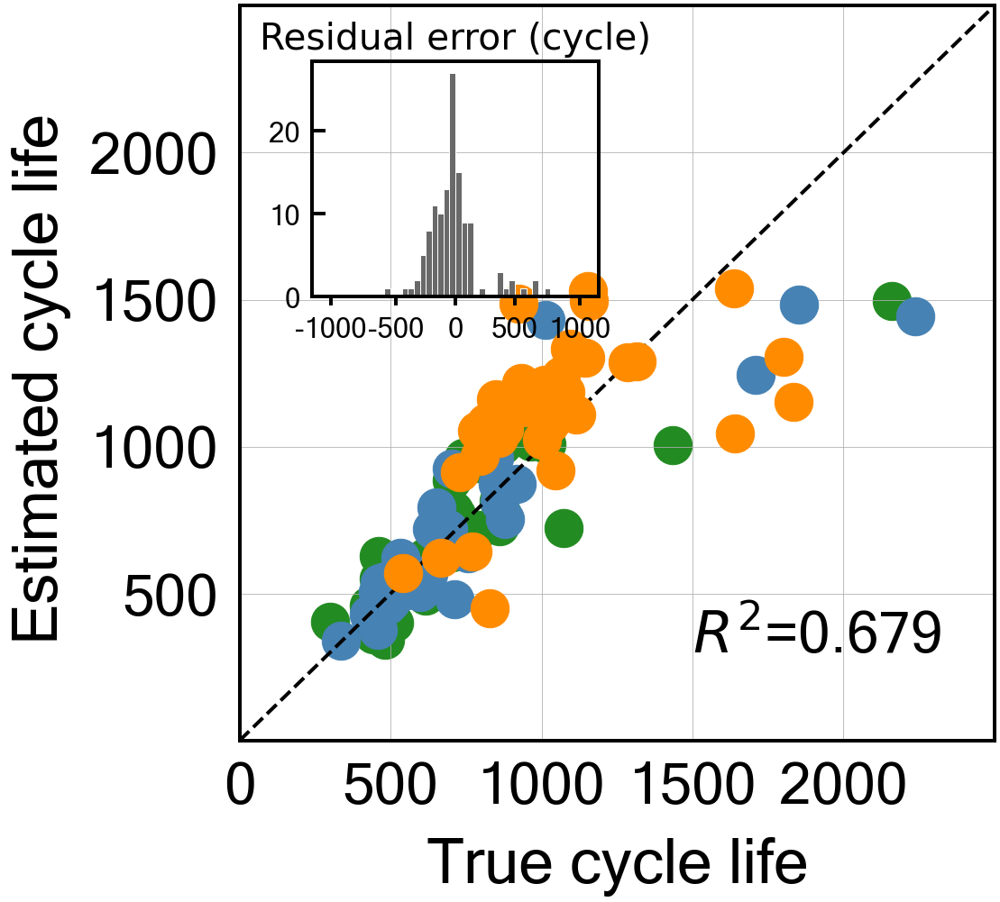


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.11756168844529902
Cycle no: Average_2to133
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to133') : 0.007417453413713757
T_Q('Charge', 'Max-Min', 'Average_2to133') : -0.1795607549486843
T_Q('Discharge', 'Variance', 'Average_2to133') : 0.1822033477031535
dTdQ('Charge', 'Mean', 'Average_2to133') : -0.008304810025364814
dTdQ('Charge', 'Skewness', 'Average_2to133') : 0.011947160917581908
dTdQ('Charge', 'Maximum', 'Average_2to133') : -0.0914876048887979

Intercept: 2.793969897643637
r2-score: 0.767
MAE_all: 139.9
MAE_train: 102.3
MAE_test: 103.6
MAE_2ndTest: 216.5
MAPE_all: 15.5 %
MAPE_train: 13.8 %
MAPE_test: 11.4 %
MAPE_2ndTest: 21.4 %
RMSE_all: 208.5
RMSE_train: 161.2
RMSE_test: 183.3
RMSE_2ndTest: 267.8
RMSPE_all: 19.6 %
RMSPE_train: 17.4 %
RMSPE_test: 15.2 %
RMSPE_2ndTest: 25.1 %
Log-scale scores
All data r2-score: 0

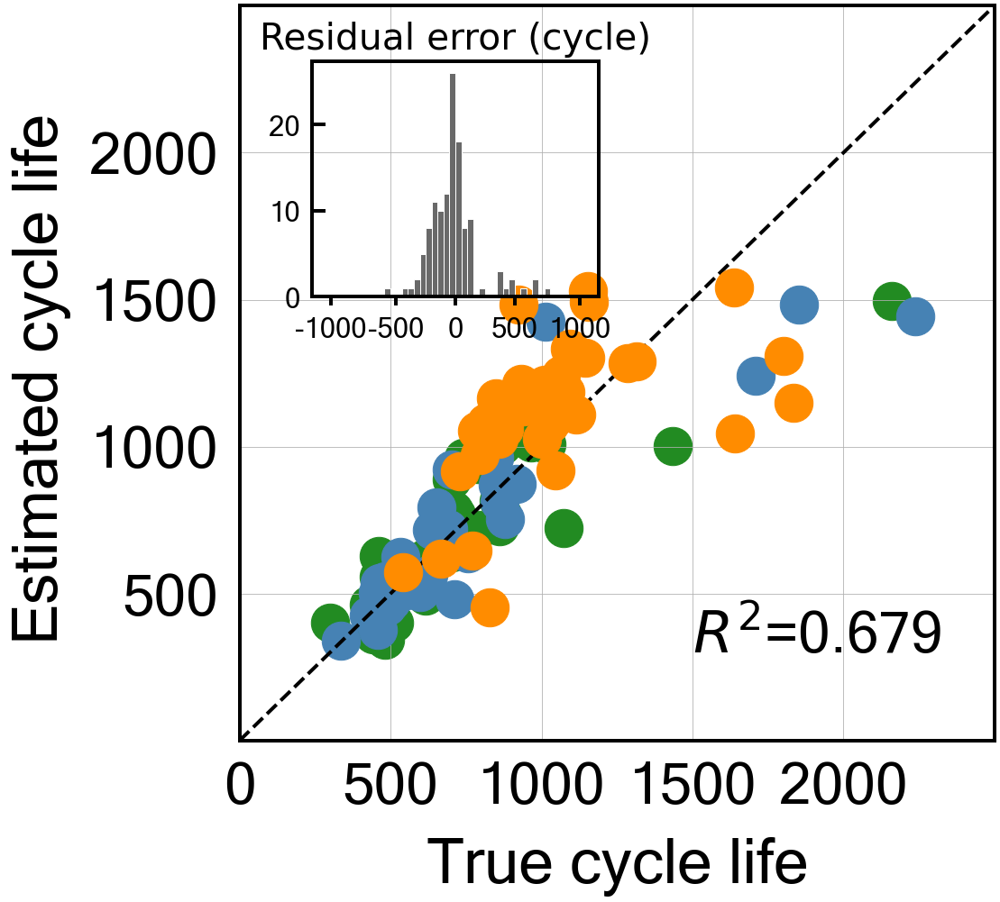


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.1156397854811062
Cycle no: Average_2to134
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to134') : 0.007137363081352689
T_Q('Charge', 'Max-Min', 'Average_2to134') : -0.18135898142783838
T_Q('Discharge', 'Variance', 'Average_2to134') : 0.1829952117316874
dTdQ('Charge', 'Mean', 'Average_2to134') : -0.007073111635001168
dTdQ('Charge', 'Skewness', 'Average_2to134') : 0.011732898924005145
dTdQ('Charge', 'Maximum', 'Average_2to134') : -0.0913095665527654

Intercept: 2.793969897643637
r2-score: 0.767
MAE_all: 140.1
MAE_train: 102.3
MAE_test: 104.0
MAE_2ndTest: 216.8
MAPE_all: 15.5 %
MAPE_train: 13.8 %
MAPE_test: 11.5 %
MAPE_2ndTest: 21.4 %
RMSE_all: 208.5
RMSE_train: 160.6
RMSE_test: 183.3
RMSE_2ndTest: 268.1
RMSPE_all: 19.6 %
RMSPE_train: 17.4 %
RMSPE_test: 15.2 %
RMSPE_2ndTest: 25.1 %
Log-scale scores
All data r2-score: 0

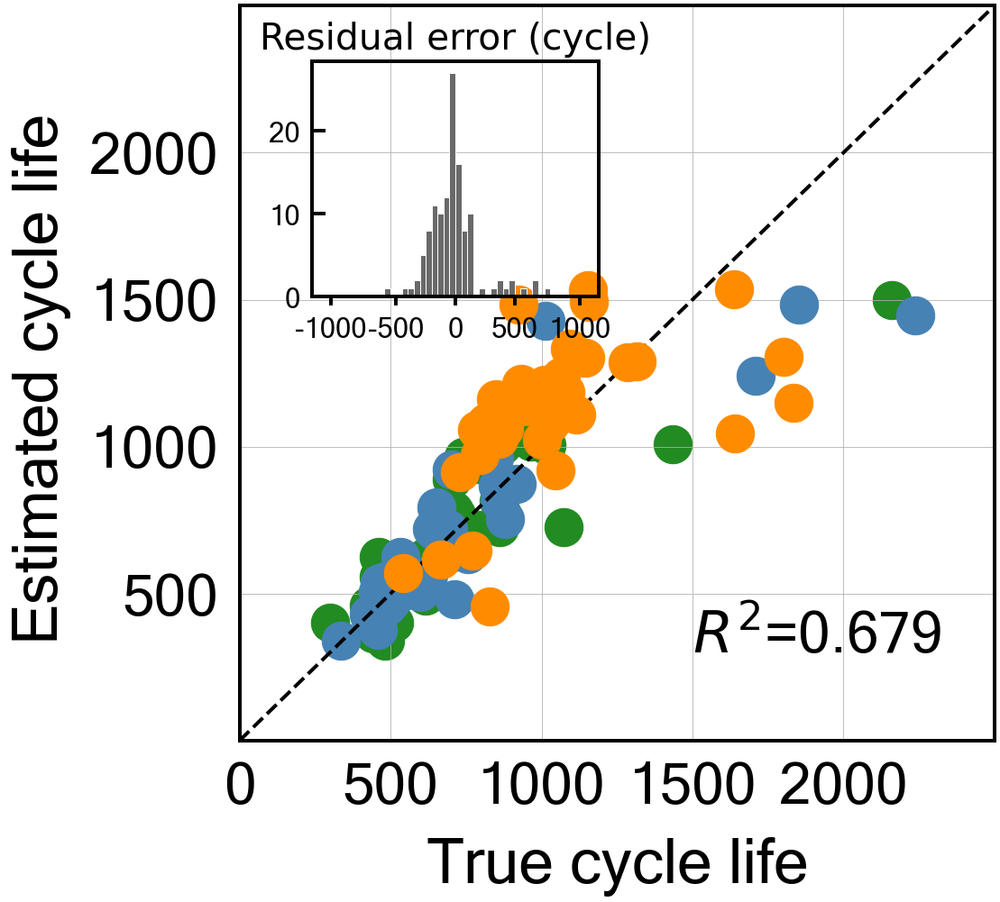


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: 0.09122877105449134
Cycle no: Average_2to135
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to135') : 0.00808400154376688
T_Q('Charge', 'Max-Min', 'Average_2to135') : -0.18196086460301916
T_Q('Discharge', 'Variance', 'Average_2to135') : 0.18228433621646287
dTdQ('Charge', 'Mean', 'Average_2to135') : -0.00572170067507219
dTdQ('Charge', 'Skewness', 'Average_2to135') : 0.011946301408403706
dTdQ('Charge', 'Maximum', 'Average_2to135') : -0.0917960902664345

Intercept: 2.793969897643637
r2-score: 0.764
MAE_all: 141.6
MAE_train: 102.2
MAE_test: 104.1
MAE_2ndTest: 221.4
MAPE_all: 15.7 %
MAPE_train: 13.8 %
MAPE_test: 11.5 %
MAPE_2ndTest: 21.9 %
RMSE_all: 210.0
RMSE_train: 160.3
RMSE_test: 183.5
RMSE_2ndTest: 271.8
RMSPE_all: 19.9 %
RMSPE_train: 17.4 %
RMSPE_test: 15.3 %
RMSPE_2ndTest: 25.7 %
Log-scale scores
All data r2-score: 0

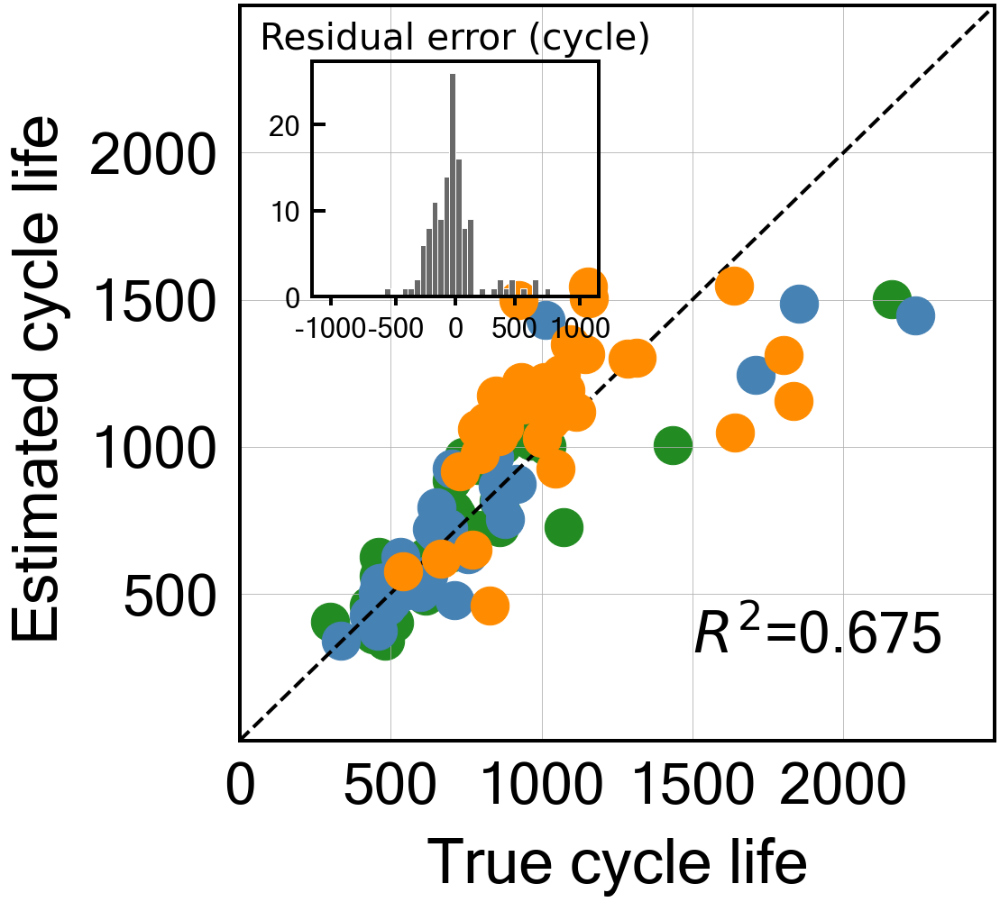


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.5
Best score obtained was: 0.08498073174094356
Cycle no: Average_2to136
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to136') : 0.008115423647095983
T_Q('Charge', 'Max-Min', 'Average_2to136') : -0.1816210022765889
T_Q('Discharge', 'Variance', 'Average_2to136') : 0.18241814043775642
dTdQ('Charge', 'Mean', 'Average_2to136') : -0.005996687241004049
dTdQ('Charge', 'Skewness', 'Average_2to136') : 0.01249323444589434
dTdQ('Charge', 'Maximum', 'Average_2to136') : -0.09226125649988189

Intercept: 2.7939698976436365
r2-score: 0.764
MAE_all: 141.9
MAE_train: 102.1
MAE_test: 104.0
MAE_2ndTest: 222.4
MAPE_all: 15.7 %
MAPE_train: 13.8 %
MAPE_test: 11.5 %
MAPE_2ndTest: 22.0 %
RMSE_all: 210.2
RMSE_train: 160.3
RMSE_test: 182.9
RMSE_2ndTest: 272.7
RMSPE_all: 19.9 %
RMSPE_train: 17.4 %
RMSPE_test: 15.2 %
RMSPE_2ndTest: 25.8 %
Log-scale scores
All data r2-score:

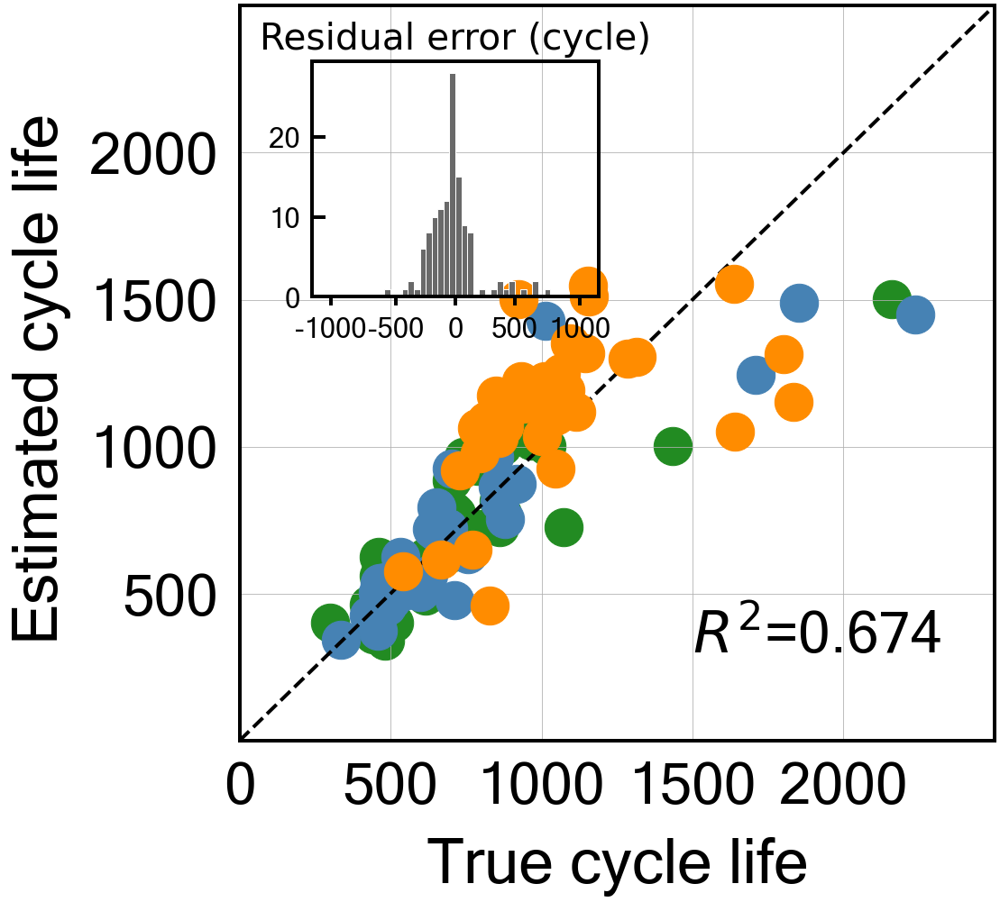


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.5
Best score obtained was: 0.08180227650940353
Cycle no: Average_2to137
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to137') : 0.00840581634449501
T_Q('Charge', 'Max-Min', 'Average_2to137') : -0.18151448678710552
T_Q('Discharge', 'Variance', 'Average_2to137') : 0.18204995500973878
dTdQ('Charge', 'Mean', 'Average_2to137') : -0.005685410510389079
dTdQ('Charge', 'Skewness', 'Average_2to137') : 0.012864857141403516
dTdQ('Charge', 'Maximum', 'Average_2to137') : -0.09240786197624216

Intercept: 2.7939698976436365
r2-score: 0.763
MAE_all: 142.1
MAE_train: 102.5
MAE_test: 104.0
MAE_2ndTest: 222.7
MAPE_all: 15.7 %
MAPE_train: 13.9 %
MAPE_test: 11.5 %
MAPE_2ndTest: 22.1 %
RMSE_all: 210.8
RMSE_train: 161.3
RMSE_test: 183.3
RMSE_2ndTest: 273.2
RMSPE_all: 19.9 %
RMSPE_train: 17.5 %
RMSPE_test: 15.2 %
RMSPE_2ndTest: 25.8 %
Log-scale scores
All data r2-score

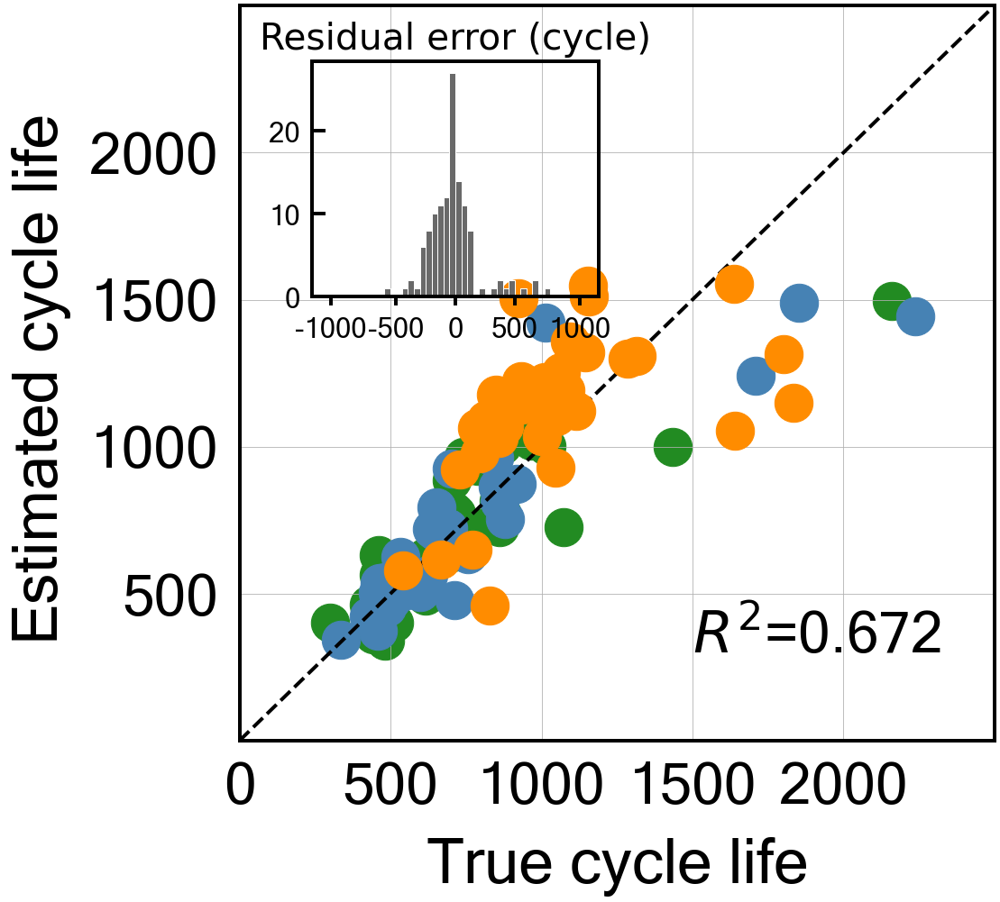


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.9
Best score obtained was: 0.08925532957422377
Cycle no: Average_2to138
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to138') : 0.008121044884362797
T_Q('Charge', 'Max-Min', 'Average_2to138') : -0.18076405108148058
T_Q('Discharge', 'Variance', 'Average_2to138') : 0.18216289954871862
dTdQ('Charge', 'Mean', 'Average_2to138') : -0.006391968562612362
dTdQ('Charge', 'Skewness', 'Average_2to138') : 0.012986118784526393
dTdQ('Charge', 'Maximum', 'Average_2to138') : -0.09248358016254214

Intercept: 2.793969897643637
r2-score: 0.764
MAE_all: 141.6
MAE_train: 102.7
MAE_test: 104.1
MAE_2ndTest: 220.9
MAPE_all: 15.7 %
MAPE_train: 13.9 %
MAPE_test: 11.5 %
MAPE_2ndTest: 21.8 %
RMSE_all: 210.4
RMSE_train: 161.7
RMSE_test: 183.2
RMSE_2ndTest: 272.1
RMSPE_all: 19.9 %
RMSPE_train: 17.5 %
RMSPE_test: 15.2 %
RMSPE_2ndTest: 25.6 %
Log-scale scores
All data r2-score

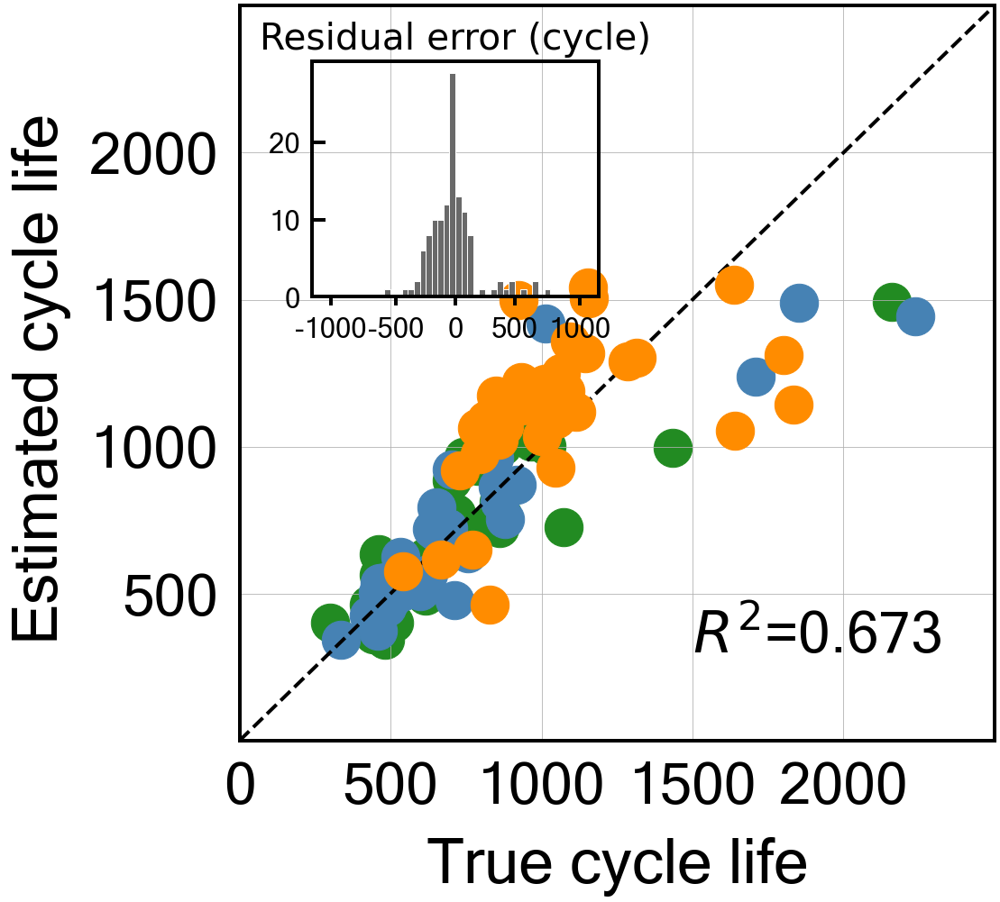


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.8
Best score obtained was: 0.0824764994629229
Cycle no: Average_2to139
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to139') : 0.008548002293466854
T_Q('Charge', 'Max-Min', 'Average_2to139') : -0.1816232915442689
T_Q('Discharge', 'Variance', 'Average_2to139') : 0.18196897819368335
dTdQ('Charge', 'Mean', 'Average_2to139') : -0.00560375197937587
dTdQ('Charge', 'Skewness', 'Average_2to139') : 0.012635434079218365
dTdQ('Charge', 'Maximum', 'Average_2to139') : -0.09225186357875918

Intercept: 2.793969897643637
r2-score: 0.763
MAE_all: 142.1
MAE_train: 102.8
MAE_test: 104.4
MAE_2ndTest: 222.2
MAPE_all: 15.7 %
MAPE_train: 13.9 %
MAPE_test: 11.5 %
MAPE_2ndTest: 22.0 %
RMSE_all: 211.0
RMSE_train: 161.7
RMSE_test: 184.0
RMSE_2ndTest: 273.1
RMSPE_all: 19.9 %
RMSPE_train: 17.5 %
RMSPE_test: 15.2 %
RMSPE_2ndTest: 25.8 %
Log-scale scores
All data r2-score: 0

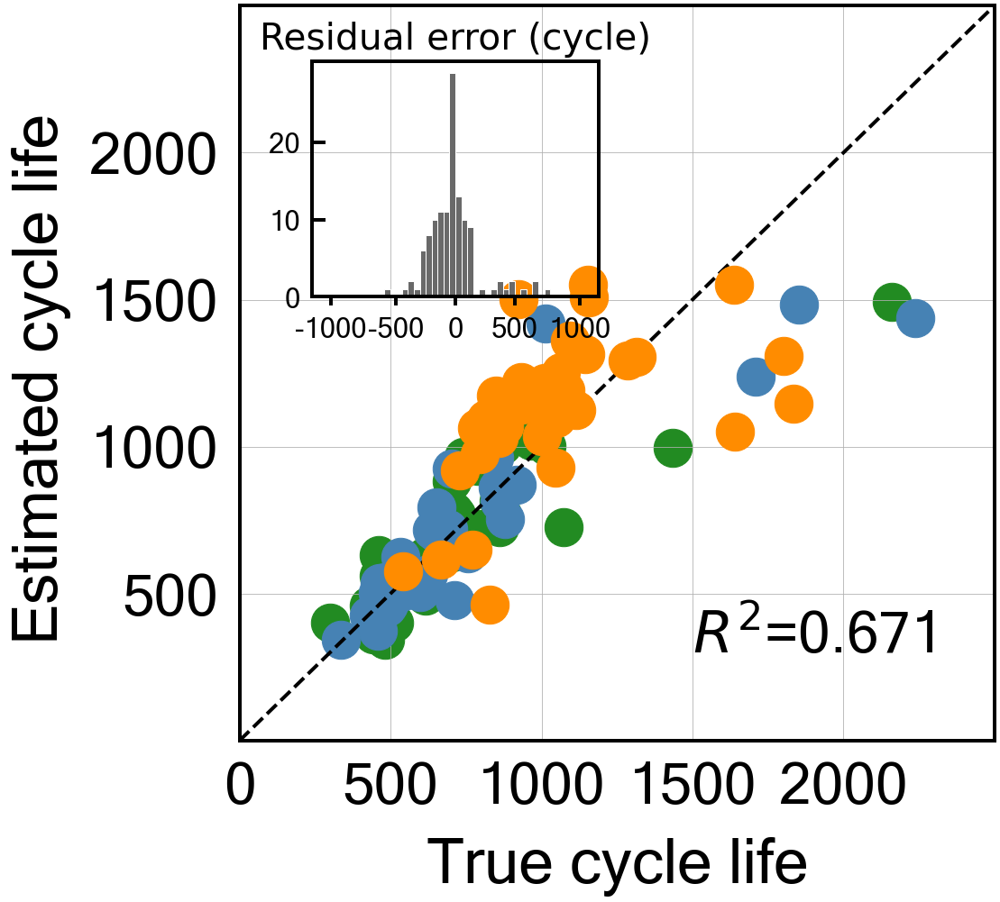


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.6
Best score obtained was: 0.08293528834956387
Cycle no: Average_2to140
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to140') : 0.00833698768758231
T_Q('Charge', 'Max-Min', 'Average_2to140') : -0.18175153118602272
T_Q('Discharge', 'Variance', 'Average_2to140') : 0.18204555575465808
dTdQ('Charge', 'Mean', 'Average_2to140') : -0.005472978609169206
dTdQ('Charge', 'Skewness', 'Average_2to140') : 0.01291344279228528
dTdQ('Charge', 'Maximum', 'Average_2to140') : -0.09234800988463235

Intercept: 2.7939698976436373
r2-score: 0.763
MAE_all: 142.2
MAE_train: 102.7
MAE_test: 104.4
MAE_2ndTest: 222.2
MAPE_all: 15.7 %
MAPE_train: 13.9 %
MAPE_test: 11.5 %
MAPE_2ndTest: 22.0 %
RMSE_all: 210.9
RMSE_train: 161.7
RMSE_test: 183.8
RMSE_2ndTest: 273.0
RMSPE_all: 19.9 %
RMSPE_train: 17.5 %
RMSPE_test: 15.2 %
RMSPE_2ndTest: 25.8 %
Log-scale scores
All data r2-score:

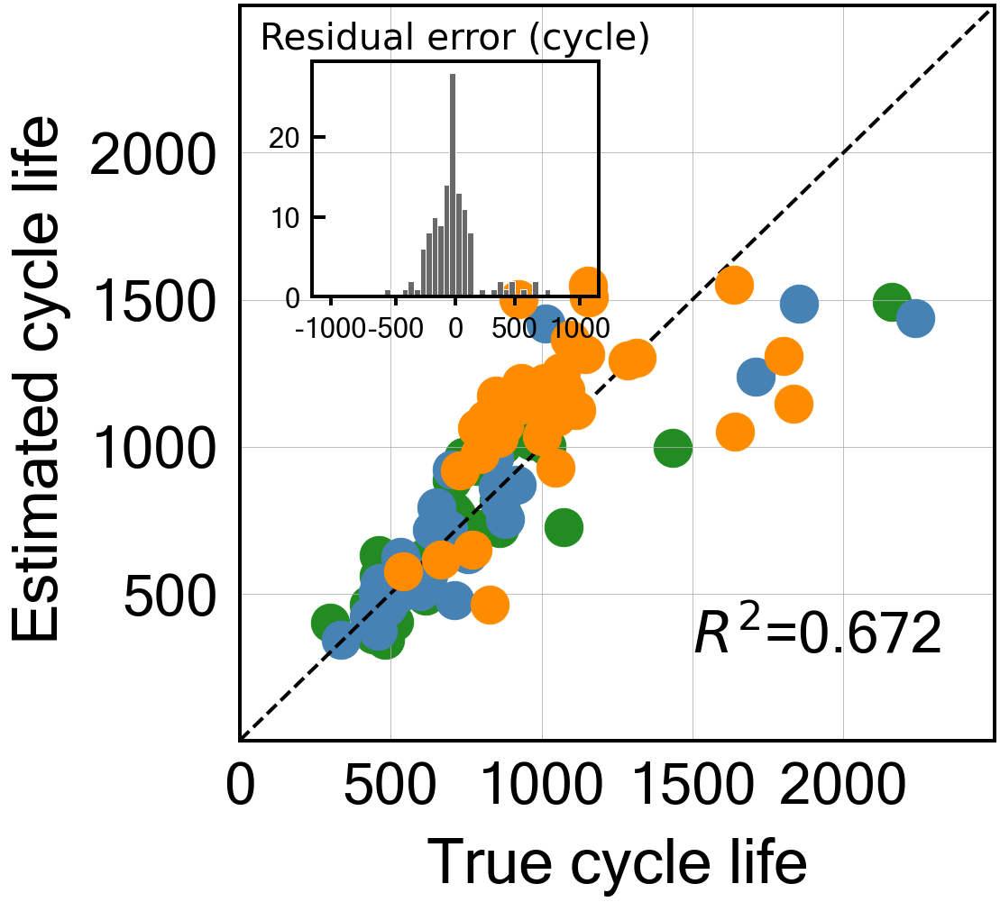


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.3
Best score obtained was: 0.08072670762190104
Cycle no: Average_2to141
Coefficient:
T_Q('Charge', 'Minimum', 'Average_2to141') : 0.008240816993083077
T_Q('Charge', 'Max-Min', 'Average_2to141') : -0.18256063593147864
T_Q('Discharge', 'Variance', 'Average_2to141') : 0.18223858676702404
dTdQ('Charge', 'Mean', 'Average_2to141') : -0.0047832640033715085
dTdQ('Charge', 'Skewness', 'Average_2to141') : 0.012997341609097803
dTdQ('Charge', 'Maximum', 'Average_2to141') : -0.0923718162197986

Intercept: 2.793969897643637
r2-score: 0.763
MAE_all: 142.3
MAE_train: 102.7
MAE_test: 104.4
MAE_2ndTest: 222.7
MAPE_all: 15.7 %
MAPE_train: 13.9 %
MAPE_test: 11.5 %
MAPE_2ndTest: 22.0 %
RMSE_all: 211.0
RMSE_train: 161.6
RMSE_test: 183.6
RMSE_2ndTest: 273.4
RMSPE_all: 19.9 %
RMSPE_train: 17.5 %
RMSPE_test: 15.2 %
RMSPE_2ndTest: 25.8 %
Log-scale scores
All data r2-score

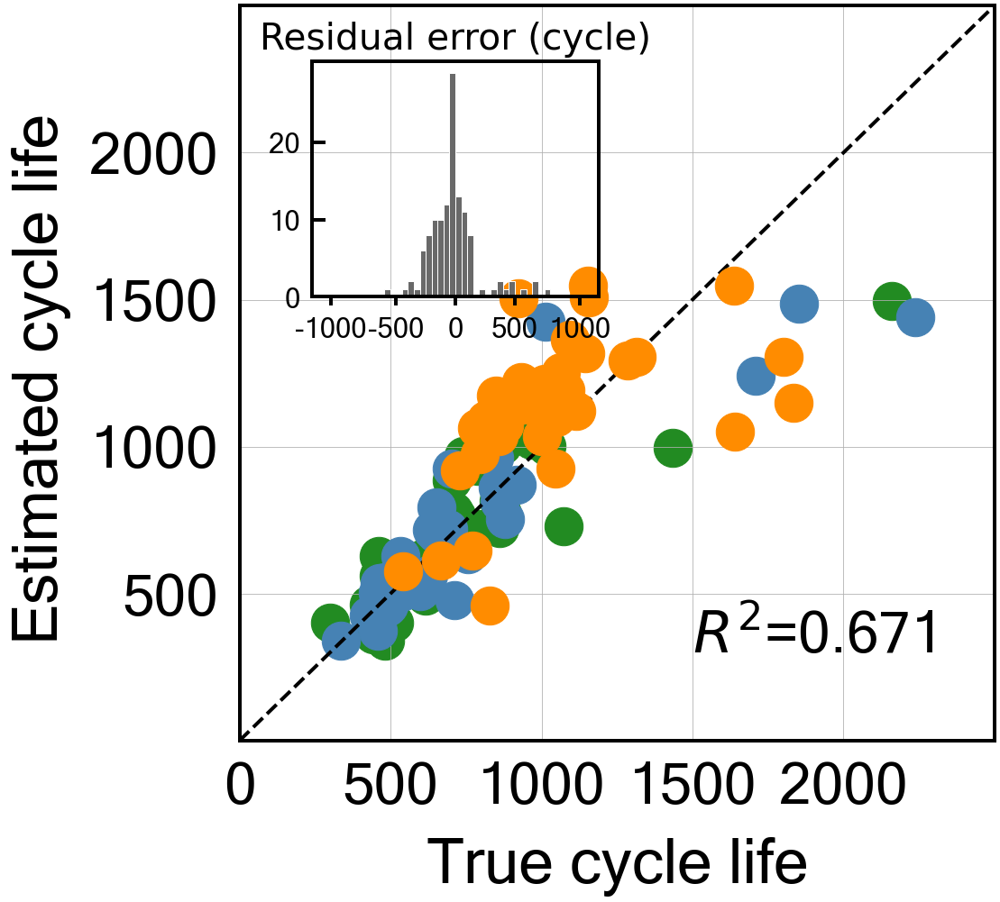


Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: 0.06917100759974282
error in 142

Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: 0.08403213177422308
error in 143

Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.1
Best score obtained was: 0.10234578623129376
error in 144

Temperature model
rScore compared --> 2nd dataset


------------------------------------------------------------------------
Time elapsed: 5.0
Best score obtained was: 0.07644143418918692
error in 145

Temperature model
rScore compared --> 2nd dataset
error in 146

Temperature model
rScore compared --> 2nd dataset
error in 147

Temperature model
rScore compared --> 2nd dataset
error in 148


In [10]:
# modeList = ['Charge', 'Discharge']
# printCoef = False
# stringOutputList = []
# errorList = []
# for avgCycleNo in [str(x) for x in np.arange(3,150,1)]:
#     try:
#         ## Create the dataframe
#         # Evalute for cycle Average_2to10
#         setCycleNo = 'Average_2to'+avgCycleNo
#         feat_df = pd.DataFrame(columns=['dictionary', 'keyName', 'valueArray'])#, 'rScore'])
#         ##                                      1. T(Q)
#         # Variables
#         featureDict = T_Q.copy()
#         featureKeynameUniqueList = TQKeynameUnique.copy()
#         keyCycle = setCycleNo
#         sample_size = featureDict[('Discharge', 'Max-Min', setCycleNo)].size

#         ## END

#         featureKeynameList = []

#         # All cells
#         X = np.empty((sample_size,0))
#         y = featureDict['cycle_life'].ravel()

#         # Append the feature KEYS to be inspected into featureKeynameList
#         for keyMode in modeList:
#             ## NEED TO CHANGE THE RANGE
#             for keyStat in featureKeynameUniqueList[1][2:9]:
#                 featureKeynameList.append((keyMode, keyStat, keyCycle))
                
#         # Append the FEATURE into X array

#         for feat in featureKeynameList:
#             # ALL CELLS
#             X = np.append(X, featureDict[feat].reshape(-1,1), axis=1)
            
#         # Append to dataframe
#         for i in range(len(featureKeynameList)):
#             newRow = {'dictionary': 'T_Q', 'keyName': featureKeynameList[i], 'valueArray': X[:, i]}#, 'rScore': rScore[i]}
#             feat_df = feat_df.append(newRow, ignore_index=True)
                    
#         ##                                      2. dT/dQ
#         # Variables
#         featureDict = dTdQ.copy()
#         featureKeynameUniqueList = dTdQKeynameUnique.copy()
#         keyCycle = setCycleNo
#         sample_size = featureDict[('Charge', 'Maximum', setCycleNo)].size

#         ## END

#         featureKeynameList = []

#         # All cells
#         X = np.empty((sample_size,0))
#         y = featureDict['cycle_life'].ravel()

#         # Append the feature KEYS to be inspected into featureKeynameList
#         # For Charge and Discharge
#         for keyMode in modeList:
#             ## NEED TO CHANGE THE RANGE
#             for keyStat in featureKeynameUniqueList[1][3:10]:
#                 featureKeynameList.append((keyMode, keyStat, keyCycle))
                
#         # Append the FEATURE into X array

#         for feat in featureKeynameList:
#             # ALL CELLS
#             X = np.append(X, featureDict[feat].reshape(-1,1), axis=1)
            
#         # Append to dataframe
#         for i in range(len(featureKeynameList)):
#             newRow = {'dictionary': 'dTdQ', 'keyName': featureKeynameList[i], 'valueArray': X[:, i]}#, 'rScore': rScore[i]}
#             feat_df = feat_df.append(newRow, ignore_index=True)
        




#         #### Train the models now:
#         # Initiate savepath
#         savepath = os.path.join('.', 'folderName')
#         modelName = "Temperature model"

#         combo = np.array([5, 6, 7, 15, 16, 18])
            
#         X_array = np.vstack(feat_df.loc[:, 'valueArray']).transpose()

#         print("\nTemperature model\nrScore compared --> 2nd dataset")

#         startTime = time.time()

#         r2ScoreBest = -10
#         featureKeynameListBest = []
#         saveFilePath = os.path.join(savepath, 'average'+avgCycleNo+'.png')
            
#         featureKeynameList = []
#         X_all = X_array[:, combo]

#         for j in combo:
#             featureKeynameList.append(feat_df.loc[j, 'dictionary'] + str(feat_df.loc[j, 'keyName']))

#         X_train  = X_all[train_ind]
#         X_test = X_all[test_ind]
#         X_secondary_test = X_all[secondary_test_ind]

#         scaler = StandardScaler().fit(X_train)
#         X_train_scaled = scaler.transform(X_train)
#         X_test_scaled = scaler.transform(X_test)
#         X_secondary_test_scaled = scaler.transform(X_secondary_test)
#         X_all_scaled = np.concatenate((X_train_scaled, X_test_scaled, X_secondary_test_scaled))

#         # Train
#         regEN = ElasticNetCV(l1_ratio=np.linspace(0.01,1,100), cv=4, random_state=20, max_iter=100000, n_jobs=3, tol=1e-2, verbose=0, selection='random')
#         model = regEN
#         model.fit(X_train_scaled, y_train)

#         #Evaluate score: SECONDARY DATASET
#         r2Score = r2_score(10**y_secondary_test, 10**model.predict(X_secondary_test_scaled))

#         if r2Score > r2ScoreBest:
#             r2ScoreBest = r2Score
#             featureKeynameListBest = featureKeynameList
#             modelBest = model
#             X_all_scaled_best = X_all_scaled
                    
#         stringOutputManual = ("\n\n------------------------------------------------------------------------\n" + 
#                             "Time elapsed: {:.1f}".format(time.time() - startTime) + 
#                             "\nBest score obtained was: " + str(r2ScoreBest))
        
#         print(stringOutputManual)
#         stringOutput = train_utils.print_result(setCycleNo, modelBest, X_all_scaled_best, y_all, featureKeynameListBest, idlst=lenList)
#         stringOutput += plot_utils.build_all_comparison_graph_v2(X_all_scaled_best, y_all, modelBest, len_list = [len(train_ind), len(test_ind), len(secondary_test_ind)],  name=modelName)#, save = saveFilePath)
#         stringOutputList.append(stringOutputManual + stringOutput)
#     except:
#         print("error in " + avgCycleNo)
#         errorList.append(avgCycleNo)

# # # Uncomment to print the output
# # with open(os.path.join(savepath, "output.txt"), "w") as f:
# #     f.write('\n'.join(stringOutputList))
# #     f.close()
# if len(errorList) > 0: print("error found in ", errorList)

In [ ]:
# The obtained results are plotted using a different source code